# 1. Load packages

In [314]:
import scipy.sparse as sp
import pandas as pd
import scanpy as sc
import pandas as pd
import igraph as ig
import matplotlib.pyplot as plt
import networkx as nx
from mygene import MyGeneInfo

In [315]:
import numpy as np
np.NAN = np.nan

In [316]:
import omnipath as op

In [317]:
from markov_clustering import run_mcl, get_clusters

In [318]:
from matplotlib.colors import rgb2hex

In [319]:
import leidenalg

# 2. load data

In [310]:
adata = sc.read("/storage/users/data/PANC/H5AD_file/adata_expr_mean_by_group.h5ad")

In [311]:
adata

AnnData object with n_obs × n_vars = 12 × 4951
    obs: 'n_cells', 'leiden_t_bin_merged_nicer'
    layers: 'mean', 'sd'

In [312]:
adata_full = sc.read('/storage/users/data/PANC/H5AD_file/adata_filtered_no2D.h5ad')

In [313]:
adata_full

AnnData object with n_obs × n_vars = 6356 × 26382
    obs: 'condition', 'pct_cmo', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'doublet_scores', 'predicted_doublets', 'outlier', 'leiden'
    var: 'CMO', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'gene_symbol', 'ensembl_gene_id', 'mito', 'ribo', 'n_cells'
    uns: 'condition_colors', 'leiden', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

# 3. Get edges

## 3.1.  Download OmniPath interactions

In [12]:
from omnipath.interactions import OmniPath

# 1. See what parameters and resources are available
print("Query params:", OmniPath.params())        # dict of valid query-args :contentReference[oaicite:0]{index=0}
print("All resources:", OmniPath.resources())    # tuple of resource names :contentReference[oaicite:1]{index=1}

# 2. Download the full curated OmniPath network
inter = OmniPath.get()                          
print(f"Raw OmniPath: {inter.shape[0]:,} interactions")   # DataFrame



Query params: {'header': None, 'format': frozenset({'table', 'json', 'tsv', 'tab', 'text'}), 'license': frozenset({'academic', 'non_profit', 'commercial', 'ignore', 'for_profit', 'forprofit', 'nonprofit'}), 'password': None, 'limit': None, 'types': frozenset({'post_translational', 'small_molecule_protein', 'mirna_transcriptional', 'post_transcriptional', 'transcriptional', 'lncrna_post_transcriptional'}), 'sources': None, 'resources': None, 'databases': frozenset({'UniProt_LRdb', 'BioGRID', 'Guide2Pharma_Cellinker', 'TransmiR', 'HuRI', 'CellTalkDB', 'SPIKE', 'Ramilowski2015', 'PhosphoSite', 'HPMR_Cellinker', 'Ramilowski2015_Baccin2019', 'NTNU.Curated_CollecTRI', 'CancerCellMap', 'talklr', 'DOMINO', 'ACSN_SignaLink3', 'SIGNOR_CollecTRI', 'HPRD-phos', 'GEREDB_CollecTRI', 'PAZAR_DoRothEA', 'DLRP_talklr', 'HPRD_LRdb', 'PDZBase', 'Wang', 'SIGNOR_ProtMapper', 'DIP', 'lncrnadb', 'HTRIdb_DoRothEA', 'GOA_CollecTRI', 'HPRD_KEA', 'ENCODE_tf-mirna', 'TRED_DoRothEA', 'LMPID', 'Kirouac2010', 'ACSN',

In [13]:
# --- Define which resources to focus on (if desired) ---
focus_resources = [
    # Core signaling
    "KEGG", "Reactome", "SIGNOR",
    # Gene regulons
    "DoRothEA", "TRRUST",
    # PPI scaffold
    "BioGRID", "IntAct",
    # PTM detail (optional)
    "PhosphoSite", "iPTMnet",
    # Cell–cell communication
    "CellPhoneDB",
    # Legacy / additional
    "UniProt_LRdb", "HPRD", "Adhesome"
]

# --- Toggle filtering ---
use_mask = False  # Set to False to skip filtering by source

# --- Apply mask if requested ---
if use_mask:
    mask = inter["sources"].str.split(";").apply(
        lambda srcs: any(r in srcs for r in focus_resources)
    )
    inter = inter.loc[mask].copy()
    print(f"After resource filter: {inter.shape[0]:,} interactions")
else:
    print(f"Skipping resource filter: using all {inter.shape[0]:,} interactions")


Skipping resource filter: using all 81,529 interactions


In [14]:
inter

,source,target,is_directed,is_stimulation,is_inhibition,consensus_direction,consensus_stimulation,consensus_inhibition,curation_effort,references,sources,n_sources,n_primary_sources,n_references,references_stripped
0,P0DP23,P48995,True,False,True,True,False,True,3,TRIP:11290752;TRIP:11983166;TRIP:12601176,TRIP,1,1,3,11290752;11983166;12601176
1,P0DP25,P48995,True,False,True,True,False,True,3,TRIP:11290752;TRIP:11983166;TRIP:12601176,TRIP,1,1,3,11290752;11983166;12601176
2,P0DP24,P48995,True,False,True,True,False,True,3,TRIP:11290752;TRIP:11983166;TRIP:12601176,TRIP,1,1,3,11290752;11983166;12601176
3,Q03135,P48995,True,True,False,True,True,False,13,DIP:19897728;HPRD:12732636;IntAct:19897728;Lit...,DIP;HPRD;IntAct;Lit-BM-17;TRIP,5,5,8,10980191;12732636;14551243;16822931;18430726;1...
4,P14416,P48995,True,True,False,True,True,False,1,TRIP:18261457,TRIP,1,1,1,18261457
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81524,P12931,Q9UJM3,True,False,False,False,False,False,2,ProtMapper:26280531;iPTMnet:26280531,ProtMapper;RLIMS-P_ProtMapper;iPTMnet,3,2,1,26280531
81525,P43405,Q9ULZ3,True,False,False,False,False,False,2,ProtMapper:25605870;iPTMnet:25605870,ProtMapper;RLIMS-P_ProtMapper;iPTMnet,3,2,1,25605870
81526,Q14289,Q9ULZ3,True,False,False,False,False,False,2,ProtMapper:27796369;iPTMnet:27796369,ProtMapper;RLIMS-P_ProtMapper;iPTMnet,3,2,1,27796369
81527,P54646,Q9Y2I7,True,False,False,False,False,False,1,iPTMnet:24070423,iPTMnet,1,1,1,24070423


## 3.2.  Quality filters  (mirror your R code)

In [15]:
import numpy as np

# 1. Copy from the correct DataFrame (not the built-in iter)
df = inter.copy()

# 2. Base QC: curation effort & consensus direction
df = df[df["curation_effort"] >= 3]
#df = df[df["consensus_direction"] == 2]

# 3. Assign signed “type” and drop ambiguous edges
df["type"] = np.nan
df.loc[
    df["is_stimulation"].astype(bool) | df["consensus_stimulation"].astype(bool),
    "type"
] = "activation"
df.loc[
    df["is_inhibition"].astype(bool)  | df["consensus_inhibition"].astype(bool),
    "type"
] = "inhibition"
df = df.dropna(subset=["type"])

# 4. Publication support: ≥2 distinct papers
df = df[df["n_references"] >= 3]

# 5. Cross-resource consensus: seen in ≥2 resources
df = df[df["n_sources"] >= 1]

print(f"Rows after HQ filtering: {df.shape[0]:,}")
df.head()


Rows after HQ filtering: 7,020


/tmp/ipykernel_270652/2689462964.py:12: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'activation' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df.loc[


,source,target,is_directed,is_stimulation,is_inhibition,consensus_direction,consensus_stimulation,consensus_inhibition,curation_effort,references,sources,n_sources,n_primary_sources,n_references,references_stripped,type
0,P0DP23,P48995,True,False,True,True,False,True,3,TRIP:11290752;TRIP:11983166;TRIP:12601176,TRIP,1,1,3,11290752;11983166;12601176,inhibition
1,P0DP25,P48995,True,False,True,True,False,True,3,TRIP:11290752;TRIP:11983166;TRIP:12601176,TRIP,1,1,3,11290752;11983166;12601176,inhibition
2,P0DP24,P48995,True,False,True,True,False,True,3,TRIP:11290752;TRIP:11983166;TRIP:12601176,TRIP,1,1,3,11290752;11983166;12601176,inhibition
3,Q03135,P48995,True,True,False,True,True,False,13,DIP:19897728;HPRD:12732636;IntAct:19897728;Lit...,DIP;HPRD;IntAct;Lit-BM-17;TRIP,5,5,8,10980191;12732636;14551243;16822931;18430726;1...,activation
6,Q14571,P48995,True,True,False,True,True,False,13,HPRD:10970773;HPRD:11336651;TRIP:10970773;TRIP...,HPRD;TRIP,2,2,11,10970773;11336651;12196544;15121806;16870612;1...,activation


## 3.3.  Quick glance at interaction types

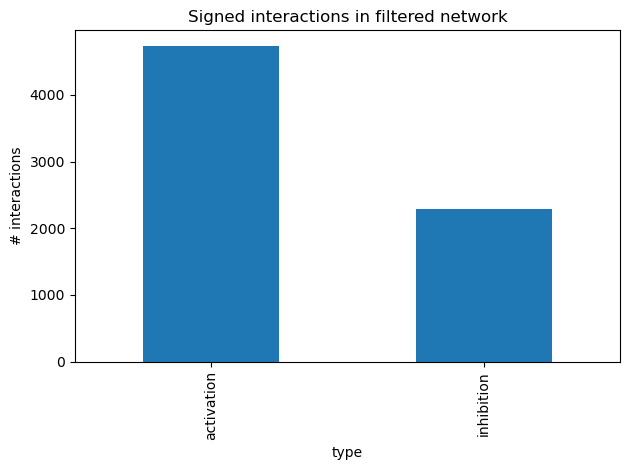

In [16]:
type_counts = df["type"].value_counts()
ax = type_counts.plot(kind="bar")
ax.set_ylabel("# interactions")
ax.set_title("Signed interactions in filtered network")
plt.tight_layout()
plt.show()

## 3.4.  Map IDs: ENSEMBL ↔ UniProt and Gene Symbol

In [17]:
adata

AnnData object with n_obs × n_vars = 12 × 4951
    obs: 'n_cells', 'leiden_t_bin_merged_nicer'
    layers: 'mean', 'sd'

In [18]:
adata.X

array([[0.09936921, 0.728537  , 0.2915708 , ..., 1.7214882 , 0.68794066,
        2.5239587 ],
       [0.05884612, 0.8661943 , 0.33032894, ..., 1.6737959 , 0.73115766,
        2.582895  ],
       [0.0667001 , 0.6995698 , 0.24281396, ..., 1.6729794 , 0.71689844,
        2.5559597 ],
       ...,
       [0.19204101, 1.3256059 , 0.32958567, ..., 1.5751498 , 0.6493861 ,
        2.4125407 ],
       [0.34407267, 1.7477092 , 0.331405  , ..., 1.4596763 , 0.59443784,
        2.2887163 ],
       [0.21066585, 1.6062691 , 0.3436498 , ..., 1.4218997 , 0.63196987,
        2.3218346 ]], shape=(12, 4951), dtype=float32)

In [19]:
row_names = adata.obs_names.tolist()
col_names = adata.var_names.tolist()
print(f"{len(row_names)} rows:", row_names[:5])
print(f"{len(col_names)} cols:", col_names[:5])

12 rows: ['0_t_0.0000-0.5000', '3_t_1.0000-1.5000', '3_t_0.0000-1.0000', '3_t_1.5000-2.5000', '2_t_3.5000-4.0000']
4951 cols: ['ENSG00000187634', 'ENSG00000188290', 'ENSG00000187608', 'ENSG00000078808', 'ENSG00000160087']


In [20]:
# 1. Build expr_mean DataFrame: rows=ENSG, cols=leiden groups
expr_mean = pd.DataFrame(
    adata.layers["mean"].T,
    index=adata.var_names,    # ENSG IDs
    columns=adata.obs_names    # clusters
)

# 2. Query MyGeneInfo for Swiss-Prot IDs
mg = MyGeneInfo()
results = mg.querymany(
    expr_mean.index.tolist(),
    scopes="ensembl.gene",
    fields="uniprot.Swiss-Prot",
    species="human",
    returnall=False
)

INFO:biothings.client:querying 1-1000 ...
INFO:biothings.client:querying 1001-2000 ...
INFO:biothings.client:querying 2001-3000 ...
INFO:biothings.client:querying 3001-4000 ...
INFO:biothings.client:querying 4001-4951 ...
INFO:biothings.client:Finished.
INFO:biothings.client:Pass "returnall=True" to return complete lists of duplicate or missing query terms.


In [21]:
# 3. Build ENSG→UniProt map (take first canonical isoform)
ensg2up = {}
for hit in results:
    ens = hit.get("query")
    if hit.get("notfound"):
        continue
    up = hit.get("uniprot", {}).get("Swiss-Prot")
    if isinstance(up, list):
        ensg2up[ens] = up[0]
    elif isinstance(up, str):
        ensg2up[ens] = up

# 4. Add UniProtID and gene_symbol columns to expr_mean
#    – gene_symbol comes from adata_full.var["gene_symbol"]
symbol_map = adata_full.var.set_index("ensembl_gene_id")["gene_symbol"].to_dict()

expr_mean["UniProtID"]   = expr_mean.index.map(ensg2up)
expr_mean["gene_symbol"] = expr_mean.index.map(symbol_map)

# 5. Drop any rows that failed to map either ID or symbol
expr_mean = expr_mean.dropna(subset=["UniProtID", "gene_symbol"])

# 6. (Optional) If you want one row per protein rather than ENSG, you can collapse:
# expr_mean = expr_mean.groupby(["UniProtID","gene_symbol"]).mean()

# 7. Check
print(f"Annotated expr_mean shape: {expr_mean.shape}")
print(expr_mean[["UniProtID","gene_symbol"]].head())

Annotated expr_mean shape: (4806, 14)
                UniProtID gene_symbol
ENSG00000187634    Q96NU1      SAMD11
ENSG00000188290    Q9HCC6        HES4
ENSG00000187608    P05161       ISG15
ENSG00000078808    Q9BRK5        SDF4
ENSG00000160087    Q8N2K1      UBE2J2


In [22]:
expr_mean

,0_t_0.0000-0.5000,3_t_1.0000-1.5000,3_t_0.0000-1.0000,3_t_1.5000-2.5000,2_t_3.5000-4.0000,1_t_0.5000-1.5000,2_t_1.0000-2.5000,1_t_3.0000-3.5000,1_t_1.5000-2.5000,1_t_2.5000-3.0000,2_t_2.5000-3.0000,2_t_3.0000-3.5000,UniProtID,gene_symbol
ENSG00000187634,0.099369,0.058846,0.066700,0.112531,0.162974,0.214113,0.185448,0.184487,0.290847,0.192041,0.344073,0.210666,Q96NU1,SAMD11
ENSG00000188290,0.728537,0.866194,0.699570,1.101085,1.385252,1.715819,1.912032,1.365245,1.408131,1.325606,1.747709,1.606269,Q9HCC6,HES4
ENSG00000187608,0.291571,0.330329,0.242814,0.475130,0.304981,0.523779,0.639019,0.272351,0.405396,0.329586,0.331405,0.343650,P05161,ISG15
ENSG00000078808,0.479059,0.563355,0.574328,0.517743,0.574268,0.526164,0.581868,0.511637,0.496302,0.495905,0.604565,0.560752,Q9BRK5,SDF4
ENSG00000160087,0.205096,0.236239,0.211886,0.341432,0.244610,0.239008,0.366078,0.250638,0.284698,0.279735,0.379937,0.285058,Q8N2K1,UBE2J2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000212907,1.403289,1.270650,1.224059,1.160672,0.923706,1.369050,1.016627,1.044514,1.130702,1.138607,1.189642,1.006450,P03901,MT-ND4L
ENSG00000198886,3.390511,3.408980,3.277259,3.241845,3.001662,3.376153,3.096779,2.947157,3.164708,3.129170,3.223900,3.042403,P03905,MT-ND4
ENSG00000198786,1.721488,1.673796,1.672979,1.665568,1.532841,1.689483,1.436786,1.477971,1.453489,1.575150,1.459676,1.421900,P03915,MT-ND5
ENSG00000198695,0.687941,0.731158,0.716898,0.685877,0.556408,0.750087,0.575130,0.683552,0.664187,0.649386,0.594438,0.631970,P03923,MT-ND6


In [23]:
print(expr_mean.columns.tolist())

['0_t_0.0000-0.5000', '3_t_1.0000-1.5000', '3_t_0.0000-1.0000', '3_t_1.5000-2.5000', '2_t_3.5000-4.0000', '1_t_0.5000-1.5000', '2_t_1.0000-2.5000', '1_t_3.0000-3.5000', '1_t_1.5000-2.5000', '1_t_2.5000-3.0000', '2_t_2.5000-3.0000', '2_t_3.0000-3.5000', 'UniProtID', 'gene_symbol']


# 4. Get Nodes: get filtered expression matrix but per cell/barcode expression (not the mean)

In [24]:
import pandas as pd
from scipy import sparse

# 1. Build ENSG→UniProt map (as before)
ensg2up = {}
for hit in results:
    ens = hit.get("query")
    if hit.get("notfound"):
        continue
    up = hit.get("uniprot", {}).get("Swiss-Prot")
    if isinstance(up, list):
        ensg2up[ens] = up[0]
    elif isinstance(up, str):
        ensg2up[ens] = up

# 2. Build ENSG→gene_symbol map (as before)
symbol_map = adata_full.var.set_index("ensembl_gene_id")["gene_symbol"].to_dict()

# 3. Extract raw expression matrix and transpose to (genes × cells)
X = adata_full.X
if sparse.issparse(X):
    mat = X.toarray()         # ← use .toarray() instead of .A
else:
    mat = X.copy()            # if it’s already a dense array

mat_T = mat.T  # now shape is (n_genes, n_cells)

expr_cells = pd.DataFrame(
    mat_T,
    index=adata_full.var.index,    # Ensembl IDs
    columns=adata_full.obs_names   # cell barcodes
)

# 4. Annotate with UniProtID and gene_symbol
expr_cells["UniProtID"]   = expr_cells.index.map(ensg2up)
expr_cells["gene_symbol"] = expr_cells.index.map(symbol_map)

# 5. Drop any rows with missing annotations
expr_cells = expr_cells.dropna(subset=["UniProtID", "gene_symbol"])

# 6. (Optional) Reorder so that identifiers come first
cols_order = ["UniProtID", "gene_symbol"] + [
    c for c in expr_cells.columns if c not in {"UniProtID", "gene_symbol"}
]
expr_cells = expr_cells[cols_order]

# 7. Quick sanity check
print(f"Annotated expr_cells shape: {expr_cells.shape}")
print(expr_cells[["UniProtID", "gene_symbol"]].head())


Annotated expr_cells shape: (4806, 6358)
barcode         UniProtID gene_symbol
feature_id                           
ENSG00000187634    Q96NU1      SAMD11
ENSG00000188290    Q9HCC6        HES4
ENSG00000187608    P05161       ISG15
ENSG00000078808    Q9BRK5        SDF4
ENSG00000160087    Q8N2K1      UBE2J2


# 5. Build the network (nodes: expression; edges: omnipath) and get the biggest fuly connected componente (GCC)

## 5.1 Build the network

In [25]:
# ─── Build the set of UniProt IDs actually in your filtered expr_mean ─────────
gene_set = set(expr_mean["UniProtID"].dropna().unique())
print(f"{len(gene_set):,} UniProt IDs in the expression matrix")

# ─── Now filter your OmniPath interactions df by that set ────────────────────
df_expr = df[
    df["source"].isin(gene_set) &
    df["target"].isin(gene_set)
].copy()
print(f"Edges after expression filter: {df_expr.shape[0]:,}")

# ─── And continue annotating symbols and building the igraph ─────────────────
symbol_map = dict(zip(
    expr_mean["UniProtID"],
    expr_mean["gene_symbol"]
))

df_expr["source_symbol"] = df_expr["source"].map(symbol_map)
df_expr["target_symbol"] = df_expr["target"].map(symbol_map)

import igraph as ig
edge_tuples = df_expr[["source","target","type"]].itertuples(index=False, name=None)
g_full = ig.Graph.TupleList(edge_tuples, directed=True, edge_attrs=["type"])
g_full.vs["gene_symbol"] = [symbol_map.get(name, "") for name in g_full.vs["name"]]

print(f"Global graph – nodes: {g_full.vcount()}, edges: {g_full.ecount()}")


4,803 UniProt IDs in the expression matrix
Edges after expression filter: 1,464
Global graph – nodes: 783, edges: 1464


In [26]:
# 1. Filter to edges where both source & target were measured
df_expr = df[
    df["source"].isin(gene_set) &
    df["target"].isin(gene_set)
].copy()
print(f"Edges after expression filter: {df_expr.shape[0]:,}")

# 2. Build a mapping from UniProt ID → gene_symbol
#    (expr_mean has columns “UniProtID” and “gene_symbol”)
symbol_map = dict(zip(
    expr_mean["UniProtID"],
    expr_mean["gene_symbol"]
))

# 3. Annotate edges with source/target symbols
df_expr["source_symbol"] = df_expr["source"].map(symbol_map)
df_expr["target_symbol"] = df_expr["target"].map(symbol_map)

# 4. Build directed igraph using TupleList (type as edge attribute)

edge_tuples = df_expr[["source","target","type"]].itertuples(index=False, name=None)
g_full = ig.Graph.TupleList(
    edge_tuples,
    directed=True,
    edge_attrs=["type"]
)
print(f"Global graph – nodes: {g_full.vcount()}, edges: {g_full.ecount()}")

# 5. Annotate each vertex with its gene symbol
g_full.vs["gene_symbol"] = [ symbol_map.get(v["name"], "") for v in g_full.vs ]

# 6. (Optional) Verify a few nodes
for v in g_full.vs[:15]:
    print(f"{v['name']} → {v['gene_symbol']}")

Edges after expression filter: 1,464
Global graph – nodes: 783, edges: 1464
P0DP24 → CALM3
P48995 → TRPC1
Q03135 → CAV1
Q14571 → ITPR2
Q13586 → STIM1
P06493 → CDK1
P31350 → RRM2
P38936 → CDKN1A
P04637 → TP53
P18847 → ATF3
P00519 → ABL1
P78527 → PRKDC
Q93009 → USP7
Q00987 → MDM2
O15151 → MDM4


## 5.2 Check for genes of interest

In [29]:
missing_symbols = df_expr[
    df_expr["source_symbol"].isna() | df_expr["target_symbol"].isna()
]
print(f"Edges with missing symbols: {missing_symbols.shape[0]}")


Edges with missing symbols: 0


In [30]:
genes_of_interest = [
    "PLAU", "TGFB", "CDK1", "AURKA", "RRM2", "MYBL2", "DTL", "MELK",
    "CENPF", "HELLS", "CENPK", "FN1", "MBOAT2", "S100A2", "PGM2L1",
    "TPX2", "BIRC5"
]

# Extend with the new symbols (filter out Nones)
genes_of_interest.extend([g_full for g_full in new_symbols if g_full is not None])
genes_of_interest = list(set(genes_of_interest))  # deduplicate
genes_of_interest

NameError: name 'new_symbols' is not defined

In [31]:
new_symbols = [symbol_map.get(uid, None) for uid in uniprot_ids]
print(list(zip(uniprot_ids, new_symbols)))

NameError: name 'uniprot_ids' is not defined

In [32]:
# Build a mapping of UniProtID → gene_symbol for all nodes in the graph
node_symbols = { v["name"]: v["gene_symbol"] for v in g_full.vs }

# Filter to nodes whose symbol matches your list
present_nodes = [v for v in g_full.vs if v["gene_symbol"] in genes_of_interest]

print("Present genes in network:")
for v in present_nodes:
    print(f"{v['gene_symbol']} (ID: {v['name']})")

Present genes in network:
CDK1 (ID: P06493)
RRM2 (ID: P31350)
BIRC5 (ID: O15392)
S100A2 (ID: P29034)
AURKA (ID: O14965)
DTL (ID: Q9NZJ0)
TPX2 (ID: Q9ULW0)
MYBL2 (ID: P10244)
FN1 (ID: P02751)
MELK (ID: Q14680)
PLAU (ID: P00749)


In [33]:
for v in present_nodes:
    deg_in = g_full.degree(v, mode="in")
    deg_out = g_full.degree(v, mode="out")
    neighbors = [g_full.vs[n]["gene_symbol"] for n in g_full.neighbors(v)]
    print(f"{v['gene_symbol']} – in-degree: {deg_in}, out-degree: {deg_out}, neighbors: {neighbors}")

CDK1 – in-degree: 10, out-degree: 69, neighbors: ['RRM2', 'CDKN1A', 'TP53', 'ABL1', 'MCL1', 'BAD', 'E2F1', 'E2F1', 'BRCA1', 'E2F3', 'PPP1CA', 'CHEK1', 'WEE1', 'WEE1', 'CDC25B', 'CDC25B', 'EIF4EBP1', 'BIRC5', 'CDC25C', 'CDC25C', 'HMGA1', 'CCNB1', 'KAT7', 'CSNK2B', 'MAP2K1', 'EGFR', 'SQSTM1', 'FBXO5', 'TP53BP1', 'RB1', 'CSNK2A1', 'CSNK2A1', 'GADD45A', 'SGO1', 'BUB1B', 'BUB1', 'PRC1', 'CDK7', 'RPA2', 'ECT2', 'MCM3', 'VIM', 'FEN1', 'CKS1B', 'RUNX1', 'GOLGA2', 'STIP1', 'GJA1', 'HMGA2', 'NPM1', 'LMNA', 'PLEC', 'CDC27', 'KIF11', 'PTTG1', 'UBA1', 'CEP55', 'SIRT2', 'SUN1', 'DUT', 'NIFK', 'MAP4', 'NDE1', 'NINL', 'KRT18', 'RNMT', 'USP16', 'AKAP12', 'NUMA1', 'TK1', 'RPS3', 'STMN1', 'LBR', 'EZH2', 'KRT8', 'SLBP', 'EEF1D', 'NSFL1C', 'MCM4']
RRM2 – in-degree: 1, out-degree: 0, neighbors: ['CDK1']
BIRC5 – in-degree: 3, out-degree: 1, neighbors: ['CDK1', 'TP53', 'AURKB', 'AURKB']
S100A2 – in-degree: 1, out-degree: 0, neighbors: ['TP53']
AURKA – in-degree: 2, out-degree: 9, neighbors: ['TP53', 'PAK1', '

In [34]:
# --- Build mapping from UniProt ID → gene symbol
node_symbols = {v["name"]: v["gene_symbol"] for v in g_full.vs}

# --- Filter to vertices of interest by gene symbol
present_nodes = [v for v in g_full.vs if v["gene_symbol"] in genes_of_interest]

# --- Precompute betweenness centrality (optional: set directed=True or False)
print("Calculating betweenness centrality (this may take a few seconds)...")
betweenness = g_full.betweenness(directed=True)
# Indexed by vertex ID, not name — so we access with v.index

# --- Report metrics for each gene of interest
for v in present_nodes:
    gene = v["gene_symbol"]
    uid = v["name"]  # UniProt
    deg_in = g_full.degree(v, mode="in")
    deg_out = g_full.degree(v, mode="out")
    btwn = betweenness[v.index]
    neighbors = [g_full.vs[n]["gene_symbol"] for n in g_full.neighbors(v)]
    
    print(f"🔹 {gene} ({uid})")
    print(f"   - In-degree:     {deg_in}")
    print(f"   - Out-degree:    {deg_out}")
    print(f"   - Betweenness:   {btwn:.2f}")
    print(f"   - Neighbors:     {neighbors}")


Calculating betweenness centrality (this may take a few seconds)...
🔹 CDK1 (P06493)
   - In-degree:     10
   - Out-degree:    69
   - Betweenness:   40812.04
   - Neighbors:     ['RRM2', 'CDKN1A', 'TP53', 'ABL1', 'MCL1', 'BAD', 'E2F1', 'E2F1', 'BRCA1', 'E2F3', 'PPP1CA', 'CHEK1', 'WEE1', 'WEE1', 'CDC25B', 'CDC25B', 'EIF4EBP1', 'BIRC5', 'CDC25C', 'CDC25C', 'HMGA1', 'CCNB1', 'KAT7', 'CSNK2B', 'MAP2K1', 'EGFR', 'SQSTM1', 'FBXO5', 'TP53BP1', 'RB1', 'CSNK2A1', 'CSNK2A1', 'GADD45A', 'SGO1', 'BUB1B', 'BUB1', 'PRC1', 'CDK7', 'RPA2', 'ECT2', 'MCM3', 'VIM', 'FEN1', 'CKS1B', 'RUNX1', 'GOLGA2', 'STIP1', 'GJA1', 'HMGA2', 'NPM1', 'LMNA', 'PLEC', 'CDC27', 'KIF11', 'PTTG1', 'UBA1', 'CEP55', 'SIRT2', 'SUN1', 'DUT', 'NIFK', 'MAP4', 'NDE1', 'NINL', 'KRT18', 'RNMT', 'USP16', 'AKAP12', 'NUMA1', 'TK1', 'RPS3', 'STMN1', 'LBR', 'EZH2', 'KRT8', 'SLBP', 'EEF1D', 'NSFL1C', 'MCM4']
🔹 RRM2 (P31350)
   - In-degree:     1
   - Out-degree:    0
   - Betweenness:   0.00
   - Neighbors:     ['CDK1']
🔹 BIRC5 (O15392)
  

## 5.3 Get the vertex attributes

In [35]:
import pandas as pd

# --- 1. List available attributes -----------------------
print("Vertex attributes:", g_full.vs.attribute_names())
print("Edge attributes:  ", g_full.es.attribute_names())

# --- 2. Pull out a DataFrame of vertices ---------------
vertices = pd.DataFrame({
    "UniProtID":    g_full.vs["name"],
    "gene_symbol":  g_full.vs["gene_symbol"],
})
print(vertices.head())

# --- 3. Pull out a DataFrame of edges ------------------
# Note: igraph edges don’t automatically carry source/target names in a column,
#       so we reconstruct them via the endpoints of each edge.
edge_list = []
for e in g_full.es:
    src, tgt = g_full.vs[e.tuple[0]]["name"], g_full.vs[e.tuple[1]]["name"]
    edge_list.append({
        "source": src,
        "target": tgt,
        "type":   e["type"]
    })
edges = pd.DataFrame(edge_list)
print(edges.head())

Vertex attributes: ['name', 'gene_symbol']
Edge attributes:   ['type']
  UniProtID gene_symbol
0    P0DP24       CALM3
1    P48995       TRPC1
2    Q03135        CAV1
3    Q14571       ITPR2
4    Q13586       STIM1
   source  target        type
0  P0DP24  P48995  inhibition
1  Q03135  P48995  activation
2  Q14571  P48995  activation
3  Q13586  P48995  activation
4  P06493  P31350  inhibition


## 5.4 Build a new gcc from g_full

In [36]:
import igraph as ig

# 2) Inspect available attributes (optional)
print("Vertex (node) attributes:", g_full.vs.attributes())
print("Edge attributes:", g_full.es.attributes())

# 3) Compute components (weakly for directed graphs; same for undirected)
mode = "weak"  # use "strong" if you specifically want strongly connected components
components = g_full.components(mode=mode)

# 4) Extract the largest component
largest_component = components.giant()
print(f"Full graph: {g_full.vcount()} nodes, {g_full.ecount()} edges")
print(f"Largest component: {largest_component.vcount()} nodes, {largest_component.ecount()} edges")

# 5) Use largest component for further calculations
g = largest_component

# 6) Genes-of-interest presence in GCC (prefers 'gene_symbol', falls back to 'name')
attr = "gene_symbol" if "gene_symbol" in g.vs.attributes() else "name"
gcc_node_names = set(g.vs[attr])

present_in_gcc = [gene for gene in genes_of_interest if gene in gcc_node_names]
print(f"Genes of interest in GCC ({attr}): {present_in_gcc}")


Vertex (node) attributes: ['name', 'gene_symbol']
Edge attributes: ['type']
Full graph: 783 nodes, 1464 edges
Largest component: 680 nodes, 1403 edges
Genes of interest in GCC (gene_symbol): ['CDK1', 'AURKA', 'RRM2', 'MYBL2', 'DTL', 'MELK', 'FN1', 'S100A2', 'TPX2', 'BIRC5']


In [37]:
# Extract weakly connected giant component from your graph `g`

## g has uniprot DI
## from a new g from gcc
## get largets component network
## Scale the expression values (expr_mean) rowwise
## get expression values from expr_mean for the largest componente (tranlate Ids). 
## from a hub network (reduce the network (number of node and edges) for pancy
## export smaller network hubnetwork and the expression matrix for Pancy
## run the following code with g or gcc
### interesting are nodes, edges, density over time 
### run the 

In [38]:
g

## 5.5 Run betweenness centrality only on the GCC

In [39]:
# Compute betweenness centrality on the largest component
btwn = largest_component.betweenness(directed=True)

# Collect centrality and degree stats
central_nodes = [
    {
        "gene_symbol": v["gene_symbol"],
        "uniprot_id": v["name"],
        "betweenness": btwn[v.index],
        "in_degree": largest_component.degree(v, mode="in"),
        "out_degree": largest_component.degree(v, mode="out")
    }
    for v in largest_component.vs
]

# Make into a DataFrame
df_gcc_stats = pd.DataFrame(central_nodes)

# Sort by betweenness
df_gcc_stats.sort_values("betweenness", ascending=False, inplace=True)

# Show top 10
top_central = df_gcc_stats.head(40)
print(top_central)


    gene_symbol uniprot_id   betweenness  in_degree  out_degree
5          CDK1     P06493  40812.044667         10          69
8          TP53     P04637  38590.588427         55          22
10         ABL1     P00519  24639.424691         15          39
66        MAPK1     P28482  20819.743231         11          52
7        CDKN1A     P38936  20431.732858         12           5
22         PTK2     Q05397  16149.813991         14          12
105       MAPK8     P45983  15624.065820          7          26
186       PRKCA     P17252  15036.860672          7          42
81          ATM     Q13315  13562.869808          6          35
19          PXN     P49023  13380.087344          9           7
137        EGFR     P00533  12325.381301         19          22
48         RHOA     P61586  10209.256355         14          13
109      CTNNB1     P35222   8563.143817         25           5
44         RAC1     P63000   8500.853070         12           9
165      CREBBP     Q92793   8356.764981

In [40]:
g

# 6. Subset networks state wise: Build per-group/state subnetworks from GCC (expression-filtered)

In [41]:
expr_mean

,0_t_0.0000-0.5000,3_t_1.0000-1.5000,3_t_0.0000-1.0000,3_t_1.5000-2.5000,2_t_3.5000-4.0000,1_t_0.5000-1.5000,2_t_1.0000-2.5000,1_t_3.0000-3.5000,1_t_1.5000-2.5000,1_t_2.5000-3.0000,2_t_2.5000-3.0000,2_t_3.0000-3.5000,UniProtID,gene_symbol
ENSG00000187634,0.099369,0.058846,0.066700,0.112531,0.162974,0.214113,0.185448,0.184487,0.290847,0.192041,0.344073,0.210666,Q96NU1,SAMD11
ENSG00000188290,0.728537,0.866194,0.699570,1.101085,1.385252,1.715819,1.912032,1.365245,1.408131,1.325606,1.747709,1.606269,Q9HCC6,HES4
ENSG00000187608,0.291571,0.330329,0.242814,0.475130,0.304981,0.523779,0.639019,0.272351,0.405396,0.329586,0.331405,0.343650,P05161,ISG15
ENSG00000078808,0.479059,0.563355,0.574328,0.517743,0.574268,0.526164,0.581868,0.511637,0.496302,0.495905,0.604565,0.560752,Q9BRK5,SDF4
ENSG00000160087,0.205096,0.236239,0.211886,0.341432,0.244610,0.239008,0.366078,0.250638,0.284698,0.279735,0.379937,0.285058,Q8N2K1,UBE2J2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000212907,1.403289,1.270650,1.224059,1.160672,0.923706,1.369050,1.016627,1.044514,1.130702,1.138607,1.189642,1.006450,P03901,MT-ND4L
ENSG00000198886,3.390511,3.408980,3.277259,3.241845,3.001662,3.376153,3.096779,2.947157,3.164708,3.129170,3.223900,3.042403,P03905,MT-ND4
ENSG00000198786,1.721488,1.673796,1.672979,1.665568,1.532841,1.689483,1.436786,1.477971,1.453489,1.575150,1.459676,1.421900,P03915,MT-ND5
ENSG00000198695,0.687941,0.731158,0.716898,0.685877,0.556408,0.750087,0.575130,0.683552,0.664187,0.649386,0.594438,0.631970,P03923,MT-ND6


## 6.1 Generate Group/State‐Specific (e.g. time-bin) Subnetworks Based on Expression

In [42]:
import igraph as ig

# Prepare a mapping UniProtID → gene_symbol
symbol_map = dict(zip(expr_mean["UniProtID"], expr_mean["gene_symbol"]))

# Parameters
expression_threshold = 0.5   # adjust as needed

# Containers for per‐group graphs
group_graphs = {}

# Iterate over each leiden_t_bin_merged_nicer group column
for group in expr_mean.columns[:-2]:   # skip the last two columns (UniProtID, gene_symbol)
    # 1) Determine which proteins are “expressed” in this group
    expressed = set(
        expr_mean.loc[expr_mean[group] > expression_threshold, "UniProtID"]
    )
    print(f"{group}: {len(expressed)} proteins above threshold {expression_threshold}")
    
    # 2) Filter interactions to those among expressed proteins
    df_sub = df[
        df["source"].isin(expressed) &
        df["target"].isin(expressed)
    ].copy()
    print(f"  → {df_sub.shape[0]} edges remain in subnetwork")
    
    # 3) Build the directed subgraph
    edge_tuples = df_sub[["source","target","type"]].itertuples(index=False, name=None)
    g_sub = ig.Graph.TupleList(
        edge_tuples,
        directed=True,
        edge_attrs=["type"]
    )
    
    # 4) Annotate nodes with gene symbols
    g_sub.vs["gene_symbol"] = [symbol_map.get(v["name"], "") for v in g_sub.vs]
    
    # 5) Store in dict
    group_graphs[group] = g_sub

# Example: inspect one group's graph
grp = list(group_graphs)[0]
print(f"\nSubnetwork for {grp}: nodes={group_graphs[grp].vcount()}, edges={group_graphs[grp].ecount()}")
for v in group_graphs[grp].vs[:5]:
    print(f"  {v['name']} ({v['gene_symbol']})")


0_t_0.0000-0.5000: 1443 proteins above threshold 0.5
  → 128 edges remain in subnetwork
3_t_1.0000-1.5000: 1732 proteins above threshold 0.5
  → 199 edges remain in subnetwork
3_t_0.0000-1.0000: 1749 proteins above threshold 0.5
  → 196 edges remain in subnetwork
3_t_1.5000-2.5000: 1957 proteins above threshold 0.5
  → 301 edges remain in subnetwork
2_t_3.5000-4.0000: 1922 proteins above threshold 0.5
  → 312 edges remain in subnetwork
1_t_0.5000-1.5000: 1725 proteins above threshold 0.5
  → 196 edges remain in subnetwork
2_t_1.0000-2.5000: 2008 proteins above threshold 0.5
  → 257 edges remain in subnetwork
1_t_3.0000-3.5000: 1749 proteins above threshold 0.5
  → 258 edges remain in subnetwork
1_t_1.5000-2.5000: 1794 proteins above threshold 0.5
  → 237 edges remain in subnetwork
1_t_2.5000-3.0000: 1729 proteins above threshold 0.5
  → 228 edges remain in subnetwork
2_t_2.5000-3.0000: 2080 proteins above threshold 0.5
  → 362 edges remain in subnetwork
2_t_3.0000-3.5000: 1945 proteins

In [43]:
g

## 6.2 Topological metrices (node and edge counts, centrlity) per state specific network

### Node and Edges Count

                group  nodes  edges   density   avg_deg
0   0_t_0.0000-0.5000    119    128  0.009116  2.151261
5   1_t_0.5000-1.5000    167    196  0.007070  2.347305
8   1_t_1.5000-2.5000    181    237  0.007274  2.618785
9   1_t_2.5000-3.0000    185    228  0.006698  2.464865
7   1_t_3.0000-3.5000    204    258  0.006230  2.529412
6   2_t_1.0000-2.5000    221    257  0.005286  2.325792
10  2_t_2.5000-3.0000    259    362  0.005417  2.795367
11  2_t_3.0000-3.5000    236    305  0.005499  2.584746
4   2_t_3.5000-4.0000    236    312  0.005626  2.644068
2   3_t_0.0000-1.0000    164    196  0.007332  2.390244
1   3_t_1.0000-1.5000    169    199  0.007009  2.355030
3   3_t_1.5000-2.5000    223    301  0.006080  2.699552


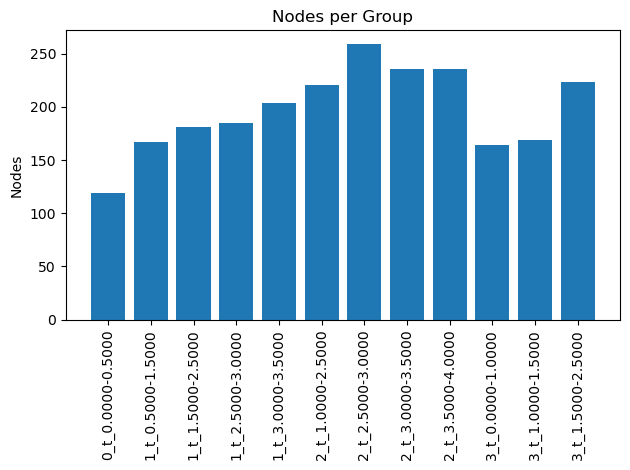

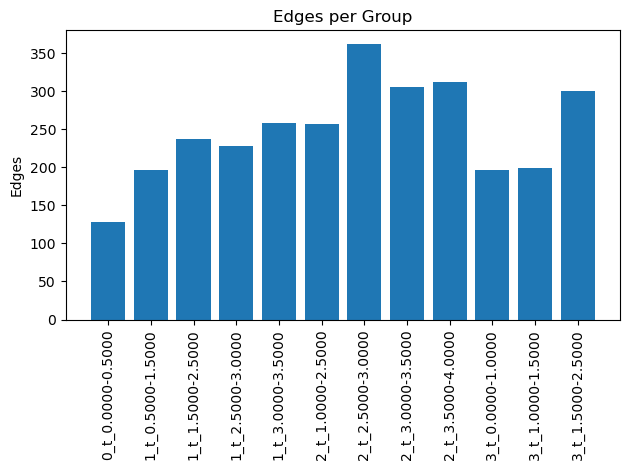

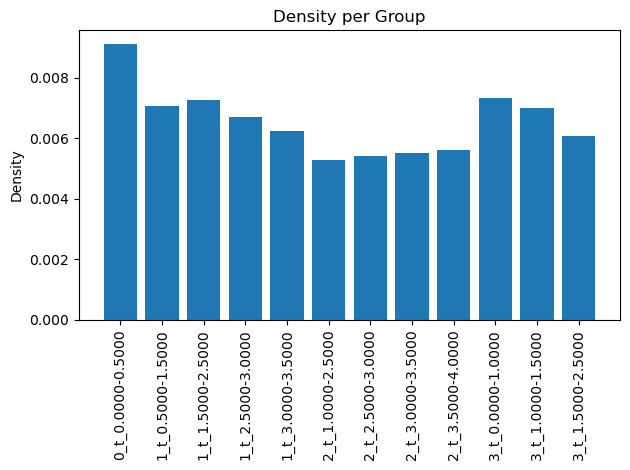

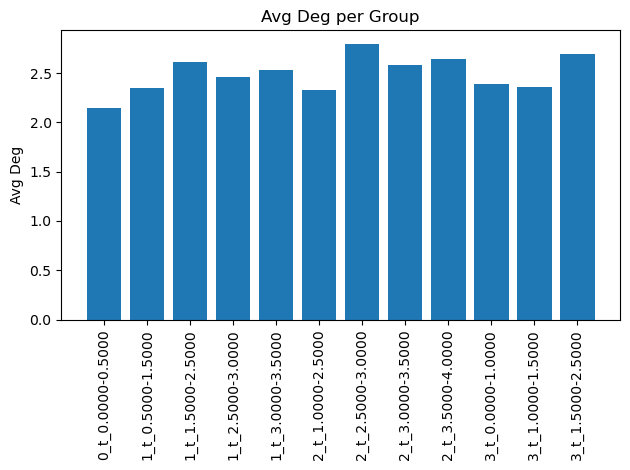

In [44]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# --- 1. Compute metrics per group subgraph ------------------
metrics = []
for grp, sub in group_graphs.items():
    n     = sub.vcount()
    m     = sub.ecount()
    dens  = sub.density()
    avgd  = np.mean(sub.degree()) if n>0 else 0
    metrics.append((grp, n, m, dens, avgd))

metrics = pd.DataFrame(metrics, columns=["group","nodes","edges","density","avg_deg"])
metrics = metrics.sort_values("group")

# Show the table
print(metrics)

# --- 2. Plot each metric in its own figure ---------------
for metric in ["nodes","edges","density","avg_deg"]:
    plt.figure()
    plt.bar(metrics["group"], metrics[metric])
    plt.xticks(rotation=90)
    plt.ylabel(metric.replace("_"," ").title())
    plt.title(f"{metric.replace('_',' ').title()} per Group")
    plt.tight_layout()
    plt.show()



In [45]:
g

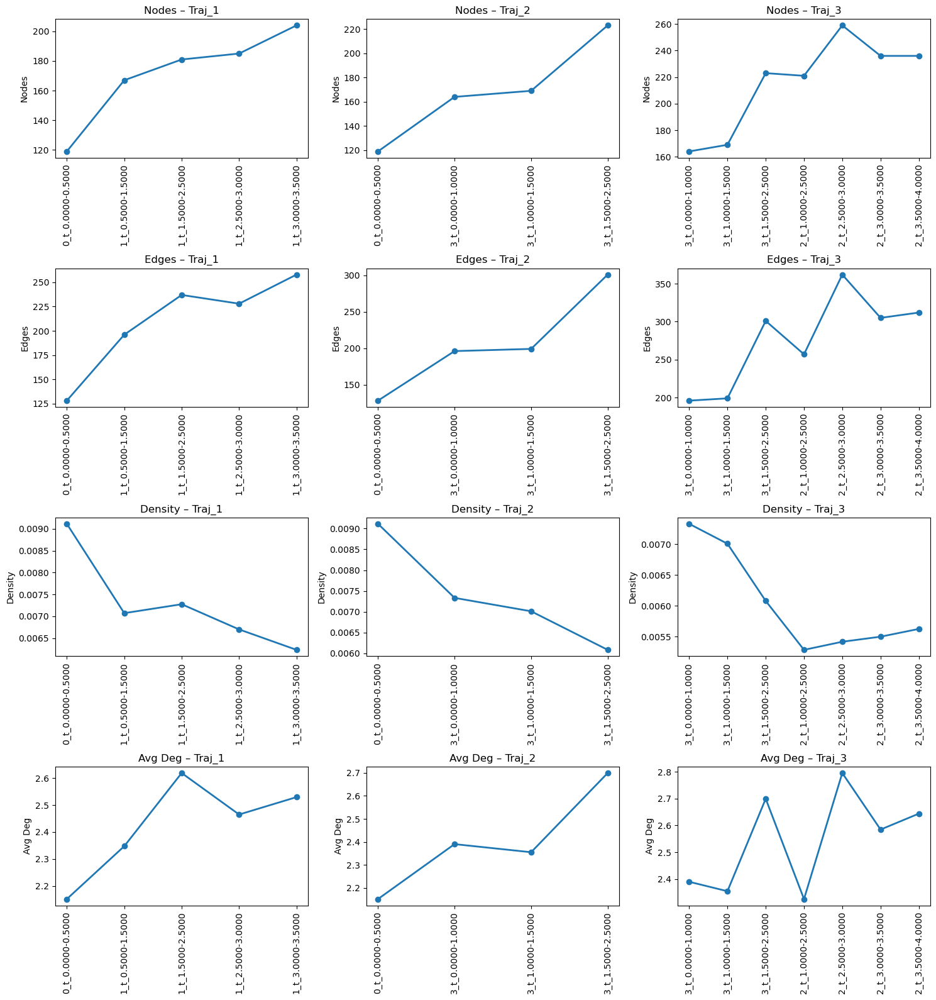

In [46]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import linregress

# --- 1. Compute metrics per group subgraph ------------------
metrics = []
for grp, sub in group_graphs.items():
    n     = sub.vcount()
    m     = sub.ecount()
    dens  = sub.density()
    avgd  = np.mean(sub.degree()) if n > 0 else 0
    metrics.append((grp, n, m, dens, avgd))

metrics = pd.DataFrame(metrics, columns=["group", "nodes", "edges", "density", "avg_deg"])
metrics = metrics.sort_values("group")

# --- 2. Define trajectories ------------------
trajectories = {
    "Traj_1": ["0_t_0.0000-0.5000", "1_t_0.5000-1.5000", "1_t_1.5000-2.5000", "1_t_2.5000-3.0000", "1_t_3.0000-3.5000"],
    "Traj_2": ["0_t_0.0000-0.5000", "3_t_0.0000-1.0000", "3_t_1.0000-1.5000", "3_t_1.5000-2.5000"],
    "Traj_3": ["3_t_0.0000-1.0000", "3_t_1.0000-1.5000", "3_t_1.5000-2.5000", "2_t_1.0000-2.5000", 
               "2_t_2.5000-3.0000", "2_t_3.0000-3.5000", "2_t_3.5000-4.0000"]
}

# --- 3. Create subpanels: one row per metric, one column per trajectory ---
metrics_to_plot = ["nodes", "edges", "density", "avg_deg"]
n_metrics = len(metrics_to_plot)
n_trajectories = len(trajectories)

fig, axes = plt.subplots(nrows=n_metrics, ncols=n_trajectories, figsize=(5 * n_trajectories, 4 * n_metrics), sharex=False)

for row_idx, metric in enumerate(metrics_to_plot):
    for col_idx, (traj_name, traj_groups) in enumerate(trajectories.items()):
        ax = axes[row_idx, col_idx]

        traj_df = metrics[metrics["group"].isin(traj_groups)].copy()
        traj_df["group"] = pd.Categorical(traj_df["group"], categories=traj_groups, ordered=True)
        traj_df = traj_df.sort_values("group")

        ax.plot(traj_df["group"], traj_df[metric], marker='o', linewidth=2)
        ax.set_title(f"{metric.replace('_', ' ').title()} – {traj_name}")
        ax.set_ylabel(metric.replace("_", " ").title())
        ax.tick_params(axis='x', rotation=90)

plt.tight_layout()
plt.show()


In [47]:
g

### Degree distribution

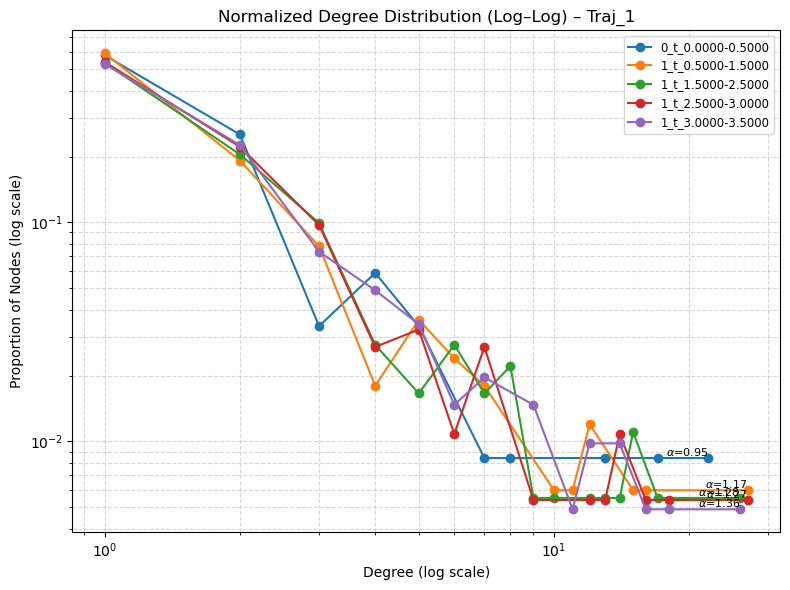

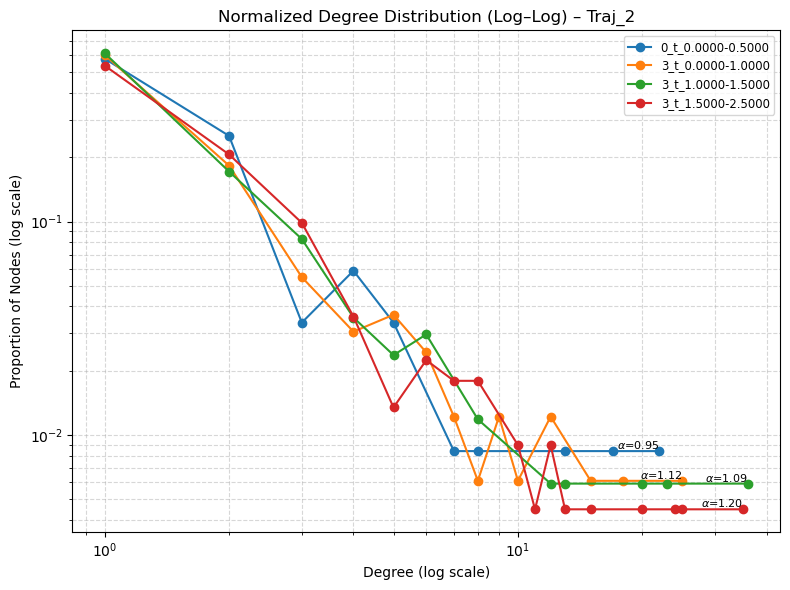

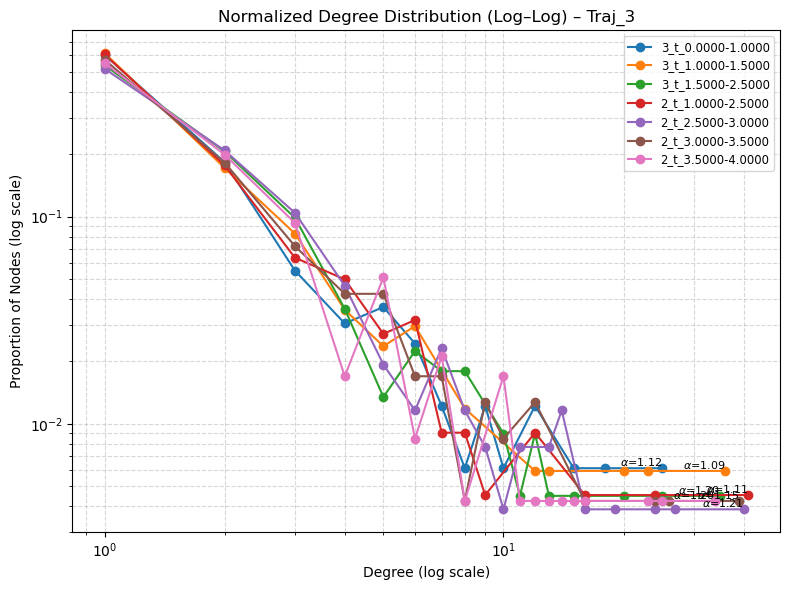

In [48]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import linregress

# --- Define trajectories ---
trajectories = {
    "Traj_1": ["0_t_0.0000-0.5000", "1_t_0.5000-1.5000", "1_t_1.5000-2.5000", "1_t_2.5000-3.0000", "1_t_3.0000-3.5000"],
    "Traj_2": ["0_t_0.0000-0.5000", "3_t_0.0000-1.0000", "3_t_1.0000-1.5000", "3_t_1.5000-2.5000"],
    "Traj_3": ["3_t_0.0000-1.0000", "3_t_1.0000-1.5000", "3_t_1.5000-2.5000", "2_t_1.0000-2.5000", 
               "2_t_2.5000-3.0000", "2_t_3.0000-3.5000", "2_t_3.5000-4.0000"]
}

# --- Plot normalized degree distributions in log-log scale ---
for traj_name, traj_groups in trajectories.items():
    plt.figure(figsize=(8, 6))

    for group in traj_groups:
        if group not in group_graphs:
            continue

        g_sub = group_graphs[group]
        degrees = g_sub.degree()

        # Bin counts and normalize
        counts = np.bincount(degrees)
        if counts.sum() == 0:
            continue
        probs = counts / counts.sum()
        x = np.arange(len(probs))

        # Filter out zero values to avoid log(0)
        nonzero = probs > 0
        x_log = x[nonzero]
        probs_log = probs[nonzero]

        plt.plot(x_log, probs_log, marker='o', linestyle='-', label=group)

        # Fit tail to power law: P(k) ~ k^-alpha (e.g., for k >= 3)
        tail_mask = (x_log >= 3)
        if np.sum(tail_mask) > 2:
            slope, intercept, _, _, _ = linregress(np.log10(x_log[tail_mask]), np.log10(probs_log[tail_mask]))
            alpha = -slope
            plt.text(
                x_log[-1], probs_log[-1], f"$\\alpha$={alpha:.2f}", fontsize=8,
                ha="right", va="bottom"
            )

    plt.title(f"Normalized Degree Distribution (Log–Log) – {traj_name}")
    plt.xlabel("Degree (log scale)")
    plt.ylabel("Proportion of Nodes (log scale)")
    plt.xscale("log")
    plt.yscale("log")
    plt.grid(True, which="both", linestyle='--', alpha=0.5)
    plt.legend(fontsize="small", loc="upper right")
    plt.tight_layout()
    plt.show()


In [49]:
g

### Betweeness centrality

In [50]:
import os
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
from scipy.stats import linregress
from collections import defaultdict

/tmp/ipykernel_270652/470849402.py:45: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pivot = df.pivot_table(index="gene_symbol", columns="group", values="betweenness", fill_value=0)
/tmp/ipykernel_270652/470849402.py:45: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pivot = df.pivot_table(index="gene_symbol", columns="group", values="betweenness", fill_value=0)
/tmp/ipykernel_270652/470849402.py:45: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pivot = df.pivot_table(index="gene_symbol", columns="group"

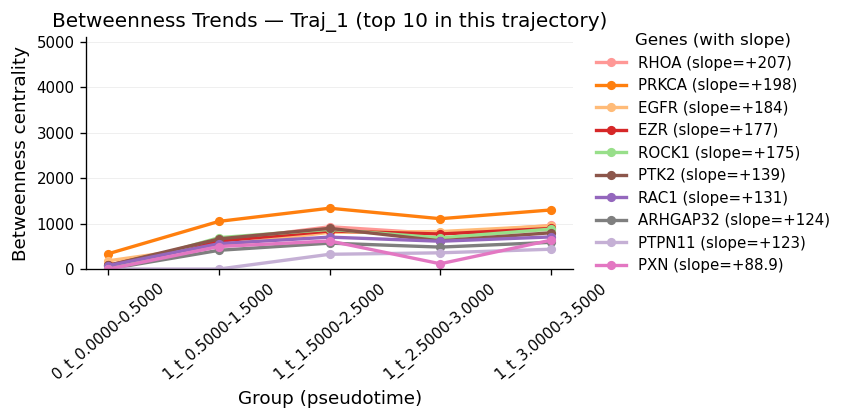

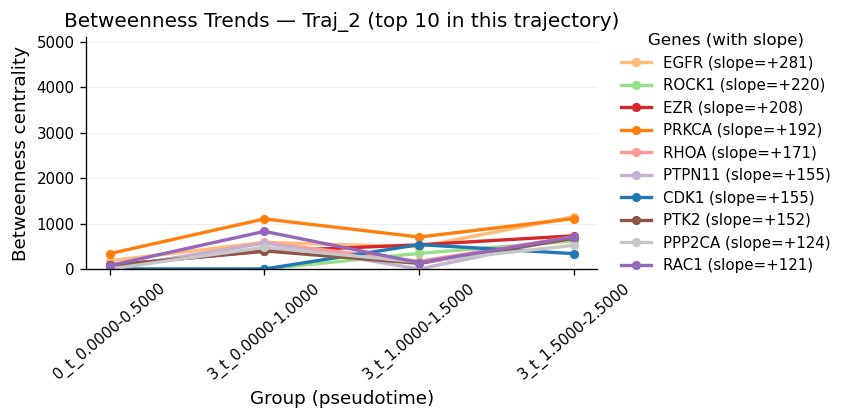

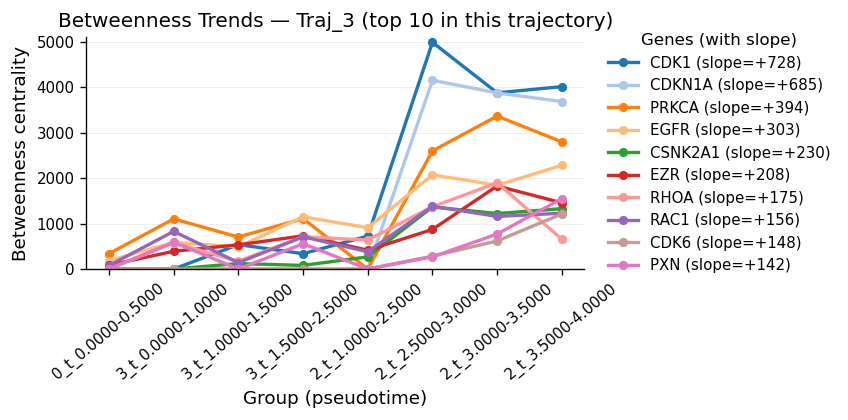

Saved figures:
 - /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/network/network_betweenness_trends_Traj_1_top10.png
 - /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/network/network_betweenness_trends_Traj_2_top10.png
 - /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/network/network_betweenness_trends_Traj_3_top10.png

Overall top-20 (fixed colors assigned):
 1. CDK1
 2. CDKN1A
 3. PRKCA
 4. EGFR
 5. CSNK2A1
 6. ROCK1
 7. EZR
 8. RHOA
 9. RAC1
10. PTPN11
11. PTK2
12. CDK6
13. PXN
14. CCND1
15. ARHGAP32
16. PPP2CA
17. ROCK2
18. PAK1
19. HDAC1
20. STAT3


In [51]:
# ---------- Settings ----------
OUTDIR = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/network"
N_SHOW = 10      # show top-10 per image
N_COLOR = 20     # assign fixed colors to overall top-20
DPI = 600
SHOW = True
YLIM = (0, 5100)

# High-quality, minimal style
mpl.rcParams.update({
    "figure.dpi": 120,
    "savefig.dpi": DPI,
    "font.size": 10,
    "axes.labelsize": 11,
    "axes.titlesize": 12,
    "legend.fontsize": 9,
    "xtick.labelsize": 9,
    "ytick.labelsize": 9,
    "axes.linewidth": 0.8,
    "lines.linewidth": 2.0,
    "lines.markersize": 4.5,
})
os.makedirs(OUTDIR, exist_ok=True)

# ---------- Your trajectories ----------
trajectories = {
    "Traj_1": ["0_t_0.0000-0.5000", "1_t_0.5000-1.5000", "1_t_1.5000-2.5000", "1_t_2.5000-3.0000", "1_t_3.0000-3.5000"],
    "Traj_2": ["0_t_0.0000-0.5000", "3_t_0.0000-1.0000", "3_t_1.0000-1.5000", "3_t_1.5000-2.5000"],
    "Traj_3": ["0_t_0.0000-0.5000", "3_t_0.0000-1.0000", "3_t_1.0000-1.5000", "3_t_1.5000-2.5000",
               "2_t_1.0000-2.5000", "2_t_2.5000-3.0000", "2_t_3.0000-3.5000", "2_t_3.5000-4.0000"]
}

# ---------- Step 1: Collect betweenness ----------
betw_data = []
for group, graph in group_graphs.items():
    btwn = graph.betweenness(directed=True)
    for v, score in zip(graph.vs, btwn):
        betw_data.append({"group": group, "gene_symbol": v["gene_symbol"], "betweenness": score})
betw_df = pd.DataFrame(betw_data)

# ---------- Helpers ----------
def slopes_for_trajectory(bdf, traj_groups):
    df = bdf[bdf["group"].isin(traj_groups)].copy()
    df["group"] = pd.Categorical(df["group"], categories=traj_groups, ordered=True)
    pivot = df.pivot_table(index="gene_symbol", columns="group", values="betweenness", fill_value=0)
    tp = np.arange(len(traj_groups))
    slope_records = []
    for gene, row in pivot.iterrows():
        y = row[traj_groups].values.astype(float)
        slope, intercept, r, pval, stderr = linregress(tp, y)
        slope_records.append((gene, slope, pval))
    slopes = pd.DataFrame(slope_records, columns=["gene_symbol", "slope", "pval"]).set_index("gene_symbol")
    return pivot, slopes

# ---------- Step 2: Compute slopes per trajectory ----------
traj_pivots, traj_slopes = {}, {}
for tname, tgroups in trajectories.items():
    pivot, slopes = slopes_for_trajectory(betw_df, tgroups)
    traj_pivots[tname] = pivot
    traj_slopes[tname] = slopes

# ---------- Step 3: Overall top genes by max |slope| across all trajectories ----------
all_slopes = defaultdict(list)
for tname, sdf in traj_slopes.items():
    for gene, s in sdf["slope"].items():
        all_slopes[gene].append(abs(s))
overall = pd.Series({gene: max(vals) for gene, vals in all_slopes.items()}).sort_values(ascending=False)

# Fixed color list = overall top-20
overall_top20 = list(overall.head(N_COLOR).index)

# ---------- Step 4: Color mapping ----------
# 20 distinct colors for the overall top-20 (tab20 has exactly 20 categorical colors)
cmap = plt.get_cmap("tab20")
gene_colors = {gene: cmap(i % 20) for i, gene in enumerate(overall_top20)}
FALLBACK = (0.6, 0.6, 0.6)  # gray for genes not in the overall top-20

# (Optional) Save the mapping for reproducibility
pd.Series(gene_colors).apply(lambda c: tuple(np.round(np.array(c[:3]), 3))).to_csv(
    os.path.join(OUTDIR, "color_map_overall_top20.csv"), header=False
)

# ---------- Step 5: Plot (show only top-10 per trajectory), save, and show ----------
saved_paths = []
for tname, tgroups in trajectories.items():
    pivot = traj_pivots[tname]

    # Slopes for this trajectory (Series indexed by gene_symbol)
    local_slopes = traj_slopes[tname]["slope"]

    # Pick top-10 by |slope| within this trajectory (only genes present in the pivot)
    local_abs = local_slopes.abs().sort_values(ascending=False)
    genes_to_plot = [gene for gene in local_abs.index if gene in pivot.index][:N_SHOW]

    # Order legend/lines by |slope| within this trajectory
    fig, ax = plt.subplots(figsize=(7.2, 3.6))
    for gene in genes_to_plot:
        y = pivot.loc[gene, tgroups].values.astype(float)
        slope_val = float(local_slopes.loc[gene]) if gene in local_slopes.index else np.nan

        line, = ax.plot(
            tgroups, y,
            marker="o", linewidth=2.0, markersize=4.5,
            label=f"{gene} (slope={slope_val:+.3g})"
        )
        line.set_color(gene_colors.get(gene, FALLBACK))  # fixed color for overall top-20; gray otherwise

    ax.set_title(f"Betweenness Trends — {tname} (top {N_SHOW} in this trajectory)")
    ax.set_xlabel("Group (pseudotime)")
    ax.set_ylabel("Betweenness centrality")

    # Fixed y-axis across all plots
    ax.set_ylim(*YLIM)
    ax.set_yticks(np.arange(YLIM[0], YLIM[1] + 1, 1000))
    ax.tick_params(axis="x", rotation=40)

    # Cosmetics
    ax.grid(True, which="major", axis="y", linewidth=0.4, alpha=0.3)
    for spine in ("top", "right"):
        ax.spines[spine].set_visible(False)

    # Legend shows gene + slope
    ax.legend(title="Genes (with slope)", loc="center left", bbox_to_anchor=(1.02, 0.5), frameon=False)
    fig.tight_layout()

    fname = f"network_betweenness_trends_{tname}_top{N_SHOW}.png"
    outpath = os.path.join(OUTDIR, fname)
    fig.savefig(outpath, bbox_inches="tight", transparent=True)
    saved_paths.append(outpath)

    if SHOW:
        plt.show()
    plt.close(fig)


print("Saved figures:")
for p in saved_paths:
    print(" -", p)

print("\nOverall top-20 (fixed colors assigned):")
for i, gene in enumerate(overall_top20, 1):
    print(f"{i:>2}. {gene}")


In [52]:
g

# 7. Calculate clusters of the network 

In [53]:
### 7. 
#take the base network or graph g, and calculate modules with MCL clustering. 
#from this make a list of node names (uniprot, gene_symbol), and the annotated MCl clister
#if symbol is not present  gte it from expr_mean
#e.g symbol_map = adata_full.var.set_index("ensembl_gene_id")["gene_symbol"].to_dict()
#expr_mean["UniProtID"]   = expr_mean.index.map(ensg2up)
#expr_mean["gene_symbol"] = expr_mean.index.map(symbol_map)
#from expr_mean get also the log2chnages and group names (columns names)
#format everything that it is compatible with gsea fgsea for python, like a typical gene set format for the gsea analysis
#than iterate the gsea through the different 

#from clusters, get a list of gene name sand cluster zugehörigkeit, and than use it as gene set for gsea, 
#and use the expression values from expre_mean or adata, to calculate enirhcment of the cluster at differnt groups as column name sin expr_mean indicate. 
#get the enrichment results and store them on analysis folder /home/job37y/Projects_shared/PANC_cancer/analysis/network_module_gsea full path or relative pat from 
# /home/job37y/Projects_shared/PANC_cancer/code/scripts_beta

In [54]:
g

In [55]:
edge_list = []
for e in g.es:
    src, tgt = g.vs[e.tuple[0]]["name"], g.vs[e.tuple[1]]["name"]
    edge_list.append({
        "source": src,
        "target": tgt,
        "type":   e["type"]
    })
edges = pd.DataFrame(edge_list)
print(edges.head())

   source  target        type
0  P0DP24  P48995  inhibition
1  Q03135  P48995  activation
2  Q14571  P48995  activation
3  Q13586  P48995  activation
4  P06493  P31350  inhibition


## 7.1 Test different inlfation values MCL cluster methods and compare modularity and number of modueles

/tmp/ipykernel_270652/3687706825.py:8: DeprecationWarning: Graph.clusters() is deprecated; use Graph.connected_components() instead
  components =g.clusters(mode="weak")


Giant comp: nodes 680 edges 1403
Original graph: 680 nodes, 1403 edges
Giant component: 680 nodes, 1403 edges
Retained in giant component: 100.0% nodes, 100.0% edges


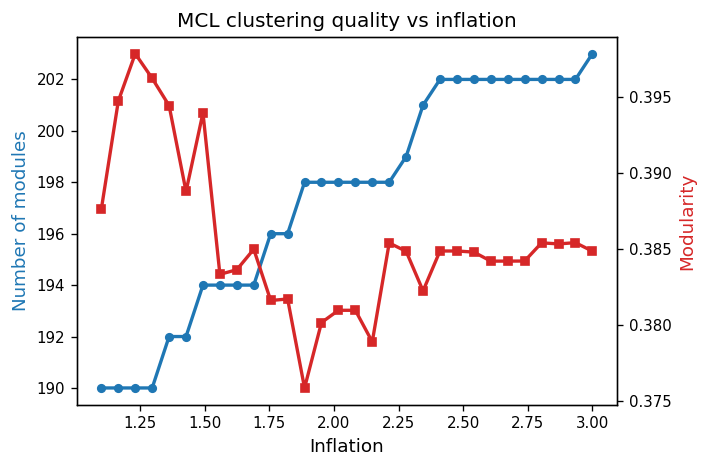

At inflation=1.50: modules=194, modularity=0.394


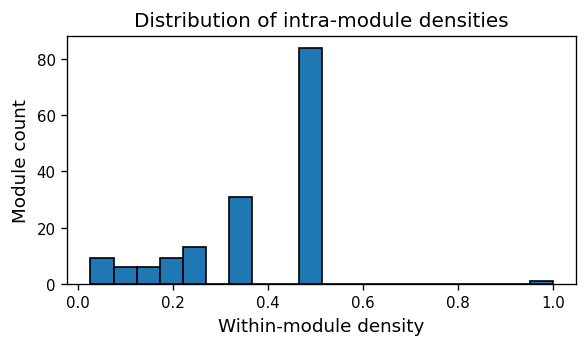

In [56]:
import numpy as np
import matplotlib.pyplot as plt
from markov_clustering import run_mcl, get_clusters

########################################
# 0.  Restrict to the giant component
########################################
components =g.clusters(mode="weak")
g0 = components.giant()   # keep only the largest connected subgraph
print("Giant comp: nodes", g0.vcount(), "edges", g0.ecount())
# map back to your original g.vs indices if needed later…


# --- Compare full graph vs giant component ---
print(f"Original graph: {g.vcount()} nodes, {g.ecount()} edges")
print(f"Giant component: {g0.vcount()} nodes, {g0.ecount()} edges")

# Optionally also the % retained
node_pct = 100 * g0.vcount() / g.vcount()
edge_pct = 100 * g0.ecount() / g.ecount()
print(f"Retained in giant component: {node_pct:.1f}% nodes, {edge_pct:.1f}% edges")



########################################
# 1.  A helper to run MCL + eval
########################################
def evaluate_mcl(graph, inflation):
    # get adjacency as array
    mx = np.array(graph.get_adjacency(attribute=None).data, dtype=float)
    pr = run_mcl(mx, inflation=inflation)
    clusters = get_clusters(pr)
    # build a flat module_id list
    module_id = np.zeros(graph.vcount(), dtype=int)
    for cid, members in enumerate(clusters):
        for vid in members:
            module_id[vid] = cid
    # compute modularity
    mod = graph.modularity(module_id)
    return len(clusters), mod, clusters

########################################
# 2.  Sweep inflation values
########################################
inflations = np.linspace(1.1, 3.0, 30)
results = []
for infl in inflations:
    ncl, mod_score, _ = evaluate_mcl(g0, inflation=infl)
    results.append((infl, ncl, mod_score))
results = np.array(results, dtype=float)
    
# plot
fig, ax1 = plt.subplots(figsize=(6,4))
ax1.plot(results[:,0], results[:,1],  marker='o', label="n_modules")
ax1.set_xlabel("Inflation")
ax1.set_ylabel("Number of modules", color="tab:blue")
ax2 = ax1.twinx()
ax2.plot(results[:,0], results[:,2],  marker='s', color="tab:red", label="modularity")
ax2.set_ylabel("Modularity", color="tab:red")
ax1.set_title("MCL clustering quality vs inflation")
fig.tight_layout()
plt.show()

########################################
# 3.  Choose an inflation & re‐run
########################################
best_infl = 1.5   # pick where modularity peaks or modules drop to your taste
ncl, mod_score, clusters = evaluate_mcl(g0, best_infl)
print(f"At inflation={best_infl:.2f}: modules={int(ncl)}, modularity={mod_score:.3f}")

# attach new modules back to g0 (or original g)
module_id = np.zeros(g0.vcount(), dtype=int)
for cid,members in enumerate(clusters):
    for vid in members:
        module_id[vid] = cid
g0.vs["module"] = module_id

########################################
# 4.  Per-module density & inter-module edges
########################################
densities = []
for cid, members in enumerate(clusters):
    sub = g0.induced_subgraph(members)
    densities.append(sub.density())
    
plt.figure(figsize=(5,3))
plt.hist(densities, bins=20, edgecolor="black")
plt.xlabel("Within-module density")
plt.ylabel("Module count")
plt.title("Distribution of intra-module densities")
plt.tight_layout()
plt.show()


## 7.2 Compare different cluster methods

Weakly-connected giant: 680 nodes, 1403 edges


/tmp/ipykernel_270652/2691517100.py:8: DeprecationWarning: Graph.clusters() is deprecated; use Graph.connected_components() instead
  comps = g.clusters(mode="weak")


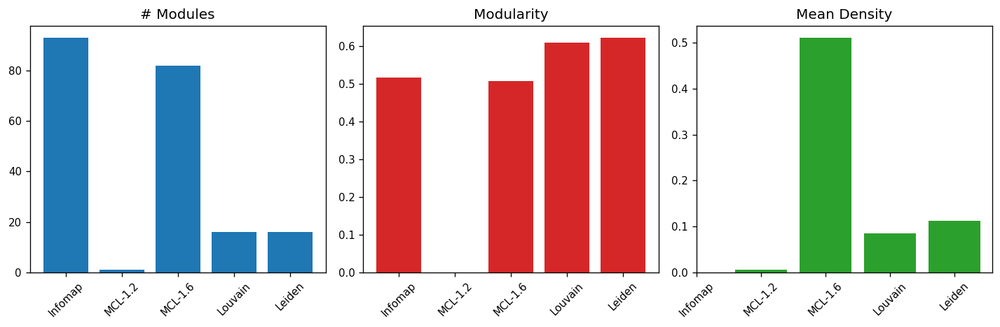

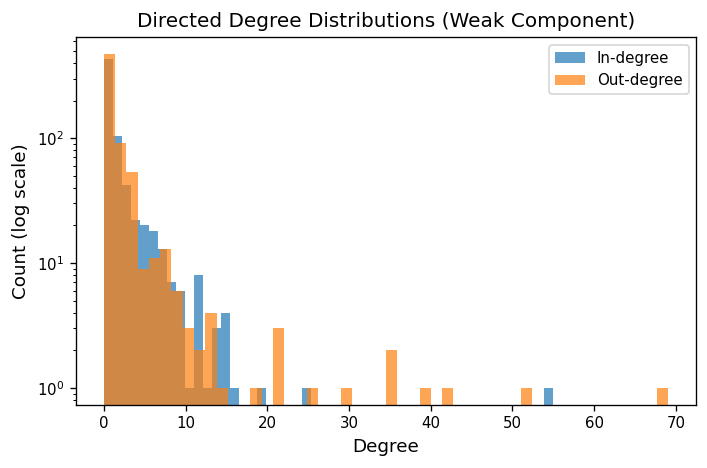

In [57]:
import numpy as np
import matplotlib.pyplot as plt
from markov_clustering import run_mcl, get_clusters
import igraph as ig
import leidenalg

# ─── 0.  Largest weakly‐connected component ─────────────────────────────────
comps = g.clusters(mode="weak")
g_weak = comps.giant()
print(f"Weakly-connected giant: {g_weak.vcount()} nodes, {g_weak.ecount()} edges")

# Prepare an undirected copy for algorithms that require it
g_undir = g_weak.as_undirected(combine_edges=None)

# ─── Helpers ──────────────────────────────────────────────────────────────────
def mcl_part(graph, inflation):
    mx = np.array(graph.get_adjacency(attribute=None).data, dtype=float)
    res = run_mcl(mx, inflation=inflation)
    cl = get_clusters(res)
    mem = np.zeros(graph.vcount(), dtype=int)
    for cid, members in enumerate(cl):
        for vid in members:
            mem[vid] = cid
    return cl, mem

def louvain_part(graph):
    part = graph.community_multilevel()
    return part, np.array(part.membership)

def leiden_part(graph, resolution=1.0):
    part = leidenalg.find_partition(
        graph,
        leidenalg.RBConfigurationVertexPartition,
        resolution_parameter=resolution
    )
    return part, np.array(part.membership)

def infomap_part(graph):
    part = graph.community_infomap(edge_weights=None, trials=10)
    return part, np.array(part.membership)

def metrics(graph, clusters, membership):
    n_mod = len(clusters)
    mod_sc = graph.modularity(membership)
    dens = [graph.induced_subgraph(c).density() for c in clusters]
    return n_mod, mod_sc, np.mean(dens)

# ─── 1.  Run clustering ────────────────────────────────────────────────────────
results = []

# 1a) Infomap (directed)
inf_cl, inf_mem = infomap_part(g_weak)
results.append(("Infomap",) + metrics(g_weak, inf_cl, inf_mem))

# 1b) MCL on UNDIRECTED weak component
mcl_cl1, mcl_mem1 = mcl_part(g_undir, inflation=1.2)
results.append(("MCL-1.2",) + metrics(g_undir, mcl_cl1, mcl_mem1))

mcl_cl2, mcl_mem2 = mcl_part(g_undir, inflation=1.6)
results.append(("MCL-1.6",) + metrics(g_undir, mcl_cl2, mcl_mem2))

# 1c) Louvain (undirected)
louv_cl, louv_mem = louvain_part(g_undir)
results.append(("Louvain",) + metrics(g_undir, louv_cl, louv_mem))

# 1d) Leiden (undirected)
lei_cl, lei_mem = leiden_part(g_undir, resolution=1.0)
results.append(("Leiden",) + metrics(g_undir, lei_cl, lei_mem))

# ─── 2.  Summarize results ────────────────────────────────────────────────────
names, nmods, mods, dens = zip(*results)
x = np.arange(len(names))

fig, axs = plt.subplots(1, 3, figsize=(12, 4))
axs[0].bar(x, nmods);   axs[0].set_xticks(x);   axs[0].set_xticklabels(names, rotation=45);   axs[0].set_title("# Modules")
axs[1].bar(x, mods, color="tab:red"); axs[1].set_xticks(x); axs[1].set_xticklabels(names, rotation=45); axs[1].set_title("Modularity")
axs[2].bar(x, dens, color="tab:green"); axs[2].set_xticks(x); axs[2].set_xticklabels(names, rotation=45); axs[2].set_title("Mean Density")
plt.tight_layout()
plt.show()

# ─── 3.  Degree distributions ─────────────────────────────────────────────────
indeg = g_weak.indegree()
outdeg = g_weak.outdegree()

plt.figure(figsize=(6, 4))
plt.hist(indeg, bins=50, alpha=0.7, label="In-degree")
plt.hist(outdeg, bins=50, alpha=0.7, label="Out-degree")
plt.yscale("log")
plt.xlabel("Degree")
plt.ylabel("Count (log scale)")
plt.title("Directed Degree Distributions (Weak Component)")
plt.legend()
plt.tight_layout()
plt.show()


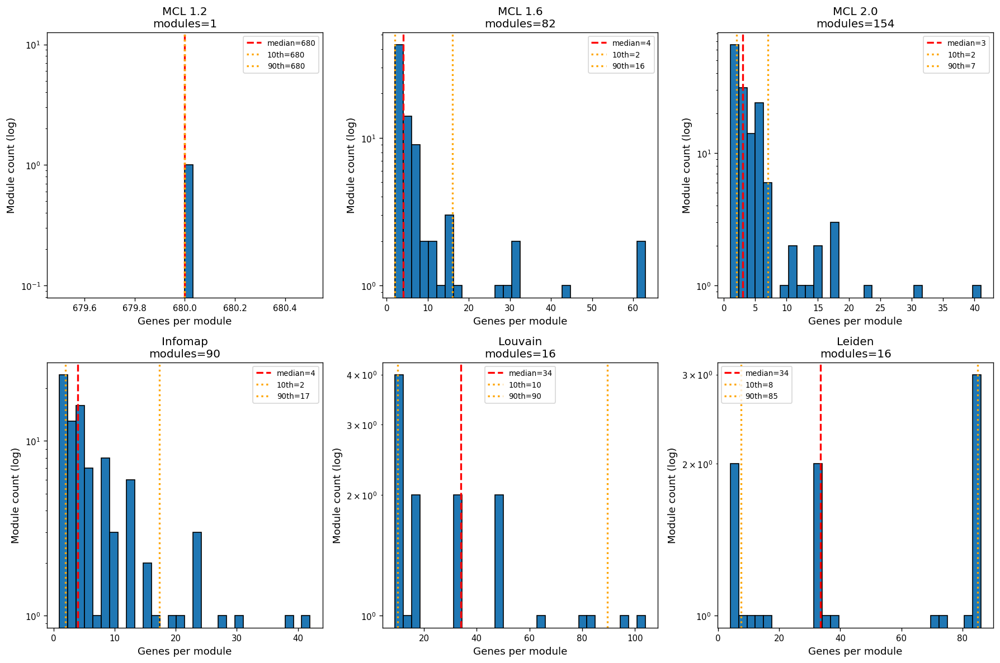

In [58]:
import numpy as np
import matplotlib.pyplot as plt
from markov_clustering import run_mcl, get_clusters
import igraph as ig
import leidenalg
from collections import Counter

# ─── Prepare the giant component & undirected copy ────────────────────────────
comps   = g.components(mode="weak")
g0      = comps.giant()
g_undir = g0.as_undirected(combine_edges=None)

# ─── Clustering functions ─────────────────────────────────────────────────────
def mcl_clusters(graph, inflation):
    mx      = np.array(graph.get_adjacency(attribute=None).data, dtype=float)
    res     = run_mcl(mx, inflation=inflation)
    cls     = get_clusters(res)
    return cls

def infomap_clusters(graph):
    part    = graph.community_infomap(edge_weights=None, trials=10)
    # igraph returns a VertexClustering object; convert to list of lists
    return [c for c in part]

def louvain_clusters(graph):
    part    = graph.community_multilevel()
    return [c for c in part]

def leiden_clusters(graph, resolution=1.0):
    part    = leidenalg.find_partition(
                  graph,
                  leidenalg.RBConfigurationVertexPartition,
                  resolution_parameter=resolution
              )
    return [ [v.index for v,m in zip(graph.vs, part.membership) if m==cid]
             for cid in set(part.membership) ]

# ─── Compute clusterings ──────────────────────────────────────────────────────
methods = [
    ("MCL 1.2",  lambda: mcl_clusters(g_undir, 1.2)),
    ("MCL 1.6",  lambda: mcl_clusters(g_undir, 1.6)),
    ("MCL 2.0",  lambda: mcl_clusters(g_undir, 2.0)),
    ("Infomap",  lambda: infomap_clusters(g0)),
    ("Louvain",  lambda: louvain_clusters(g_undir)),
    ("Leiden",   lambda: leiden_clusters(g_undir, resolution=1.0)),
]

# ─── Plot size distributions ──────────────────────────────────────────────────
fig, axes = plt.subplots(2, 3, figsize=(15,10))
axes = axes.flatten()

for ax, (name, fn) in zip(axes, methods):
    clusters = fn()
    sizes    = [len(c) for c in clusters]
    median   = np.median(sizes)
    p10, p90 = np.percentile(sizes, [10, 90])
    
    ax.hist(sizes, bins=30, edgecolor="black")
    ax.set_yscale("log")
    ax.set_title(f"{name}\nmodules={len(sizes)}")
    ax.axvline(median, color="red", linestyle="--", label=f"median={median:.0f}")
    ax.axvline(p10, color="orange", linestyle=":", label=f"10th={p10:.0f}")
    ax.axvline(p90, color="orange", linestyle=":", label=f"90th={p90:.0f}")
    ax.set_xlabel("Genes per module")
    ax.set_ylabel("Module count (log)")
    ax.legend(fontsize=8)

plt.tight_layout()
plt.show()


## 7.3 Choose a cluster method and annotate g with modules and export

In [59]:
# ===== Choose clustering method for module annotation =====
# Options: "infomap", "louvain", "leiden", "mcl"
CLUSTER_METHOD = "leiden"

# Optional params by method
LEIDEN_RESOLUTION = 1.0
MCL_INFLATION     = 1.6     # typical 1.2–2.5

# ===== Imports =====
import numpy as np
import pandas as pd
import igraph as ig
import leidenalg
from markov_clustering import run_mcl, get_clusters

# ===== 0) Giant weakly connected component (keeps g safe) =====
comps = g.components(mode="weak")
g0 = comps.giant()                           # work graph
print(f"weak GCC: {g0.vcount()} nodes, {g0.ecount()} edges")

# Ensure a good 'name' and gene_symbol columns
if "name" not in g0.vs.attribute_names():
    g0.vs["name"] = [f"v{i}" for i in range(g0.vcount())]
if "gene_symbol" not in g0.vs.attribute_names():
    g0.vs["gene_symbol"] = g0.vs["name"]

# Undirected copy for methods that need it
g_undir = g0.as_undirected(combine_edges=None)

# ===== 1) Clustering runners (return membership: list[int] length = vcount) =====
def run_infomap_directed(G: ig.Graph):
    part = G.community_infomap(edge_weights=None, trials=10)
    return part.membership

def run_louvain_undirected(G: ig.Graph):
    part = G.community_multilevel()
    return list(part.membership)

def run_leiden_undirected(G: ig.Graph, resolution=1.0):
    part = leidenalg.find_partition(
        G, leidenalg.RBConfigurationVertexPartition,
        resolution_parameter=resolution
    )
    return list(part.membership)

def run_mcl_undirected(G: ig.Graph, inflation=1.6):
    # adjacency -> MCL -> clusters -> membership
    mx = np.array(G.get_adjacency(attribute=None).data, dtype=float)
    res = run_mcl(mx, inflation=inflation)
    clusters = get_clusters(res)  # list of lists of vertex indices
    membership = np.zeros(G.vcount(), dtype=int)
    for cid, members in enumerate(clusters):
        for vid in members:
            membership[vid] = cid
    return membership.tolist()

# ===== 2) Pick method & compute membership =====
method = CLUSTER_METHOD.lower()
if method == "infomap":
    membership = run_infomap_directed(g0)            # directed
elif method == "louvain":
    membership = run_louvain_undirected(g_undir)     # undirected
elif method == "leiden":
    membership = run_leiden_undirected(g_undir, resolution=LEIDEN_RESOLUTION)
elif method == "mcl":
    membership = run_mcl_undirected(g_undir, inflation=MCL_INFLATION)
else:
    raise ValueError("CLUSTER_METHOD must be one of: infomap, louvain, leiden, mcl")

# Annotate modules
g0.vs["module"] = membership
n_modules = len(set(membership))
print(f"[{CLUSTER_METHOD}] modules = {n_modules}")

# ===== 3) Build vertex & edge tables; print head =====
vertices = pd.DataFrame({
    "UniProtID":   g0.vs["name"],
    "gene_symbol": g0.vs["gene_symbol"],
    "module":      g0.vs["module"]
})
print("\nVertices (head):")
print(vertices.head(10).to_string(index=False))

edge_rows = []
etype_present = "type" in g0.es.attribute_names()
for e in g0.es:
    s, t = e.tuple
    edge_rows.append({
        "source": g0.vs[s]["name"],
        "target": g0.vs[t]["name"],
        "type":   e["type"] if etype_present else "interacts_with"
    })
edges = pd.DataFrame(edge_rows)
print("\nEdges (head):")
print(edges.head(10).to_string(index=False))

# ===== 4) Hand back the annotated giant as your working graph =====
g = g0


weak GCC: 680 nodes, 1403 edges
[leiden] modules = 18

Vertices (head):
UniProtID gene_symbol  module
   P0DP24       CALM3       0
   P48995       TRPC1       6
   Q03135        CAV1       1
   Q14571       ITPR2       6
   Q13586       STIM1       6
   P06493        CDK1       2
   P31350        RRM2       2
   P38936      CDKN1A       4
   P04637        TP53       7
   P18847        ATF3       7

Edges (head):
source target       type
P0DP24 P48995 inhibition
Q03135 P48995 activation
Q14571 P48995 activation
Q13586 P48995 activation
P06493 P31350 inhibition
P38936 P06493 inhibition
P04637 P18847 activation
P18847 P04637 inhibition
P00519 P78527 inhibition
P78527 P00519 activation


In [60]:
import pandas as pd

# --- 1. List available attributes -----------------------
print("Vertex attributes:", g.vs.attribute_names())
print("Edge attributes:  ", g.es.attribute_names())

# --- 2. Pull out a DataFrame of vertices ---------------
vertices = pd.DataFrame({
    "UniProtID":    g.vs["name"],
    "gene_symbol":  g.vs["gene_symbol"],
    "module":  g.vs["module"],
})
print(vertices.head())

# --- 3. Pull out a DataFrame of edges ------------------
# Note: igraph edges don’t automatically carry source/target names in a column,
#       so we reconstruct them via the endpoints of each edge.
edge_list = []
for e in g.es:
    src, tgt = g.vs[e.tuple[0]]["name"], g.vs[e.tuple[1]]["name"]
    edge_list.append({
        "source": src,
        "target": tgt,
        "type":   e["type"]
    })
edges = pd.DataFrame(edge_list)
print(edges.head())


Vertex attributes: ['name', 'gene_symbol', 'module']
Edge attributes:   ['type']
  UniProtID gene_symbol  module
0    P0DP24       CALM3       0
1    P48995       TRPC1       6
2    Q03135        CAV1       1
3    Q14571       ITPR2       6
4    Q13586       STIM1       6
   source  target        type
0  P0DP24  P48995  inhibition
1  Q03135  P48995  activation
2  Q14571  P48995  activation
3  Q13586  P48995  activation
4  P06493  P31350  inhibition


In [61]:
# ─── Export as GraphML (keeps igraph attributes intact) ───────────────────────
outdir = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/network_module_gsea"
os.makedirs(outdir, exist_ok=True)
graphml_path = os.path.join(outdir, "network_modules.graphml")
g.write_graphml(graphml_path)
print("Wrote igraph GraphML to", graphml_path)

Wrote igraph GraphML to /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/network_module_gsea/network_modules.graphml


## 7.4 Viusalize network and modules: top modules

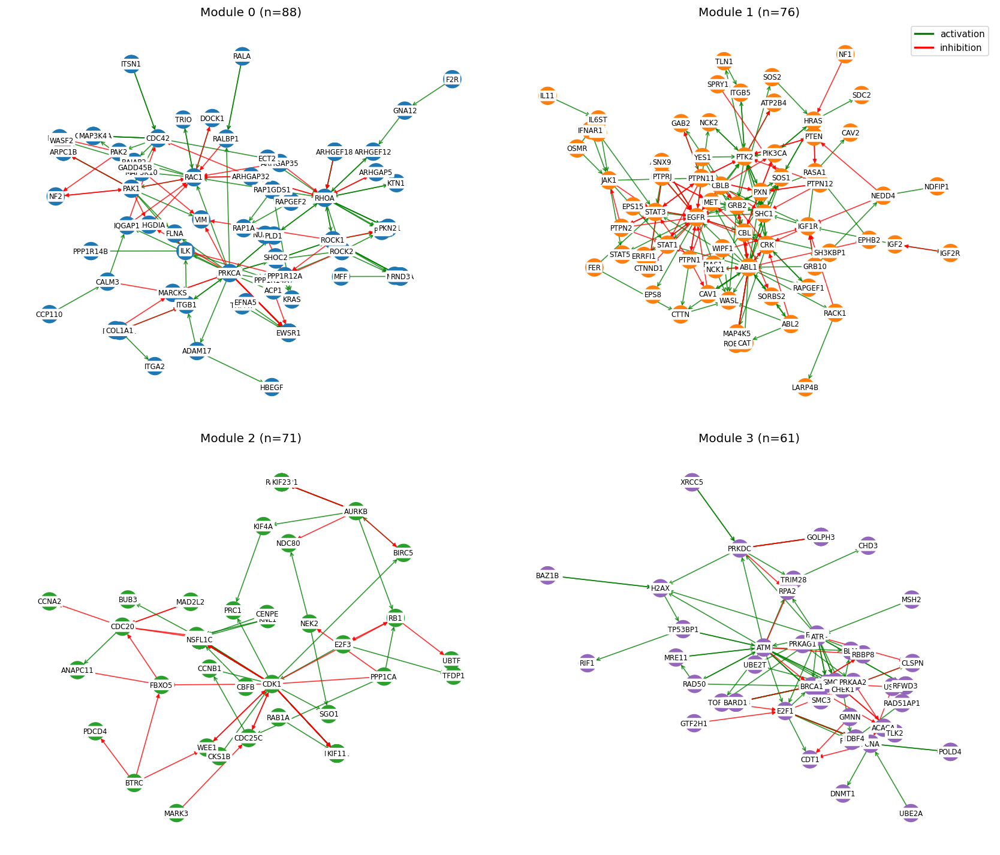

In [62]:
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.colors import rgb2hex
from collections import Counter
import numpy as np

# --- Build full NetworkX graph from igraph g ---
nxg = nx.DiGraph()
for v in g.vs:
    up = v["name"]
    nxg.add_node(up,
                 module=v["module"],
                 gene_symbol=symbol_map.get(up, up))  # gene name fallback
for e in g.es:
    src = g.vs[e.tuple[0]]["name"]
    tgt = g.vs[e.tuple[1]]["name"]
    nxg.add_edge(src, tgt, type=e["type"])

# --- Identify top-4 modules by size ---
mod_counts = Counter(nx.get_node_attributes(nxg, "module").values())
top4 = [m for m, _ in mod_counts.most_common(8)]

# --- Assign consistent module colors ---
palette = plt.cm.tab10(np.linspace(0, 1, len(top4)))
mod2color = {mod: rgb2hex(palette[i]) for i, mod in enumerate(top4)}

# --- Prepare subplots ---
fig, axs = plt.subplots(2, 2, figsize=(14, 12))
axs = axs.flatten()

for ax, mod in zip(axs, top4):
    # Subgraph for this module
    members = [n for n, d in nxg.nodes(data=True) if d["module"] == mod]
    subg = nxg.subgraph(members)
    
    # Use better layout to reduce overlap
    pos = nx.kamada_kawai_layout(subg)  # better than spring for small graphs

    # Assign module color to all nodes in this subgraph
    node_colors = [mod2color[mod]] * len(subg.nodes)

    # Show labels only for high-degree nodes
    degrees = dict(subg.degree())
    threshold = np.percentile(list(degrees.values()), 5)
    top_deg_nodes = [n for n, d in degrees.items() if d >= threshold]
    labels = {n: subg.nodes[n]["gene_symbol"] for n in top_deg_nodes}

    # Split edges by type
    act_edges = [(u, v) for u, v, d in subg.edges(data=True) if d["type"] == "activation"]
    inh_edges = [(u, v) for u, v, d in subg.edges(data=True) if d["type"] == "inhibition"]

    # Draw nodes
    nx.draw_networkx_nodes(subg, pos,
                           node_color=node_colors,
                           node_size=300,
                           ax=ax)

    # Draw activation edges
    nx.draw_networkx_edges(subg, pos,
                           edgelist=act_edges,
                           edge_color="green",
                           arrowstyle='->',
                           arrowsize=8,
                           alpha=0.8,
                           ax=ax)

    # Draw inhibition edges
    nx.draw_networkx_edges(subg, pos,
                           edgelist=inh_edges,
                           edge_color="red",
                           arrowstyle='-|>',
                           arrowsize=8,
                           alpha=0.8,
                           ax=ax)

    # Draw readable labels (high-degree only)
    nx.draw_networkx_labels(subg, pos,
                            labels=labels,
                            font_size=7,
                            font_color="black",
                            bbox=dict(facecolor="white", edgecolor="none", boxstyle="round,pad=0.2"),
                            ax=ax)

    ax.set_title(f"Module {mod} (n={mod_counts[mod]})")
    ax.axis("off")

# --- Add global legend ---
handles = [
    plt.Line2D([0], [0], color="green", lw=2, label="activation"),
    plt.Line2D([0], [0], color="red", lw=2, label="inhibition"),
]
axs[1].legend(handles=handles, loc="upper right", fontsize=9)

plt.tight_layout()
plt.show()


In [63]:
def get_module_for_gene(G, gene_symbol):
    """Return module ID(s) for a given gene_symbol in graph G."""
    if "gene_symbol" not in G.vs.attribute_names():
        raise ValueError("Graph does not have a 'gene_symbol' attribute.")
    matches = [v["module"] for v in G.vs if v["gene_symbol"] == gene_symbol]
    return set(matches) if matches else None

# Examples:
print("SMAD3 →", get_module_for_gene(g, "SMAD3"))
print("WEE1  →", get_module_for_gene(g, "WEE1"))
print("CDK1  →", get_module_for_gene(g, "CDK1"))
print("CDKN1A  →", get_module_for_gene(g, "CDKN1A"))

SMAD3 → {9}
WEE1  → {2}
CDK1  → {2}
CDKN1A  → {4}


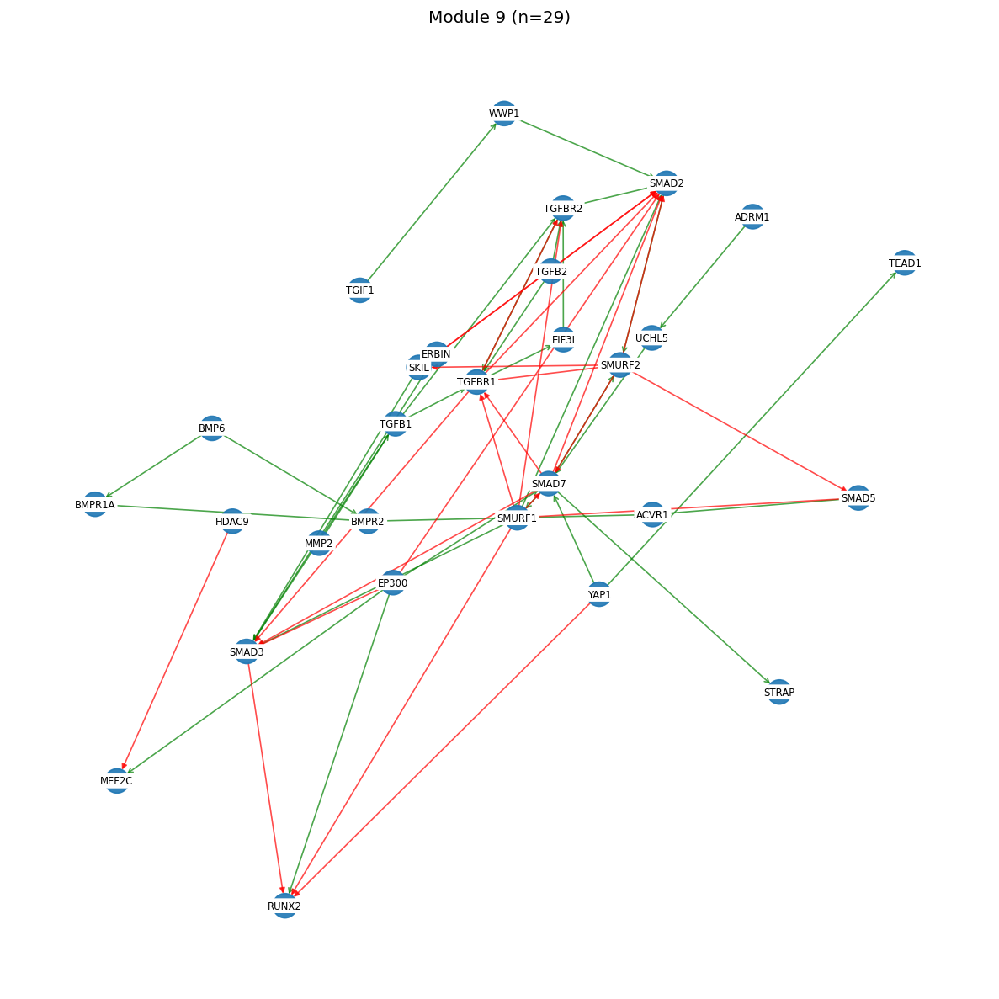

In [64]:
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.colors import rgb2hex
import numpy as np

# ─── Convert igraph → NetworkX with annotations ──────────────────────────────
nxg = nx.DiGraph()

for v in g.vs:
    ensg = v["name"]
    nxg.add_node(ensg,
                 module=v["module"],
                 gene_symbol=v["gene_symbol"])  # taken directly from g.vs

for e in g.es:
    src = g.vs[e.source]["name"]
    tgt = g.vs[e.target]["name"]
    nxg.add_edge(src, tgt, type=e["type"])

# ─── Select module and subgraph ───────────────────────────────────────────────
mod_id = 9
members = [n for n, d in nxg.nodes(data=True) if d["module"] == mod_id]
subg = nxg.subgraph(members).copy()

# ─── Layout ───────────────────────────────────────────────────────────────────
pos = nx.spring_layout(subg, seed=42, k=0.4)

# ─── Node coloring (uniform by module) ────────────────────────────────────────
node_color = rgb2hex(plt.cm.tab10(mod_id % 1))
node_colors = [node_color] * len(subg.nodes)

# ─── Labels: show gene_symbol ─────────────────────────────────────────────────
labels = {n: d["gene_symbol"] for n, d in subg.nodes(data=True)}

# ─── Edge types (activation/inhibition) ───────────────────────────────────────
act_edges = [(u, v) for u, v, d in subg.edges(data=True) if d["type"] == "activation"]
inh_edges = [(u, v) for u, v, d in subg.edges(data=True) if d["type"] == "inhibition"]

# ─── Plot ─────────────────────────────────────────────────────────────────────
plt.figure(figsize=(10, 10))

# Draw nodes
nx.draw_networkx_nodes(subg, pos,
                       node_color=node_colors,
                       node_size=300,
                       alpha=0.9)

# Draw activation edges (green)
nx.draw_networkx_edges(subg, pos,
                       edgelist=act_edges,
                       edge_color="green",
                       arrowstyle='->',
                       arrowsize=8,
                       alpha=0.7)

# Draw inhibition edges (red)
nx.draw_networkx_edges(subg, pos,
                       edgelist=inh_edges,
                       edge_color="red",
                       arrowstyle='-|>',
                       arrowsize=8,
                       alpha=0.7)

# Draw gene symbol labels
nx.draw_networkx_labels(subg, pos,
                        labels=labels,
                        font_size=7,
                        font_color="black",
                        bbox=dict(facecolor="white", edgecolor="none", boxstyle="round,pad=0.2"))

plt.title(f"Module {mod_id} (n={len(subg.nodes)})")
plt.axis("off")
plt.tight_layout()
plt.show()


## 7.5 Save graph object g

In [65]:
import pandas as pd
import igraph as ig

# ----------------------------
# 1. Inspect attributes
# ----------------------------
print("📌 Vertex attributes:", g.vs.attributes())
print("📌 Edge attributes:", g.es.attributes())
print(f"🔢 Vertices: {g.vcount()}, Edges: {g.ecount()}")

# ----------------------------
# 2. Vertex attributes DataFrame
# ----------------------------
vertex_df = pd.DataFrame({attr: g.vs[attr] for attr in g.vs.attributes()})
print("\n🧬 Vertex table (all attributes):")
print(vertex_df.head(10))   # preview first 10

# ----------------------------
# 3. Edge attributes DataFrame
# ----------------------------
edge_attr_dict = {attr: g.es[attr] for attr in g.es.attributes()}
edge_df = pd.DataFrame(edge_attr_dict)

# Add endpoints
src = [e.tuple[0] for e in g.es]
tgt = [e.tuple[1] for e in g.es]
edge_df.insert(0, "source_idx", src)
edge_df.insert(1, "target_idx", tgt)

# Map to Ensembl IDs (or names)
if "name" in g.vs.attributes():
    idx2name = dict(enumerate(g.vs["name"]))
    edge_df["source_name"] = [idx2name[i] for i in src]
    edge_df["target_name"] = [idx2name[i] for i in tgt]

print("\n🕸️ Edge table (all attributes):")
print(edge_df.head(10))   # preview first 10

# ----------------------------
# 4. Save graph with attributes
# ----------------------------
g.write_graphml("/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/graph_with_attributes.graphml")
print("\n💾 Saved graph as 'graph_with_attributes.graphml' (keeps all attributes).")

# Optional: also save CSVs for inspection
vertex_df.to_csv("/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/graph_vertices.csv", index=False)
edge_df.to_csv("/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/graph_edges.csv", index=False)
print("💾 Also saved 'graph_vertices.csv' and 'graph_edges.csv'")


📌 Vertex attributes: ['name', 'gene_symbol', 'module']
📌 Edge attributes: ['type']
🔢 Vertices: 680, Edges: 1403

🧬 Vertex table (all attributes):
     name gene_symbol  module
0  P0DP24       CALM3       0
1  P48995       TRPC1       6
2  Q03135        CAV1       1
3  Q14571       ITPR2       6
4  Q13586       STIM1       6
5  P06493        CDK1       2
6  P31350        RRM2       2
7  P38936      CDKN1A       4
8  P04637        TP53       7
9  P18847        ATF3       7

🕸️ Edge table (all attributes):
   source_idx  target_idx        type source_name target_name
0           0           1  inhibition      P0DP24      P48995
1           2           1  activation      Q03135      P48995
2           3           1  activation      Q14571      P48995
3           4           1  activation      Q13586      P48995
4           5           6  inhibition      P06493      P31350
5           7           5  inhibition      P38936      P06493
6           8           9  activation      P04637      P1

# 8. Add node attributes: Expression values and add gene annotaiton (gene_symbol, enesembl_gene_id, uniprot_id)

## 8.1 Define a expr_mean table with Uniport_ID as leadign ID

In [66]:
expr_mean

,0_t_0.0000-0.5000,3_t_1.0000-1.5000,3_t_0.0000-1.0000,3_t_1.5000-2.5000,2_t_3.5000-4.0000,1_t_0.5000-1.5000,2_t_1.0000-2.5000,1_t_3.0000-3.5000,1_t_1.5000-2.5000,1_t_2.5000-3.0000,2_t_2.5000-3.0000,2_t_3.0000-3.5000,UniProtID,gene_symbol
ENSG00000187634,0.099369,0.058846,0.066700,0.112531,0.162974,0.214113,0.185448,0.184487,0.290847,0.192041,0.344073,0.210666,Q96NU1,SAMD11
ENSG00000188290,0.728537,0.866194,0.699570,1.101085,1.385252,1.715819,1.912032,1.365245,1.408131,1.325606,1.747709,1.606269,Q9HCC6,HES4
ENSG00000187608,0.291571,0.330329,0.242814,0.475130,0.304981,0.523779,0.639019,0.272351,0.405396,0.329586,0.331405,0.343650,P05161,ISG15
ENSG00000078808,0.479059,0.563355,0.574328,0.517743,0.574268,0.526164,0.581868,0.511637,0.496302,0.495905,0.604565,0.560752,Q9BRK5,SDF4
ENSG00000160087,0.205096,0.236239,0.211886,0.341432,0.244610,0.239008,0.366078,0.250638,0.284698,0.279735,0.379937,0.285058,Q8N2K1,UBE2J2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000212907,1.403289,1.270650,1.224059,1.160672,0.923706,1.369050,1.016627,1.044514,1.130702,1.138607,1.189642,1.006450,P03901,MT-ND4L
ENSG00000198886,3.390511,3.408980,3.277259,3.241845,3.001662,3.376153,3.096779,2.947157,3.164708,3.129170,3.223900,3.042403,P03905,MT-ND4
ENSG00000198786,1.721488,1.673796,1.672979,1.665568,1.532841,1.689483,1.436786,1.477971,1.453489,1.575150,1.459676,1.421900,P03915,MT-ND5
ENSG00000198695,0.687941,0.731158,0.716898,0.685877,0.556408,0.750087,0.575130,0.683552,0.664187,0.649386,0.594438,0.631970,P03923,MT-ND6


In [67]:
import re
import numpy as np
import pandas as pd

# --- 0) Identify expression columns in expr_mean ---
EXPR_COLS = [c for c in expr_mean.columns if c not in {"UniProtID", "gene_symbol"}]

# --- 1) Make a clean, exploded table (handles many-to-many Ensembl↔UniProt) ---
def split_uniprot(s):
    if pd.isna(s):
        return []
    parts = re.split(r"[;,|\s]+", str(s).strip())
    return [p for p in parts if p]

# expr_mean has Ensembl IDs as index; make it a column
df = expr_mean.copy().rename_axis("ensembl_gene_id").reset_index()

# normalize UniProt and explode to one row per (Ensembl, UniProt)
df_exploded = (
    df.assign(UniProtID=lambda d: d["UniProtID"].apply(split_uniprot))
      .explode("UniProtID", ignore_index=True)
)
df_exploded = df_exploded[df_exploded["UniProtID"].notna() & (df_exploded["UniProtID"] != "")]
df_exploded = df_exploded.drop_duplicates(subset=["ensembl_gene_id", "UniProtID"])

# --- 2) Leading UniProt per Ensembl (pick the first) ---
first_uniprot = (
    df_exploded.sort_values(["ensembl_gene_id", "UniProtID"])
               .groupby("ensembl_gene_id", as_index=False)
               .first()[["ensembl_gene_id", "UniProtID"]]
)

# --- 3) Attach gene_symbol (from original df) ---
sym = df[["ensembl_gene_id", "gene_symbol"]].drop_duplicates("ensembl_gene_id")
expr_mean2 = first_uniprot.merge(sym, on="ensembl_gene_id", how="left")

# --- 4) Add cluster_id from the graph (use g.vs['module']) ---
# graph uses UniProt IDs in g.vs["name"]
if "module" in g.vs.attributes():
    g_df = pd.DataFrame({"UniProtID": g.vs["name"], "cluster_id": g.vs["module"]})
    expr_mean2 = expr_mean2.merge(g_df, on="UniProtID", how="left")
else:
    expr_mean2["cluster_id"] = np.nan  # if no module present

# --- 5) Add the expression columns to expr_mean2 ---
expr_mean2 = expr_mean2.merge(
    df[["ensembl_gene_id"] + EXPR_COLS],
    on="ensembl_gene_id",
    how="left"
)

# Reorder columns nicely
expr_mean2 = expr_mean2[
    ["ensembl_gene_id", "UniProtID", "gene_symbol", "cluster_id"] + EXPR_COLS
]

print("✅ Built expr_mean2 with leading UniProt per Ensembl.")
print(expr_mean2.head(10))

# --- 6) Add ensembl_gene_id to graph g ---
# Build UniProt → Ensembl (primary) from the exploded mapping
uid2ensg_list = (
    df_exploded.groupby("UniProtID")["ensembl_gene_id"]
               .apply(lambda s: list(dict.fromkeys(s)))
               .to_dict()
)
uid2ensg_primary = {u: (v[0] if len(v) else "") for u, v in uid2ensg_list.items()}

# Write attributes to graph (keep name = UniProt)
g.vs["uniprot_id"] = g.vs["name"]
g.vs["ensembl_gene_id_list"] = [uid2ensg_list.get(u, []) for u in g.vs["uniprot_id"]]
g.vs["ensembl_gene_id"]      = [uid2ensg_primary.get(u, "") for u in g.vs["uniprot_id"]]

print("✅ Graph updated with 'ensembl_gene_id' (primary) and 'ensembl_gene_id_list'.")

# --- 7) Coverage check: are all graph UniProt IDs in expr_mean/expr_mean2? ---
uids_graph = set(g.vs["uniprot_id"])
uids_expr2 = set(expr_mean2["UniProtID"])
missing_in_expr2 = sorted(uids_graph - uids_expr2)

print(f"📊 Coverage: {len(uids_graph) - len(missing_in_expr2)}/{len(uids_graph)} graph UniProt IDs found in expr_mean2.")
if missing_in_expr2:
    print("⚠️ Missing examples (up to 20):", missing_in_expr2[:20])


✅ Built expr_mean2 with leading UniProt per Ensembl.
   ensembl_gene_id UniProtID gene_symbol  cluster_id  0_t_0.0000-0.5000  \
0  ENSG00000000419    O60762        DPM1         NaN           0.301740   
1  ENSG00000001036    Q9BTY2       FUCA2         NaN           0.169524   
2  ENSG00000001084    P48506        GCLC         NaN           0.271496   
3  ENSG00000001629    Q9P2G1      ANKIB1         NaN           0.432793   
4  ENSG00000001630    Q16850     CYP51A1         NaN           0.423777   
5  ENSG00000001631    O00522       KRIT1         NaN           0.208049   
6  ENSG00000002330    Q92934         BAD         8.0           0.321253   
7  ENSG00000002586    P14209        CD99         NaN           0.810601   
8  ENSG00000003056    P20645        M6PR         NaN           0.276793   
9  ENSG00000003096    Q9P2N7      KLHL13         NaN           0.243027   

   3_t_1.0000-1.5000  3_t_0.0000-1.0000  3_t_1.5000-2.5000  2_t_3.5000-4.0000  \
0           0.335271           0.331647 

In [68]:
# Get UniProt IDs from graph
uids_graph = set(g.vs["uniprot_id"])

# Filter expr_mean2 to keep only rows with UniProtID in graph
expr_mean2 = expr_mean2[expr_mean2["UniProtID"].isin(uids_graph)].copy()

print(f"✅ Filtered expr_mean2: {expr_mean2.shape[0]} rows remain (only UniProts in graph).")

# Preview
print(expr_mean2_filtered.head(10))

# Optional: save
expr_mean2_filtered.to_csv("/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/network_module_gsea/expr_mean2.csv", index=False)
print("💾 Saved expr_mean2.csv")


✅ Filtered expr_mean2: 683 rows remain (only UniProts in graph).


NameError: name 'expr_mean2_filtered' is not defined

In [ ]:
expr_mean2

## 8.1 Process Ggraph and Expression values

In [ ]:
#adata_sync = sc.read("/storage/users/data/PANC/H5AD_file/adata_full_sync.h5ad")
#adata_full = sc.read('/storage/users/data/PANC/H5AD_file/adata_filtered_no2D.h5ad')
adata_full = sc.read('/bigstorage/users/data/PANC/H5AD_file/adata_filtered_no2D.h5ad')

In [ ]:
adata_sync

## 8.2 make new adata objet based on graph nodes and graph modules/clusters

In [ ]:
import anndata as ad
import pandas as pd
import os

# 1) Read the CSV, telling pandas to NOT treat the first column as the index yet
expr_mean2 = pd.read_csv(
    "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/network_module_gsea/expr_mean2.csv",
    header=0
)

# 2) Rename that unnamed first column to 'ensembl_gene_id'
#    (Pandas will call it 'Unnamed: 0' by default)
expr_mean2 = expr_mean2.rename(columns={"Unnamed: 0": "ensembl_gene_id"})

# 3) Drop any columns that end in '.1' (these are the duplicated UniProtID.1, gene_symbol.1)
expr_mean2 = expr_mean2.loc[:, ~expr_mean2.columns.str.endswith(".1")]

# 4) Set the new index
expr_mean2 = expr_mean2.set_index("ensembl_gene_id", drop=False)

# 5) (Optional) Reorder columns so index-like columns come first
cols = ["ensembl_gene_id", "UniProtID", "gene_symbol", "cluster_id"] + [
    c for c in expr_mean2.columns 
      if c not in ("ensembl_gene_id", "UniProtID", "gene_symbol", "cluster_id")
]
expr_mean2 = expr_mean2[cols]

# 6) Save back (or continue using 'expr_mean2` in memory)
expr_mean2.to_csv(
    "/storage/users/job37yv/Projects/PANC_cancer/analysis/"
    "network_module_gsea/expr_mean_filtered_with_cluster.cleaned.csv"
)

print(expr_mean2.head())
print("Columns:", expr_mean2.columns.tolist())


# 3) Build mapping dicts
ens_list = expr_mean2["ensembl_gene_id"].tolist()
ens2up   = dict(zip(expr_mean2["ensembl_gene_id"], expr_mean2["UniProtID"]))
ens2sym  = dict(zip(expr_mean2["ensembl_gene_id"], expr_mean2["gene_symbol"]))
ens2cl   = dict(zip(expr_mean2["ensembl_gene_id"], expr_mean2["cluster_id"]))

# 4) Subset adata_sync to only those Ensembl genes
keep = [gene for gene in adata_sync.var_names if gene in ens_list]
adata_sub = adata_sync[:, keep].copy()

# 5) Reorder to match expr_mean2 order
adata_sub = adata_sub[:, ens_list].copy()

# 6) Switch var_names to UniProtID and annotate var
uni_ids = [ens2up[ens] for ens in adata_sub.var_names]
adata_sub.var_names = ens_list
adata_sub.var["uniprot_id"] = uni_ids
adata_sub.var["ensembl_gene_id"] = ens_list
adata_sub.var["gene_symbol"]      = [ens2sym[ens] for ens in ens_list]
adata_sub.var["cluster_id"]       = [ens2cl[ens]  for ens in ens_list]

# 7) Save the new AnnData
out_path = (
    "/storage/users/job37yv/Projects/PANC_cancer/analysis"
    "/network_module_gsea/adata_sync_modules.h5ad"
)
os.makedirs(os.path.dirname(out_path), exist_ok=True)
adata_sub.write_h5ad(out_path)

print(f"New AnnData: {adata_sub.n_obs} cells × {adata_sub.n_vars} genes")
print("Var annotation columns:", list(adata_sub.var.columns))


In [ ]:
adata_sub

In [ ]:
adata_sub.write_h5ad("/bigstorage/users/data/PANC/H5AD_file/adata_sub.h5ad")

In [ ]:
adata_sub.var_names

## 8.3 Calculate Z-scores

In [ ]:
import numpy as np
import pandas as pd
import anndata as ad

# 1) Load your AnnData subset
adata_sub = ad.read_h5ad(
    "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/"
    "network_module_gsea/adata_sync_modules.h5ad"
)

# 2) Define time bins based on group key
group_key = "leiden_t_bin_merged_nicer"
all_bins  = adata_sub.obs[group_key].cat.categories.tolist()

# 3) Pull dense expression matrix
X = adata_sub.X.toarray() if hasattr(adata_sub.X, "toarray") else adata_sub.X
genes = adata_sub.var_names.tolist()

# 4) Compute mean expression per gene × bin
mean_expr = pd.DataFrame(index=genes, columns=all_bins, dtype=float)
for b in all_bins:
    mask = adata_sub.obs[group_key] == b
    mean_expr[b] = X[mask, :].mean(axis=0)

# 5) Z-score per gene (row-wise normalization)
zscore = mean_expr.sub(mean_expr.mean(axis=1), axis=0)
zscore = zscore.div(mean_expr.std(axis=1), axis=0)

# 6) Save to CSV
z_path = (
    "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/"
    "network_module_gsea/zscore_by_group.csv"
)
zscore.to_csv(z_path)
print(f"✅ Saved z-score matrix ({zscore.shape[0]} genes × {zscore.shape[1]} bins) to:\n  {z_path}")
print(zscore.head())


## 8.4 Calculate log2fold changes

In [73]:
adata_sync = sc.read("/bigstorage/users/data/PANC/H5AD_file/adata_full_sync.h5ad")

In [74]:
adata_sync.var_names

Index(['ENSG00000238009', 'ENSG00000241860', 'ENSG00000286448',
       'ENSG00000237491', 'ENSG00000177757', 'ENSG00000228794',
       'ENSG00000225880', 'ENSG00000230368', 'ENSG00000272438',
       'ENSG00000230699',
       ...
       'ENSG00000277400', 'ENSG00000274847', 'ENSG00000276256',
       'ENSG00000278198', 'ENSG00000278384', 'ENSG00000273748',
       'ENSG00000271254', 'ENSG00000276345', 'ENSG00000275869',
       'ENSG00000278817'],
      dtype='object', name='feature_id', length=26000)

In [75]:
adata_sync

AnnData object with n_obs × n_vars = 5254 × 26000
    obs: 'condition', 'pct_cmo', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'doublet_scores', 'predicted_doublets', 'outlier', 'leiden', 'leiden_t_bin_merged_nicer', 't', 'milestones'
    var: 'CMO', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'gene_symbol', 'ensembl_gene_id', 'mito', 'ribo', 'n_cells'
    uns: 'condition_colors', 'leiden', 'leiden_t_bin_merged_nicer_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [76]:
adata_sync.var_names

Index(['ENSG00000238009', 'ENSG00000241860', 'ENSG00000286448',
       'ENSG00000237491', 'ENSG00000177757', 'ENSG00000228794',
       'ENSG00000225880', 'ENSG00000230368', 'ENSG00000272438',
       'ENSG00000230699',
       ...
       'ENSG00000277400', 'ENSG00000274847', 'ENSG00000276256',
       'ENSG00000278198', 'ENSG00000278384', 'ENSG00000273748',
       'ENSG00000271254', 'ENSG00000276345', 'ENSG00000275869',
       'ENSG00000278817'],
      dtype='object', name='feature_id', length=26000)

In [77]:
g

In [78]:
import numpy as np
import pandas as pd

# ----------------------------
# 1. Extract gene IDs from both sources
# ----------------------------

# Genes in graph
genes_in_g = set(g.vs["ensembl_gene_id"])  # Ensembl gene IDs

# Genes in adata_sync
genes_in_adata = set(adata_sync.var_names)

# ----------------------------
# 2. Compare overlap
# ----------------------------
shared_genes = genes_in_g & genes_in_adata
n_total_g = len(genes_in_g)
n_total_adata = len(genes_in_adata)
n_shared = len(shared_genes)

print(f"🧠 Graph nodes:         {n_total_g}")
print(f"🧬 Genes in adata_sync: {n_total_adata}")
print(f"🔗 Shared Ensembl IDs:  {n_shared} ({n_shared / n_total_g:.1%} of graph genes)")

# ----------------------------
# 3. Subset adata_sync to those present in graph g
# ----------------------------
adata_sync_sub = adata_sync[:, adata_sync.var_names.isin(genes_in_g)].copy()
print(f"✅ Subsetted adata_sync_sub shape: {adata_sync_sub.shape} (cells × genes)")


🧠 Graph nodes:         680
🧬 Genes in adata_sync: 26000
🔗 Shared Ensembl IDs:  680 (100.0% of graph genes)
✅ Subsetted adata_sync_sub shape: (5254, 680) (cells × genes)


In [79]:
adata_sync_sub

AnnData object with n_obs × n_vars = 5254 × 680
    obs: 'condition', 'pct_cmo', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'doublet_scores', 'predicted_doublets', 'outlier', 'leiden', 'leiden_t_bin_merged_nicer', 't', 'milestones'
    var: 'CMO', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'gene_symbol', 'ensembl_gene_id', 'mito', 'ribo', 'n_cells'
    uns: 'condition_colors', 'leiden', 'leiden_t_bin_merged_nicer_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [80]:
import scanpy as sc
import pandas as pd
from tqdm import tqdm

# Settings
group_key = "leiden_t_bin_merged_nicer"
baseline = "0_t_0.0000-0.5000"
groups_to_test = [
    "1_t_0.5000-1.5000", "1_t_1.5000-2.5000", "1_t_2.5000-3.0000", "1_t_3.0000-3.5000",
    "3_t_0.0000-1.0000", "3_t_1.0000-1.5000", "3_t_1.5000-2.5000",
    "2_t_1.0000-2.5000", "2_t_2.5000-3.0000", "2_t_3.0000-3.5000", "2_t_3.5000-4.0000"
]

# Optional: check group availability
available_groups = adata_sync_sub.obs[group_key].unique().tolist()
print("📦 Available groups in adata_sync_sub:", available_groups)

# Build mapping from Ensembl → gene symbol using expr_mean index
ensg_to_symbol = expr_mean["gene_symbol"].to_dict()

# Collect results
all_de_results = []

for group in tqdm(groups_to_test, desc="Running DE vs baseline"):
    # Subset data
    subset = adata_sync_sub[adata_sync_sub.obs[group_key].isin([baseline, group])].copy()
    subset.obs["compare"] = subset.obs[group_key]

    # Run differential expression
    sc.tl.rank_genes_groups(
        subset,
        groupby="compare",
        groups=[group],
        reference=baseline,
        method="t-test",
        use_raw=False
    )

    # Extract Ensembl IDs from result (they're stored as 'names')
    ensg_ids = subset.uns["rank_genes_groups"]["names"][group]

    # Build dataframe
    de = pd.DataFrame({
        "ensembl_gene_id": ensg_ids,
        "log2fc": subset.uns["rank_genes_groups"]["logfoldchanges"][group],
        "pval": subset.uns["rank_genes_groups"]["pvals"][group],
        "padj": subset.uns["rank_genes_groups"]["pvals_adj"][group],
    })
    de["gene_symbol"] = de["ensembl_gene_id"].map(ensg_to_symbol)
    de["bin"] = group
    de["baseline"] = baseline
    de["comparison"] = f"{group}_vs_{baseline}"

    all_de_results.append(de)

# Combine results
final_de_df = pd.concat(all_de_results, ignore_index=True)

# Save to CSV
out_path = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/network_module_gsea/de_genes_groupwise_vs_baseline.csv"
final_de_df.to_csv(out_path, index=False)

# Preview
print("✅ Differential expression results shape:", final_de_df.shape)
print(final_de_df.head(5))
print(f"📁 Saved to: {out_path}")


📦 Available groups in adata_sync_sub: ['0_t_0.0000-0.5000', '3_t_1.0000-1.5000', '3_t_0.0000-1.0000', '3_t_1.5000-2.5000', '2_t_3.5000-4.0000', '1_t_0.5000-1.5000', '2_t_1.0000-2.5000', '1_t_3.0000-3.5000', '1_t_1.5000-2.5000', '1_t_2.5000-3.0000', '2_t_2.5000-3.0000', '2_t_3.0000-3.5000']


Running DE vs baseline: 100%|██████████| 11/11 [00:02<00:00,  4.53it/s]


✅ Differential expression results shape: (7480, 8)
   ensembl_gene_id    log2fc          pval          padj gene_symbol  \
0  ENSG00000149948  2.302401  4.280433e-15  9.702314e-13       HMGA2   
1  ENSG00000185825  0.925965  1.330407e-12  2.261693e-10      BCAP31   
2  ENSG00000082781  1.780782  8.594326e-12  9.740236e-10       ITGB5   
3  ENSG00000108518  0.550301  1.331776e-11  1.132009e-09        PFN1   
4  ENSG00000111145  1.570867  2.834136e-10  1.752012e-08        ELK3   

                 bin           baseline  \
0  1_t_0.5000-1.5000  0_t_0.0000-0.5000   
1  1_t_0.5000-1.5000  0_t_0.0000-0.5000   
2  1_t_0.5000-1.5000  0_t_0.0000-0.5000   
3  1_t_0.5000-1.5000  0_t_0.0000-0.5000   
4  1_t_0.5000-1.5000  0_t_0.0000-0.5000   

                               comparison  
0  1_t_0.5000-1.5000_vs_0_t_0.0000-0.5000  
1  1_t_0.5000-1.5000_vs_0_t_0.0000-0.5000  
2  1_t_0.5000-1.5000_vs_0_t_0.0000-0.5000  
3  1_t_0.5000-1.5000_vs_0_t_0.0000-0.5000  
4  1_t_0.5000-1.5000_vs_0_t_0.0000-0.

In [81]:
print(final_de_df.head())

   ensembl_gene_id    log2fc          pval          padj gene_symbol  \
0  ENSG00000149948  2.302401  4.280433e-15  9.702314e-13       HMGA2   
1  ENSG00000185825  0.925965  1.330407e-12  2.261693e-10      BCAP31   
2  ENSG00000082781  1.780782  8.594326e-12  9.740236e-10       ITGB5   
3  ENSG00000108518  0.550301  1.331776e-11  1.132009e-09        PFN1   
4  ENSG00000111145  1.570867  2.834136e-10  1.752012e-08        ELK3   

                 bin           baseline  \
0  1_t_0.5000-1.5000  0_t_0.0000-0.5000   
1  1_t_0.5000-1.5000  0_t_0.0000-0.5000   
2  1_t_0.5000-1.5000  0_t_0.0000-0.5000   
3  1_t_0.5000-1.5000  0_t_0.0000-0.5000   
4  1_t_0.5000-1.5000  0_t_0.0000-0.5000   

                               comparison  
0  1_t_0.5000-1.5000_vs_0_t_0.0000-0.5000  
1  1_t_0.5000-1.5000_vs_0_t_0.0000-0.5000  
2  1_t_0.5000-1.5000_vs_0_t_0.0000-0.5000  
3  1_t_0.5000-1.5000_vs_0_t_0.0000-0.5000  
4  1_t_0.5000-1.5000_vs_0_t_0.0000-0.5000  


# 9. Viusalize network, subnetwork and modules

## 9.1 Visualize top hub network 

### color modules

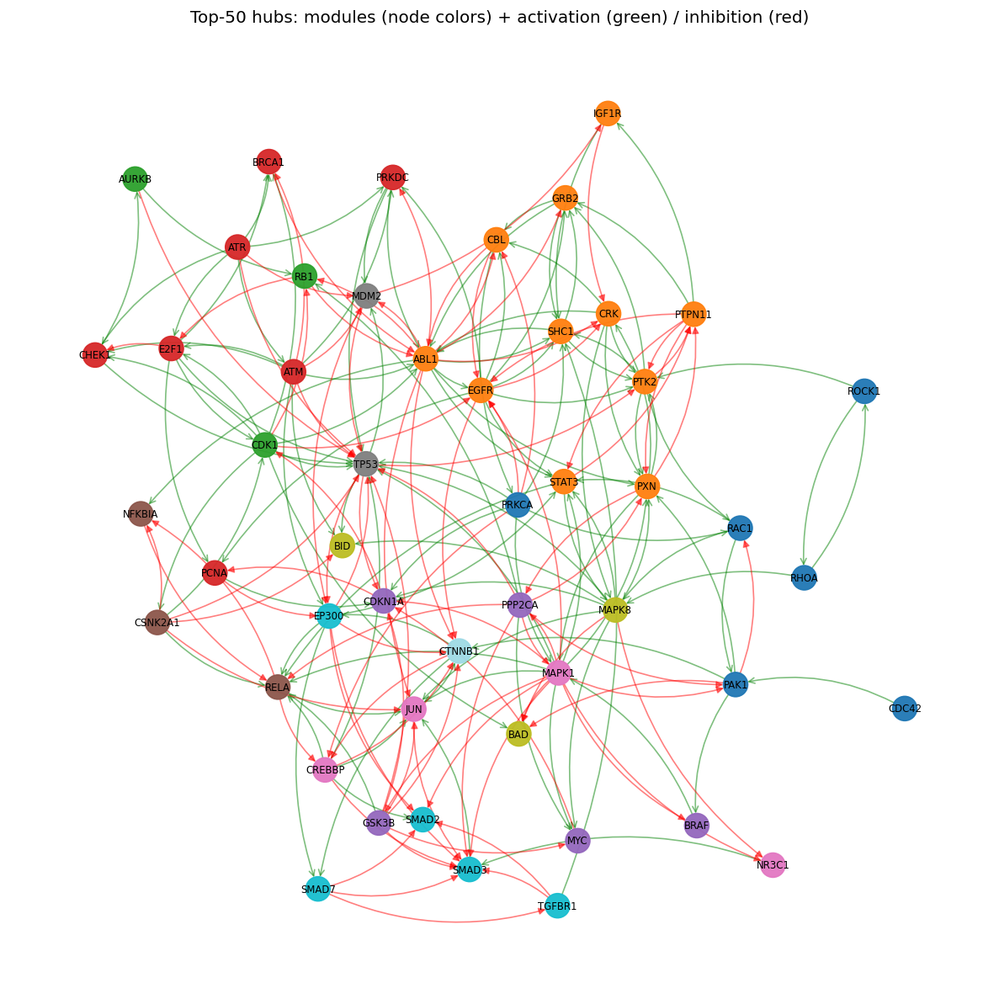

In [82]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import rgb2hex

# 1) Pick top-50 hubs by degree and induce subgraph
deg   = g.degree()
top50 = sorted(range(g.vcount()), key=lambda i: deg[i], reverse=True)[:50]
subg  = g.induced_subgraph(top50)

# 2) Build NetworkX graph with module, type, and gene_symbol
nxg = nx.DiGraph()
for v in subg.vs:
    up   = v["name"]
    mod  = v["module"]
    sym  = symbol_map.get(up, up)   # map UniProt → gene_symbol
    nxg.add_node(up, module=mod, gene_symbol=sym)

for e in subg.es:
    src = subg.vs[e.tuple[0]]["name"]
    tgt = subg.vs[e.tuple[1]]["name"]
    t   = e["type"]
    nxg.add_edge(src, tgt, type=t)

# 3) Improved layout
pos = nx.kamada_kawai_layout(nxg)  # better spacing for dense subgraphs

# 4) Prepare node colors by module
mods       = nx.get_node_attributes(nxg, "module")
unique_mod = sorted(set(mods.values()))
palette    = plt.cm.tab20(np.linspace(0, 1, len(unique_mod)))
mod2col    = {m: rgb2hex(palette[i % len(palette)]) for i, m in enumerate(unique_mod)}
node_colors = [mod2col[mods[n]] for n in nxg.nodes()]

# 5) Split edges by type
act_edges = [(u, v) for u, v, d in nxg.edges(data=True) if d["type"] == "activation"]
inh_edges = [(u, v) for u, v, d in nxg.edges(data=True) if d["type"] == "inhibition"]

# 6) Draw
plt.figure(figsize=(10, 10))  # Larger plot
nx.draw_networkx_nodes(nxg, pos,
                       node_color=node_colors,
                       node_size=300,
                       alpha=0.95)

labels = nx.get_node_attributes(nxg, "gene_symbol")
nx.draw_networkx_labels(nxg, pos,
                        labels=labels,
                        font_size=7,
                        font_color="black",
                        verticalalignment="center")

# Draw edges with curvature for visibility
nx.draw_networkx_edges(nxg, pos,
                       edgelist=act_edges,
                       edge_color="green",
                       arrowstyle="->",
                       arrowsize=10,
                       alpha=0.5,
                       connectionstyle='arc3,rad=0.2')

nx.draw_networkx_edges(nxg, pos,
                       edgelist=inh_edges,
                       edge_color="red",
                       arrowstyle="-|>",
                       arrowsize=10,
                       alpha=0.5,
                       connectionstyle='arc3,rad=0.2')

plt.title("Top-50 hubs: modules (node colors) + activation (green) / inhibition (red)")
plt.axis("off")
plt.tight_layout()
plt.show()


### color log2fc

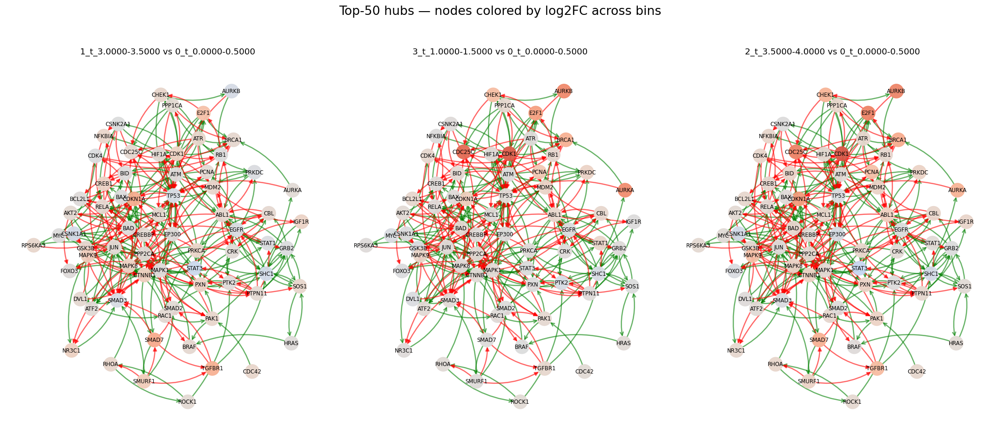

In [83]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable, coolwarm
import pandas as pd

# ── SETTINGS ────────────────────────────────────────────────────────────────
baseline    = "0_t_0.0000-0.5000"   # DE reference
bins_to_plot = ["1_t_3.0000-3.5000", "3_t_1.0000-1.5000", "2_t_3.5000-4.0000"]  
sig_mask    = False   # if True, grey out padj>=0.05
number_of_hubs = 70

# final_de_df assumed to exist

# ── 0) Build UniProt → Ensembl & UniProt → gene_symbol from graph g ─────────
up2ensg   = {}
up2symbol = {}
for v in g.vs:
    up2ensg[v["name"]]   = v["ensembl_gene_id"] if "ensembl_gene_id" in v.attributes() else ""
    up2symbol[v["name"]] = v["gene_symbol"]     if "gene_symbol" in v.attributes() else v["name"]

# ── 1) Pivot DE table to wide log2FC [Ensembl × bin] ────────────────────────
de_sub = final_de_df[final_de_df["baseline"] == baseline]
log2fc_pivot = de_sub.pivot(index="ensembl_gene_id", columns="bin", values="log2fc")
padj_pivot   = de_sub.pivot(index="ensembl_gene_id", columns="bin", values="padj")

# sanity check bins
missing_bins = [b for b in bins_to_plot if b not in log2fc_pivot.columns]
if missing_bins:
    raise ValueError(f"Bins not found for baseline '{baseline}': {missing_bins}")

# ── 2) Pick top-50 hubs by degree in igraph ─────────────────────────────────
deg   = g.degree()
top50 = sorted(range(g.vcount()), key=lambda i: deg[i], reverse=True)[:number_of_hubs]
subg  = g.induced_subgraph(top50)

# ── 3) Convert to NetworkX keyed by UniProt ─────────────────────────────────
nxg = nx.DiGraph()
for v in subg.vs:
    up   = v["name"]
    mod  = v["module"]
    sym  = up2symbol.get(up, up)
    ensg = up2ensg.get(up, "")
    nxg.add_node(up, module=mod, gene_symbol=sym, ensembl=ensg)

for e in subg.es:
    src = subg.vs[e.source]["name"]
    tgt = subg.vs[e.target]["name"]
    t   = e["type"]
    nxg.add_edge(src, tgt, type=t)

# ── 4) Global color normalization across all bins ──────────────────────────
vals_all = []
for b in bins_to_plot:
    vals_all.extend(log2fc_pivot[b].values)
vals_all = np.array([v for v in vals_all if np.isfinite(v)])
absmax   = float(np.nanmax(np.abs(vals_all))) if vals_all.size else 1.0
absmax   = absmax if absmax > 0 else 1.0
norm     = Normalize(vmin=-absmax, vmax=absmax)
cmap     = coolwarm

# ── 5) Layout once for all panels ───────────────────────────────────────────
pos = nx.kamada_kawai_layout(nxg)

labels    = {n: d.get("gene_symbol") or n for n, d in nxg.nodes(data=True)}
act_edges = [(u, v) for u, v, d in nxg.edges(data=True) if d.get("type") == "activation"]
inh_edges = [(u, v) for u, v, d in nxg.edges(data=True) if d.get("type") == "inhibition"]

# ── 6) Plot one panel per bin ──────────────────────────────────────────────
ncols = len(bins_to_plot)
fig, axes = plt.subplots(1, ncols, figsize=(6*ncols, 8), squeeze=False)

for i, bin_name in enumerate(bins_to_plot):
    ax = axes[0, i]

    zvals = []
    for n, d in nxg.nodes(data=True):
        ensg = d.get("ensembl")
        if ensg in log2fc_pivot.index:
            val = log2fc_pivot.at[ensg, bin_name]
            if sig_mask:
                pval = padj_pivot.at[ensg, bin_name] if ensg in padj_pivot.index else np.nan
                if not (np.isfinite(pval) and pval < 0.05):
                    val = 0.0
            zvals.append(val)
            d["log2fc"] = val
        else:
            zvals.append(np.nan)
            d["log2fc"] = np.nan

    node_colors = [cmap(norm(v)) if np.isfinite(v) else (0.85,0.85,0.85,1.0) for v in zvals]

    nx.draw_networkx_nodes(nxg, pos, node_color=node_colors, node_size=320, alpha=0.95, ax=ax)
    nx.draw_networkx_labels(nxg, pos, labels=labels, font_size=7, font_color="black", ax=ax)
    if act_edges:
        nx.draw_networkx_edges(nxg, pos, edgelist=act_edges, edge_color="green",
                               arrowstyle="->", arrowsize=10, alpha=0.6,
                               connectionstyle='arc3,rad=0.2', width=1.5, ax=ax)
    if inh_edges:
        nx.draw_networkx_edges(nxg, pos, edgelist=inh_edges, edge_color="red",
                               arrowstyle="-|>", arrowsize=10, alpha=0.6,
                               connectionstyle='arc3,rad=0.2', width=1.5, ax=ax)

    ax.set_title(f"{bin_name} vs {baseline}", fontsize=11)
    ax.axis("off")

# shared colorbar
#sm = ScalarMappable(norm=norm, cmap=cmap)
#sm.set_array(vals_all)
#cbar = fig.colorbar(sm, ax=axes.ravel().tolist(), shrink=0.7, pad=0.02)
#cbar.set_label("log2FC", rotation=270, labelpad=15)

fig.suptitle("Top-50 hubs — nodes colored by log2FC across bins", fontsize=16)
plt.tight_layout(rect=[0,0,1,0.95])
plt.show()


### color z-score

/tmp/ipykernel_270652/3518388491.py:100: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 1, 0.95])


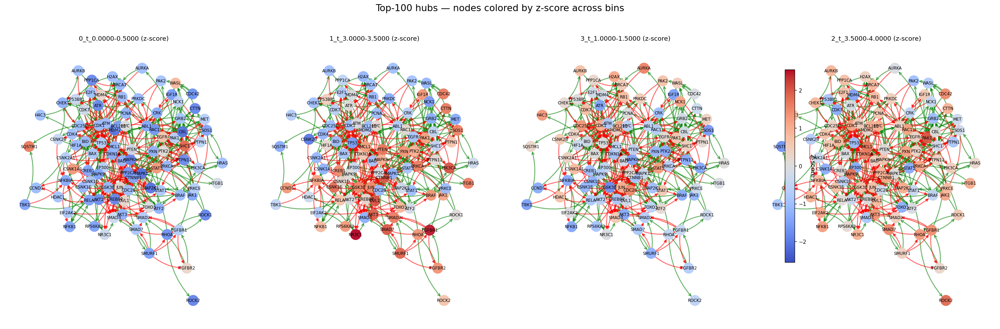

In [84]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable, coolwarm
import pandas as pd

# ── SETTINGS ────────────────────────────────────────────────────────────────
zscore_path  = "/storage/users/job37yv/Projects/PANC_cancer/analysis/network_module_gsea/zscore_by_group.csv"
bins_to_plot = ["0_t_0.0000-0.5000", "1_t_3.0000-3.5000", "3_t_1.0000-1.5000", "2_t_3.5000-4.0000"]
top_n        = 100   # number of hubs by degree to include

# ── Load z-scores (index = Ensembl) ─────────────────────────────────────────
zscore_df = pd.read_csv(zscore_path, index_col=0)
missing = [b for b in bins_to_plot if b not in zscore_df.columns]
if missing:
    raise ValueError(f"Bins not in zscore_df: {missing}")
lowest_z = float(np.nanmin(zscore_df.values)) if zscore_df.size else 0.0
zscore_df = zscore_df.fillna(lowest_z)

# ── Pick top-N hubs (by total degree) and induce subgraph in igraph ─────────
deg   = g.degree()
topix = sorted(range(g.vcount()), key=lambda i: deg[i], reverse=True)[:top_n]
subg  = g.induced_subgraph(topix)

# ── Build NetworkX keyed by ENSEMBL (aligns with zscore_df) ─────────────────
nxg = nx.DiGraph()
for v in subg.vs:
    ensg = v["ensembl_gene_id"] if "ensembl_gene_id" in v.attributes() else ""
    if not ensg:
        continue
    nxg.add_node(
        ensg,
        gene_symbol=v["gene_symbol"] if "gene_symbol" in v.attributes() else "",
        uniprot_id=v["name"],   # keep UniProt for reference
    )

for e in subg.es:
    s = subg.vs[e.source]["ensembl_gene_id"] if "ensembl_gene_id" in subg.vs[e.source].attributes() else ""
    t = subg.vs[e.target]["ensembl_gene_id"] if "ensembl_gene_id" in subg.vs[e.target].attributes() else ""
    if s and t:
        nxg.add_edge(s, t, type=e["type"] if "type" in e.attributes() else "")

if nxg.number_of_nodes() == 0:
    raise ValueError("No nodes with 'ensembl_gene_id' found in the top-N subgraph.")

# ── Global normalization over this subgraph across all requested bins ───────
nodes = list(nxg.nodes())
Z = zscore_df.loc[zscore_df.index.intersection(nodes), bins_to_plot]
absmax = float(np.nanmax(np.abs(Z.values))) if Z.size else 1.0
absmax = absmax if absmax > 0 else 1.0
norm   = Normalize(vmin=-absmax, vmax=absmax)
cmap   = coolwarm

# ── Layout once (reuse across panels) ───────────────────────────────────────
pos = nx.kamada_kawai_layout(nxg)  # nice for dense hub networks

labels    = {n: (d.get("gene_symbol") or n) for n, d in nxg.nodes(data=True)}
act_edges = [(u, v) for u, v, d in nxg.edges(data=True) if d.get("type") == "activation"]
inh_edges = [(u, v) for u, v, d in nxg.edges(data=True) if d.get("type") == "inhibition"]
other_edges = [(u, v) for u, v, d in nxg.edges(data=True) if d.get("type") not in {"activation", "inhibition"}]

# ── Plot one panel per bin ──────────────────────────────────────────────────
ncols = len(bins_to_plot)
fig, axes = plt.subplots(1, ncols, figsize=(6*ncols, 8), squeeze=False)

for i, bin_name in enumerate(bins_to_plot):
    ax = axes[0, i]
    col = zscore_df[bin_name].reindex(nodes)  # align to network nodes
    vals = col.fillna(lowest_z).values

    node_colors = [cmap(norm(float(z))) for z in vals]

    nx.draw_networkx_nodes(nxg, pos, node_color=node_colors, node_size=320, alpha=0.95, ax=ax)
    nx.draw_networkx_labels(nxg, pos, labels=labels, font_size=7, font_color="black", ax=ax)

    if act_edges:
        nx.draw_networkx_edges(nxg, pos, edgelist=act_edges, edge_color="green",
                               arrowstyle="->", arrowsize=10, alpha=0.6,
                               connectionstyle='arc3,rad=0.2', width=1.5, ax=ax)
    if inh_edges:
        nx.draw_networkx_edges(nxg, pos, edgelist=inh_edges, edge_color="red",
                               arrowstyle="-|>", arrowsize=10, alpha=0.6,
                               connectionstyle='arc3,rad=0.2', width=1.5, ax=ax)
    if other_edges:
        nx.draw_networkx_edges(nxg, pos, edgelist=other_edges, edge_color="grey",
                               arrowstyle="->", arrowsize=10, alpha=0.4,
                               connectionstyle='arc3,rad=0.2', width=1.0, style="dotted", ax=ax)

    ax.set_title(f"{bin_name} (z-score)", fontsize=11)
    ax.axis("off")

# Shared colorbar
sm = ScalarMappable(norm=norm, cmap=cmap)
sm.set_array(Z.values.flatten() if Z.size else np.array([-1, 1]))
cbar = fig.colorbar(sm, ax=axes.ravel().tolist(), shrink=0.75, pad=0.02)
cbar.set_label("Z-score", rotation=270, labelpad=15)

fig.suptitle(f"Top-{top_n} hubs — nodes colored by z-score across bins", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


## 9.2 Plot Z-core in the network plots

In [85]:
groups_to_test = [
    "1_t_0.5000-1.5000", "1_t_1.5000-2.5000", "1_t_2.5000-3.0000", "1_t_3.0000-3.5000",
    "3_t_0.0000-1.0000", "3_t_1.0000-1.5000", "3_t_1.5000-2.5000",
    "2_t_1.0000-2.5000", "2_t_2.5000-3.0000", "2_t_3.0000-3.5000", "2_t_3.5000-4.0000"
]


### Plot a certain modules

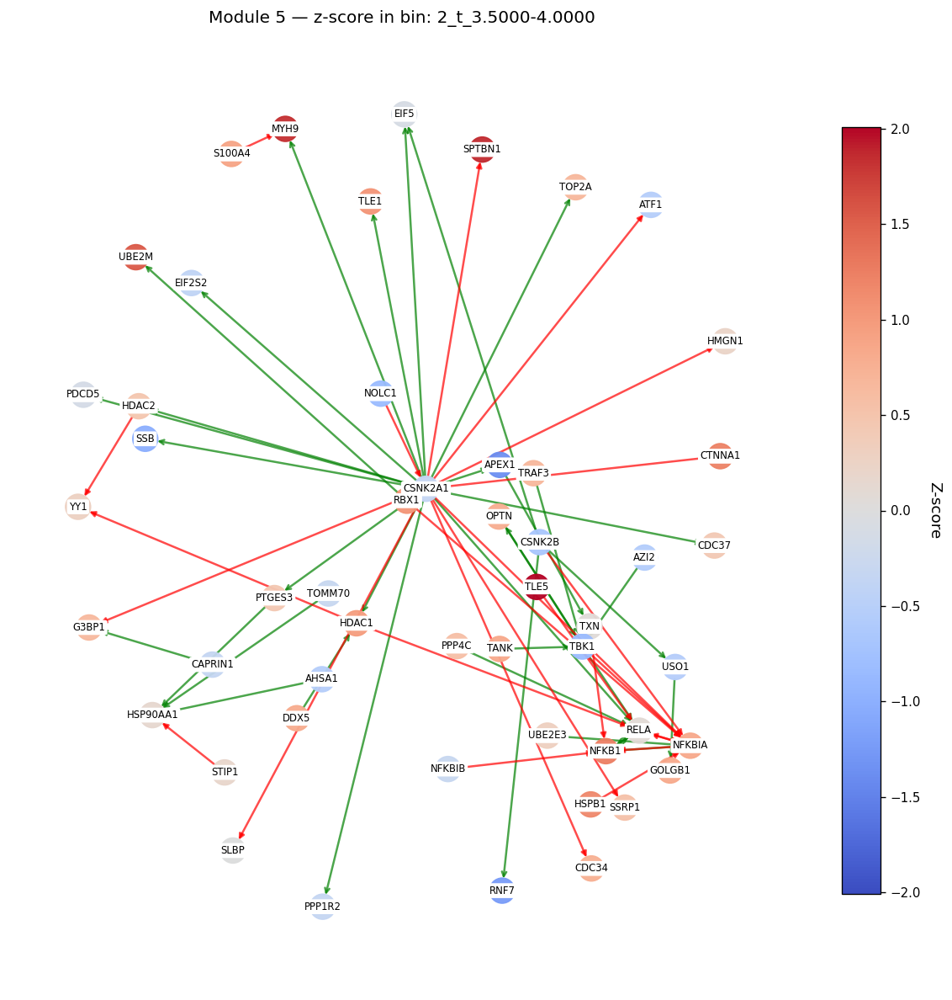

In [86]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from matplotlib import cm
import numpy as np

# --- tiny helpers for igraph attributes ---
def vget(v, key, default=None):
    try: return v[key]
    except KeyError: return default
def eget(e, key, default=None):
    try: return e[key]
    except KeyError: return default

# ─── Settings ────────────────────────────────────────────────────────────────
module_id   = 5
bin_to_plot = "2_t_3.5000-4.0000"
zscore_path = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/network_module_gsea/zscore_by_group.csv"

# ─── Load z-score data (index = Ensembl) ─────────────────────────────────────
zscore_df = pd.read_csv(zscore_path, index_col=0)
if bin_to_plot not in zscore_df.columns:
    raise ValueError(f"'{bin_to_plot}' not found in {zscore_df.columns.tolist()}")

# ─── igraph g → NetworkX (KEY BY ENSEMBL) ───────────────────────────────────
nxg = nx.DiGraph()
skipped = 0
for v in g.vs:
    ensg = vget(v, "ensembl_gene_id")      # <-- use Ensembl as node key
    if not ensg:
        skipped += 1
        continue
    nxg.add_node(
        ensg,
        module=vget(v, "module"),
        gene_symbol=vget(v, "gene_symbol", ""),
        uniprot_id=vget(v, "name", "")     # UniProt kept as attribute
    )
for e in g.es:
    src = vget(g.vs[e.source], "ensembl_gene_id")
    tgt = vget(g.vs[e.target], "ensembl_gene_id")
    if src and tgt:
        nxg.add_edge(src, tgt, type=eget(e, "type", ""))

if skipped:
    print(f"⚠️ Skipped {skipped} vertices without 'ensembl_gene_id'.")

# ─── Subgraph for selected module ────────────────────────────────────────────
members = [n for n, d in nxg.nodes(data=True) if d.get("module") == module_id]
if not members:
    raise ValueError(f"No nodes found for module {module_id}.")
subg = nxg.subgraph(members).copy()

# ─── Z-score coloring ────────────────────────────────────────────────────────
z_vals = zscore_df[bin_to_plot].reindex(subg.nodes())  # align by Ensembl
lowest_z = float(np.nanmin(zscore_df.values)) if zscore_df.size else 0.0
z_vals = z_vals.fillna(lowest_z)
absmax = float(max(abs(z_vals.min()), abs(z_vals.max()))) or 1.0
norm = Normalize(vmin=-absmax, vmax=absmax)
cmap = cm.coolwarm
node_colors = [cmap(norm(float(z))) for z in z_vals.values]

# ─── Layout ──────────────────────────────────────────────────────────────────
pos = nx.spring_layout(subg, seed=42, k=0.4)

# ─── Labels and Edge Types ───────────────────────────────────────────────────
labels = {n: d.get("gene_symbol", "") or n for n, d in subg.nodes(data=True)}
act_edges = [(u, v) for u, v, d in subg.edges(data=True) if d.get("type") == "activation"]
inh_edges = [(u, v) for u, v, d in subg.edges(data=True) if d.get("type") == "inhibition"]
other_edges = [(u, v) for u, v, d in subg.edges(data=True) if d.get("type") not in {"activation", "inhibition"}]

# ─── Plot ────────────────────────────────────────────────────────────────────
fig, ax = plt.subplots(figsize=(10, 10))

nx.draw_networkx_nodes(subg, pos, node_color=node_colors, node_size=320, alpha=0.95, ax=ax)
if act_edges:
    nx.draw_networkx_edges(subg, pos, edgelist=act_edges, edge_color="green",
                           arrowstyle='->', arrowsize=8, alpha=0.7, width=1.5, ax=ax)
if inh_edges:
    nx.draw_networkx_edges(subg, pos, edgelist=inh_edges, edge_color="red",
                           arrowstyle='-|>', arrowsize=8, alpha=0.7, width=1.5, ax=ax)
if other_edges:
    nx.draw_networkx_edges(subg, pos, edgelist=other_edges, edge_color="grey",
                           arrowstyle='->', arrowsize=8, alpha=0.4, width=1.0, style="dotted", ax=ax)

nx.draw_networkx_labels(subg, pos, labels=labels, font_size=7, font_color="black",
                        bbox=dict(facecolor="white", edgecolor="none", boxstyle="round,pad=0.2"), ax=ax)

sm = ScalarMappable(norm=norm, cmap=cmap); sm.set_array(z_vals.values)
cbar = plt.colorbar(sm, ax=ax, shrink=0.8); cbar.set_label("Z-score", rotation=270, labelpad=15)

ax.set_title(f"Module {module_id} — z-score in bin: {bin_to_plot}")
ax.axis("off")
plt.tight_layout()
plt.show()


### Plot a certain path (many modules)

In [87]:
trajectories = {
    "Traj_1": ["0_t_0.0000-0.5000", "1_t_0.5000-1.5000", "1_t_1.5000-2.5000", "1_t_2.5000-3.0000", "1_t_3.0000-3.5000"],
    "Traj_2": ["0_t_0.0000-0.5000", "3_t_0.0000-1.0000", "3_t_1.0000-1.5000", "3_t_1.5000-2.5000"],
    "Traj_3": ["0_t_0.0000-0.5000", "3_t_0.0000-1.0000", "3_t_1.0000-1.5000", "3_t_1.5000-2.5000", "2_t_1.0000-2.5000", 
               "2_t_2.5000-3.0000", "2_t_3.0000-3.5000", "2_t_3.5000-4.0000"]
}

/tmp/ipykernel_270652/3958826703.py:119: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 1, 0.96])


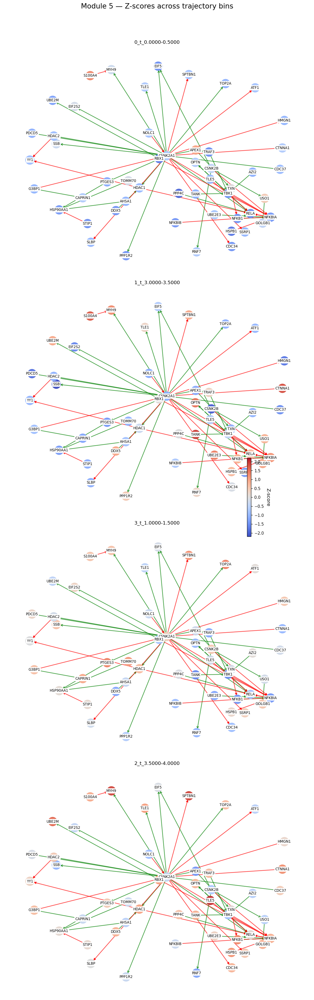

In [88]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from matplotlib import cm
import numpy as np

# ── Helpers for safe igraph attribute access ─────────────────────────────────
def vget(v, key, default=None):
    try:
        return v[key]
    except KeyError:
        return default

def eget(e, key, default=None):
    try:
        return e[key]
    except KeyError:
        return default

# ── Settings ────────────────────────────────────────────────────────────────
module_id = 5
bins_to_plot = [
    "0_t_0.0000-0.5000",  "1_t_3.0000-3.5000", "3_t_1.0000-1.5000", "2_t_3.5000-4.0000"
]
zscore_path = "/storage/users/job37yv/Projects/PANC_cancer/analysis/network_module_gsea/zscore_by_group.csv"

# ── Load z-scores (index = Ensembl) ─────────────────────────────────────────
zscore_df = pd.read_csv(zscore_path, index_col=0)
for col in bins_to_plot:
    if col not in zscore_df.columns:
        raise ValueError(f"'{col}' not in zscore_df columns.")
lowest_z = np.nanmin(zscore_df.values) if zscore_df.size else 0.0
zscore_df = zscore_df.fillna(lowest_z)

# ── Build NetworkX keyed by ENSEMBL ─────────────────────────────────────────
nxg = nx.DiGraph()
missing_ensg = 0
for v in g.vs:
    ensg = vget(v, "ensembl_gene_id")
    if not ensg:
        missing_ensg += 1
        continue
    nxg.add_node(
        ensg,
        module=vget(v, "module"),
        gene_symbol=vget(v, "gene_symbol", ""),
        uniprot_id=vget(v, "name", "")  # UniProt kept as attribute
    )

for e in g.es:
    src = vget(g.vs[e.source], "ensembl_gene_id")
    tgt = vget(g.vs[e.target], "ensembl_gene_id")
    if src and tgt:
        nxg.add_edge(src, tgt, type=eget(e, "type", ""))

if missing_ensg:
    print(f"⚠️ Skipped {missing_ensg} vertices without 'ensembl_gene_id'.")

# ── Subgraph for the module ─────────────────────────────────────────────────
members = [n for n, d in nxg.nodes(data=True) if d.get("module") == module_id]
if not members:
    raise ValueError(f"No nodes found for module {module_id}.")
subg = nxg.subgraph(members).copy()

# Ensure all subgraph nodes are present in zscore_df index
not_in_z = [n for n in subg.nodes() if n not in zscore_df.index]
if not_in_z:
    print(f"⚠️ {len(not_in_z)} module nodes missing from zscore_df index (showing up to 10): {not_in_z[:10]}")

# ── Global normalization over this subgraph across all bins ─────────────────
Z = zscore_df.loc[zscore_df.index.intersection(subg.nodes()), bins_to_plot]
absmax = float(np.nanmax(np.abs(Z.values))) if Z.size else 1.0
absmax = absmax if absmax > 0 else 1.0
norm = Normalize(vmin=-absmax, vmax=absmax)
cmap = cm.coolwarm

# ── Layout once (reuse across panels) ───────────────────────────────────────
pos = nx.spring_layout(subg, seed=42, k=0.4)

# ── Subplots (vertical) ─────────────────────────────────────────────────────
fig, axes = plt.subplots(len(bins_to_plot), 1, figsize=(10, 8 * len(bins_to_plot)), squeeze=False)

labels = {n: d.get("gene_symbol") or n for n, d in subg.nodes(data=True)}
act_edges = [(u, v) for u, v, d in subg.edges(data=True) if d.get("type") == "activation"]
inh_edges = [(u, v) for u, v, d in subg.edges(data=True) if d.get("type") == "inhibition"]
other_edges = [(u, v) for u, v, d in subg.edges(data=True) if d.get("type") not in {"activation", "inhibition"}]

for i, bin_name in enumerate(bins_to_plot):
    ax = axes[i, 0]
    z_vals = zscore_df[bin_name].reindex(subg.nodes()).fillna(lowest_z)
    node_colors = [cmap(norm(float(z))) for z in z_vals.values]

    nx.draw_networkx_nodes(subg, pos, node_color=node_colors, node_size=400, alpha=0.95, ax=ax)
    if act_edges:
        nx.draw_networkx_edges(subg, pos, edgelist=act_edges, edge_color="green",
                               arrowstyle='->', arrowsize=10, alpha=0.7, ax=ax, width=1.5)
    if inh_edges:
        nx.draw_networkx_edges(subg, pos, edgelist=inh_edges, edge_color="red",
                               arrowstyle='-|>', arrowsize=10, alpha=0.7, ax=ax, width=1.5)
    if other_edges:
        nx.draw_networkx_edges(subg, pos, edgelist=other_edges, edge_color="grey",
                               arrowstyle='->', arrowsize=10, alpha=0.4, ax=ax, width=1.0, style="dotted")

    nx.draw_networkx_labels(subg, pos, labels=labels, font_size=8, font_color="black",
                            bbox=dict(facecolor="white", edgecolor="none", boxstyle="round,pad=0.2"), ax=ax)

    ax.set_title(bin_name, fontsize=11)
    ax.axis("off")

# Shared colorbar
sm = ScalarMappable(norm=norm, cmap=cmap)
sm.set_array(Z.values.flatten() if Z.size else np.array([-1, 1]))
cbar = fig.colorbar(sm, ax=axes.ravel().tolist(), shrink=0.1, pad=0.01)
cbar.set_label("Z-score", rotation=270, labelpad=15)

fig.suptitle(f"Module {module_id} — Z-scores across trajectory bins", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


## 9.3 Plot logFC in the network plots

/tmp/ipykernel_270652/1837331278.py:123: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 1, 0.96])


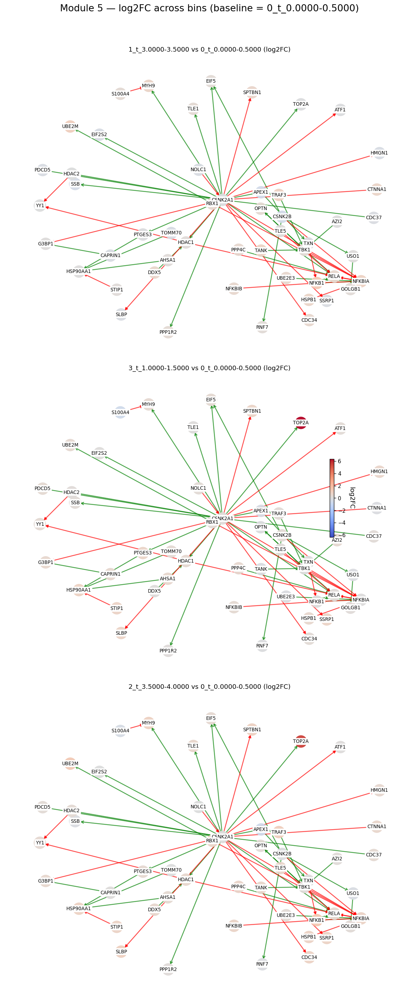

In [89]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from matplotlib import cm
import numpy as np

def vget(v, key, default=None):
    try: return v[key]
    except KeyError: return default
def eget(e, key, default=None):
    try: return e[key]
    except KeyError: return default

# ---- Settings ----
module_id    = 5
baseline     = "0_t_0.0000-0.5000"   # your DE reference
# If you want to pick specific bins, put them here (baseline will be removed automatically)
requested_bins = ["0_t_0.0000-0.5000", "1_t_3.0000-3.5000", "3_t_1.0000-1.5000", "2_t_3.5000-4.0000"]
sig_mask     = False  # set True to grey out padj >= 0.05

# ---- Build wide log2FC matrix (genes × bins) for the chosen baseline ----
de_base = final_de_df[final_de_df["baseline"] == baseline].copy()

# auto-derive bins available for this baseline
available_bins = sorted(de_base["bin"].unique().tolist())

# use requested bins if given; otherwise use all available
if requested_bins:
    # drop baseline if present and keep only bins that exist
    bins_to_plot = [b for b in requested_bins if (b != baseline and b in available_bins)]
else:
    bins_to_plot = [b for b in available_bins if b != baseline]

if not bins_to_plot:
    raise ValueError(f"No bins to plot: after removing baseline '{baseline}', none remain from {requested_bins or available_bins}.")

# pivots
log2fc_pivot = de_base.pivot(index="ensembl_gene_id", columns="bin", values="log2fc")
padj_pivot   = de_base.pivot(index="ensembl_gene_id", columns="bin", values="padj") if sig_mask else None

# ---- igraph g -> NetworkX (keyed by Ensembl) ----
nxg = nx.DiGraph()
for v in g.vs:
    ensg = vget(v, "ensembl_gene_id")
    if not ensg: 
        continue
    nxg.add_node(ensg,
                 module=vget(v, "module"),
                 gene_symbol=vget(v, "gene_symbol", ""),
                 uniprot_id=vget(v, "name", ""))

for e in g.es:
    s = vget(g.vs[e.source], "ensembl_gene_id"); t = vget(g.vs[e.target], "ensembl_gene_id")
    if s and t:
        nxg.add_edge(s, t, type=eget(e, "type", ""))

# subgraph by module
members = [n for n, d in nxg.nodes(data=True) if d.get("module") == module_id]
if not members:
    raise ValueError(f"No nodes found for module {module_id}.")
subg = nxg.subgraph(members).copy()

# align matrix to subgraph nodes
genes = list(subg.nodes())
L = log2fc_pivot.reindex(index=genes, columns=bins_to_plot)

if L.size == 0:
    raise ValueError("No overlap between module genes and DE results for these bins.")

# global symmetric normalization across all panels
absmax = float(np.nanmax(np.abs(L.values))) if np.isfinite(L.values).any() else 1.0
absmax = absmax if absmax > 0 else 1.0
norm = Normalize(vmin=-absmax, vmax=absmax)
cmap = cm.coolwarm

# optional significance mask
if sig_mask:
    P = padj_pivot.reindex(index=genes, columns=bins_to_plot)
    sig_mask_mat = (P.values < 0.05)
else:
    sig_mask_mat = np.ones_like(L.values, dtype=bool)

# layout and plot
pos = nx.spring_layout(subg, seed=42, k=0.4)
fig, axes = plt.subplots(len(bins_to_plot), 1, figsize=(10, 8 * len(bins_to_plot)), squeeze=False)

labels = {n: d.get("gene_symbol") or n for n, d in subg.nodes(data=True)}
act_edges = [(u, v) for u, v, d in subg.edges(data=True) if d.get("type") == "activation"]
inh_edges = [(u, v) for u, v, d in subg.edges(data=True) if d.get("type") == "inhibition"]
other_edges = [(u, v) for u, v, d in subg.edges(data=True) if d.get("type") not in {"activation", "inhibition"}]

for i, bin_name in enumerate(bins_to_plot):
    ax = axes[i, 0]
    col = L[bin_name]
    vals = col.values.copy()
    if sig_mask:
        vals[~sig_mask_mat[:, i]] = 0.0  # grey/white non-significant

    node_colors = [cmap(norm(float(z))) for z in vals]
    nx.draw_networkx_nodes(subg, pos, node_color=node_colors, node_size=400, alpha=0.95, ax=ax)
    if act_edges:
        nx.draw_networkx_edges(subg, pos, edgelist=act_edges, edge_color="green", arrowstyle='->', arrowsize=10, alpha=0.7, ax=ax, width=1.5)
    if inh_edges:
        nx.draw_networkx_edges(subg, pos, edgelist=inh_edges, edge_color="red", arrowstyle='-|>', arrowsize=10, alpha=0.7, ax=ax, width=1.5)
    if other_edges:
        nx.draw_networkx_edges(subg, pos, edgelist=other_edges, edge_color="grey", arrowstyle='->', arrowsize=10, alpha=0.4, ax=ax, width=1.0, style="dotted")

    nx.draw_networkx_labels(subg, pos, labels=labels, font_size=8, font_color="black",
                            bbox=dict(facecolor="white", edgecolor="none", boxstyle="round,pad=0.2"), ax=ax)

    ax.set_title(f"{bin_name} vs {baseline} (log2FC)", fontsize=11)
    ax.axis("off")

# shared colorbar
sm = ScalarMappable(norm=norm, cmap=cmap)
sm.set_array(L.values.flatten())
cbar = fig.colorbar(sm, ax=axes.ravel().tolist(), shrink=0.1, pad=0.01)
cbar.set_label("log2FC", rotation=270, labelpad=15)

fig.suptitle(f"Module {module_id} — log2FC across bins (baseline = {baseline})", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


## 9.4 Viusalize full network

/tmp/ipykernel_270652/2649142122.py:53: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc="upper right")


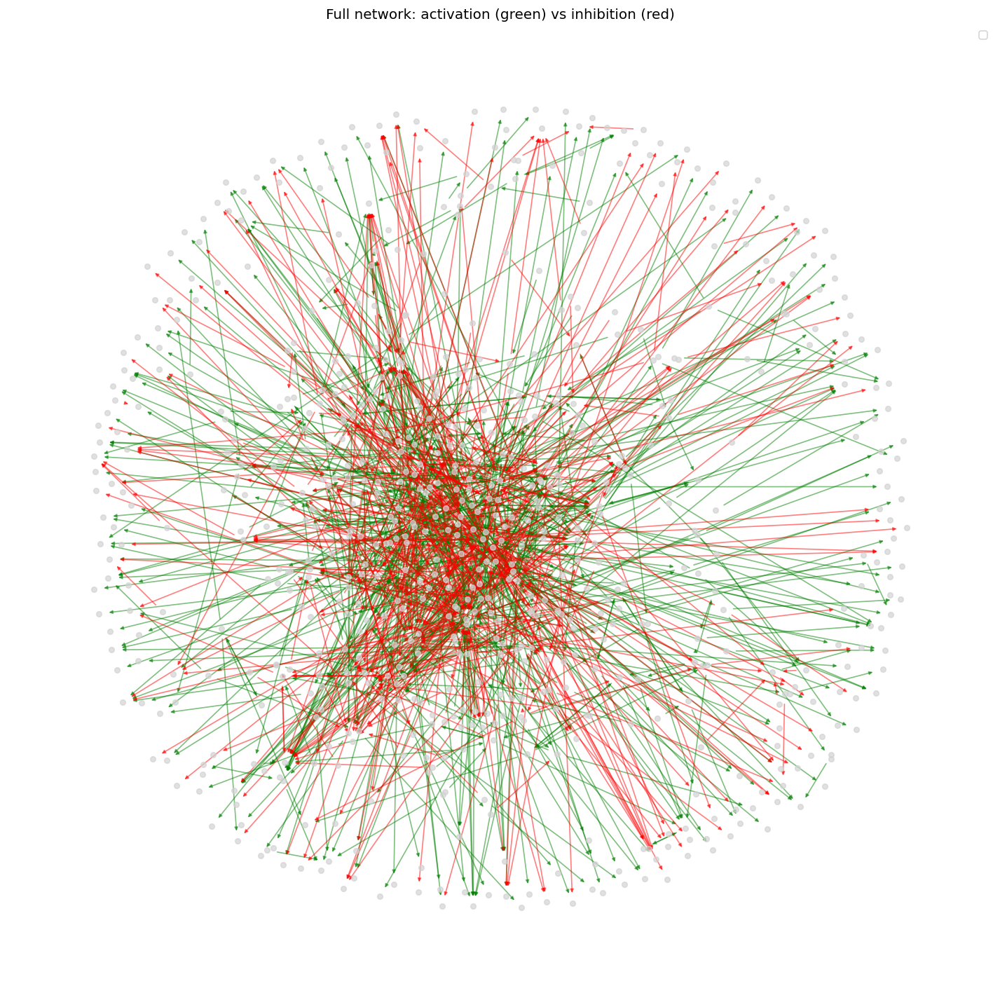

In [90]:
import networkx as nx
import matplotlib.pyplot as plt

# 1) Convert igraph `g` to a NetworkX DiGraph carrying the "type" attribute
nxg = nx.DiGraph()
for v in g.vs:
    nxg.add_node(v["name"])
for e in g.es:
    src = g.vs[e.tuple[0]]["name"]
    tgt = g.vs[e.tuple[1]]["name"]
    nxg.add_edge(src, tgt, type=e["type"])

# 2) Compute a layout (spring layout for the whole graph)
pos = nx.spring_layout(nxg, seed=42, k=0.15, iterations=50)

# 3) Split edges by type
act_edges = [(u, v) for u, v, d in nxg.edges(data=True) if d["type"] == "activation"]
inh_edges = [(u, v) for u, v, d in nxg.edges(data=True) if d["type"] == "inhibition"]

# 4) Plot
plt.figure(figsize=(12,12))

# draw nodes
nx.draw_networkx_nodes(
    nxg, pos,
    node_size=20,
    node_color="lightgray",
    alpha=0.7
)

# draw activation edges
nx.draw_networkx_edges(
    nxg, pos,
    edgelist=act_edges,
    edge_color="green",
    arrowsize=6,
    alpha=0.5,
    label="activation"
)

# draw inhibition edges
nx.draw_networkx_edges(
    nxg, pos,
    edgelist=inh_edges,
    edge_color="red",
    arrowsize=6,
    alpha=0.5,
    label="inhibition"
)

# optional: no labels for clarity
plt.axis("off")
plt.legend(loc="upper right")
plt.title("Full network: activation (green) vs inhibition (red)")
plt.tight_layout()
plt.show()


# 10.  Export netwrok for Cytoscape / yEd

## 10.0 Save graph as python graphml (done before already)

In [91]:
import pandas as pd
import igraph as ig

# ----------------------------
# 1. Inspect attributes
# ----------------------------
print("📌 Vertex attributes:", g.vs.attributes())
print("📌 Edge attributes:", g.es.attributes())
print(f"🔢 Vertices: {g.vcount()}, Edges: {g.ecount()}")

# ----------------------------
# 2. Vertex attributes DataFrame
# ----------------------------
vertex_df = pd.DataFrame({attr: g.vs[attr] for attr in g.vs.attributes()})
print("\n🧬 Vertex table (all attributes):")
print(vertex_df.head(10))   # preview first 10

# ----------------------------
# 3. Edge attributes DataFrame
# ----------------------------
edge_attr_dict = {attr: g.es[attr] for attr in g.es.attributes()}
edge_df = pd.DataFrame(edge_attr_dict)

# Add endpoints
src = [e.tuple[0] for e in g.es]
tgt = [e.tuple[1] for e in g.es]
edge_df.insert(0, "source_idx", src)
edge_df.insert(1, "target_idx", tgt)

# Map to Ensembl IDs (or names)
if "name" in g.vs.attributes():
    idx2name = dict(enumerate(g.vs["name"]))
    edge_df["source_name"] = [idx2name[i] for i in src]
    edge_df["target_name"] = [idx2name[i] for i in tgt]

print("\n🕸️ Edge table (all attributes):")
print(edge_df.head(10))   # preview first 10

# ----------------------------
# 4. Save graph with attributes
# ----------------------------
g.write_graphml("/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/graph_with_attributes.graphml")
print("\n💾 Saved graph as 'graph_with_attributes.graphml' (keeps all attributes).")

# Optional: also save CSVs for inspection
vertex_df.to_csv("/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/graph_vertices.csv", index=False)
edge_df.to_csv("/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/graph_edges.csv", index=False)
print("💾 Also saved 'graph_vertices.csv' and 'graph_edges.csv'")


📌 Vertex attributes: ['name', 'gene_symbol', 'module', 'uniprot_id', 'ensembl_gene_id_list', 'ensembl_gene_id']
📌 Edge attributes: ['type']
🔢 Vertices: 680, Edges: 1403

🧬 Vertex table (all attributes):
     name gene_symbol  module uniprot_id  \
0  P0DP24       CALM3       0     P0DP24   
1  P48995       TRPC1       6     P48995   
2  Q03135        CAV1       1     Q03135   
3  Q14571       ITPR2       6     Q14571   
4  Q13586       STIM1       6     Q13586   
5  P06493        CDK1       2     P06493   
6  P31350        RRM2       2     P31350   
7  P38936      CDKN1A       4     P38936   
8  P04637        TP53       7     P04637   
9  P18847        ATF3       7     P18847   

                                ensembl_gene_id_list  ensembl_gene_id  
0  [ENSG00000143933, ENSG00000198668, ENSG0000016...  ENSG00000143933  
1                                  [ENSG00000144935]  ENSG00000144935  
2                                  [ENSG00000105974]  ENSG00000105974  
3                       

## 10.1 Cytoscape

In [92]:
import pandas as pd

# --- 1) Export network as .sif ---------------------------------------------
# Cytoscape SIF format: source <interaction-type> target
sif_path = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/network.sif"

with open(sif_path, "w") as f:
    for e in g.es:
        src = g.vs[e.source]["ensembl_gene_id"]
        tgt = g.vs[e.target]["ensembl_gene_id"]
        inter = e["type"] if "type" in g.es.attributes() else "interacts_with"
        if src and tgt:  # only export if Ensembl IDs exist
            f.write(f"{src}\t{inter}\t{tgt}\n")

print(f"💾 SIF network written: {sif_path}")

# --- 2) Node attributes -----------------------------------------------------
# expr_mean2 already has columns: ensembl_gene_id, UniProtID, gene_symbol, cluster_id, ...
node_attr_path = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/node_attributes.tsv"
expr_mean2.to_csv(node_attr_path, sep="\t", index=False)
print(f"💾 Node attributes written: {node_attr_path}")

# --- 3) Edge attributes -----------------------------------------------------
edge_attr_path = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/edge_attributes.tsv"
edge_attr_dict = {attr: g.es[attr] for attr in g.es.attributes()}
edge_df = pd.DataFrame(edge_attr_dict)

# add source/target Ensembl IDs
edge_df["source"] = [g.vs[e.source]["ensembl_gene_id"] for e in g.es]
edge_df["target"] = [g.vs[e.target]["ensembl_gene_id"] for e in g.es]

edge_df.to_csv(edge_attr_path, sep="\t", index=False)
print(f"💾 Edge attributes written: {edge_attr_path}")


💾 SIF network written: /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/network.sif
💾 Node attributes written: /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/node_attributes.tsv
💾 Edge attributes written: /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/edge_attributes.tsv


## 10.2 Gramphml (didnt really work)

In [99]:
from itertools import islice

# ---- Vertices ----
print("Vertices and their attributes (head):")
for v in islice(g.vs, 5):   # first 5 vertices
    print(f"Vertex {v.index}:")
    for attr in g.vs.attributes():
        print(f"  {attr}: {v[attr]}")
    print()

# ---- Edges ----
print("Edges and their attributes (head):")
for e in islice(g.es, 5):   # first 5 edges
    print(f"Edge {e.index}: {e.source} -> {e.target}")
    for attr in g.es.attributes():
        print(f"  {attr}: {e[attr]}")
    print()


Vertices and their attributes (head):
Vertex 0:
  name: P0DP24
  gene_symbol: CALM3
  module: 0
  uniprot_id: P0DP24
  ensembl_gene_id_list: ['ENSG00000143933', 'ENSG00000198668', 'ENSG00000160014']
  ensembl_gene_id: ENSG00000143933

Vertex 1:
  name: P48995
  gene_symbol: TRPC1
  module: 6
  uniprot_id: P48995
  ensembl_gene_id_list: ['ENSG00000144935']
  ensembl_gene_id: ENSG00000144935

Vertex 2:
  name: Q03135
  gene_symbol: CAV1
  module: 1
  uniprot_id: Q03135
  ensembl_gene_id_list: ['ENSG00000105974']
  ensembl_gene_id: ENSG00000105974

Vertex 3:
  name: Q14571
  gene_symbol: ITPR2
  module: 6
  uniprot_id: Q14571
  ensembl_gene_id_list: ['ENSG00000123104']
  ensembl_gene_id: ENSG00000123104

Vertex 4:
  name: Q13586
  gene_symbol: STIM1
  module: 6
  uniprot_id: Q13586
  ensembl_gene_id_list: ['ENSG00000167323']
  ensembl_gene_id: ENSG00000167323

Edges and their attributes (head):
Edge 0: 0 -> 1
  type: inhibition

Edge 1: 2 -> 1
  type: activation

Edge 2: 3 -> 1
  type: ac

In [101]:
# pip install igraph
import xml.etree.ElementTree as ET

def export_g_to_yed_graphml(g, path, use_positions=False, width=30.0, height=30.0):
    """
    Export existing igraph.Graph 'g' to yEd GraphML with:
      - node ids n0, n1, ...
      - NodeLabel from 'gene_symbol' (fallback: 'name' -> 'ensembl_gene_id' -> index)
      - Edge 'type' mapped: activation -> green arrow; inhibition/inhibtion -> red T-bar.
      - If use_positions=True and vertices have x,y, Geometry is set; else yEd will auto-layout.
    """
    # namespaces
    ns = {
        'graphml': "http://graphml.graphdrawing.org/xmlns",
        'y': "http://www.yworks.com/xml/graphml",
        'yed': "http://www.yworks.com/xml/yed/3",
        'xsi': "http://www.w3.org/2001/XMLSchema-instance",
        'java': "http://www.yworks.com/xml/yfiles-common/1.0/java",
        'sys': "http://www.yworks.com/xml/yfiles-common/markup/primitives/2.0",
        'x': "http://www.yworks.com/xml/yfiles-common/markup/2.0",
    }
    for prefix, uri in ns.items():
        ET.register_namespace(prefix if prefix != 'graphml' else '', uri)

    root = ET.Element(
        "{" + ns['graphml'] + "}graphml",
        {"{" + ns['xsi'] + "}schemaLocation":
         f"{ns['graphml']} http://www.yworks.com/xml/schema/graphml/1.1/ygraphml.xsd"}
    )

    def add_key(_id, _for=None, attr_name=None, attr_type=None, yfiles_type=None):
        attrs = {"id": _id}
        if _for:        attrs["for"] = _for
        if attr_name:   attrs["attr.name"] = attr_name
        if attr_type:   attrs["attr.type"] = attr_type
        if yfiles_type: attrs["yfiles.type"] = yfiles_type
        ET.SubElement(root, "key", attrs)

    # keys like your template
    add_key("d0", "graph",  "Description", "string")
    add_key("d1", "port",   yfiles_type="portgraphics")
    add_key("d2", "port",   yfiles_type="portgeometry")
    add_key("d3", "port",   yfiles_type="portuserdata")
    add_key("d4", "node",   "url", "string")
    add_key("d5", "node",   "description", "string")
    add_key("d6", "node",   yfiles_type="nodegraphics")
    add_key("d7", "graphml", yfiles_type="resources")
    add_key("d8", "edge",   "url", "string")
    add_key("d9", "edge",   "description", "string")
    add_key("d10","edge",   yfiles_type="edgegraphics")

    graph_el = ET.SubElement(root, "graph", {
        "id": "G",
        "edgedefault": "directed" if g.is_directed() else "undirected"
    })
    ET.SubElement(graph_el, "data", {"key": "d0"})  # empty graph description

    v_attrs = set(g.vs.attributes())
    e_attrs = set(g.es.attributes())

    def node_label(v):
        for attr in ("gene_symbol", "name", "ensembl_gene_id"):
            if attr in v_attrs:
                val = v[attr]
                if val not in (None, ""):
                    return str(val)
        return str(v.index)

    def edge_type(e):
        val = None
        if "type" in e_attrs:
            val = e["type"]
        elif "sign" in e_attrs:
            try:
                val = "activation" if float(e["sign"]) > 0 else "inhibition"
            except Exception:
                val = None
        s = (str(val).strip().lower() if val is not None else "")
        if s in ("inhibition", "inhibtion"):   # tolerate typo
            return "inhibition"
        return "activation"

    def style_for(etype):
        if etype == "inhibition":
            return "#FF0000", "t_shape"
        return "#99CC00", "standard"

    use_xy = use_positions and ("x" in v_attrs) and ("y" in v_attrs)

    # nodes
    for v in g.vs:
        nid = f"n{v.index}"
        node_el = ET.SubElement(graph_el, "node", {"id": nid})
        ET.SubElement(node_el, "data", {"key": "d5"})  # empty node description

        d6 = ET.SubElement(node_el, "data", {"key": "d6"})
        shape = ET.SubElement(d6, f"{{{ns['y']}}}ShapeNode")

        if use_xy:
            try:
                x = float(v["x"]) if v["x"] is not None else 0.0
                y = float(v["y"]) if v["y"] is not None else 0.0
            except Exception:
                x, y = 0.0, 0.0
        else:
            x, y = 0.0, 0.0

        ET.SubElement(shape, f"{{{ns['y']}}}Geometry",
                      {"x": f"{x}", "y": f"{y}", "width": f"{float(width)}", "height": f"{float(height)}"})
        ET.SubElement(shape, f"{{{ns['y']}}}Fill", {"color":"#FFCC00", "transparent":"false"})
        ET.SubElement(shape, f"{{{ns['y']}}}BorderStyle",
                      {"color":"#000000", "type":"line", "width":"1.0", "raised":"false"})

        nlabel = ET.SubElement(shape, f"{{{ns['y']}}}NodeLabel",
                               {"alignment":"center",
                                "autoSizePolicy":"content",
                                "fontFamily":"Dialog",
                                "fontSize":"12",
                                "fontStyle":"plain",
                                "hasBackgroundColor":"false",
                                "hasLineColor":"false",
                                "visible":"true",
                                "textColor":"#000000",
                                "modelName":"custom",
                                "horizontalTextPosition":"center",
                                "verticalTextPosition":"bottom",
                                "x":"0.0","y":"0.0","width":"40.0","height":"20.0",
                                "iconTextGap":"4"})
        nlabel.text = node_label(v)
        lm = ET.SubElement(nlabel, f"{{{ns['y']}}}LabelModel")
        ET.SubElement(lm, f"{{{ns['y']}}}SmartNodeLabelModel", {"distance":"4.0"})
        mp = ET.SubElement(nlabel, f"{{{ns['y']}}}ModelParameter")
        ET.SubElement(mp, f"{{{ns['y']}}}SmartNodeLabelModelParameter",
                      {"labelRatioX":"0.0","labelRatioY":"0.0",
                       "nodeRatioX":"0.0","nodeRatioY":"0.0",
                       "offsetX":"0.0","offsetY":"0.0","upX":"0.0","upY":"-1.0"})
        ET.SubElement(shape, f"{{{ns['y']}}}Shape", {"type":"rectangle"})

    # edges
    for e in g.es:
        eid = f"e{e.index}"
        src = f"n{e.source}"
        tgt = f"n{e.target}"
        etype = edge_type(e)
        color, arrow = style_for(etype)

        edge_el = ET.SubElement(graph_el, "edge", {"id": eid, "source": src, "target": tgt})
        ET.SubElement(edge_el, "data", {"key": "d9"})  # empty edge description (like template)

        d10 = ET.SubElement(edge_el, "data", {"key": "d10"})
        poly = ET.SubElement(d10, f"{{{ns['y']}}}PolyLineEdge")
        ET.SubElement(poly, f"{{{ns['y']}}}Path", {"sx":"0.0","sy":"0.0","tx":"0.0","ty":"0.0"})
        ET.SubElement(poly, f"{{{ns['y']}}}LineStyle", {"color": color, "type":"line", "width":"1.0"})
        ET.SubElement(poly, f"{{{ns['y']}}}Arrows", {"source":"none", "target": arrow})
        ET.SubElement(poly, f"{{{ns['y']}}}BendStyle", {"smoothed":"false"})

    # resources bucket
    data_res = ET.SubElement(root, "data", {"key": "d7"})
    ET.SubElement(data_res, f"{{{ns['y']}}}Resources")

    ET.ElementTree(root).write(path, encoding="UTF-8", xml_declaration=True)
    print(f"💾 GraphML written: {path}")


In [103]:
export_g_to_yed_graphml(g, "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/network_yed.graphml", use_positions=False)

💾 GraphML written: /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/network_yed.graphml


## 10.3 save all sub networks (doesnt work)

In [104]:
import os
import pandas as pd
import igraph as ig

outdir = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/subgraphs"
os.makedirs(outdir, exist_ok=True)

for group, g_sub in group_graphs.items():
    print(f"\n=== Saving subgraph for {group} ===")
    print(f"Nodes: {g_sub.vcount()}, Edges: {g_sub.ecount()}")

    # --- Vertex table ---
    vertex_df = pd.DataFrame({attr: g_sub.vs[attr] for attr in g_sub.vs.attributes()})
    print(vertex_df.head(5))
    
    # --- Edge table ---
    edge_attr_dict = {attr: g_sub.es[attr] for attr in g_sub.es.attributes()}
    edge_df = pd.DataFrame(edge_attr_dict)

    src = [e.tuple[0] for e in g_sub.es]
    tgt = [e.tuple[1] for e in g_sub.es]
    edge_df.insert(0, "source_idx", src)
    edge_df.insert(1, "target_idx", tgt)

    if "name" in g_sub.vs.attributes():
        idx2name = dict(enumerate(g_sub.vs["name"]))
        edge_df["source_name"] = [idx2name[i] for i in src]
        edge_df["target_name"] = [idx2name[i] for i in tgt]

    print(edge_df.head(5))

    # --- Save files ---
    g_sub.write_graphml(os.path.join(outdir, f"{group}.graphml"))
    vertex_df.to_csv(os.path.join(outdir, f"{group}_nodes.csv"), index=False)
    edge_df.to_csv(os.path.join(outdir, f"{group}_edges.csv"), index=False)

    print(f"💾 Saved {group}.graphml, {group}_nodes.csv, {group}_edges.csv")



=== Saving subgraph for 0_t_0.0000-0.5000 ===
Nodes: 119, Edges: 128
     name gene_symbol
0  Q05209      PTPN12
1  Q05397        PTK2
2  Q15311      RALBP1
3  P63000        RAC1
4  P06396         GSN
   source_idx  target_idx        type source_name target_name
0           0           1  inhibition      Q05209      Q05397
1           2           3  inhibition      Q15311      P63000
2           4           5  activation      P06396      P63261
3           6           7  activation      Q9Y490      P05556
4           8           9  activation      Q15233      P11387
💾 Saved 0_t_0.0000-0.5000.graphml, 0_t_0.0000-0.5000_nodes.csv, 0_t_0.0000-0.5000_edges.csv

=== Saving subgraph for 3_t_1.0000-1.5000 ===
Nodes: 169, Edges: 199
     name gene_symbol
0  P06493        CDK1
1  P31350        RRM2
2  Q05209      PTPN12
3  Q05397        PTK2
4  P11233        RALA
   source_idx  target_idx        type source_name target_name
0           0           1  inhibition      P06493      P31350
1       

# 11. Extended network anaylsis to find durgable candidates with unusual high influence on network and expression in GEM resitant cells

## 11.1 Evaluate and prepare the data tables present 

In [105]:
# Pivot the DataFrame
log2fc_pivot = final_de_df.pivot(
    index="ensembl_gene_id",
    columns="comparison",
    values="log2fc"
)

# (Optional) Add gene symbol for convenience
gene_symbols = final_de_df.drop_duplicates("ensembl_gene_id")[["ensembl_gene_id", "gene_symbol"]]
log2fc_pivot = log2fc_pivot.merge(gene_symbols, on="ensembl_gene_id", how="left")

# Set index to ensembl_gene_id again
log2fc_pivot = log2fc_pivot.set_index("ensembl_gene_id")

log2fc_pivot.rename(
    columns=lambda c: c.replace("_vs_0_t_0.0000-0.5000", "") if "_vs_0_t_0.0000-0.5000" in c else c,
    inplace=True
)

# Display result
log2fc_pivot.head()

,1_t_0.5000-1.5000,1_t_1.5000-2.5000,1_t_2.5000-3.0000,1_t_3.0000-3.5000,2_t_1.0000-2.5000,2_t_2.5000-3.0000,2_t_3.0000-3.5000,2_t_3.5000-4.0000,3_t_0.0000-1.0000,3_t_1.0000-1.5000,3_t_1.5000-2.5000,gene_symbol
ensembl_gene_id,,,,,,,,,,,,
ENSG00000002330,0.755020,0.150585,-0.045538,0.116496,1.266127,0.496199,0.901430,0.649580,0.520969,0.425198,0.490346,BAD
ENSG00000004487,0.632151,0.377867,0.347430,0.371627,0.874356,1.124431,0.820240,0.671474,0.750804,0.951805,1.254300,KDM1A
ENSG00000004897,0.420276,0.588602,0.365352,0.537253,0.727935,1.352126,1.294036,0.997952,0.896356,1.254151,1.488976,CDC27
ENSG00000005339,0.273803,0.404603,0.382602,0.409467,0.083150,0.590764,0.519484,0.372823,0.564349,0.228832,0.557036,CREBBP
ENSG00000005810,0.684181,0.585127,0.417278,0.443577,0.564891,0.879845,0.609637,0.439055,0.269403,-0.046796,0.376729,MYCBP2


In [106]:
expr_mean.head()

,0_t_0.0000-0.5000,3_t_1.0000-1.5000,3_t_0.0000-1.0000,3_t_1.5000-2.5000,2_t_3.5000-4.0000,1_t_0.5000-1.5000,2_t_1.0000-2.5000,1_t_3.0000-3.5000,1_t_1.5000-2.5000,1_t_2.5000-3.0000,2_t_2.5000-3.0000,2_t_3.0000-3.5000,UniProtID,gene_symbol
ENSG00000187634,0.099369,0.058846,0.066700,0.112531,0.162974,0.214113,0.185448,0.184487,0.290847,0.192041,0.344073,0.210666,Q96NU1,SAMD11
ENSG00000188290,0.728537,0.866194,0.699570,1.101085,1.385252,1.715819,1.912032,1.365245,1.408131,1.325606,1.747709,1.606269,Q9HCC6,HES4
ENSG00000187608,0.291571,0.330329,0.242814,0.475130,0.304981,0.523779,0.639019,0.272351,0.405396,0.329586,0.331405,0.343650,P05161,ISG15
ENSG00000078808,0.479059,0.563355,0.574328,0.517743,0.574268,0.526164,0.581868,0.511637,0.496302,0.495905,0.604565,0.560752,Q9BRK5,SDF4
ENSG00000160087,0.205096,0.236239,0.211886,0.341432,0.244610,0.239008,0.366078,0.250638,0.284698,0.279735,0.379937,0.285058,Q8N2K1,UBE2J2


In [107]:
# Check: assume Ensembl IDs are in the index of expr_mean
# and UniProtID is a column
ens_to_uniprot = expr_mean["UniProtID"].to_dict()  # mapping: Ensembl → UniProt

In [108]:
len(ens_to_uniprot)

4806

In [109]:
list(ens_to_uniprot.items())[:5]

[('ENSG00000187634', 'Q96NU1'),
 ('ENSG00000188290', 'Q9HCC6'),
 ('ENSG00000187608', 'P05161'),
 ('ENSG00000078808', 'Q9BRK5'),
 ('ENSG00000160087', 'Q8N2K1')]

In [110]:

# Map Ensembl IDs in log2fc_pivot (its index) to UniProt IDs
log2fc_pivot["UniProtID"] = log2fc_pivot.index.map(ens_to_uniprot)

# Drop missing UniProt mappings
log2fc_pivot = log2fc_pivot.dropna(subset=["UniProtID"])

# Move ensembl_gene_id into a column for completeness
log2fc_pivot["ensembl_gene_id"] = log2fc_pivot.index

# Reindex by UniProtID
log2fc_pivot = log2fc_pivot.set_index("UniProtID")

# Check result
log2fc_pivot.head()


,1_t_0.5000-1.5000,1_t_1.5000-2.5000,1_t_2.5000-3.0000,1_t_3.0000-3.5000,2_t_1.0000-2.5000,2_t_2.5000-3.0000,2_t_3.0000-3.5000,2_t_3.5000-4.0000,3_t_0.0000-1.0000,3_t_1.0000-1.5000,3_t_1.5000-2.5000,gene_symbol,ensembl_gene_id
UniProtID,,,,,,,,,,,,,
Q92934,0.755020,0.150585,-0.045538,0.116496,1.266127,0.496199,0.901430,0.649580,0.520969,0.425198,0.490346,BAD,ENSG00000002330
O60341,0.632151,0.377867,0.347430,0.371627,0.874356,1.124431,0.820240,0.671474,0.750804,0.951805,1.254300,KDM1A,ENSG00000004487
P30260,0.420276,0.588602,0.365352,0.537253,0.727935,1.352126,1.294036,0.997952,0.896356,1.254151,1.488976,CDC27,ENSG00000004897
Q92793,0.273803,0.404603,0.382602,0.409467,0.083150,0.590764,0.519484,0.372823,0.564349,0.228832,0.557036,CREBBP,ENSG00000005339
O75592,0.684181,0.585127,0.417278,0.443577,0.564891,0.879845,0.609637,0.439055,0.269403,-0.046796,0.376729,MYCBP2,ENSG00000005810


In [111]:
log2fc_pivot

,1_t_0.5000-1.5000,1_t_1.5000-2.5000,1_t_2.5000-3.0000,1_t_3.0000-3.5000,2_t_1.0000-2.5000,2_t_2.5000-3.0000,2_t_3.0000-3.5000,2_t_3.5000-4.0000,3_t_0.0000-1.0000,3_t_1.0000-1.5000,3_t_1.5000-2.5000,gene_symbol,ensembl_gene_id
UniProtID,,,,,,,,,,,,,
Q92934,0.755020,0.150585,-0.045538,0.116496,1.266127,0.496199,0.901430,0.649580,0.520969,0.425198,0.490346,BAD,ENSG00000002330
O60341,0.632151,0.377867,0.347430,0.371627,0.874356,1.124431,0.820240,0.671474,0.750804,0.951805,1.254300,KDM1A,ENSG00000004487
P30260,0.420276,0.588602,0.365352,0.537253,0.727935,1.352126,1.294036,0.997952,0.896356,1.254151,1.488976,CDC27,ENSG00000004897
Q92793,0.273803,0.404603,0.382602,0.409467,0.083150,0.590764,0.519484,0.372823,0.564349,0.228832,0.557036,CREBBP,ENSG00000005339
O75592,0.684181,0.585127,0.417278,0.443577,0.564891,0.879845,0.609637,0.439055,0.269403,-0.046796,0.376729,MYCBP2,ENSG00000005810
...,...,...,...,...,...,...,...,...,...,...,...,...,...
Q13404,-0.200717,-0.314912,-0.157756,-0.111836,-0.183336,-0.511667,-0.310515,-0.259552,0.049215,-0.004573,-0.095650,UBE2V1,ENSG00000244687
P78527,0.558983,0.068065,-0.067427,-0.191460,1.517824,1.439272,1.149434,1.018392,0.503275,1.038646,1.518807,PRKDC,ENSG00000253729
P57730,0.573257,1.090919,1.215905,1.004363,0.471313,0.602178,0.580411,0.783847,0.335879,-0.533079,1.092035,CARD18,ENSG00000255501


In [112]:
log2fc_pivot

,1_t_0.5000-1.5000,1_t_1.5000-2.5000,1_t_2.5000-3.0000,1_t_3.0000-3.5000,2_t_1.0000-2.5000,2_t_2.5000-3.0000,2_t_3.0000-3.5000,2_t_3.5000-4.0000,3_t_0.0000-1.0000,3_t_1.0000-1.5000,3_t_1.5000-2.5000,gene_symbol,ensembl_gene_id
UniProtID,,,,,,,,,,,,,
Q92934,0.755020,0.150585,-0.045538,0.116496,1.266127,0.496199,0.901430,0.649580,0.520969,0.425198,0.490346,BAD,ENSG00000002330
O60341,0.632151,0.377867,0.347430,0.371627,0.874356,1.124431,0.820240,0.671474,0.750804,0.951805,1.254300,KDM1A,ENSG00000004487
P30260,0.420276,0.588602,0.365352,0.537253,0.727935,1.352126,1.294036,0.997952,0.896356,1.254151,1.488976,CDC27,ENSG00000004897
Q92793,0.273803,0.404603,0.382602,0.409467,0.083150,0.590764,0.519484,0.372823,0.564349,0.228832,0.557036,CREBBP,ENSG00000005339
O75592,0.684181,0.585127,0.417278,0.443577,0.564891,0.879845,0.609637,0.439055,0.269403,-0.046796,0.376729,MYCBP2,ENSG00000005810
...,...,...,...,...,...,...,...,...,...,...,...,...,...
Q13404,-0.200717,-0.314912,-0.157756,-0.111836,-0.183336,-0.511667,-0.310515,-0.259552,0.049215,-0.004573,-0.095650,UBE2V1,ENSG00000244687
P78527,0.558983,0.068065,-0.067427,-0.191460,1.517824,1.439272,1.149434,1.018392,0.503275,1.038646,1.518807,PRKDC,ENSG00000253729
P57730,0.573257,1.090919,1.215905,1.004363,0.471313,0.602178,0.580411,0.783847,0.335879,-0.533079,1.092035,CARD18,ENSG00000255501


In [113]:
log2fc_df = log2fc_pivot.drop(columns=['gene_symbol', 'ensembl_gene_id'])

In [114]:
log2fc_df

,1_t_0.5000-1.5000,1_t_1.5000-2.5000,1_t_2.5000-3.0000,1_t_3.0000-3.5000,2_t_1.0000-2.5000,2_t_2.5000-3.0000,2_t_3.0000-3.5000,2_t_3.5000-4.0000,3_t_0.0000-1.0000,3_t_1.0000-1.5000,3_t_1.5000-2.5000
UniProtID,,,,,,,,,,,
Q92934,0.755020,0.150585,-0.045538,0.116496,1.266127,0.496199,0.901430,0.649580,0.520969,0.425198,0.490346
O60341,0.632151,0.377867,0.347430,0.371627,0.874356,1.124431,0.820240,0.671474,0.750804,0.951805,1.254300
P30260,0.420276,0.588602,0.365352,0.537253,0.727935,1.352126,1.294036,0.997952,0.896356,1.254151,1.488976
Q92793,0.273803,0.404603,0.382602,0.409467,0.083150,0.590764,0.519484,0.372823,0.564349,0.228832,0.557036
O75592,0.684181,0.585127,0.417278,0.443577,0.564891,0.879845,0.609637,0.439055,0.269403,-0.046796,0.376729
...,...,...,...,...,...,...,...,...,...,...,...
Q13404,-0.200717,-0.314912,-0.157756,-0.111836,-0.183336,-0.511667,-0.310515,-0.259552,0.049215,-0.004573,-0.095650
P78527,0.558983,0.068065,-0.067427,-0.191460,1.517824,1.439272,1.149434,1.018392,0.503275,1.038646,1.518807
P57730,0.573257,1.090919,1.215905,1.004363,0.471313,0.602178,0.580411,0.783847,0.335879,-0.533079,1.092035


In [115]:
log2fc_df

,1_t_0.5000-1.5000,1_t_1.5000-2.5000,1_t_2.5000-3.0000,1_t_3.0000-3.5000,2_t_1.0000-2.5000,2_t_2.5000-3.0000,2_t_3.0000-3.5000,2_t_3.5000-4.0000,3_t_0.0000-1.0000,3_t_1.0000-1.5000,3_t_1.5000-2.5000
UniProtID,,,,,,,,,,,
Q92934,0.755020,0.150585,-0.045538,0.116496,1.266127,0.496199,0.901430,0.649580,0.520969,0.425198,0.490346
O60341,0.632151,0.377867,0.347430,0.371627,0.874356,1.124431,0.820240,0.671474,0.750804,0.951805,1.254300
P30260,0.420276,0.588602,0.365352,0.537253,0.727935,1.352126,1.294036,0.997952,0.896356,1.254151,1.488976
Q92793,0.273803,0.404603,0.382602,0.409467,0.083150,0.590764,0.519484,0.372823,0.564349,0.228832,0.557036
O75592,0.684181,0.585127,0.417278,0.443577,0.564891,0.879845,0.609637,0.439055,0.269403,-0.046796,0.376729
...,...,...,...,...,...,...,...,...,...,...,...
Q13404,-0.200717,-0.314912,-0.157756,-0.111836,-0.183336,-0.511667,-0.310515,-0.259552,0.049215,-0.004573,-0.095650
P78527,0.558983,0.068065,-0.067427,-0.191460,1.517824,1.439272,1.149434,1.018392,0.503275,1.038646,1.518807
P57730,0.573257,1.090919,1.215905,1.004363,0.471313,0.602178,0.580411,0.783847,0.335879,-0.533079,1.092035


In [116]:
# Pull out a DataFrame of edges 
# Note: igraph edges don’t automatically carry source/target names in a column,
#       so we reconstruct them via the endpoints of each edge.
edge_list = []
for e in g.es:
    src, tgt = g.vs[e.tuple[0]]["ensembl_gene_id"], g.vs[e.tuple[1]]["ensembl_gene_id"]
    edge_list.append({
        "source": src,
        "target": tgt,
        "type":   e["type"]
    })
edges = pd.DataFrame(edge_list)
print(edges.head())

            source           target        type
0  ENSG00000143933  ENSG00000144935  inhibition
1  ENSG00000105974  ENSG00000144935  activation
2  ENSG00000123104  ENSG00000144935  activation
3  ENSG00000167323  ENSG00000144935  activation
4  ENSG00000170312  ENSG00000171848  inhibition


In [117]:
print("Nodes :", g.vcount())
print("Edges :", g.ecount())


Nodes : 680
Edges : 1403


In [118]:
adata_sub

NameError: name 'adata_sub' is not defined

In [119]:
print("Vertex attributes:", g.vs.attributes())

Vertex attributes: ['name', 'gene_symbol', 'module', 'uniprot_id', 'ensembl_gene_id_list', 'ensembl_gene_id']


In [120]:
print("Edge attributes:", g.es.attributes())

Edge attributes: ['type']


In [ ]:
for v in g.vs:
    print(f"Node {v.index}: {v.attributes()}")

In [ ]:
for e in g.es:
    print(f"Edge {e.index}: {e.attributes()}")

### Tranlate ID to Uniprot

In [123]:
import networkx as nx

# Create a new directed graph
nxg = nx.DiGraph()

# Transfer all vertex attributes, using uniprot_id as node ID
for v in g.vs:
    uniprot = v["uniprot_id"]
    if uniprot is None:
        continue  # skip nodes with missing UniProt ID

    # Get all attributes as a dictionary
    attr_dict = v.attributes()
    nxg.add_node(uniprot, **attr_dict)

# Transfer all edge attributes
for e in g.es:
    source_uniprot = g.vs[e.source]["uniprot_id"]
    target_uniprot = g.vs[e.target]["uniprot_id"]

    if source_uniprot is None or target_uniprot is None:
        continue  # skip edges where nodes are missing UniProt IDs

    # Get all edge attributes as a dictionary
    edge_attr = e.attributes()
    nxg.add_edge(source_uniprot, target_uniprot, **edge_attr)


In [124]:
# Check first 5 nodes
list(nxg.nodes(data=True))[:5]

# Check first 5 edges
list(nxg.edges(data=True))[:5]

[('P0DP24', 'P48995', {'type': 'inhibition'}),
 ('P0DP24', 'P46940', {'type': 'activation'}),
 ('P0DP24', 'P29966', {'type': 'inhibition'}),
 ('Q03135', 'P48995', {'type': 'activation'}),
 ('Q03135', 'P00519', {'type': 'activation'})]

### Expand mapping of ensembl and uniprot (as there are sometimes many to many mappings)

In [125]:
from mygene import MyGeneInfo
from collections import defaultdict
import pandas as pd

# List of all Ensembl Gene IDs from your graph (e.g., g.vs["name"])
ensembl_ids = list(set(g.vs["ensembl_gene_id"]))  # remove duplicates if any

# Initialize MyGeneInfo client
mg = MyGeneInfo()

# Query all Ensembl IDs
query_results = mg.querymany(
    ensembl_ids,
    scopes="ensembl.gene",
    fields="uniprot.Swiss-Prot",
    species="human",
    as_dataframe=True,
    df_index=True
)

# Drop rows with no UniProt mapping
query_results = query_results.dropna(subset=["uniprot.Swiss-Prot"])

# Build mapping: Ensembl ID → set of UniProt IDs
ensembl_to_uniprot_multi = defaultdict(set)

for ensembl_id, row in query_results.iterrows():
    uniprot_entry = row["uniprot.Swiss-Prot"]
    
    if isinstance(uniprot_entry, list):
        for uid in uniprot_entry:
            ensembl_to_uniprot_multi[ensembl_id].add(uid)
    else:
        ensembl_to_uniprot_multi[ensembl_id].add(uniprot_entry)

print(f"✅ Built mapping for {len(ensembl_to_uniprot_multi)} Ensembl genes")


INFO:biothings.client:querying 1-680 ...
INFO:biothings.client:Finished.


✅ Built mapping for 680 Ensembl genes


In [126]:
# Start with existing UniProt IDs from network
network_nodes = set(nxg.nodes())

# Expand with additional UniProt IDs mapped from Ensembl Gene IDs
for v in g.vs:
    ens_id = v["name"]
    alt_uniprots = ensembl_to_uniprot_multi.get(ens_id, set())
    network_nodes.update(alt_uniprots)

print(f"✅ Expanded network to {len(network_nodes):,} unique UniProt IDs")


✅ Expanded network to 680 unique UniProt IDs


## 11.2 Find the receptor in the data 

In [127]:
from omnipath.requests import Intercell
client = Intercell()

# List available resources
available = client.resources()
print("Available resources:", available)


Available resources: ('Adhesome', 'Almen2009', 'Baccin2019', 'CSPA', 'CellCall', 'CellCellInteractions', 'CellChatDB', 'CellPhoneDB', 'CellTalkDB', 'Cellinker', 'ComPPI', 'DGIdb', 'EMBRACE', 'GO_Intercell', 'GPCRdb', 'Guide2Pharma', 'HGNC', 'HPA_secretome', 'HPMR', 'ICELLNET', 'Integrins', 'Kirouac2010', 'LOCATE', 'LRdb', 'MCAM', 'Matrisome', 'MatrixDB', 'Membranome', 'OPM', 'OmniPath', 'Phobius', 'Ramilowski2015', 'Ramilowski_location', 'SignaLink_function', 'Surfaceome', 'TopDB', 'UniProt_keyword', 'UniProt_location', 'UniProt_topology', 'Zhong2015', 'connectomeDB2020', 'iTALK', 'scConnect', 'talklr')


In [128]:
from omnipath.requests import Intercell

# ─── 1. Select resources relevant for drug-targetable surface proteins ───────
# Based on your available resource list
selected_resources = [
    "CellPhoneDB",           # High-confidence LR pairs
    "DGIdb",                 # Drug–gene interactions
    "Guide2Pharma",          # Pharmacological target annotations
    "GPCRdb",                # G-protein-coupled receptors
    "HPA_secretome",         # Human secreted proteins
    "Surfaceome",            # Surface-expressed proteins
    "Membranome",            # Plasma membrane proteins
    "HPMR",                  # Human Plasma Membrane Receptome
    "SignaLink_function",    # Functional signaling interactions
    "CellTalkDB",            # Curated LR pairs
    "ICELLNET",              # Immune-related curated LR
    "connectomeDB2020",      # Multisource cell–cell interaction data
    "iTALK",                 # Immune and cancer-related LR data
    "CellChatDB"             # LR network used in CellChat
]

# ─── 2. Download ligand–receptor annotations from selected resources ────────
client = Intercell()
lr_ann = client.get(
    resources=selected_resources,
    secreted=True,
    plasma_membrane_transmembrane=True
)

print(f"✅ Downloaded {lr_ann.shape[0]:,} intercellular interaction entries")

# ─── 3. Helper: Filter and return unique UniProt IDs ────────────────────────
def get_unique_uniprots(df, *conditions):
    mask = conditions[0]
    for cond in conditions[1:]:
        mask &= cond
    return (
        df.loc[mask, "uniprot"]
        .dropna()
        .unique()
        .tolist()
    )

# ─── 4. Transmembrane receptors (high-confidence drug targets) ──────────────
tm_recs = get_unique_uniprots(
    lr_ann,
    lr_ann.get("receiver", False) == True,
    lr_ann.get("plasma_membrane_transmembrane", False) == True
)
print(f"✅ {len(tm_recs)} transmembrane receptors found")

# ─── 5. Peripheral membrane receptors (accessible surface targets) ──────────
perm_recs = get_unique_uniprots(
    lr_ann,
    lr_ann.get("receiver", False) == True,
    lr_ann.get("plasma_membrane_peripheral", False) == True
)
print(f"✅ {len(perm_recs)} peripheral membrane receptors found")

# ─── 6. Secreted ligands (extracellular control molecules) ──────────────────
secreted_ligands = get_unique_uniprots(
    lr_ann,
    lr_ann.get("sender", False) == True,
    lr_ann.get("secreted", False) == True
)
print(f"✅ {len(secreted_ligands)} secreted ligands found")

# ─── 7. All drug-relevant extracellular proteins ─────────────────────────────
all_accessible = set(tm_recs + perm_recs + secreted_ligands)
print(f"✅ {len(all_accessible)} total extracellular-accessible proteins")

# Optional: Store for downstream use
drug_target_candidates = {
    "transmembrane_receptors": tm_recs,
    "peripheral_receptors": perm_recs,
    "secreted_ligands": secreted_ligands,
    "all_accessible": list(all_accessible)
}


✅ Downloaded 4,262 intercellular interaction entries
✅ 231 transmembrane receptors found
✅ 11 peripheral membrane receptors found
✅ 0 secreted ligands found
✅ 231 total extracellular-accessible proteins


In [129]:
import networkx as nx

# Assume `nxg` is your network built from igraph
network_nodes = set(nxg.nodes())

# Overlap each receptor/ligand list with your network nodes
recs_in_net_tm = [
    r for r in drug_target_candidates["transmembrane_receptors"]
    if r in network_nodes
]

recs_in_net_perm = [
    r for r in drug_target_candidates["peripheral_receptors"]
    if r in network_nodes
]

ligands_in_net = [
    r for r in drug_target_candidates["secreted_ligands"]
    if r in network_nodes
]

# Combine all
accessible_in_network = set(recs_in_net_tm + recs_in_net_perm + ligands_in_net)

# Print summary
print(f"✅ {len(recs_in_net_tm)} transmembrane receptors in network")
print(f"✅ {len(recs_in_net_perm)} peripheral receptors in network")
print(f"✅ {len(ligands_in_net)} secreted ligands in network")
print(f"✅ {len(accessible_in_network)} total accessible nodes in network")

# Optional: Save to dictionary for later
accessible_targets_in_network = {
    "transmembrane": recs_in_net_tm,
    "peripheral": recs_in_net_perm,
    "secreted": ligands_in_net,
    "all": list(accessible_in_network)
}

recs_in_net_tm

✅ 6 transmembrane receptors in network
✅ 0 peripheral receptors in network
✅ 0 secreted ligands in network
✅ 6 total accessible nodes in network


['P00533', 'P05067', 'P40189', 'P37173', 'P08581', 'Q9NPH3']

### Search with expanded uniprot to ensembl mapping

In [130]:
# Overlap each receptor/ligand list with the expanded network node set
recs_in_net_tm = [
    r for r in drug_target_candidates["transmembrane_receptors"]
    if r in network_nodes
]

recs_in_net_perm = [
    r for r in drug_target_candidates["peripheral_receptors"]
    if r in network_nodes
]

ligands_in_net = [
    r for r in drug_target_candidates["secreted_ligands"]
    if r in network_nodes
]

# Combine all
accessible_in_network = set(recs_in_net_tm + recs_in_net_perm + ligands_in_net)

# Print summary
print(f"✅ {len(recs_in_net_tm)} transmembrane receptors in network")
print(f"✅ {len(recs_in_net_perm)} peripheral receptors in network")
print(f"✅ {len(ligands_in_net)} secreted ligands in network")
print(f"✅ {len(accessible_in_network)} total accessible nodes in network")

# Optional: Save results for downstream use
accessible_targets_in_network = {
    "transmembrane": recs_in_net_tm,
    "peripheral": recs_in_net_perm,
    "secreted": ligands_in_net,
    "all": list(accessible_in_network)
}


✅ 6 transmembrane receptors in network
✅ 0 peripheral receptors in network
✅ 0 secreted ligands in network
✅ 6 total accessible nodes in network


## 11.3 Network control/infuence on differential regulated genes

### 11.3.1 Network control/infuence of Receptors (undirected)

In [131]:
log2fc_df

,1_t_0.5000-1.5000,1_t_1.5000-2.5000,1_t_2.5000-3.0000,1_t_3.0000-3.5000,2_t_1.0000-2.5000,2_t_2.5000-3.0000,2_t_3.0000-3.5000,2_t_3.5000-4.0000,3_t_0.0000-1.0000,3_t_1.0000-1.5000,3_t_1.5000-2.5000
UniProtID,,,,,,,,,,,
Q92934,0.755020,0.150585,-0.045538,0.116496,1.266127,0.496199,0.901430,0.649580,0.520969,0.425198,0.490346
O60341,0.632151,0.377867,0.347430,0.371627,0.874356,1.124431,0.820240,0.671474,0.750804,0.951805,1.254300
P30260,0.420276,0.588602,0.365352,0.537253,0.727935,1.352126,1.294036,0.997952,0.896356,1.254151,1.488976
Q92793,0.273803,0.404603,0.382602,0.409467,0.083150,0.590764,0.519484,0.372823,0.564349,0.228832,0.557036
O75592,0.684181,0.585127,0.417278,0.443577,0.564891,0.879845,0.609637,0.439055,0.269403,-0.046796,0.376729
...,...,...,...,...,...,...,...,...,...,...,...
Q13404,-0.200717,-0.314912,-0.157756,-0.111836,-0.183336,-0.511667,-0.310515,-0.259552,0.049215,-0.004573,-0.095650
P78527,0.558983,0.068065,-0.067427,-0.191460,1.517824,1.439272,1.149434,1.018392,0.503275,1.038646,1.518807
P57730,0.573257,1.090919,1.215905,1.004363,0.471313,0.602178,0.580411,0.783847,0.335879,-0.533079,1.092035


#### We can look ar all nodes or just receptors
#### however receptor search didnt find those with a super high control

In [132]:
recs_in_net_tm

['P00533', 'P05067', 'P40189', 'P37173', 'P08581', 'Q9NPH3']

In [133]:
import networkx as nx
import numpy as np
import pandas as pd

# ─── Prep ─────────────────────────────────────────────────────────────
bins = {
    "TGFB": "1_t_3.0000-3.5000",
    "CC": "3_t_1.5000-2.5000",
    "Combined": "2_t_3.5000-4.0000"
}

G_undir = nxg.to_undirected()
N = 20
results = {}

# ─── Loop over each bin ────────────────────────────────────────────────
for label, bin_of_interest in bins.items():
    print(f"\n🔎 Analyzing bin: {label} ({bin_of_interest})")

    top_perturbed = (
        log2fc_df[bin_of_interest]
        .abs()
        .nlargest(N)
        .index
        .tolist()
    )

    scores = []
    for r in recs_in_net_tm:
        if r not in G_undir:
            continue

        # a) Approximate betweenness (based on sampled shortest paths)
        sample = np.random.choice(top_perturbed, size=min(50, len(top_perturbed)), replace=False)
        bc = 0
        pairs = 0
        for u in sample:
            for v in sample:
                if u == v or not nx.has_path(G_undir, u, v):
                    continue
                pairs += 1
                path = nx.shortest_path(G_undir, u, v)
                if r in path[1:-1]:
                    bc += 1
        betw = bc / pairs if pairs > 0 else 0

        # b) Personalized PageRank
        pr = nx.pagerank(
            G_undir,
            alpha=0.85,
            personalization={n: 1.0 if n == r else 0.0 for n in G_undir}
        )
        reach = sum(pr[u] for u in top_perturbed if u in pr)

        # c) Average shortest-path distance to perturbed proteins
        dists = [
            nx.shortest_path_length(G_undir, r, u)
            for u in top_perturbed
            if nx.has_path(G_undir, r, u)
        ]
        avg_dist = np.mean(dists) if dists else np.nan

        scores.append({
            "node": r,
            "betweenness_frac": betw,
            "ppr_reach": reach,
            "avg_dist_to_top": avg_dist
        })

    df_scores = pd.DataFrame(scores).set_index("node")
    df_scores["log2FC"] = log2fc_df.loc[df_scores.index, bin_of_interest]
    df_scores["abs_log2FC"] = df_scores["log2FC"].abs()
    df_scores["composite"] = df_scores["ppr_reach"] * df_scores["abs_log2FC"]
    df_scores = df_scores.sort_values("composite", ascending=False)

    print(df_scores.head(10))
    results[label] = df_scores



🔎 Analyzing bin: TGFB (1_t_3.0000-3.5000)
        betweenness_frac  ppr_reach  avg_dist_to_top    log2FC  abs_log2FC  \
node                                                                         
P37173          0.000000   0.039709             3.95  0.534169    0.534169   
Q9NPH3          0.000000   0.004117             6.00  1.894415    1.894415   
P40189          0.100000   0.080904             4.75  0.095344    0.095344   
P08581          0.000000   0.013901             3.35 -0.378642    0.378642   
P00533          0.089474   0.013813             2.85 -0.225818    0.225818   
P05067          0.000000   0.017133             4.05 -0.061845    0.061845   

        composite  
node               
P37173   0.021211  
Q9NPH3   0.007799  
P40189   0.007714  
P08581   0.005263  
P00533   0.003119  
P05067   0.001060  

🔎 Analyzing bin: CC (3_t_1.5000-2.5000)
        betweenness_frac  ppr_reach  avg_dist_to_top    log2FC  abs_log2FC  \
node                                                 

### 11.3.2 Network control/infuence of Receptors (directed)

In [134]:
import networkx as nx
import numpy as np
import pandas as pd

# ─── Prep ─────────────────────────────────────────────────────────────
bins = {
    "TGFB": "1_t_3.0000-3.5000",
    "CC": "3_t_1.5000-2.5000",
    "Combined": "2_t_3.5000-4.0000"
}

G_dir = nxg  # Use the original directed graph
N = 100
results_directed = {}

# ─── Loop over each bin ────────────────────────────────────────────────
for label, bin_of_interest in bins.items():
    print(f"\n🔎 [Directed] Analyzing bin: {label} ({bin_of_interest})")

    top_perturbed = (
        log2fc_df[bin_of_interest]
        .abs()
        .nlargest(N)
        .index
        .tolist()
    )

    scores = []
    for r in recs_in_net_tm:
        if r not in G_dir:
            continue

        # a) Directed betweenness: sample shortest paths from perturbed → perturbed
        sample = np.random.choice(top_perturbed, size=min(50, len(top_perturbed)), replace=False)
        bc = 0
        pairs = 0
        for u in sample:
            for v in sample:
                if u == v or not nx.has_path(G_dir, u, v):
                    continue
                pairs += 1
                path = nx.shortest_path(G_dir, u, v)
                if r in path[1:-1]:
                    bc += 1
        betw = bc / pairs if pairs > 0 else 0

        # b) Directed Personalized PageRank: see how much r → top_perturbed
        pr = nx.pagerank(
            G_dir,
            alpha=0.85,
            personalization={n: 1.0 if n == r else 0.0 for n in G_dir}
        )
        reach = sum(pr[u] for u in top_perturbed if u in pr)

        # c) Average shortest-path distance from r → perturbed
        dists = [
            nx.shortest_path_length(G_dir, r, u)
            for u in top_perturbed
            if nx.has_path(G_dir, r, u)
        ]
        avg_dist = np.mean(dists) if dists else np.nan

        scores.append({
            "receptor": r,
            "betweenness_frac": betw,
            "ppr_reach": reach,
            "avg_dist_to_top": avg_dist
        })

    df_scores = pd.DataFrame(scores).set_index("receptor")
    df_scores["log2FC"] = log2fc_df.loc[df_scores.index, bin_of_interest]
    df_scores["abs_log2FC"] = df_scores["log2FC"].abs()
    df_scores["composite"] = df_scores["ppr_reach"] * df_scores["abs_log2FC"]
    df_scores = df_scores.sort_values("composite", ascending=False)

    print(df_scores.head(10))
    results_directed[label] = df_scores



🔎 [Directed] Analyzing bin: TGFB (1_t_3.0000-3.5000)
          betweenness_frac  ppr_reach  avg_dist_to_top    log2FC  abs_log2FC  \
receptor                                                                       
Q9NPH3            0.000000   0.215448         6.793651  1.894415    1.894415   
P37173            0.002356   0.358017         5.612903  0.534169    0.534169   
P00533            0.154639   0.101686         3.338710 -0.225818    0.225818   
P08581            0.000000   0.047062         4.516129 -0.378642    0.378642   
P40189            0.040661   0.053514         5.338710  0.095344    0.095344   
P05067            0.000000   0.000005              NaN -0.061845    0.061845   

             composite  
receptor                
Q9NPH3    4.081482e-01  
P37173    1.912413e-01  
P00533    2.296257e-02  
P08581    1.781980e-02  
P40189    5.102217e-03  
P05067    3.106011e-07  

🔎 [Directed] Analyzing bin: CC (3_t_1.5000-2.5000)
          betweenness_frac     ppr_reach  avg_dist_to

### 11.3.3 Network control/infuence of all Proteins (undirected)

In [135]:
import networkx as nx
import numpy as np
import pandas as pd

# ─── Prep ─────────────────────────────────────────────────────────────
bins = {
    "TGFB": "1_t_3.0000-3.5000",
    "CC": "3_t_1.5000-2.5000",
    "Combined": "2_t_3.5000-4.0000"
}

G_undir = nxg.to_undirected()
N = 20
results = {}

# ─── Loop over each bin ────────────────────────────────────────────────
for label, bin_of_interest in bins.items():
    print(f"\n🔎 Analyzing bin: {label} ({bin_of_interest})")

    top_perturbed = (
        log2fc_df[bin_of_interest]
        .abs()
        .nlargest(N)
        .index
        .tolist()
    )

    scores = []
    for r in G_undir.nodes:
        if r not in log2fc_df.index:
            continue

        # a) Approximate betweenness (based on sampled shortest paths)
        sample = np.random.choice(top_perturbed, size=min(50, len(top_perturbed)), replace=False)
        bc = 0
        pairs = 0
        for u in sample:
            for v in sample:
                if u == v or not nx.has_path(G_undir, u, v):
                    continue
                pairs += 1
                path = nx.shortest_path(G_undir, u, v)
                if r in path[1:-1]:
                    bc += 1
        betw = bc / pairs if pairs > 0 else 0

        # b) Personalized PageRank
        pr = nx.pagerank(
            G_undir,
            alpha=0.85,
            personalization={n: 1.0 if n == r else 0.0 for n in G_undir}
        )
        reach = sum(pr[u] for u in top_perturbed if u in pr)

        # c) Average shortest-path distance to perturbed proteins
        dists = [
            nx.shortest_path_length(G_undir, r, u)
            for u in top_perturbed
            if nx.has_path(G_undir, r, u)
        ]
        avg_dist = np.mean(dists) if dists else np.nan

        scores.append({
            "node": r,
            "betweenness_frac": betw,
            "ppr_reach": reach,
            "avg_dist_to_top": avg_dist
        })

    df_scores = pd.DataFrame(scores).set_index("node")
    df_scores["log2FC"] = log2fc_df.loc[df_scores.index, bin_of_interest]
    df_scores["abs_log2FC"] = df_scores["log2FC"].abs()
    df_scores["composite"] = df_scores["ppr_reach"] * df_scores["abs_log2FC"]
    df_scores = df_scores.sort_values("composite", ascending=False)

    results[label] = df_scores

# ─── Post-analysis: Identify unusual "Combined" influencers ────────────
merged = results["Combined"][["composite"]].rename(columns={"composite": "Combined"})

for label in ["TGFB", "CC"]:
    merged[label] = results[label]["composite"]

merged["Combined_vs_TGFB"] = merged["Combined"] / (merged["TGFB"] + 1e-6)
merged["Combined_vs_CC"] = merged["Combined"] / (merged["CC"] + 1e-6)

# Sort by influence spike in Combined
merged["max_fold"] = merged[["Combined_vs_TGFB", "Combined_vs_CC"]].max(axis=1)
merged_sorted = merged.sort_values("max_fold", ascending=False)

# ─── Final Output ──────────────────────────────────────────────────────
print("\n🌟 Top proteins unusually influential in Combined vs TGFB/CC:")
print(merged_sorted.head(10))



🔎 Analyzing bin: TGFB (1_t_3.0000-3.5000)

🔎 Analyzing bin: CC (3_t_1.5000-2.5000)

🔎 Analyzing bin: Combined (2_t_3.5000-4.0000)

🌟 Top proteins unusually influential in Combined vs TGFB/CC:
        Combined      TGFB        CC  Combined_vs_TGFB  Combined_vs_CC  \
node                                                                     
P61024  0.523241  0.000102  0.570974       5085.907039        0.916399   
P17301  0.379251  0.278332  0.000215          1.362578     1756.950916   
P11388  1.015002  0.000668  1.082647       1516.340263        0.937518   
Q99661  1.125028  0.001220  1.376253        921.266936        0.817457   
P35251  0.043334  0.000059  0.020089        726.054577        2.156990   
P07900  0.034970  0.000049  0.055677        696.661098        0.628074   
O14777  1.340540  0.002140  2.156074        626.053318        0.621750   
P06756  0.251231  0.272678  0.000472          0.921340      531.594618   
P52732  1.103267  0.002164  1.109908        509.579685        0.994

In [136]:
import networkx as nx
import numpy as np
import pandas as pd

# ─── Prep ─────────────────────────────────────────────────────────────
bins = {
    "TGFB": "1_t_3.0000-3.5000",
    "CC": "3_t_1.0000-1.5000",
    "Combined": "2_t_3.5000-4.0000"
}

G_undir = nxg.to_undirected()
N = 20
results = {}
reach_scores = {}

# ─── Loop over each bin ────────────────────────────────────────────────
for label, bin_of_interest in bins.items():
    print(f"\n🔎 Analyzing bin: {label} ({bin_of_interest})")

    top_perturbed = (
        log2fc_df[bin_of_interest]
        .abs()
        .nlargest(N)
        .index
        .tolist()
    )

    scores = []
    reach_dict = {}
    for r in G_undir.nodes:
        if r not in log2fc_df.index:
            continue

        # a) Approximate betweenness
        sample = np.random.choice(top_perturbed, size=min(50, len(top_perturbed)), replace=False)
        bc = 0
        pairs = 0
        for u in sample:
            for v in sample:
                if u == v or not nx.has_path(G_undir, u, v):
                    continue
                pairs += 1
                path = nx.shortest_path(G_undir, u, v)
                if r in path[1:-1]:
                    bc += 1
        betw = bc / pairs if pairs > 0 else 0

        # b) Personalized PageRank reach
        pr = nx.pagerank(
            G_undir,
            alpha=0.85,
            personalization={n: 1.0 if n == r else 0.0 for n in G_undir}
        )
        reach = sum(pr[u] for u in top_perturbed if u in pr)
        reach_dict[r] = reach

        # c) Avg shortest-path to perturbed
        dists = [
            nx.shortest_path_length(G_undir, r, u)
            for u in top_perturbed
            if nx.has_path(G_undir, r, u)
        ]
        avg_dist = np.mean(dists) if dists else np.nan

        scores.append({
            "node": r,
            f"betweenness_frac_{label}": betw,
            f"ppr_reach_{label}": reach,
            f"avg_dist_to_top_{label}": avg_dist,
        })

    df_scores = pd.DataFrame(scores).set_index("node")
    df_scores[f"log2FC_{label}"] = log2fc_df.loc[df_scores.index, bin_of_interest]
    df_scores[f"abs_log2FC_{label}"] = df_scores[f"log2FC_{label}"].abs()
    df_scores[f"composite_{label}"] = df_scores[f"ppr_reach_{label}"] * df_scores[f"abs_log2FC_{label}"]
    results[label] = df_scores
    reach_scores[label] = pd.Series(reach_dict)

# ─── Combine per-bin results ───────────────────────────────────────────
df_all = results["Combined"].copy()
for label in ["TGFB", "CC"]:
    df_all = df_all.join(results[label], how="inner")

# ─── Composite and reach comparison ────────────────────────────────────
df_all["sum_TGFB_CC"] = df_all["composite_TGFB"] + df_all["composite_CC"]
df_all["fold_over_sum"] = df_all["composite_Combined"] / (df_all["sum_TGFB_CC"] + 1e-6)

df_all["reach_Combined"] = reach_scores["Combined"]
df_all["reach_TGFB"] = reach_scores["TGFB"]
df_all["reach_CC"] = reach_scores["CC"]
df_all["reach_sum_TGFB_CC"] = df_all["reach_TGFB"] + df_all["reach_CC"]
df_all["reach_fold_over_sum"] = df_all["reach_Combined"] / (df_all["reach_sum_TGFB_CC"] + 1e-6)

df_all["sum_log2FC_TGFB_CC"] = df_all["log2FC_TGFB"] + df_all["log2FC_CC"]

# ─── Filter main set ───────────────────────────────────────────────────
df_filtered = df_all[
    (df_all["composite_Combined"] > df_all["sum_TGFB_CC"] * 1) &
    (df_all["reach_Combined"] > df_all["reach_sum_TGFB_CC"] * 0.9) &
    (df_all["reach_Combined"] > df_all["reach_CC"]) &
    (df_all["reach_Combined"] > df_all["reach_TGFB"]) &
    (df_all["log2FC_Combined"] > df_all["sum_log2FC_TGFB_CC"] * 0.5) &
    (df_all["composite_Combined"] > 1) &
    (df_all["log2FC_Combined"] > 1)
].copy()

# ─── Always-include proteins of interest ───────────────────────────────
proteins_of_interest = ["Q9NZ"]
df_interest = df_all.loc[df_all.index.intersection(proteins_of_interest)]

df_filtered = pd.concat([df_filtered, df_interest]).drop_duplicates()

# ─── Sort and take top 20 ─────────────────────────────────────────────
df_filtered = df_filtered.sort_values("composite_Combined", ascending=False).head(20)

# ─── Final output columns ──────────────────────────────────────────────
cols_final = [
    "composite_Combined", "composite_TGFB", "composite_CC", "sum_TGFB_CC", "fold_over_sum",
    "reach_Combined", "reach_TGFB", "reach_CC", "reach_sum_TGFB_CC", "reach_fold_over_sum",
    "betweenness_frac_Combined", "ppr_reach_Combined", "avg_dist_to_top_Combined", "log2FC_Combined", "abs_log2FC_Combined",
    "betweenness_frac_TGFB", "ppr_reach_TGFB", "avg_dist_to_top_TGFB", "log2FC_TGFB", "abs_log2FC_TGFB",
    "betweenness_frac_CC", "ppr_reach_CC", "avg_dist_to_top_CC", "log2FC_CC", "abs_log2FC_CC"
]

pd.set_option("display.max_columns", None)
pd.set_option("display.precision", 6)
print("\n🌟 Full comparison of top proteins with unusually high influence in Combined vs TGFB + CC (with added filters & forced inclusion):\n")
print(df_filtered[cols_final])



🔎 Analyzing bin: TGFB (1_t_3.0000-3.5000)

🔎 Analyzing bin: CC (3_t_1.0000-1.5000)

🔎 Analyzing bin: Combined (2_t_3.5000-4.0000)

🌟 Full comparison of top proteins with unusually high influence in Combined vs TGFB + CC (with added filters & forced inclusion):

        composite_Combined  composite_TGFB  composite_CC  sum_TGFB_CC  \
node                                                                    
P10244            2.066330        0.009819      0.307605     0.317424   
P20248            2.046966        0.007450      1.746386     1.753835   
Q9NZJ0            1.711455        0.892419      0.052252     0.944671   
Q01094            1.505812        0.032066      0.334314     0.366380   
Q9HAW4            1.370886        0.017933      0.249525     0.267458   
Q96B01            1.368041        0.022360      0.206218     0.228578   
Q9BX63            1.180120        0.013359      0.201051     0.214411   

        fold_over_sum  reach_Combined  reach_TGFB  reach_CC  \
node            

In [290]:
import networkx as nx
import numpy as np
import pandas as pd

# ─── Settings ─────────────────────────────────────────────────────────────
# Which bin maps to which direction.
#   downstream: influence flows along outgoing edges (default)
#   upstream:   reverse edges (who can reach me?)
#   undirected: ignore direction (legacy behavior)
bins = {
    "TGFB":     ("1_t_3.0000-3.5000", "downstream"),
    "CC":       ("3_t_1.0000-1.5000", "downstream"),
    "Combined": ("2_t_3.5000-4.0000", "downstream"),
}

N              = 20     # how many "top perturbed" to define the target set per bin
alpha          = 0.85   # PageRank damping
sample_pairs_k = 50     # for directed pair-bridge sampling among top-perturbed
RNG            = np.random.default_rng(1)

def _graph_for_mode(G_dir: nx.DiGraph, mode: str):
    mode = (mode or "downstream").lower()
    if mode == "downstream":
        return G_dir
    if mode == "upstream":
        return G_dir.reverse(copy=False)   # reuse structure; treat edges reversed
    if mode == "undirected":
        return G_dir.to_undirected()
    raise ValueError(f"Unknown mode: {mode}")

def _directed_bridge_fraction(Gdir, r, targets, rng, k=50):
    """
    Fraction of ordered pairs (u->v) within 'targets' whose shortest directed path
    exists and has 'r' as an internal node.
    """
    targets = [t for t in targets if t in Gdir]
    m = len(targets)
    if m < 2: 
        return 0.0

    # Sample ordered pairs (u, v), u != v
    all_pairs = [(u, v) for u in targets for v in targets if u != v]
    if not all_pairs:
        return 0.0
    if len(all_pairs) > k:
        idx = rng.choice(len(all_pairs), size=k, replace=False)
        pairs = [all_pairs[i] for i in idx]
    else:
        pairs = all_pairs

    hits = 0
    total = 0
    for u, v in pairs:
        if nx.has_path(Gdir, u, v):
            # NB: networkx.shortest_path respects direction for DiGraph
            path = nx.shortest_path(Gdir, u, v)
            total += 1
            if r in path[1:-1]:
                hits += 1
    return (hits / total) if total else 0.0

def _downstream_reach_metrics(Gdir, r, targets, alpha=0.85):
    """
    Directed downstream influence summary from r to 'targets':
      - ppr_reach: Personalized PageRank mass landing on targets when restarting at r
      - avg_dist_to_top: average directed shortest-path distance r -> target (reachable only)
      - coverage_to_top: fraction of targets reachable from r
    """
    # Personalized PageRank from r (directed)
    pers = {n: 0.0 for n in Gdir}
    if r in pers:
        pers[r] = 1.0
    pr = nx.pagerank(Gdir, alpha=alpha, personalization=pers)

    # Distances r -> *
    dists = nx.single_source_shortest_path_length(Gdir, r) if r in Gdir else {}

    # Gather per-target
    vals = [pr[t] for t in targets if t in pr]
    ppr_reach = float(np.sum(vals)) if vals else 0.0

    reachable = [t for t in targets if t in dists]
    coverage = len(reachable) / max(1, len(targets))
    avg_dist = float(np.mean([dists[t] for t in reachable])) if reachable else np.nan

    return ppr_reach, avg_dist, coverage

# ─── Analysis per bin (DIRECTED) ─────────────────────────────────────────
results = {}
reach_scores = {}

for label, (bin_of_interest, mode) in bins.items():
    print(f"\n🔎 Analyzing bin: {label} ({bin_of_interest}, mode={mode})")

    if bin_of_interest not in log2fc_df.columns:
        raise ValueError(f"Column '{bin_of_interest}' not found in log2fc_df")

    # Target set = top |log2FC| nodes at this bin
    top_perturbed = (
        log2fc_df[bin_of_interest]
        .abs()
        .nlargest(N)
        .index
        .tolist()
    )

    Gm = _graph_for_mode(nxg, mode)  # choose directionality

    scores = []
    reach_dict = {}
    # iterate candidates present in the expression table
    for r in Gm.nodes:
        if r not in log2fc_df.index:
            continue

        # (a) directed bridge among perturbed nodes (pairs u->v)
        betw_dir = _directed_bridge_fraction(Gm, r, top_perturbed, RNG, k=sample_pairs_k)

        # (b) directed downstream reach from r to top_perturbed
        ppr_reach, avg_dist, coverage = _downstream_reach_metrics(Gm, r, top_perturbed, alpha=alpha)
        reach_dict[r] = ppr_reach

        scores.append({
            "node": r,
            f"betweenness_frac_dir_{label}": betw_dir,
            f"ppr_reach_{label}": ppr_reach,
            f"avg_dist_to_top_{label}": avg_dist,
            f"coverage_to_top_{label}": coverage,
        })

    df_scores = pd.DataFrame(scores).set_index("node")

    # attach expression at this bin
    df_scores[f"log2FC_{label}"] = log2fc_df.loc[df_scores.index, bin_of_interest]
    df_scores[f"abs_log2FC_{label}"] = df_scores[f"log2FC_{label}"].abs()

    # composite score: downstream reach × effect magnitude
    df_scores[f"composite_{label}"] = df_scores[f"ppr_reach_{label}"] * df_scores[f"abs_log2FC_{label}"]

    results[label] = df_scores
    reach_scores[label] = pd.Series(reach_dict)

# ─── Combine per-bin results ───────────────────────────────────────────
df_all = results["Combined"].copy()
for label in ["TGFB", "CC"]:
    df_all = df_all.join(results[label], how="inner")

# ─── Composite and reach comparison (same idea as before) ──────────────
df_all["sum_TGFB_CC"] = df_all["composite_TGFB"] + df_all["composite_CC"]
df_all["fold_over_sum"] = df_all["composite_Combined"] / (df_all["sum_TGFB_CC"] + 1e-6)

df_all["reach_Combined"] = reach_scores["Combined"]
df_all["reach_TGFB"] = reach_scores["TGFB"]
df_all["reach_CC"] = reach_scores["CC"]
df_all["reach_sum_TGFB_CC"] = df_all["reach_TGFB"] + df_all["reach_CC"]
df_all["reach_fold_over_sum"] = df_all["reach_Combined"] / (df_all["reach_sum_TGFB_CC"] + 1e-6)

df_all["sum_log2FC_TGFB_CC"] = df_all["log2FC_TGFB"] + df_all["log2FC_CC"]

# ─── Filter main set (tweak thresholds as needed) ──────────────────────
df_filtered = df_all[
    (df_all["composite_Combined"] > df_all["sum_TGFB_CC"] * 1.0) &
    (df_all["reach_Combined"] > df_all["reach_sum_TGFB_CC"] * 0.9) &
    (df_all["reach_Combined"] > df_all["reach_CC"]) &
    (df_all["reach_Combined"] > df_all["reach_TGFB"]) &
    (df_all["log2FC_Combined"] > df_all["sum_log2FC_TGFB_CC"] * 0.5) &
    (df_all["composite_Combined"] > 1) &
    (df_all["log2FC_Combined"] > 1)
].copy()

# Optional: always-include set
proteins_of_interest = ["Q9NZ"]  # put Ensembl or whatever ID your nxg uses
df_interest = df_all.loc[df_all.index.intersection(proteins_of_interest)]
df_filtered = pd.concat([df_filtered, df_interest]).drop_duplicates()

# ─── Sort and show top 20 ──────────────────────────────────────────────
df_filtered = df_filtered.sort_values("composite_Combined", ascending=False).head(20)

cols_final = [
    "composite_Combined", "composite_TGFB", "composite_CC", "sum_TGFB_CC", "fold_over_sum",
    "reach_Combined", "reach_TGFB", "reach_CC", "reach_sum_TGFB_CC", "reach_fold_over_sum",
    "betweenness_frac_dir_Combined", "ppr_reach_Combined", "avg_dist_to_top_Combined", "coverage_to_top_Combined",
    "log2FC_Combined", "abs_log2FC_Combined",
    "betweenness_frac_dir_TGFB", "ppr_reach_TGFB", "avg_dist_to_top_TGFB", "coverage_to_top_TGFB",
    "log2FC_TGFB", "abs_log2FC_TGFB",
    "betweenness_frac_dir_CC", "ppr_reach_CC", "avg_dist_to_top_CC", "coverage_to_top_CC",
    "log2FC_CC", "abs_log2FC_CC",
]

pd.set_option("display.max_columns", None)
pd.set_option("display.precision", 6)
print("\n🌟 Directed (downstream) control — top proteins with unusually high influence in Combined vs TGFB + CC:\n")
print(df_filtered[cols_final])



🔎 Analyzing bin: TGFB (1_t_3.0000-3.5000, mode=downstream)

🔎 Analyzing bin: CC (3_t_1.0000-1.5000, mode=downstream)

🔎 Analyzing bin: Combined (2_t_3.5000-4.0000, mode=downstream)

🌟 Directed (downstream) control — top proteins with unusually high influence in Combined vs TGFB + CC:

        composite_Combined  composite_TGFB  composite_CC   sum_TGFB_CC  \
node                                                                     
P10244            5.196537    1.873647e-05  3.111737e-05  4.985384e-05   
Q96B01            2.885577    2.385193e-08  1.569807e-08  3.955001e-08   
Q01094            2.594719    2.969726e-02  4.222815e-01  4.519788e-01   
Q9NZJ0            2.294082    1.232874e+00  1.357698e-02  1.246451e+00   
Q9HAW4            2.215508    1.934091e-02  4.008522e-01  4.201931e-01   
Q9BX63            1.602166    1.053748e-02  2.084198e-01  2.189573e-01   

        fold_over_sum  reach_Combined    reach_TGFB      reach_CC  \
node                                               

### 11.3.4 Extended network control/influence of proteins 

In [330]:
import networkx as nx
import numpy as np
import pandas as pd

# ─── Settings ─────────────────────────────────────────────────────────────
bins = {
    "TGFB":     ("1_t_3.0000-3.5000", "downstream"),
    "CC":       ("3_t_1.0000-1.5000", "downstream"),
    "Combined": ("2_t_3.5000-4.0000", "downstream"),
}

N              = 20     # top-|log2FC| to define perturbed set per bin
alpha          = 0.85   # PageRank damping
sample_pairs_k = 50     # for directed pair-bridge sampling among top-perturbed
RNG            = np.random.default_rng(1)

# Which bin to build role scores from (can switch to "TGFB" or "CC")
ROLE_BIN = "Combined"
TOPK_PER_ROLE = 10

# ─── Helpers ────────────────────────────────────────────────────────────
def _graph_for_mode(G_dir: nx.DiGraph, mode: str):
    mode = (mode or "downstream").lower()
    if mode == "downstream":
        return G_dir
    if mode == "upstream":
        return G_dir.reverse(copy=False)   # reuse structure; treat edges reversed
    if mode == "undirected":
        return G_dir.to_undirected()
    raise ValueError(f"Unknown mode: {mode}")

def _directed_bridge_fraction(Gdir, r, targets, rng, k=50):
    """
    Fraction of ordered pairs (u->v) within 'targets' whose shortest directed path
    exists and has 'r' as an internal node.
    """
    targets = [t for t in targets if t in Gdir]
    m = len(targets)
    if m < 2:
        return 0.0

    all_pairs = [(u, v) for u in targets for v in targets if u != v]
    if not all_pairs:
        return 0.0
    if len(all_pairs) > k:
        idx = rng.choice(len(all_pairs), size=k, replace=False)
        pairs = [all_pairs[i] for i in idx]
    else:
        pairs = all_pairs

    hits = 0
    total = 0
    for u, v in pairs:
        if nx.has_path(Gdir, u, v):
            path = nx.shortest_path(Gdir, u, v)  # respects direction in DiGraph
            total += 1
            if r in path[1:-1]:
                hits += 1
    return (hits / total) if total else 0.0

def _downstream_reach_metrics(Gdir, r, targets, alpha=0.85, exclude_self_in_avg=True):
    """
    Directed downstream influence summary from r to 'targets':
      - ppr_reach: Personalized PageRank mass landing on targets when restarting at r
      - avg_dist_to_top: average directed shortest-path distance r -> target (reachable only)
                         (excludes self if exclude_self_in_avg=True)
      - coverage_to_top: fraction of targets reachable from r
    """
    pers = {n: 0.0 for n in Gdir}
    if r in pers:
        pers[r] = 1.0
    pr = nx.pagerank(Gdir, alpha=alpha, personalization=pers)

    dists = nx.single_source_shortest_path_length(Gdir, r) if r in Gdir else {}

    vals = [pr[t] for t in targets if t in pr]
    ppr_reach = float(np.sum(vals)) if vals else 0.0

    reachable = [t for t in targets if t in dists]
    coverage = len(reachable) / max(1, len(targets))

    dist_vals = [dists[t] for t in reachable if (not exclude_self_in_avg or t != r)]
    avg_dist = float(np.mean(dist_vals)) if dist_vals else np.nan

    return ppr_reach, avg_dist, coverage

def _safe_minmax(x: pd.Series):
    x = x.replace([np.inf, -np.inf], np.nan)
    mn, mx = x.min(skipna=True), x.max(skipna=True)
    rng = (mx - mn) if (pd.notna(mn) and pd.notna(mx)) else np.nan
    if pd.isna(rng) or rng == 0:
        return pd.Series(0.0, index=x.index)
    return (x - mn) / rng

def _safe_z(x: pd.Series):
    x = x.replace([np.inf, -np.inf], np.nan)
    mu, sd = x.mean(skipna=True), x.std(ddof=0, skipna=True)
    if pd.isna(sd) or sd == 0:
        return pd.Series(0.0, index=x.index)
    return (x - mu) / sd

# ─── Analysis per bin (DIRECTED) ────────────────────────────────────────
results = {}
reach_scores = {}
degree_feats = {}   # store in/out degree per node (same for all bins if same graph)

for label, (bin_of_interest, mode) in bins.items():
    print(f"\n🔎 Analyzing bin: {label} ({bin_of_interest}, mode={mode})")

    if bin_of_interest not in log2fc_df.columns:
        raise ValueError(f"Column '{bin_of_interest}' not found in log2fc_df")

    top_perturbed = (
        log2fc_df[bin_of_interest]
        .abs()
        .nlargest(N)
        .index
        .tolist()
    )

    Gm = _graph_for_mode(nxg, mode)  # choose directionality

    # capture degrees once (for downstream role scores)
    if not degree_feats:
        if isinstance(Gm, nx.DiGraph):
            deg_in = dict(Gm.in_degree())
            deg_out = dict(Gm.out_degree())
        else:
            d = dict(Gm.degree())
            deg_in = d; deg_out = d
        degree_feats["k_in"]  = pd.Series(deg_in,  name="k_in")
        degree_feats["k_out"] = pd.Series(deg_out, name="k_out")

    scores = []
    reach_dict = {}
    for r in Gm.nodes:
        if r not in log2fc_df.index:
            continue

        betw_dir = _directed_bridge_fraction(Gm, r, top_perturbed, RNG, k=sample_pairs_k)
        ppr_reach, avg_dist, coverage = _downstream_reach_metrics(Gm, r, top_perturbed, alpha=alpha, exclude_self_in_avg=True)
        reach_dict[r] = ppr_reach

        scores.append({
            "node": r,
            f"betweenness_frac_dir_{label}": betw_dir,
            f"ppr_reach_{label}": ppr_reach,
            f"avg_dist_to_top_{label}": avg_dist,
            f"coverage_to_top_{label}": coverage,
        })

    df_scores = pd.DataFrame(scores).set_index("node")
    df_scores[f"log2FC_{label}"] = log2fc_df.loc[df_scores.index, bin_of_interest]
    df_scores[f"abs_log2FC_{label}"] = df_scores[f"log2FC_{label}"].abs()
    df_scores[f"composite_{label}"] = df_scores[f"ppr_reach_{label}"] * df_scores[f"abs_log2FC_{label}"]

    results[label] = df_scores
    reach_scores[label] = pd.Series(reach_dict)

# ─── Combine per-bin results ───────────────────────────────────────────
df_all = results["Combined"].copy()
for label in ["TGFB", "CC"]:
    df_all = df_all.join(results[label], how="inner")

df_all["sum_TGFB_CC"] = df_all["composite_TGFB"] + df_all["composite_CC"]
df_all["fold_over_sum"] = df_all["composite_Combined"] / (df_all["sum_TGFB_CC"] + 1e-6)

df_all["reach_Combined"] = reach_scores["Combined"]
df_all["reach_TGFB"] = reach_scores["TGFB"]
df_all["reach_CC"] = reach_scores["CC"]
df_all["reach_sum_TGFB_CC"] = df_all["reach_TGFB"] + df_all["reach_CC"]
df_all["reach_fold_over_sum"] = df_all["reach_Combined"] / (df_all["reach_sum_TGFB_CC"] + 1e-6)
df_all["sum_log2FC_TGFB_CC"] = df_all["log2FC_TGFB"] + df_all["log2FC_CC"]

# degrees
k_in  = degree_feats["k_in"].reindex(df_all.index).fillna(0.0)
k_out = degree_feats["k_out"].reindex(df_all.index).fillna(0.0)
df_all["k_in"] = k_in
df_all["k_out"] = k_out
df_all["source_ness"] = df_all["k_out"] / (df_all["k_in"] + 1e-9)
df_all["sink_ness"]   = df_all["k_in"]  / (df_all["k_out"] + 1e-9)

# ─── Original filter set (optional) ─────────────────────────────────────
df_filtered = df_all[
    (df_all["composite_Combined"] > df_all["sum_TGFB_CC"] * 1.0) &
    (df_all["reach_Combined"] > df_all["reach_sum_TGFB_CC"] * 0.9) &
    (df_all["reach_Combined"] > df_all["reach_CC"]) &
    (df_all["reach_Combined"] > df_all["reach_TGFB"]) &
    (df_all["log2FC_Combined"] > df_all["sum_log2FC_TGFB_CC"] * 0.5) &
    (df_all["composite_Combined"] > 1) &
    (df_all["log2FC_Combined"] > 1)
].copy()

# Optional: always-include set
proteins_of_interest = ["Q9NZ"]
df_interest = df_all.loc[df_all.index.intersection(proteins_of_interest)]
df_filtered = pd.concat([df_filtered, df_interest]).drop_duplicates()

# ─── Role-specific composite families (for ROLE_BIN) ───────────────────
LBL = ROLE_BIN
# short aliases for metrics from the chosen bin
PR   = f"ppr_reach_{LBL}"
BFR  = f"betweenness_frac_dir_{LBL}"
AD   = f"avg_dist_to_top_{LBL}"
COV  = f"coverage_to_top_{LBL}"
LFC  = f"log2FC_{LBL}"
ALFC = f"abs_log2FC_{LBL}"

# normalization (min-max for 0..1 convenience)
df_roles = df_all.copy()
df_roles["norm_PR"]   = _safe_minmax(df_roles[PR])
df_roles["norm_ALFC"] = _safe_minmax(df_roles[ALFC])
df_roles["norm_BFR"]  = _safe_minmax(df_roles[BFR])
df_roles["norm_COV"]  = _safe_minmax(df_roles[COV])
df_roles["norm_AD"]   = _safe_minmax(-df_roles[AD])  # smaller distance => larger score
df_roles["norm_kout"] = _safe_minmax(df_roles["k_out"])
df_roles["norm_kin"]  = _safe_minmax(df_roles["k_in"])
df_roles["norm_source"] = _safe_minmax(df_roles["source_ness"])
df_roles["norm_sink"]   = _safe_minmax(df_roles["sink_ness"])

# FAMILY 1: Receptor-like broadcasters (sources)
df_roles["ReceptorScore"] = (
    df_roles["norm_PR"] * df_roles["norm_source"] * df_roles["norm_COV"] * df_roles["norm_AD"]
)

# FAMILY 2: Adapter / interface (bridges)
# If you later add community structure, multiply by participation coefficient.
df_roles["AdapterScore"] = (
    df_roles["norm_BFR"] * (0.5 + 0.5*df_roles["norm_PR"])  # modest boost from PR
)

# FAMILY 3: Kinase-like amplifiers (influencers with some activation)
df_roles["KinaseScore"] = (
    df_roles["norm_PR"] * df_roles["norm_ALFC"] * (0.5 + 0.5*df_roles["norm_kout"])
)

# FAMILY 4: TF sinks (integrators)
df_roles["TFScore"] = (
    df_roles["norm_sink"] * df_roles["norm_PR"] * df_roles["norm_ALFC"]
)

# FAMILY 5: Local module amplifiers (influential but not bridges)
df_roles["LocalAmpScore"] = (
    df_roles["norm_PR"] * (1 - df_roles["norm_BFR"]) * df_roles["norm_AD"]
)

# FAMILY 6: Silent conduits (forward info without self-change)
df_roles["SilentConduitScore"] = (
    df_roles["norm_PR"] * (1 - df_roles["norm_ALFC"])
)

# FAMILY 7: Downstream effectors (strong change, terminal-ish)
df_roles["EffectorScore"] = (
    df_roles["norm_ALFC"] * (1 - _safe_minmax(df_roles["k_out"])) * (1 - df_roles["norm_BFR"])
)

# ─── Flexible weighted composite (if you want a single tunable score) ──
WEIGHTS = {
    "PR": 0.40, "ALFC": 0.30, "BFR": 0.15, "AD": 0.10, "COV": 0.05
}
df_roles["FlexComposite"] = (
    WEIGHTS["PR"]  * df_roles["norm_PR"]   +
    WEIGHTS["ALFC"]* df_roles["norm_ALFC"] +
    WEIGHTS["BFR"] * df_roles["norm_BFR"]  +
    WEIGHTS["AD"]  * df_roles["norm_AD"]   +
    WEIGHTS["COV"] * df_roles["norm_COV"]
)

# ─── Produce top-K tables per family ────────────────────────────────────
role_cols = [
    "ReceptorScore","AdapterScore","KinaseScore","TFScore",
    "LocalAmpScore","SilentConduitScore","EffectorScore","FlexComposite",
    # useful context
    PR, BFR, AD, COV, LFC, ALFC, "k_in", "k_out", "source_ness", "sink_ness",
    "composite_Combined","fold_over_sum","reach_fold_over_sum"
]
available_cols = [c for c in role_cols if c in df_roles.columns]
df_roles_out = df_roles[available_cols].sort_values("FlexComposite", ascending=False)

def topk(df, score, k=TOPK_PER_ROLE):
    cols = [score] + [c for c in available_cols if c != score]
    return df.sort_values(score, ascending=False).head(k)[cols]

top_tables = {
    "Top_Receptor_like":      topk(df_roles, "ReceptorScore"),
    "Top_Adapter_like":       topk(df_roles, "AdapterScore"),
    "Top_Kinase_like":        topk(df_roles, "KinaseScore"),
    "Top_TF_sinks":           topk(df_roles, "TFScore"),
    "Top_Local_amplifiers":   topk(df_roles, "LocalAmpScore"),
    "Top_Silent_conduits":    topk(df_roles, "SilentConduitScore"),
    "Top_Effectors":          topk(df_roles, "EffectorScore"),
    "Top_FlexibleComposite":  topk(df_roles, "FlexComposite"),
}

# ─── Print summary ──────────────────────────────────────────────────────
pd.set_option("display.max_columns", None)
pd.set_option("display.precision", 6)

print("\n🌟 Directed (downstream) control — top proteins with unusually high influence in Combined vs TGFB + CC:\n")
cols_final = [
    "composite_Combined", "composite_TGFB", "composite_CC", "sum_TGFB_CC", "fold_over_sum",
    "reach_Combined", "reach_TGFB", "reach_CC", "reach_sum_TGFB_CC", "reach_fold_over_sum",
    f"betweenness_frac_dir_{ROLE_BIN}", f"ppr_reach_{ROLE_BIN}", f"avg_dist_to_top_{ROLE_BIN}", f"coverage_to_top_{ROLE_BIN}",
    f"log2FC_{ROLE_BIN}", f"abs_log2FC_{ROLE_BIN}",
]
exists = [c for c in cols_final if c in df_all.columns]
print(df_filtered[exists].head(20))

print(f"\n🔬 Role-based rankings for bin = {ROLE_BIN} (Top {TOPK_PER_ROLE} each):")
for name, tab in top_tables.items():
    print(f"\n— {name} —")
    print(tab)



🔎 Analyzing bin: TGFB (1_t_3.0000-3.5000, mode=downstream)

🔎 Analyzing bin: CC (3_t_1.0000-1.5000, mode=downstream)

🔎 Analyzing bin: Combined (2_t_3.5000-4.0000, mode=downstream)

🌟 Directed (downstream) control — top proteins with unusually high influence in Combined vs TGFB + CC:

        composite_Combined  composite_TGFB  composite_CC   sum_TGFB_CC  \
node                                                                     
Q01094            2.594719    2.969726e-02  4.222815e-01  4.519788e-01   
Q9HAW4            2.215508    1.934091e-02  4.008522e-01  4.201931e-01   
Q9NZJ0            2.294082    1.232874e+00  1.357698e-02  1.246451e+00   
P10244            5.196537    1.873647e-05  3.111737e-05  4.985384e-05   
Q9BX63            1.602166    1.053748e-02  2.084198e-01  2.189573e-01   
Q96B01            2.885577    2.385193e-08  1.569807e-08  3.955001e-08   

        fold_over_sum  reach_Combined    reach_TGFB      reach_CC  \
node                                               

### 13.3.5 Extendd network control/inlfuence of proteins with significance

In [331]:
# ─── SIGNIFICANCE VIA PERMUTATION (degree-matched target sets) ─────────────
import math

# Which bin to test (e.g., "Combined"), how many permutations, and which nodes
TEST_BIN = "Combined"
S = 200                     # increase for tighter p-values
RNG_null = np.random.default_rng(42)

# By default, evaluate the nodes you already shortlisted:
CANDIDATES = list(df_filtered.index)

# 1) Build the real target set (top-|log2FC| in TEST_BIN)
bin_col, mode = bins[TEST_BIN]
Gm = _graph_for_mode(nxg, mode)

top_targets_real = (
    log2fc_df[bin_col]
    .abs()
    .nlargest(N)
    .index
    .intersection(Gm.nodes)
    .tolist()
)

# 2) Degree-matched sampler for target sets
def _degree_series(G):
    if isinstance(G, nx.DiGraph):
        # For downstream influence, out-degree is a good proxy
        return pd.Series(dict(G.out_degree()), name="k_out").astype(float)
    return pd.Series(dict(G.degree()), name="k").astype(float)

deg = _degree_series(Gm).reindex(list(Gm.nodes)).fillna(0.0)

def _degree_matched_samples(G, targets, size, rng, q=5):
    """Return a list of 'size' unique nodes degree-matched to 'targets' using q-quantile bins."""
    deg_bins = pd.qcut(deg, q=min(q, deg.nunique()), labels=False, duplicates="drop")
    tgt_bins = deg_bins.loc[targets].value_counts()
    pool_by_bin = {b: set(deg_bins.index[deg_bins == b]) for b in tgt_bins.index}

    # exclude original targets to avoid self-sampling if desired (optional)
    for b in pool_by_bin:
        pool_by_bin[b] = list(pool_by_bin[b])

    sample = []
    for b, cnt in tgt_bins.items():
        pool = pool_by_bin[b]
        if len(pool) < cnt:
            cnt = len(pool)
        if cnt > 0:
            pick_idx = rng.choice(len(pool), size=cnt, replace=False)
            sample.extend([pool[i] for i in pick_idx])

    # If rounding left us short, top up from graph nodes at random (rare)
    if len(sample) < size:
        universe = list(set(Gm.nodes) - set(sample))
        extra = rng.choice(len(universe), size=(size - len(sample)), replace=False)
        sample.extend([universe[i] for i in extra])
    return sample[:size]

# 3) Precompute per-candidate PPR vectors and distance maps ONCE
def _ppr_from_source(G, r, alpha=0.85):
    pers = {n: 0.0 for n in G}
    if r in pers:
        pers[r] = 1.0
    return nx.pagerank(G, alpha=alpha, personalization=pers)

def _dists_from_source(G, r):
    return nx.single_source_shortest_path_length(G, r) if r in G else {}

# Cache
ppr_cache   = {}
dist_cache  = {}

for r in CANDIDATES:
    ppr_cache[r]  = _ppr_from_source(Gm, r, alpha=alpha)
    dist_cache[r] = _dists_from_source(Gm, r)

# 4) Observed metrics for candidates (reuse your definitions; exclude self in avg)
def _obs_metrics_for(r, targets):
    pr = ppr_cache[r]
    d  = dist_cache[r]
    vals = [pr[t] for t in targets if t in pr]
    ppr_reach = float(np.sum(vals)) if vals else 0.0

    reachables = [t for t in targets if (t in d and t != r)]
    coverage   = len(reachables) / max(1, len(targets))
    avg_dist   = float(np.mean([d[t] for t in reachables])) if reachables else np.nan

    # approximate directed bridge fraction among targets (sampled pairs)
    bfrac = _directed_bridge_fraction(Gm, r, targets, RNG, k=sample_pairs_k)
    # composite uses |log2FC| of the tested bin for node r
    l2 = abs(float(log2fc_df.at[r, bin_col])) if (r in log2fc_df.index) else 0.0
    comp = ppr_reach * l2
    return ppr_reach, avg_dist, coverage, bfrac, comp

# Observed metrics
obs = {}
for r in CANDIDATES:
    obs[r] = _obs_metrics_for(r, top_targets_real)

# 5) Null distributions by permuting target sets (degree-matched)
null_ppr   = {r: [] for r in CANDIDATES}
null_adist = {r: [] for r in CANDIDATES}
null_cov   = {r: [] for r in CANDIDATES}
null_bf    = {r: [] for r in CANDIDATES}
null_comp  = {r: [] for r in CANDIDATES}

for s in range(S):
    targets_null = _degree_matched_samples(Gm, top_targets_real, size=len(top_targets_real), rng=RNG_null, q=5)
    for r in CANDIDATES:
        pr = ppr_cache[r]; d = dist_cache[r]
        # PPR reach under null = sum of cached PR over null targets
        vals = [pr[t] for t in targets_null if t in pr]
        ppr_reach_null = float(np.sum(vals)) if vals else 0.0

        reachables = [t for t in targets_null if (t in d and t != r)]
        cov_null   = len(reachables) / max(1, len(targets_null))
        ad_null    = float(np.mean([d[t] for t in reachables])) if reachables else np.nan

        bf_null    = _directed_bridge_fraction(Gm, r, targets_null, RNG_null, k=sample_pairs_k)
        l2 = abs(float(log2fc_df.at[r, bin_col])) if (r in log2fc_df.index) else 0.0
        comp_null  = ppr_reach_null * l2

        null_ppr[r].append(ppr_reach_null)
        null_adist[r].append(ad_null)
        null_cov[r].append(cov_null)
        null_bf[r].append(bf_null)
        null_comp[r].append(comp_null)

# 6) Empirical one-sided p-values and BH-FDR
def _p_upper(x_obs, x_null):
    arr = np.array([v for v in x_null if not math.isnan(v)])
    if arr.size == 0:
        return 1.0
    return (1 + np.sum(arr >= x_obs)) / (arr.size + 1)

def _p_lower(x_obs, x_null):
    arr = np.array([v for v in x_null if not math.isnan(v)])
    if arr.size == 0:
        return 1.0
    return (1 + np.sum(arr <= x_obs)) / (arr.size + 1)

def _bh_fdr(pvals: pd.Series):
    p = pvals.values
    n = len(p)
    order = np.argsort(p)
    ranked = p[order]
    q = ranked * n / (np.arange(n) + 1)
    q = np.minimum.accumulate(q[::-1])[::-1]
    out = np.empty_like(q)
    out[order] = q
    return pd.Series(out, index=pvals.index)

pvals_ppr  = {}
pvals_cov  = {}
pvals_bf   = {}
pvals_comp = {}
pvals_ad   = {}

for r in CANDIDATES:
    ppr_obs, ad_obs, cov_obs, bf_obs, comp_obs = obs[r]
    pvals_ppr[r]  = _p_upper(ppr_obs,  null_ppr[r])
    pvals_cov[r]  = _p_upper(cov_obs,  null_cov[r])
    pvals_bf[r]   = _p_upper(bf_obs,   null_bf[r])
    pvals_comp[r] = _p_upper(comp_obs, null_comp[r])
    # distance: smaller is better → lower-tail
    pvals_ad[r]   = _p_lower(ad_obs,   null_adist[r])

sig_tbl = pd.DataFrame({
    "p_ppr":  pd.Series(pvals_ppr),
    "p_cov":  pd.Series(pvals_cov),
    "p_betw": pd.Series(pvals_bf),
    "p_comp": pd.Series(pvals_comp),
    "p_avgdist": pd.Series(pvals_ad),
}).sort_values("p_comp")

# BH-FDR per column
for c in sig_tbl.columns:
    sig_tbl[c.replace("p_", "q_")] = _bh_fdr(sig_tbl[c])

print("\n📊 Permutation significance (degree-matched null) for candidates —", TEST_BIN)
print(sig_tbl.head(30))

# Optionally merge back to your role table for a compact view:
sig_merged = df_roles.join(sig_tbl, how="left")
print("\n🔗 Role scores + significance (top by FlexComposite):")
print(sig_merged.sort_values("FlexComposite", ascending=False).head(20)[
    ["FlexComposite","ReceptorScore","AdapterScore","KinaseScore","TFScore",
     f"ppr_reach_{TEST_BIN}", f"betweenness_frac_dir_{TEST_BIN}",
     f"avg_dist_to_top_{TEST_BIN}", f"coverage_to_top_{TEST_BIN}",
     "p_comp","q_comp","p_ppr","q_ppr","p_betw","q_betw","p_avgdist","q_avgdist","p_cov","q_cov"]
])



📊 Permutation significance (degree-matched null) for candidates — Combined
           p_ppr     p_cov    p_betw    p_comp  p_avgdist     q_ppr  q_cov  \
Q01094  0.004975  0.945274  0.069652  0.004975   0.004975  0.009950    1.0   
Q9HAW4  0.004975  0.945274  1.000000  0.004975   0.009950  0.009950    1.0   
Q9BX63  0.004975  0.860697  1.000000  0.004975   0.263682  0.009950    1.0   
P10244  0.024876  1.000000  1.000000  0.024876   1.000000  0.029851    1.0   
Q96B01  0.024876  1.000000  1.000000  0.024876   0.142857  0.029851    1.0   
Q9NZJ0  0.029851  0.860697  1.000000  0.029851   0.094527  0.029851    1.0   

         q_betw    q_comp  q_avgdist  
Q01094  0.41791  0.009950   0.029851  
Q9HAW4  1.00000  0.009950   0.029851  
Q9BX63  1.00000  0.009950   0.316418  
P10244  1.00000  0.029851   1.000000  
Q96B01  1.00000  0.029851   0.214286  
Q9NZJ0  1.00000  0.029851   0.189055  

🔗 Role scores + significance (top by FlexComposite):
        FlexComposite  ReceptorScore  AdapterScore

#### 13.3.6 Upstream regulators 

In [332]:
# ─── Upstream "break point" finder (gate + score) ────────────────────────
UPSTREAM_TOPK = 15  # how many to display

# Short aliases for the chosen ROLE_BIN (already defined above)
PR   = f"ppr_reach_{ROLE_BIN}"
BFR  = f"betweenness_frac_dir_{ROLE_BIN}"
AD   = f"avg_dist_to_top_{ROLE_BIN}"
COV  = f"coverage_to_top_{ROLE_BIN}"

# 1) Gate: upstream-ish, not sinks, reaches *others* (not just self)
gate = (
    (df_roles["k_out"] >= 1) &
    (df_roles[COV] >= 0.20) &  # exclude self-only (0.05) and very sparse reach
    (df_roles["sink_ness"] <= df_roles["sink_ness"].quantile(0.75))
)

# 2) Score: high reach, close to targets, reaches many targets, not sink-like,
#           modest bonus if it bridges (betweenness)
df_roles["UpstreamScore"] = (
    df_roles["norm_PR"] *
    df_roles["norm_AD"] *
    df_roles["norm_COV"] *
    (1 - _safe_minmax(df_roles["sink_ness"])) *
    (0.5 + 0.5*df_roles["norm_BFR"])
)

# 3) If permutation p-values are available (sig_tbl from the null test),
#    fold them in to prefer nodes with significant excess PPR reach.
if "sig_tbl" in globals():
    p = sig_tbl.get("p_ppr", pd.Series(0.5, index=[])).reindex(df_roles.index).fillna(0.5)
    df_roles["UpstreamScore"] *= (1 - p.clip(0, 1))

# 4) Rank and show
ranked_upstream = df_roles[gate].sort_values("UpstreamScore", ascending=False)

cols_show = [
    "UpstreamScore",
    PR, BFR, AD, COV,
    "k_out", "k_in", "source_ness", "sink_ness",
    "composite_Combined", "fold_over_sum", "reach_fold_over_sum",
    f"log2FC_{ROLE_BIN}", f"abs_log2FC_{ROLE_BIN}"
]
cols_show = [c for c in cols_show if c in ranked_upstream.columns]

print("\n🚦 Top_Upstream_breakpoints (gate: k_out≥1, COV≥0.20, not top-quartile sinks):\n")
print(ranked_upstream[cols_show].head(UPSTREAM_TOPK))

# (Optional) if you want a small named shortlist for quick reading in the log:
maybe_keepers = ["O14757","Q9HAW4","P33981","P30291","Q9NZJ0","Q01094","P05556","P02751"]
hitlist = [u for u in maybe_keepers if u in ranked_upstream.index]
if hitlist:
    print("\n⭐ Suggested upstream levers present in your graph:", ", ".join(hitlist))



🚦 Top_Upstream_breakpoints (gate: k_out≥1, COV≥0.20, not top-quartile sinks):

        UpstreamScore  ppr_reach_Combined  betweenness_frac_dir_Combined  \
node                                                                       
Q01094       0.326681            0.501342                       0.238095   
P06493       0.180462            0.434501                       0.384615   
Q9HAW4       0.111601            0.365562                       0.000000   
P30307       0.107336            0.585741                       0.000000   
Q9BX63       0.087062            0.301115                       0.000000   
Q9NZJ0       0.065226            0.367481                       0.000000   
P27448       0.064978            0.399184                       0.000000   
P32780       0.062556            0.347450                       0.000000   
Q14186       0.062556            0.347450                       0.000000   
P33981       0.060892            0.377198                       0.000000   
P61024  

## 11.4 Draw: Look genes of interest and visualize network reach

In [137]:
df_scores.head(5).index.tolist()

['P0DP24', 'P48995', 'Q03135', 'Q14571', 'Q13586']

In [138]:
top_receptors = ['Q9NPH3', 'P08581', 'P40189', 'P05067', 'P00533']


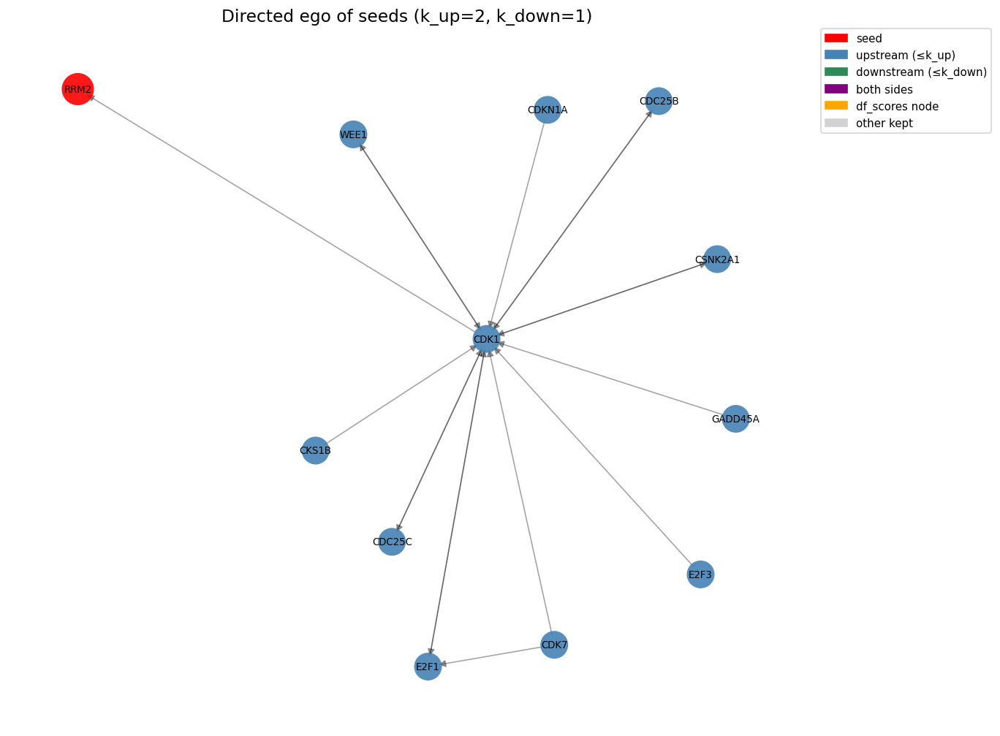

In [327]:
# === Directed ego view: k_up (upstream) & k_down (downstream) ================
# Inputs assumed:
#   - nxg: a NetworkX *DiGraph* with node attr "gene_symbol" (optional)
#   - df_scores: a DataFrame whose index are UniProt IDs you might want to highlight
# Customize:
#   - seeds: list of UniProt IDs to center on (formerly top_receptors)
#   - k_up:   hops through predecessors (upstream)
#   - k_down: hops through successors   (downstream)
# ============================================================================

import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

def k_hop_side(G: nx.DiGraph, starts, k: int, direction: str) -> set:
    """Collect nodes within ≤k hops from 'starts' following IN or OUT direction."""
    if k <= 0:
        return set()
    if direction not in ("in", "out"):
        raise ValueError("direction must be 'in' or 'out'")
    reached = set()
    frontier = set(starts)
    seen = set(starts)
    for _ in range(k):
        nxt = set()
        for u in frontier:
            nbrs = G.predecessors(u) if direction == "in" else G.successors(u)
            for v in nbrs:
                if v not in seen:
                    seen.add(v)
                    nxt.add(v)
        reached |= nxt
        frontier = nxt
        if not frontier:
            break
    return reached

# --- Parameters ---------------------------------------------------------------
seeds   = ['P31350']           # UniProt IDs (formerly: top_receptors)
k_up    = 2                    # upstream hops (predecessors)
k_down  = 1                    # downstream hops (successors)

# --- Build directed k-hop ego (union across seeds) ---------------------------
if not isinstance(nxg, (nx.DiGraph, nx.MultiDiGraph)):
    raise TypeError("nxg must be a directed graph (nx.DiGraph). Use nxg.to_directed() if needed.")

present = set(nxg.nodes)
seeds   = [s for s in seeds if s in present]
if not seeds:
    raise ValueError("None of the seeds are present in the graph.")

up_nodes   = k_hop_side(nxg, seeds, k_up,  "in")   if k_up   > 0 else set()
down_nodes = k_hop_side(nxg, seeds, k_down, "out") if k_down > 0 else set()
keep_nodes = set(seeds) | up_nodes | down_nodes

# Induced subgraph
sub = nxg.subgraph(keep_nodes).copy()

# --- Visual encodings ---------------------------------------------------------
# Colors:
#   seeds = red
#   upstream-only = steelblue
#   downstream-only = seagreen
#   both upstream & downstream (relative to seeds) = purple
#   other nodes that happen to be in df_scores.index = orange (fallback)
#   all else = lightgray

def role(n):
    if n in seeds:
        return "seed"
    in_up   = n in up_nodes
    in_down = n in down_nodes
    if in_up and in_down: return "both"
    if in_up:            return "up"
    if in_down:          return "down"
    return "other"

palette = {
    "seed": "red",
    "up": "steelblue",
    "down": "seagreen",
    "both": "purple",
    "other": "lightgray",
    "highlight": "orange",
}

node_colors = []
node_sizes  = []
node_labels = {}

df_index = set(getattr(df_scores, "index", []))  # safe if df_scores not defined

for n in sub.nodes:
    label = nxg.nodes[n].get("gene_symbol", n)
    node_labels[n] = label

    r = role(n)
    color = palette[r]

    # Optional highlight: if node is in df_scores.index and not already a seed/both
    if (n in df_index) and r == "other":
        color = palette["highlight"]

    size = 700 if r == "seed" else (520 if r in ("both","up","down") else 360)

    node_colors.append(color)
    node_sizes.append(size)

# --- Draw ---------------------------------------------------------------------
plt.figure(figsize=(11.5, 8.5))
pos = nx.spring_layout(sub, seed=42, k=None)  # tweak k for spread if needed

nx.draw_networkx_edges(sub, pos, alpha=0.35, arrows=True, arrowstyle='-|>', arrowsize=12)
nx.draw_networkx_nodes(sub, pos, node_color=node_colors, node_size=node_sizes, alpha=0.9, linewidths=0.0)
nx.draw_networkx_labels(sub, pos, labels=node_labels, font_size=8)

title = f"Directed ego of seeds (k_up={k_up}, k_down={k_down})"
plt.title(title, fontsize=14)
plt.axis("off")

# Legend
legend_handles = [
    Patch(color=palette["seed"], label="seed"),
    Patch(color=palette["up"], label="upstream (≤k_up)"),
    Patch(color=palette["down"], label="downstream (≤k_down)"),
    Patch(color=palette["both"], label="both sides"),
    Patch(color=palette["highlight"], label="df_scores node"),
    Patch(color=palette["other"], label="other kept"),
]
plt.legend(handles=legend_handles, loc="upper left", bbox_to_anchor=(1.02, 1), borderaxespad=0.)
plt.tight_layout()
plt.show()


## 11.5 Upstream regulators of gene of interest (prioritize druggable) (NOT working right now!!!)

In [142]:
import pandas as pd
import networkx as nx

# ------------------------------------------------------------
# Inputs you already have
# ------------------------------------------------------------
G = nxg  # directed DiGraph with node attrs: gene_symbol, etc.
candidates = ["P10244","P20248","Q9NZJ0","Q01094","Q9HAW4","Q96B01","Q9BX63"]
k_up = 2

# From your Intercell pass (TM/peripheral/secreted etc.)
# If you named it differently, point here:
# accessible_in_network = set(recs_in_net_tm) | set(recs_in_net_perm) | set(ligands_in_net)
druggable_sets = {}
druggable_sets["accessible_surface"] = set(accessible_in_network)

# ------------------------------------------------------------
# 1) Load DGIdb and map gene_symbol → UniProt IDs in your graph
# ------------------------------------------------------------
dgidb = pd.read_csv("DGIdb_interactions.tsv", sep="\t")

# Build symbol->uniprot map from your graph
sym2uid = {}
uid2sym = {}
for n in G.nodes:
    sym = G.nodes[n].get("gene_symbol")
    if sym:
        sym2uid.setdefault(sym, set()).add(n)
        uid2sym[n] = sym

# DGIdb → UniProt IDs present in *your* network
dgidb_uids = set()
for sym in dgidb["gene_name"].dropna().unique():
    if sym in sym2uid:
        dgidb_uids |= sym2uid[sym]

druggable_sets["DGIdb"] = dgidb_uids

# Optional: make a per-UID list of DGIdb drug names/effects (handy to show in tables)
# Keep only columns we need and drop obvious dupes
dgidb_small = dgidb.rename(columns={
    "gene_name":"gene_symbol",
    "drug_name":"drug",
    "interaction_type":"interaction_type",
    "interaction_source_db_name":"source_db"
})[["gene_symbol","drug","interaction_type","source_db"]].dropna(subset=["gene_symbol","drug"]).drop_duplicates()

# Map symbols in DGIdb to UniProt IDs, expand to UID-level drug table
rows_drugs = []
for sym, sub in dgidb_small.groupby("gene_symbol"):
    for uid in sym2uid.get(sym, []):
        drugs_here = ";".join(sorted(sub["drug"].astype(str).unique()))
        itypes     = ";".join(sorted(sub["interaction_type"].fillna("").astype(str).unique()))
        sources    = ";".join(sorted(sub["source_db"].astype(str).unique()))
        rows_drugs.append({
            "uniprot": uid,
            "dgidb_drugs": drugs_here,
            "dgidb_interaction_types": itypes,
            "dgidb_sources": sources
        })
dgidb_drugs_by_uid = pd.DataFrame(rows_drugs).set_index("uniprot") if rows_drugs else pd.DataFrame(columns=["uniprot","dgidb_drugs","dgidb_interaction_types","dgidb_sources"]).set_index("uniprot")

# ------------------------------------------------------------
# 2) Helper to annotate "druggable" with provenance
# ------------------------------------------------------------
def druggable_provenance(uid):
    hits = [name for name, s in druggable_sets.items() if uid in s]
    return bool(hits), ";".join(hits)

# ------------------------------------------------------------
# 3) Upstream search (your BFS over predecessors up to k_up)
# ------------------------------------------------------------
rows = []
for cand in candidates:
    if cand not in G:
        continue
    frontier = {cand}
    visited = {cand}
    for depth in range(1, k_up+1):
        next_frontier = set()
        for n in frontier:
            preds = set(G.predecessors(n))
            next_frontier |= (preds - visited)
        for u in next_frontier:
            is_drug, why = druggable_provenance(u)
            rows.append({
                "candidate": cand,
                "upstream": u,
                "hop": depth,
                "is_druggable": is_drug,
                "druggable_sources": why,
                "upstream_in_degree": G.in_degree(u),
                "upstream_out_degree": G.out_degree(u),
                "gene_symbol_upstream": G.nodes[u].get("gene_symbol", u),
                "gene_symbol_candidate": G.nodes[cand].get("gene_symbol", cand),
            })
        visited |= next_frontier
        frontier = next_frontier





upstream_df = pd.DataFrame(rows)

# --- Tidy + filter + pretty print the upstream table ---

# Parameters you can tweak
MIN_DEGREE_SUM       = 8    # in_degree + out_degree must be >= this to pass (unless druggable)
MIN_DRUGS            = 2    # at least this many DGIdb drugs (unless druggable)
MAX_DRUGS_DISPLAY    = 5    # show up to N drugs; append "(+m more)" if longer
TOP_K_PER_CANDIDATE  = 8    # how many rows to show per candidate
ONLY_HOPS_UP_TO      = 2    # keep upstream hits within this hop distance

df = upstream_df.copy()

# Safety fills (avoid NaNs while counting)
for col in ["dgidb_drugs", "dgidb_interaction_types", "dgidb_sources"]:
    if col not in df.columns:
        df[col] = ""
df[["dgidb_drugs","dgidb_interaction_types","dgidb_sources"]] = \
    df[["dgidb_drugs","dgidb_interaction_types","dgidb_sources"]].fillna("")

# Summaries
df["degree_sum"]   = df["upstream_in_degree"].fillna(0) + df["upstream_out_degree"].fillna(0)
df["drug_count"]   = df["dgidb_drugs"].apply(lambda s: 0 if not s else len([x for x in s.split(";") if x]))
df["source_count"] = df["dgidb_sources"].apply(lambda s: 0 if not s else len([x for x in s.split(";") if x]))
df["itype_count"]  = df["dgidb_interaction_types"].apply(lambda s: 0 if not s else len([x for x in s.split(";") if x]))

# “Sum filter”: keep rows that are either druggable OR reasonably connected OR have multiple drugs
mask = (
    (df["hop"] <= ONLY_HOPS_UP_TO) &
    (
        df["is_druggable"] |
        (df["degree_sum"] >= MIN_DEGREE_SUM) |
        (df["drug_count"] >= MIN_DRUGS)
    )
)
df_filt = df.loc[mask].copy()

# Truncate long drug lists for readability
def truncate_list(s, n=MAX_DRUGS_DISPLAY):
    if not s:
        return ""
    items = [x for x in s.split(";") if x]
    if len(items) <= n:
        return "; ".join(items)
    return "; ".join(items[:n]) + f" (+{len(items)-n} more)"

df_filt["drugs_short"]  = df_filt["dgidb_drugs"].apply(lambda s: truncate_list(s, MAX_DRUGS_DISPLAY))
df_filt["itypes_short"] = df_filt["dgidb_interaction_types"].apply(lambda s: truncate_list(s, MAX_DRUGS_DISPLAY))
df_filt["sources_short"]= df_filt["dgidb_sources"].apply(lambda s: truncate_list(s, MAX_DRUGS_DISPLAY))

# Sort: per-candidate, prioritize druggable → closer → degree → drug_count
df_filt = df_filt.sort_values(
    ["candidate","is_druggable","hop","degree_sum","drug_count"],
    ascending=[True, False, True, False, False]
)

# Keep top-K per candidate
df_pretty = (
    df_filt
    .groupby("candidate", group_keys=False)
    .head(TOP_K_PER_CANDIDATE)
    .loc[:, [
        "candidate","gene_symbol_candidate",
        "upstream","gene_symbol_upstream","hop",
        "is_druggable","druggable_sources",
        "upstream_in_degree","upstream_out_degree","degree_sum",
        "drug_count","drugs_short",
        "itype_count","itypes_short",
        "source_count","sources_short"
    ]]
    .rename(columns={
        "candidate": "candidate_uid",
        "gene_symbol_candidate": "candidate_symbol",
        "upstream": "upstream_uid",
        "gene_symbol_upstream": "upstream_symbol",
        "drugs_short": "dgidb_drugs",
        "itypes_short": "dgidb_interaction_types",
        "sources_short": "dgidb_sources"
    })
)

pd.set_option("display.max_colwidth", 120)
print("🔼 Upstream regulators (clean view; truncated drug lists):")
print(df_pretty.to_string(index=False))


FileNotFoundError: [Errno 2] No such file or directory: 'DGIdb_interactions.tsv'

## 11.6 Why CDK1 has this high increase in centrality: Find genes that perturb CDK1 centrality 

### 11.6.1 Downstream overlap of genes of interest with CDK1 targets (2nd/3rd neighbors)

In [144]:
candidates = ["P10244","P20248","Q9NZJ0","Q01094","Q9HAW4","Q96B01","Q9BX63","P84022","P11802","P38936","P30291","P68400","P61024"]

In [148]:
import pandas as pd

# --- Inputs ---
G = nxg                                  # directed DiGraph
candidates = ["P10244","P20248","Q9NZJ0","Q01094","Q9HAW4","Q96B01","Q9BX63"]
seed_uniprots = ["P06493","P38936","P00533","P17252"]  # CDK1 + others
#seed_uniprots = ["P06493","P38936"]
k_down = 3

def downstream_set(G, src, k):
    if src not in G:
        return set()
    visited = set([src])
    frontier = {src}
    acc = set()
    for _ in range(k):
        next_frontier = set()
        for n in frontier:
            succs = set(G.successors(n))
            next_frontier |= (succs - visited)
        acc |= next_frontier
        visited |= next_frontier
        frontier = next_frontier
        if not frontier:
            break
    return acc

rows = []
# Precompute downstream sets for seeds
seed_down = {}
for seed in seed_uniprots:
    if seed not in G:
        print(f"⚠️ Seed {seed} not in graph — skipping.")
        continue
    seed_down[seed] = downstream_set(G, seed, k_down)

# Compute overlaps per seed × candidate
for seed, sdown in seed_down.items():
    sdown_n = len(sdown)
    seed_sym = G.nodes[seed].get("gene_symbol", seed)
    for cand in candidates:
        if cand not in G:
            continue
        cdown = downstream_set(G, cand, k_down)
        inter = sdown & cdown
        rows.append({
            "seed": seed,
            "seed_symbol": seed_sym,
            "candidate": cand,
            "candidate_symbol": G.nodes[cand].get("gene_symbol", cand),
            "seed_down_size": sdown_n,
            "cand_down_size": len(cdown),
            "overlap_size": len(inter),
            "pct_overlap_of_seed": (len(inter) / max(sdown_n, 1)) * 100.0,
            "pct_overlap_of_candidate": (len(inter) / max(len(cdown), 1)) * 100.0,
        })

overlap_long = pd.DataFrame(rows)

# Nicely print per-seed top overlaps
print(f"⬇️ Directed downstream overlap (k={k_down}) — per seed:")
for seed in seed_down.keys():
    sub = overlap_long[overlap_long["seed"] == seed].sort_values("pct_overlap_of_seed", ascending=False)
    print(f"\n--- Seed {seed} ({sub['seed_symbol'].iloc[0] if not sub.empty else seed}) ---")
    print(sub[["candidate","candidate_symbol","seed_down_size","cand_down_size",
               "overlap_size","pct_overlap_of_seed","pct_overlap_of_candidate"]].head(10).to_string(index=False))

# Optional: pivot summary (candidates × seeds) on % overlap of seed
pivot_pct = overlap_long.pivot_table(
    index=["candidate","candidate_symbol"],
    columns="seed",
    values="pct_overlap_of_seed",
    fill_value=0.0
)

# Add a ranking helper
pivot_pct["max_pct_overlap_any_seed"] = pivot_pct.max(axis=1)
pivot_pct = pivot_pct.sort_values("max_pct_overlap_any_seed", ascending=False)

print("\n🌟 Summary (candidates ranked by max % overlap across seeds):")
print(pivot_pct.head(15))


⬇️ Directed downstream overlap (k=3) — per seed:

--- Seed P06493 (CDK1) ---
candidate candidate_symbol  seed_down_size  cand_down_size  overlap_size  pct_overlap_of_seed  pct_overlap_of_candidate
   Q01094             E2F1             334             226           225            67.365269                 99.557522
   Q9HAW4            CLSPN             334              45            44            13.173653                 97.777778
   Q9BX63            BRIP1             334              45            44            13.173653                 97.777778
   Q9NZJ0              DTL             334               6             4             1.197605                 66.666667
   Q96B01         RAD51AP1             334               1             1             0.299401                100.000000
   P20248            CCNA2             334               0             0             0.000000                  0.000000
   P10244            MYBL2             334               0             0           

In [149]:
# Add overlap members (optional, can be large)
def symbolize(nodes):
    return [G.nodes[n].get("gene_symbol", n) for n in nodes]

overlap_list_rows = []
for cand in candidates:
    inter = downstream_set(G, cand, k_down) & cdk1_down
    overlap_list_rows.append({
        "candidate": cand,
        "overlap_uniprot": list(sorted(inter)),
        "overlap_symbols": symbolize(inter)
    })
overlap_lists = pd.DataFrame(overlap_list_rows)


NameError: name 'cdk1_down' is not defined

### 11.6.2 KO simulation to test influence of genes of interest on CDK1 betweenness sensitivity

#### Helpers functions

In [150]:
# --- STRICT UniProt KO computed on BIG graph g, then applied to subnetworks ---
import igraph as ig
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import linregress

# ----------------- helpers -----------------
def _ensure_symbol(v):
    sym = v["gene_symbol"] if "gene_symbol" in v.attributes() else None
    return sym if (sym and len(sym)) else v["name"]

def betweenness_long_df(graphs_by_group, groups_order):
    rows = []
    for grp in groups_order:
        if grp not in graphs_by_group:
            continue
        gsub = graphs_by_group[grp]
        btwn = gsub.betweenness(directed=True)
        for v, score in zip(gsub.vs, btwn):
            rows.append({
                "group": grp,
                "gene_symbol": _ensure_symbol(v),  # for plotting
                "uniprot": v["name"],              # ID space
                "betweenness": score
            })
    return pd.DataFrame(rows)

def ig_downstream_k(g_big: ig.Graph, src_uniprot: str, k: int) -> set[str]:
    """Directed OUT-neighbors within ≤k hops on the *full* graph g_big (returns UniProt IDs)."""
    if src_uniprot not in g_big.vs["name"] or k <= 0:
        return set()
    src = g_big.vs.find(name=src_uniprot).index
    reached = set()
    frontier = {src}
    seen = {src}
    for _ in range(k):
        if not frontier:
            break
        nxt = set()
        for vid in frontier:
            for w in g_big.neighbors(vid, mode="OUT"):
                if w not in seen:
                    seen.add(w)
                    nxt.add(w)
        reached |= nxt
        frontier = nxt
    return set(g_big.vs[list(reached)]["name"])

def apply_ko_to_group_graphs(graphs_by_group, ko_uniprot_set, exclude_ids=None):
    """Remove ko_uniprot_set (minus exclude_ids) from every subgraph; return new dict."""
    excl = set(exclude_ids or [])
    rm = set(ko_uniprot_set) - excl
    out = {}
    for grp, gsub in graphs_by_group.items():
        if not rm.intersection(gsub.vs["name"]):
            out[grp] = gsub.copy()
            continue
        keep_idx = [i for i, up in enumerate(gsub.vs["name"]) if up not in rm]
        out[grp] = gsub.subgraph(ig.VertexSeq(gsub, keep_idx))
    return out

def plot_top_slope_trends(betw_df, groups_order, top_n=20, title=""):
    pv = betw_df.pivot_table(index="gene_symbol", columns="group",
                             values="betweenness", fill_value=0.0)
    t = np.arange(len(groups_order))
    slopes = []
    for gs in pv.index:
        y = pv.loc[gs, groups_order].to_numpy(dtype=float)
        slope, *_ = linregress(t, y)
        slopes.append((gs, slope))
    slopes_df = pd.DataFrame(slopes, columns=["gene_symbol","slope"])
    top = slopes_df.reindex(slopes_df["slope"].abs().sort_values(ascending=False).index).head(top_n)

    plt.figure(figsize=(10, 5))
    for gene in top["gene_symbol"]:
        series = pv.loc[gene, groups_order]
        plt.plot(groups_order, series.values, marker='o',
                 label=f"{gene} (slope={top.set_index('gene_symbol').loc[gene, 'slope']:.2f})")
    plt.title(title)
    plt.xlabel("Group (Pseudotime)")
    plt.ylabel("Betweenness Centrality")
    plt.xticks(rotation=45)
    plt.legend(fontsize="small", loc="upper left", bbox_to_anchor=(1, 1))
    plt.tight_layout()
    plt.show()


#### Genes of interest

#### Genes of interest are in the network and subnetwork?

In [151]:
import pandas as pd

# --- your genes of interest (UniProt -> symbol) ---
interest = {
    "P06493": "CDK1",
    "P10244": "MYBL2",
    "P20248": "CCNA2",
    "Q9NZJ0": "DTL",
    "Q01094": "E2F1",
    "Q9HAW4": "CLSPN",
    "Q96B01": "RAD51AP1",
    "Q9BX63": "BRIP1",
    "P84022": "SMAD3",
    "P11802": "CDK4",
    "P38936": "CDKN1A",
    "P30291": "WEE1",
    "P68400": "CSNK2A1",
    "P61024": "CKS1B",
}

def _nameset(G):
    return set(G.vs["name"]) if G and G.vcount() else set()

def _base(u):  # tolerate isoforms like Q01094-2
    return str(u).split("-")[0]

def audit_presence(g, group_graphs, interest, groups_order=None, tolerate_isoforms=True):
    """
    g: igraph.Graph (full network; vertex 'name' = UniProt)
    group_graphs: dict[group -> igraph.Graph] (your per-bin subnetworks)
    interest: dict[UniProt -> symbol]
    groups_order: optional list to control group column order
    tolerate_isoforms: if True, counts presence when any isoform of the base accession exists
    """
    groups_order = groups_order or list(group_graphs.keys())

    # Full graph name sets (exact + base→ids for isoform tolerance)
    g_names = _nameset(g)
    g_base2ids = {}
    for up in g_names:
        g_base2ids.setdefault(_base(up), set()).add(up)

    # Subgraph name sets (+ base maps)
    grp_names = {grp: _nameset(G) for grp, G in group_graphs.items()}
    grp_base2ids = {}
    for grp, names in grp_names.items():
        m = {}
        for up in names:
            m.setdefault(_base(up), set()).add(up)
        grp_base2ids[grp] = m

    rows = []
    for up, sym in interest.items():
        base = _base(up)

        # in big graph
        in_g_exact = up in g_names
        in_g_any   = (base in g_base2ids) if tolerate_isoforms else in_g_exact
        g_hits     = sorted(g_base2ids.get(base, set())) if in_g_any else []

        # in subgraphs
        groups_present = []
        for grp in groups_order:
            if grp not in grp_base2ids: 
                continue
            if tolerate_isoforms:
                present = base in grp_base2ids[grp]
            else:
                present = up in grp_names[grp]
            if present:
                groups_present.append(grp)

        rows.append({
            "uniprot": up,
            "gene_symbol": sym,
            "in_g_exact": bool(in_g_exact),
            "in_g_any_isoform": bool(in_g_any),
            "g_ids_matched": ",".join(g_hits),
            "n_groups_present": len(groups_present),
            "groups_present": ";".join(groups_present)
        })

    df = pd.DataFrame(rows).sort_values(
        ["in_g_any_isoform","n_groups_present","gene_symbol"],
        ascending=[False, False, True]
    ).reset_index(drop=True)

    # readable print
    print("🔎 Presence in full graph `g` and subnetworks:")
    for _, r in df.iterrows():
        print(f"• {r['gene_symbol']:8s} {r['uniprot']}: "
              f"in_g={'Y' if r['in_g_any_isoform'] else 'N'} "
              f"(exact={'Y' if r['in_g_exact'] else 'N'}), "
              f"groups={r['n_groups_present'] or 0}  "
              f"{'['+r['groups_present']+']' if r['groups_present'] else ''}")
    df
    return df

# --- run it ---
# If you have a preferred order, pass it as groups_order (e.g., your TRAJ_3 that exist):
# groups_order = [g for g in TRAJ_3 if g in group_graphs]
presence_df = audit_presence(g, group_graphs, interest, groups_order=None, tolerate_isoforms=True)

# Show the table
presence_df


🔎 Presence in full graph `g` and subnetworks:
• CSNK2A1  P68400: in_g=Y (exact=Y), groups=12  [0_t_0.0000-0.5000;3_t_1.0000-1.5000;3_t_0.0000-1.0000;3_t_1.5000-2.5000;2_t_3.5000-4.0000;1_t_0.5000-1.5000;2_t_1.0000-2.5000;1_t_3.0000-3.5000;1_t_1.5000-2.5000;1_t_2.5000-3.0000;2_t_2.5000-3.0000;2_t_3.0000-3.5000]
• SMAD3    P84022: in_g=Y (exact=Y), groups=12  [0_t_0.0000-0.5000;3_t_1.0000-1.5000;3_t_0.0000-1.0000;3_t_1.5000-2.5000;2_t_3.5000-4.0000;1_t_0.5000-1.5000;2_t_1.0000-2.5000;1_t_3.0000-3.5000;1_t_1.5000-2.5000;1_t_2.5000-3.0000;2_t_2.5000-3.0000;2_t_3.0000-3.5000]
• CDK1     P06493: in_g=Y (exact=Y), groups=6  [3_t_1.0000-1.5000;3_t_1.5000-2.5000;2_t_3.5000-4.0000;2_t_1.0000-2.5000;2_t_2.5000-3.0000;2_t_3.0000-3.5000]
• CKS1B    P61024: in_g=Y (exact=Y), groups=6  [3_t_1.0000-1.5000;3_t_1.5000-2.5000;2_t_3.5000-4.0000;2_t_1.0000-2.5000;2_t_2.5000-3.0000;2_t_3.0000-3.5000]
• WEE1     P30291: in_g=Y (exact=Y), groups=6  [3_t_1.0000-1.5000;3_t_1.5000-2.5000;2_t_3.5000-4.0000;2_t_1.

,uniprot,gene_symbol,in_g_exact,in_g_any_isoform,g_ids_matched,n_groups_present,groups_present
0,P68400,CSNK2A1,True,True,P68400,12,0_t_0.0000-0.5000;3_t_1.0000-1.5000;3_t_0.0000...
1,P84022,SMAD3,True,True,P84022,12,0_t_0.0000-0.5000;3_t_1.0000-1.5000;3_t_0.0000...
2,P06493,CDK1,True,True,P06493,6,3_t_1.0000-1.5000;3_t_1.5000-2.5000;2_t_3.5000...
3,P61024,CKS1B,True,True,P61024,6,3_t_1.0000-1.5000;3_t_1.5000-2.5000;2_t_3.5000...
4,P30291,WEE1,True,True,P30291,6,3_t_1.0000-1.5000;3_t_1.5000-2.5000;2_t_3.5000...
5,P11802,CDK4,True,True,P11802,4,3_t_1.5000-2.5000;2_t_1.0000-2.5000;2_t_2.5000...
6,P38936,CDKN1A,True,True,P38936,3,2_t_3.5000-4.0000;2_t_2.5000-3.0000;2_t_3.0000...
7,Q9HAW4,CLSPN,True,True,Q9HAW4,2,2_t_1.0000-2.5000;2_t_2.5000-3.0000
8,Q9NZJ0,DTL,True,True,Q9NZJ0,2,2_t_1.0000-2.5000;2_t_2.5000-3.0000
9,Q9BX63,BRIP1,True,True,Q9BX63,0,


#### Knockout genes of interest and downstream neighbors, exclude focus genes

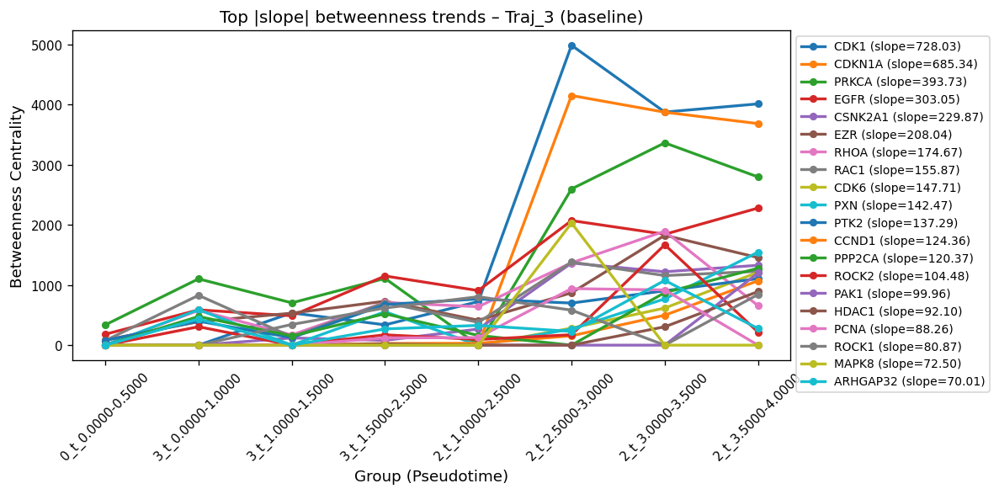


🛠 KO candidate P10244 (MYBL2) on BIG g:
   • KO set size (UniProt): 1
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 0, '3_t_0.0000-1.0000': 0, '3_t_1.0000-1.5000': 0, '3_t_1.5000-2.5000': 0, '2_t_1.0000-2.5000': 0, '2_t_2.5000-3.0000': 0, '2_t_3.0000-3.5000': 0, '2_t_3.5000-4.0000': 0}
   • Examples: ['P10244(MYBL2)']


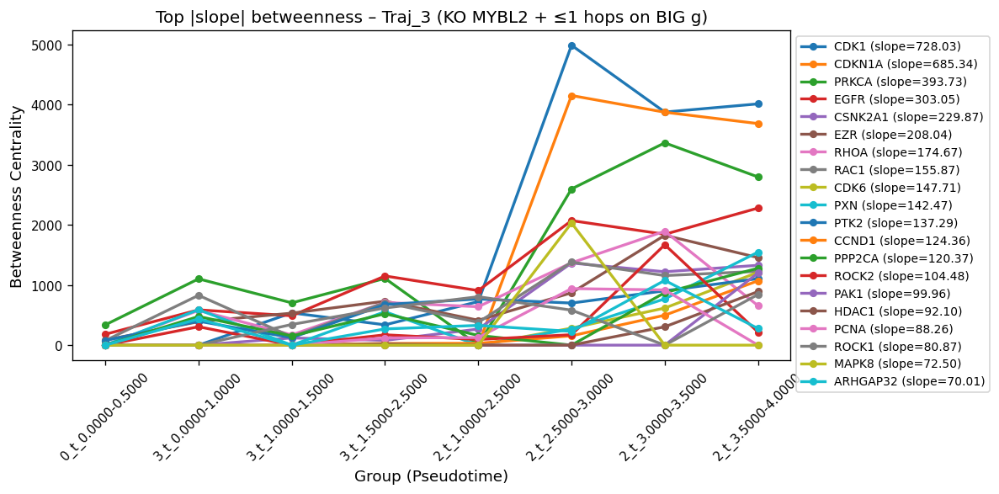

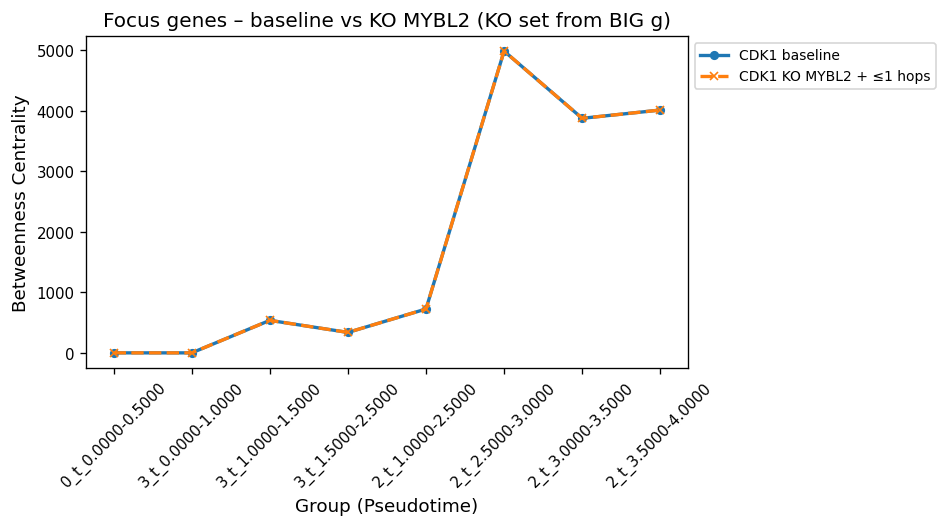


🛠 KO candidate P20248 (CCNA2) on BIG g:
   • KO set size (UniProt): 1
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 0, '3_t_0.0000-1.0000': 0, '3_t_1.0000-1.5000': 0, '3_t_1.5000-2.5000': 0, '2_t_1.0000-2.5000': 0, '2_t_2.5000-3.0000': 0, '2_t_3.0000-3.5000': 0, '2_t_3.5000-4.0000': 0}
   • Examples: ['P20248(CCNA2)']


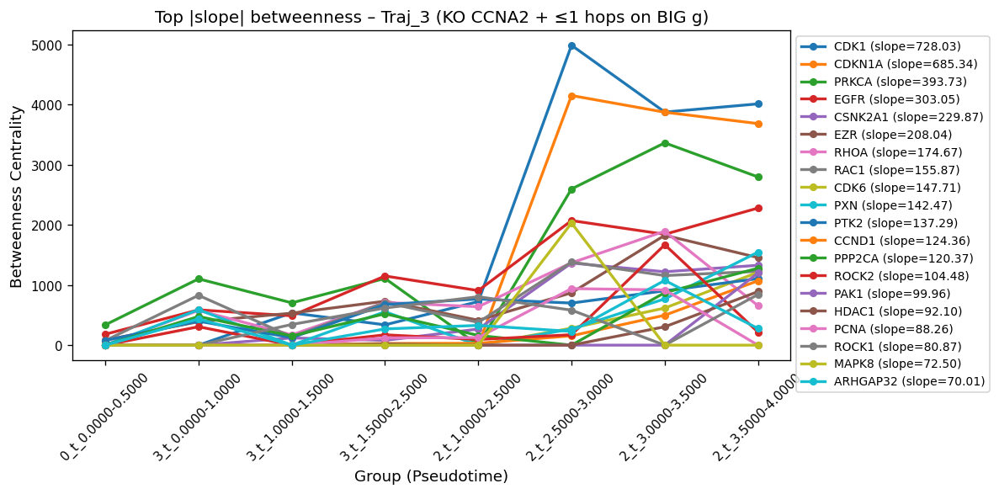

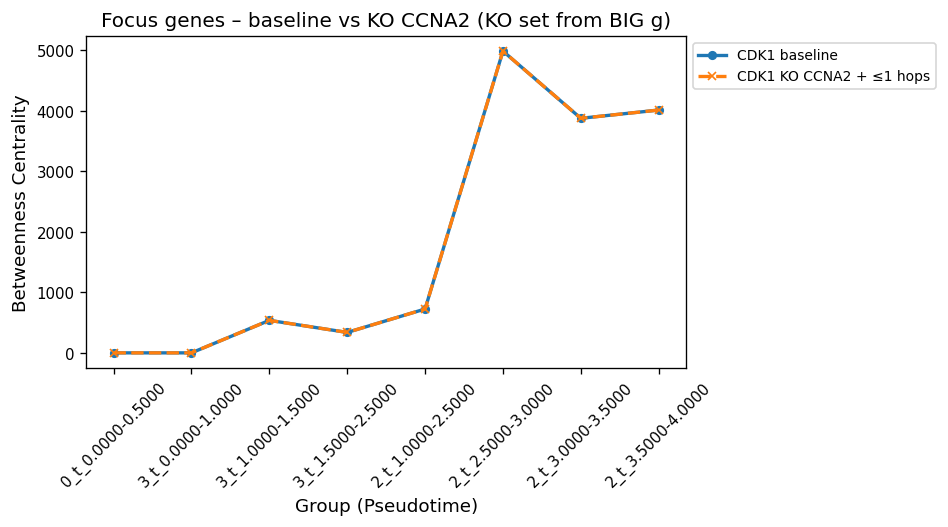


🛠 KO candidate Q9NZJ0 (DTL) on BIG g:
   • KO set size (UniProt): 3
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 0, '3_t_0.0000-1.0000': 0, '3_t_1.0000-1.5000': 1, '3_t_1.5000-2.5000': 1, '2_t_1.0000-2.5000': 2, '2_t_2.5000-3.0000': 2, '2_t_3.0000-3.5000': 0, '2_t_3.5000-4.0000': 0}
   • Examples: ['Q13619(CUL4A)', 'Q9NQR1(KMT5A)', 'Q9NZJ0(DTL)']


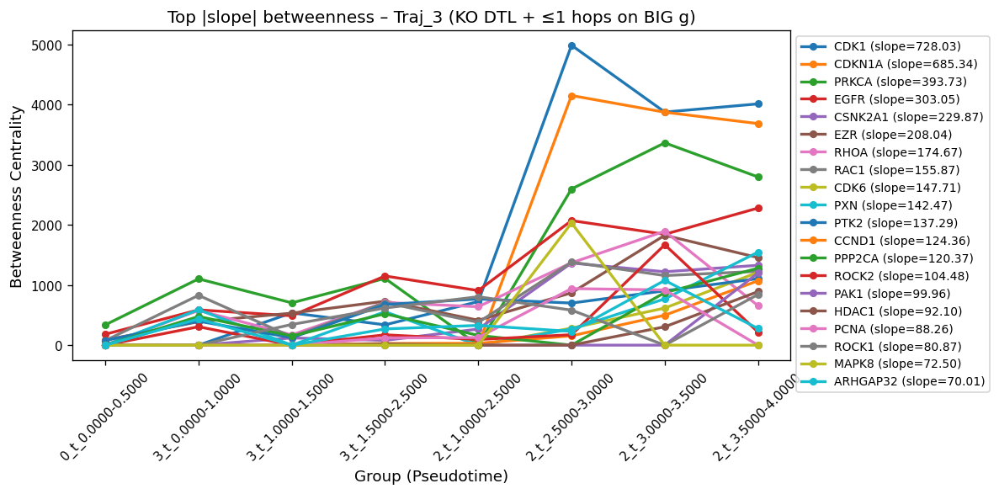

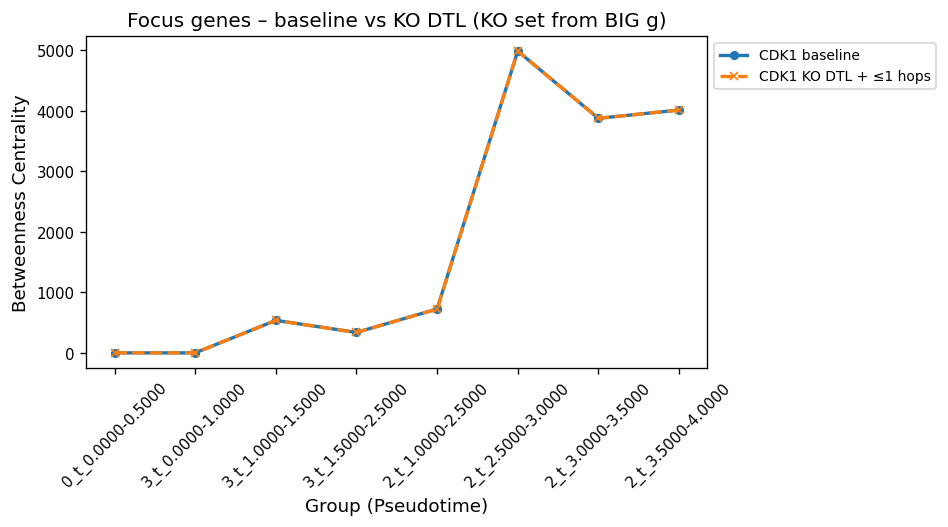


🛠 KO candidate Q01094 (E2F1) on BIG g:
   • KO set size (UniProt): 13
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 0, '3_t_0.0000-1.0000': 0, '3_t_1.0000-1.5000': 1, '3_t_1.5000-2.5000': 2, '2_t_1.0000-2.5000': 2, '2_t_2.5000-3.0000': 3, '2_t_3.0000-3.5000': 2, '2_t_3.5000-4.0000': 0}
   • Examples: ['O14757(CHEK1)', 'P04637(TP53)', 'P12004(PCNA)', 'P14635(CCNB1)', 'P38398(BRCA1)', 'Q01094(E2F1)', 'Q14186(TFDP1)', 'Q92466(DDB2)', 'Q9H211(CDT1)', 'Q9UBU7(DBF4)']


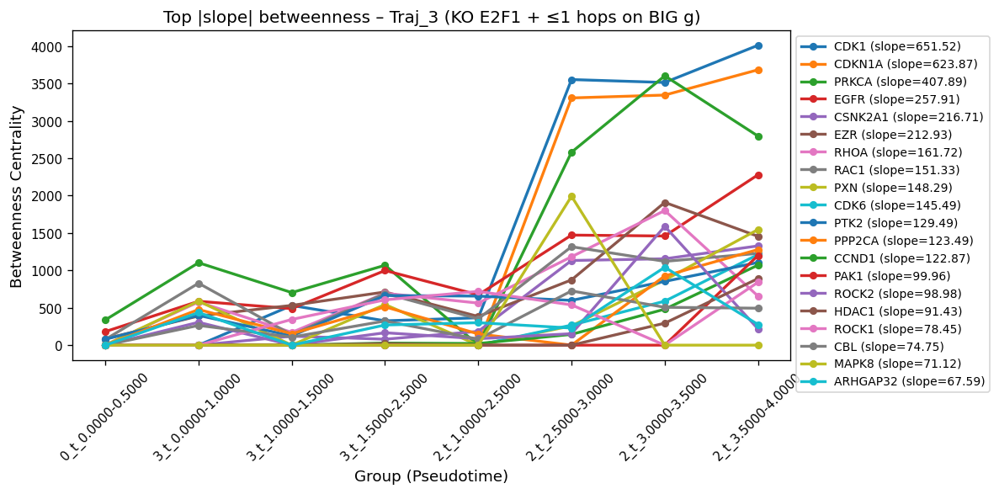

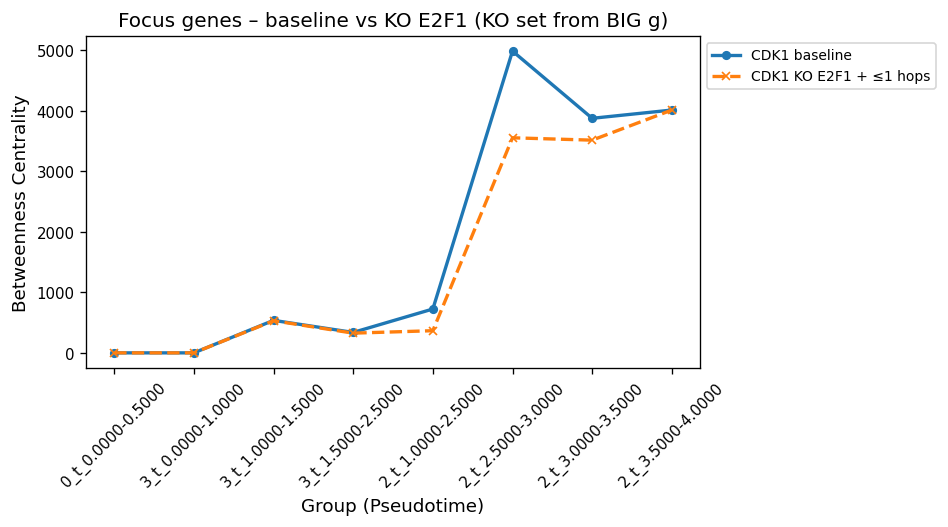


🛠 KO candidate Q9HAW4 (CLSPN) on BIG g:
   • KO set size (UniProt): 2
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 0, '3_t_0.0000-1.0000': 0, '3_t_1.0000-1.5000': 0, '3_t_1.5000-2.5000': 0, '2_t_1.0000-2.5000': 2, '2_t_2.5000-3.0000': 2, '2_t_3.0000-3.5000': 0, '2_t_3.5000-4.0000': 0}
   • Examples: ['O14757(CHEK1)', 'Q9HAW4(CLSPN)']


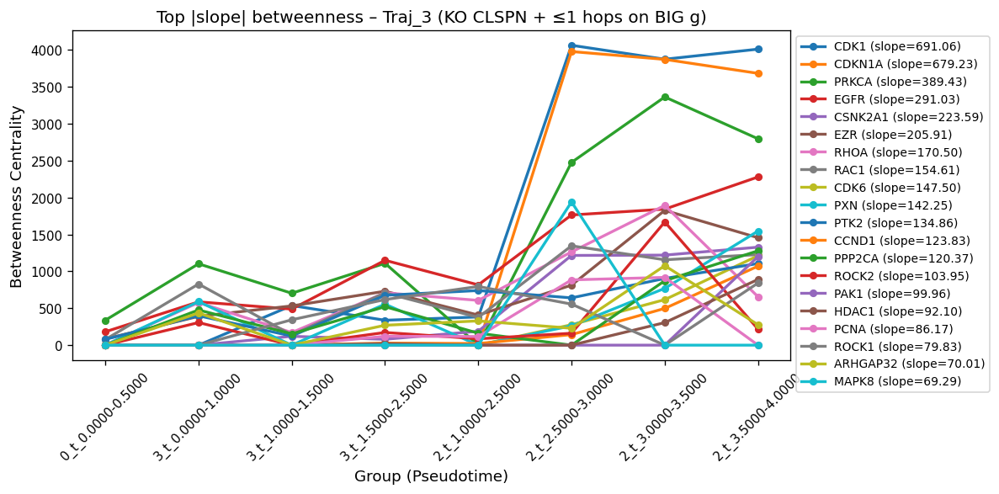

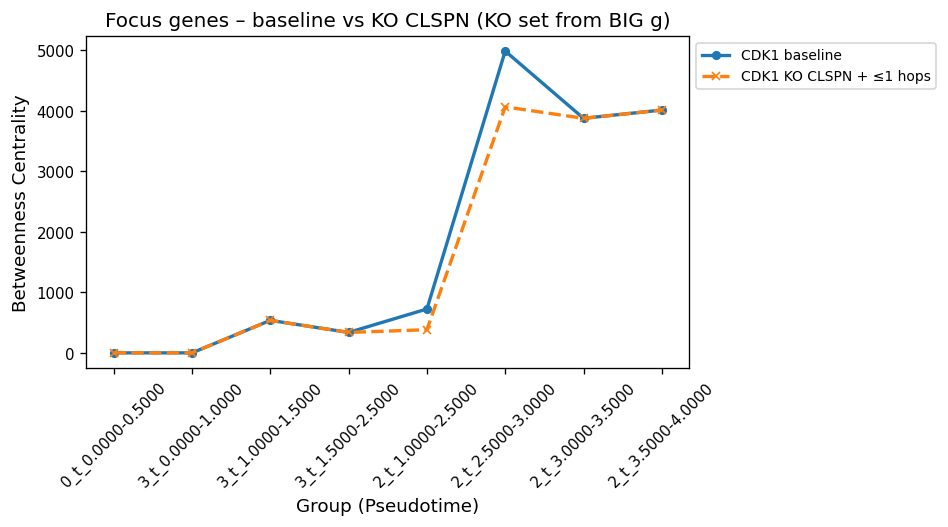


🛠 KO candidate Q96B01 (RAD51AP1) on BIG g:
   • KO set size (UniProt): 2
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 0, '3_t_0.0000-1.0000': 0, '3_t_1.0000-1.5000': 0, '3_t_1.5000-2.5000': 0, '2_t_1.0000-2.5000': 0, '2_t_2.5000-3.0000': 0, '2_t_3.0000-3.5000': 0, '2_t_3.5000-4.0000': 0}
   • Examples: ['Q06609(RAD51)', 'Q96B01(RAD51AP1)']


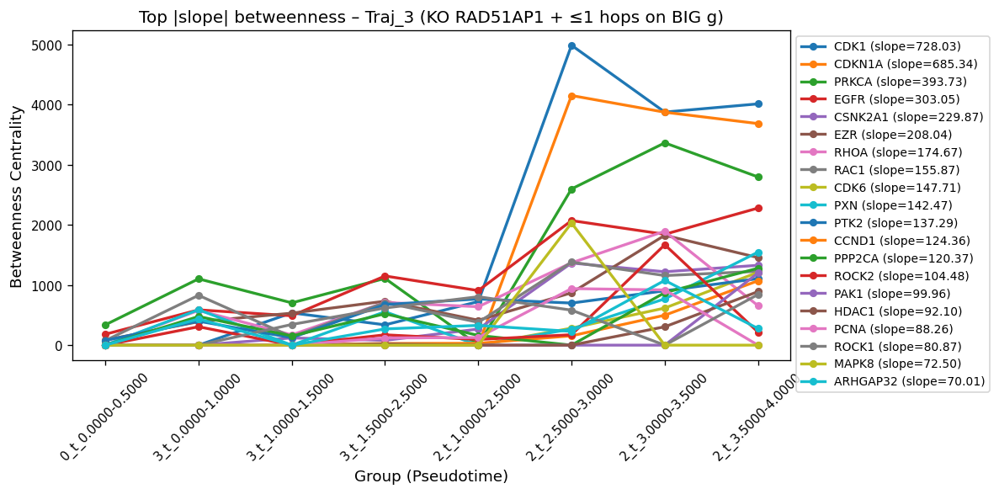

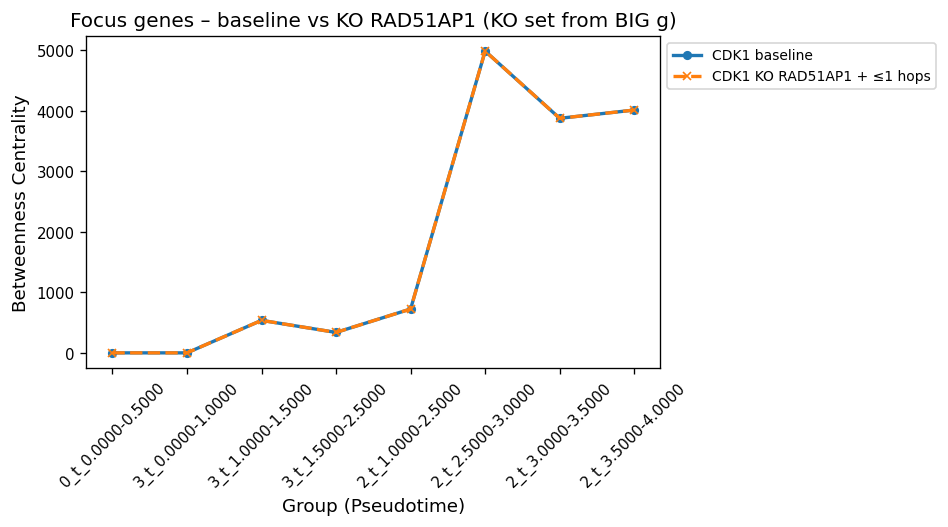


🛠 KO candidate Q9BX63 (BRIP1) on BIG g:
   • KO set size (UniProt): 2
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 0, '3_t_0.0000-1.0000': 0, '3_t_1.0000-1.5000': 0, '3_t_1.5000-2.5000': 0, '2_t_1.0000-2.5000': 0, '2_t_2.5000-3.0000': 0, '2_t_3.0000-3.5000': 0, '2_t_3.5000-4.0000': 0}
   • Examples: ['P38398(BRCA1)', 'Q9BX63(BRIP1)']


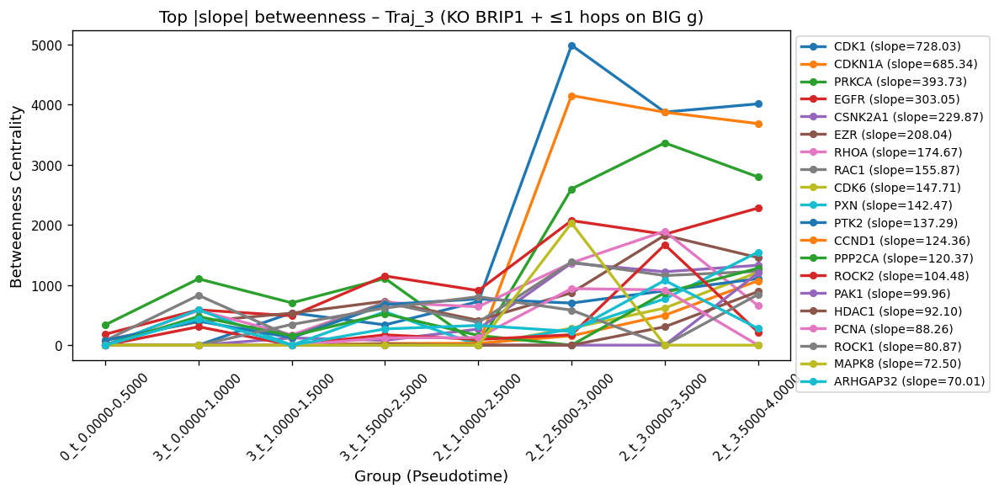

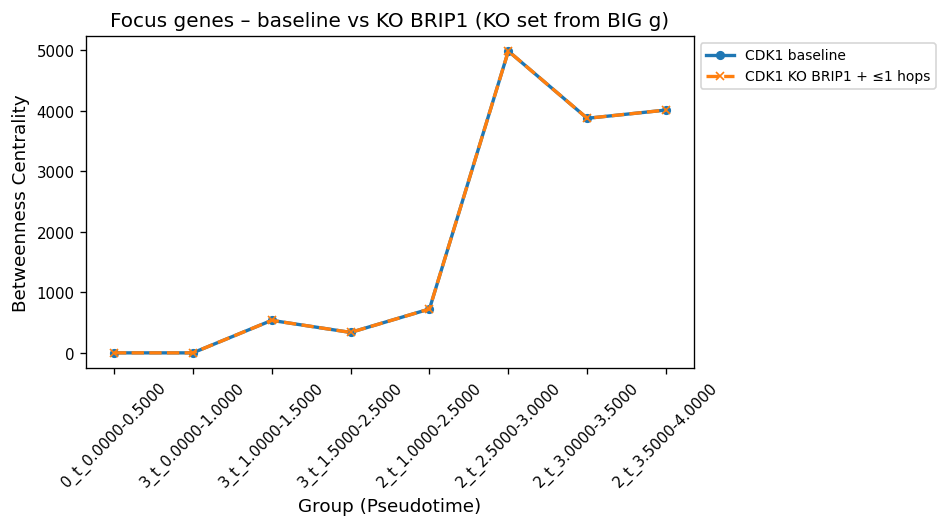


🛠 KO candidate P84022 (SMAD3) on BIG g:
   • KO set size (UniProt): 3
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 2, '3_t_0.0000-1.0000': 2, '3_t_1.0000-1.5000': 2, '3_t_1.5000-2.5000': 2, '2_t_1.0000-2.5000': 2, '2_t_2.5000-3.0000': 2, '2_t_3.0000-3.5000': 2, '2_t_3.5000-4.0000': 2}
   • Examples: ['P05412(JUN)', 'P84022(SMAD3)', 'Q13950(RUNX2)']


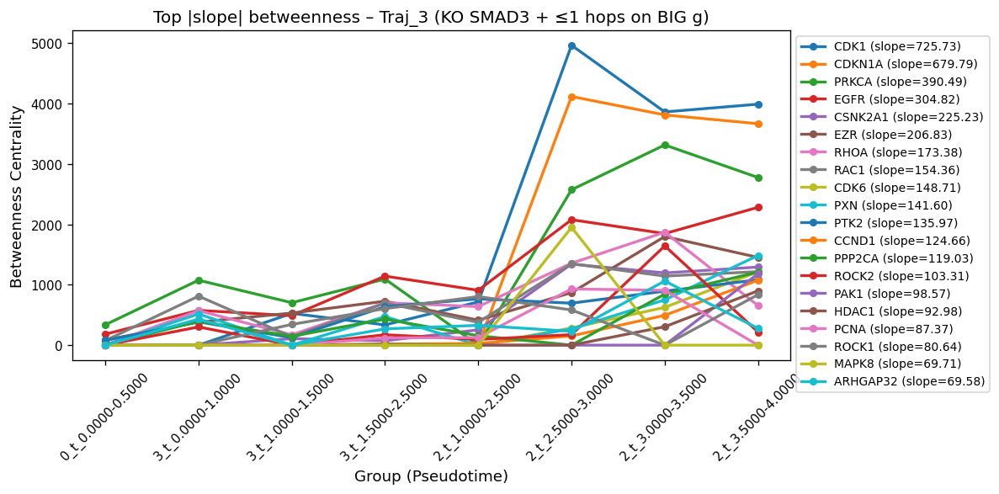

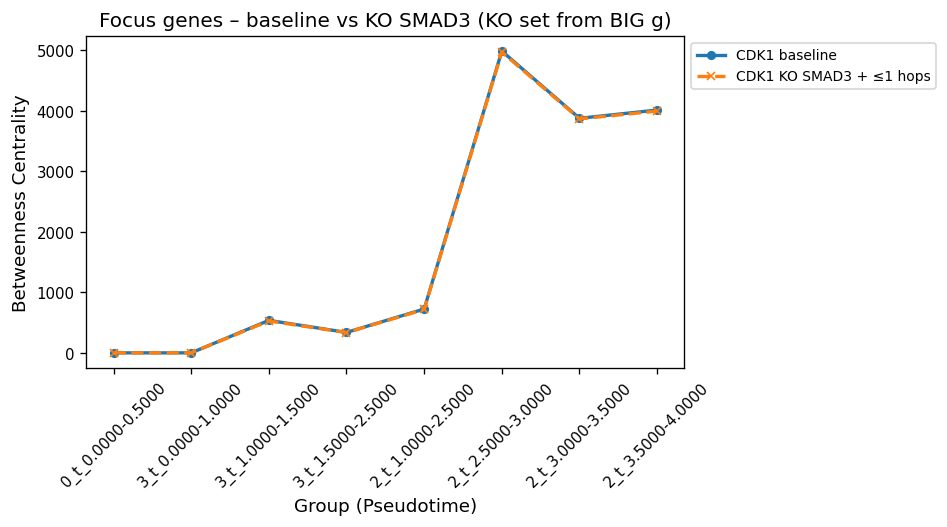


🛠 KO candidate P11802 (CDK4) on BIG g:
   • KO set size (UniProt): 6
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 1, '3_t_0.0000-1.0000': 1, '3_t_1.0000-1.5000': 2, '3_t_1.5000-2.5000': 3, '2_t_1.0000-2.5000': 4, '2_t_2.5000-3.0000': 4, '2_t_3.0000-3.5000': 4, '2_t_3.5000-4.0000': 2}
   • Examples: ['P06400(RB1)', 'P11802(CDK4)', 'P28749(RBL1)', 'P38398(BRCA1)', 'P84022(SMAD3)', 'Q92879(CELF1)']


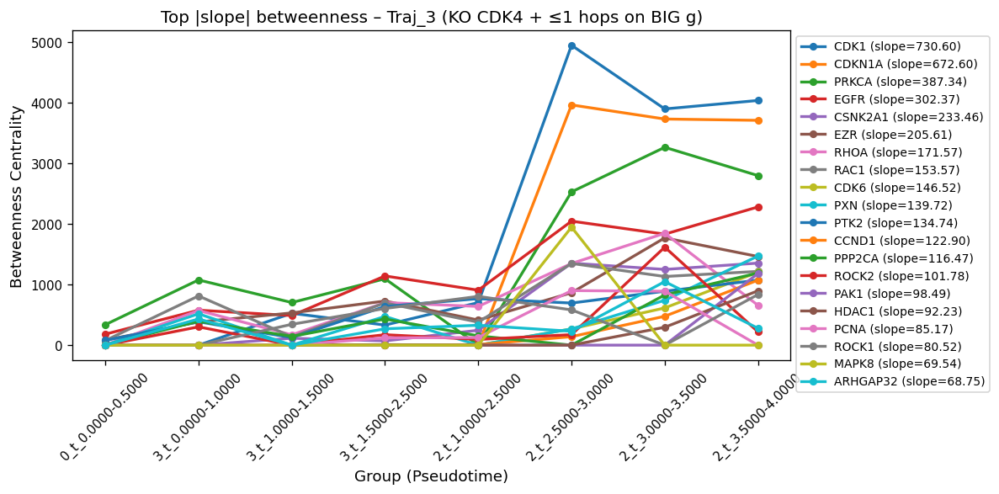

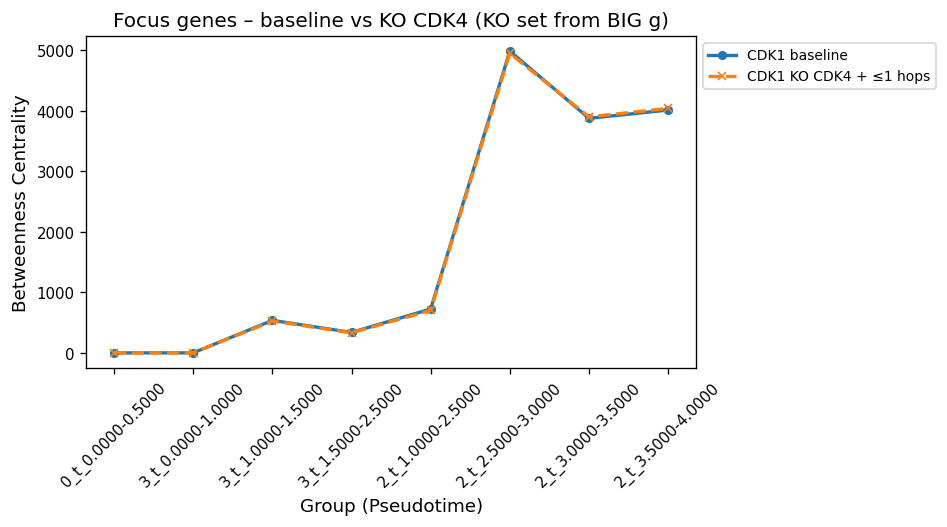


🛠 KO candidate P38936 (CDKN1A) on BIG g:
   • KO set size (UniProt): 5
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 0, '3_t_0.0000-1.0000': 0, '3_t_1.0000-1.5000': 1, '3_t_1.5000-2.5000': 3, '2_t_1.0000-2.5000': 3, '2_t_2.5000-3.0000': 5, '2_t_3.0000-3.5000': 5, '2_t_3.5000-4.0000': 2}
   • Examples: ['P11802(CDK4)', 'P12004(PCNA)', 'P14635(CCNB1)', 'P38936(CDKN1A)', 'Q00534(CDK6)']


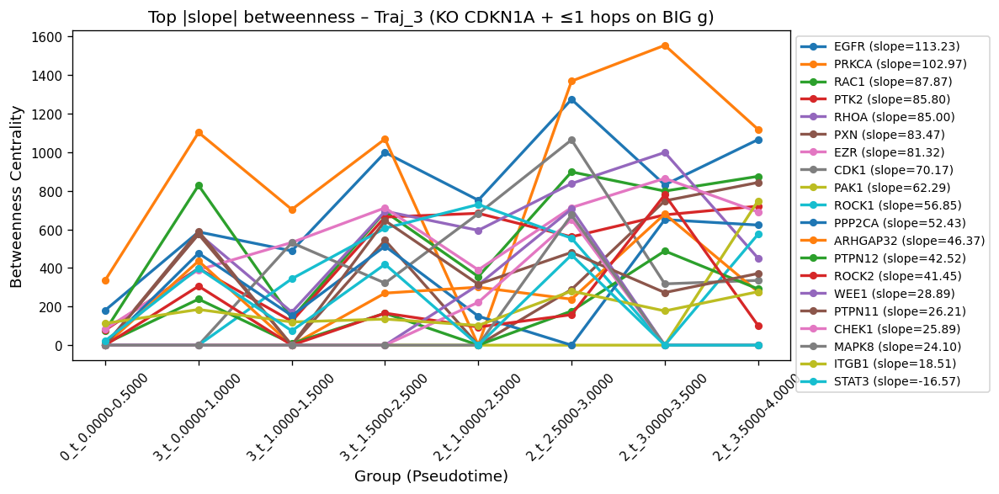

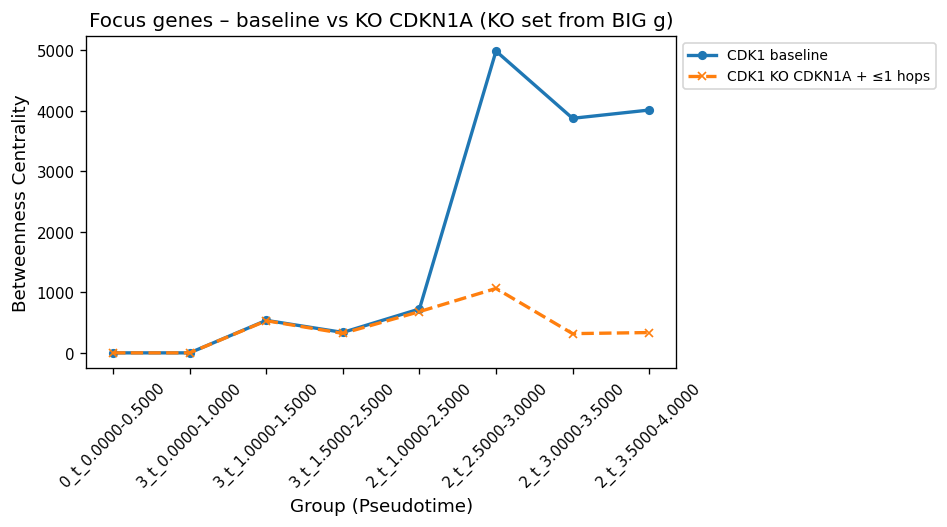


🛠 KO candidate P30291 (WEE1) on BIG g:
   • KO set size (UniProt): 1
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 0, '3_t_0.0000-1.0000': 0, '3_t_1.0000-1.5000': 1, '3_t_1.5000-2.5000': 1, '2_t_1.0000-2.5000': 1, '2_t_2.5000-3.0000': 1, '2_t_3.0000-3.5000': 1, '2_t_3.5000-4.0000': 1}
   • Examples: ['P30291(WEE1)']


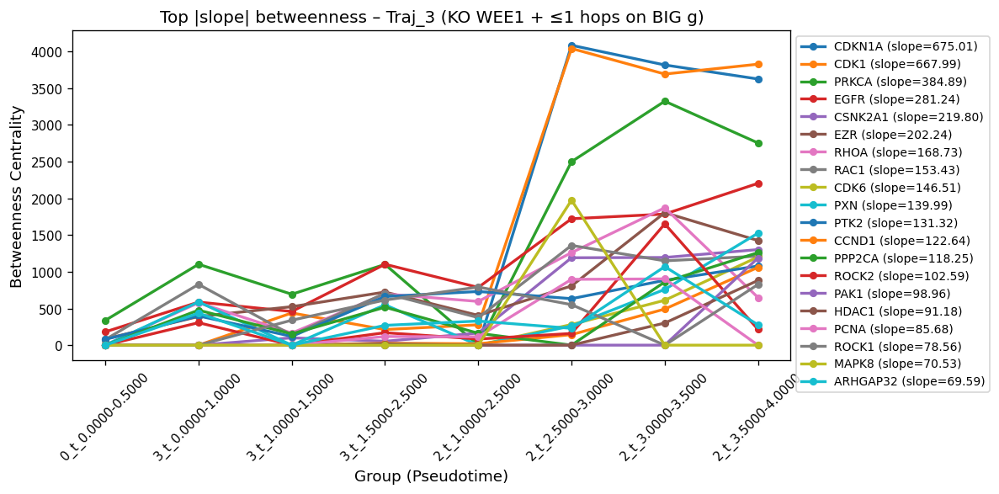

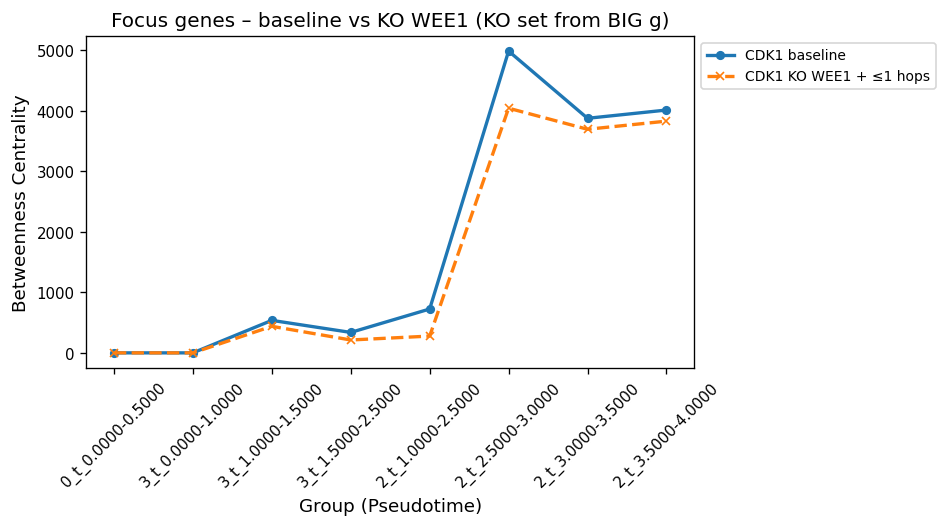


🛠 KO candidate P68400 (CSNK2A1) on BIG g:
   • KO set size (UniProt): 35
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 18, '3_t_0.0000-1.0000': 19, '3_t_1.0000-1.5000': 19, '3_t_1.5000-2.5000': 24, '2_t_1.0000-2.5000': 22, '2_t_2.5000-3.0000': 23, '2_t_3.0000-3.5000': 23, '2_t_3.5000-4.0000': 22}
   • Examples: ['P07910(HNRNPC)', 'P08238(HSP90AB1)', 'P17936(IGFBP3)', 'P35579(MYH9)', 'P55010(EIF5)', 'P60484(PTEN)', 'P68400(CSNK2A1)', 'Q01082(SPTBN1)', 'Q13547(HDAC1)', 'Q15185(PTGES3)']


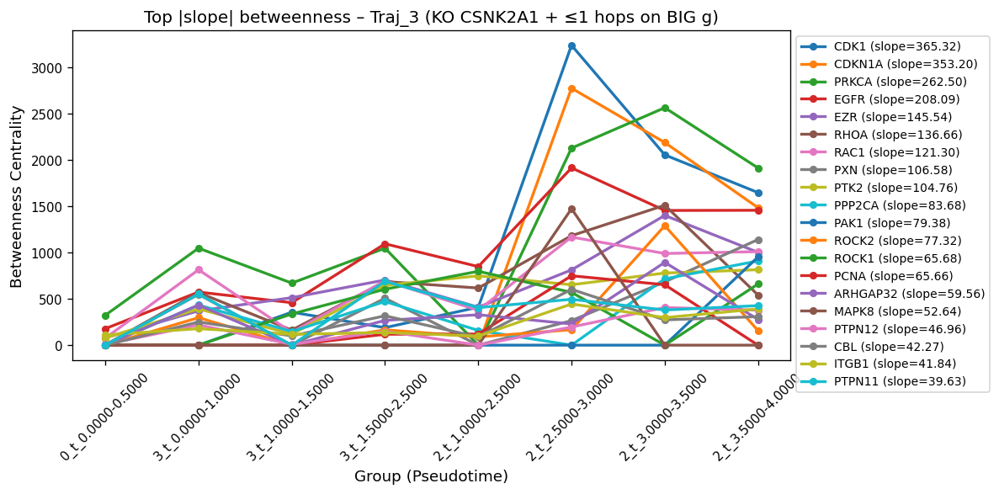

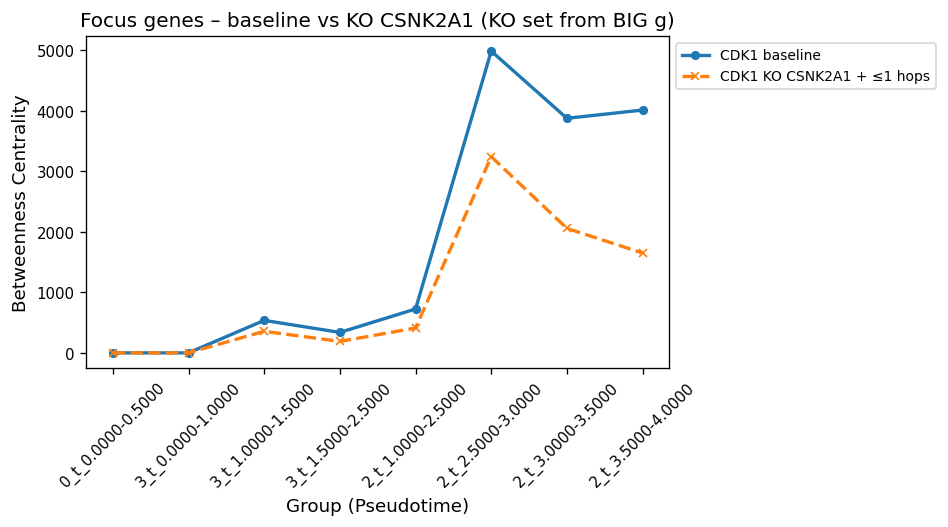


🛠 KO candidate P61024 (CKS1B) on BIG g:
   • KO set size (UniProt): 1
   • Present in subgraphs (per group): {'0_t_0.0000-0.5000': 0, '3_t_0.0000-1.0000': 0, '3_t_1.0000-1.5000': 1, '3_t_1.5000-2.5000': 1, '2_t_1.0000-2.5000': 1, '2_t_2.5000-3.0000': 1, '2_t_3.0000-3.5000': 1, '2_t_3.5000-4.0000': 1}
   • Examples: ['P61024(CKS1B)']


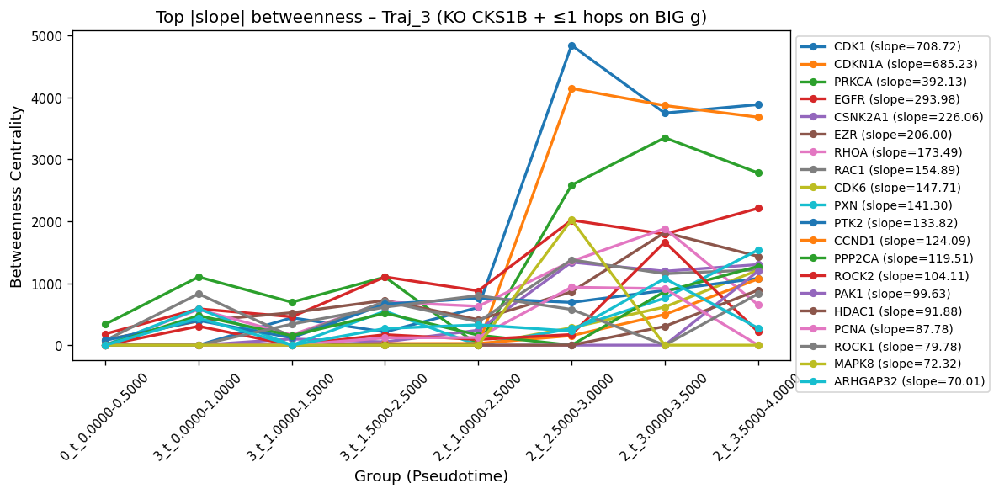

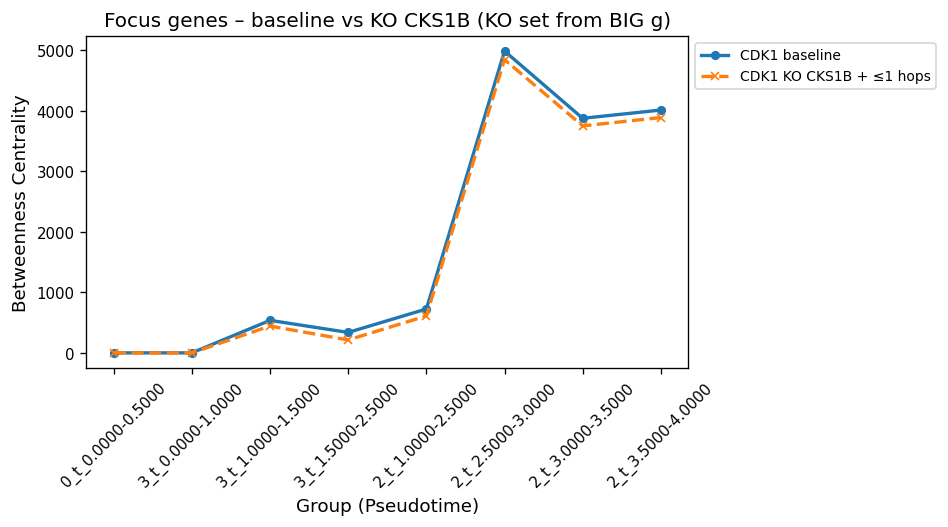

In [153]:
# ----------------- config -----------------
TRAJ_3 = [
    "0_t_0.0000-0.5000",
    "3_t_0.0000-1.0000",
    "3_t_1.0000-1.5000",
    "3_t_1.5000-2.5000",
    "2_t_1.0000-2.5000",
    "2_t_2.5000-3.0000",
    "2_t_3.0000-3.5000",
    "2_t_3.5000-4.0000",
]

EXCLUDE_IDS = {"P06493"}  # protect CDK1 etc.
candidates  = ["P10244","P20248","Q9NZJ0","Q01094","Q9HAW4","Q96B01","Q9BX63",
               "P84022","P11802","P38936","P30291","P68400","P61024"]  # UniProt only
focus_up    = ["P06493"]  # UniProt only (for overlay + protection)
k_down      = 1           # candidate + ≤2-hop OUT neighbors (computed on BIG g)

# ----------------- prepare -----------------
traj3_existing = [x for x in TRAJ_3 if x in group_graphs]
baseline_graphs = {k: group_graphs[k] for k in traj3_existing}

# map UniProt -> symbol once from BIG graph g (cleanest)
sym_map = {}
if g.vcount():
    for v in g.vs:
        if "gene_symbol" in v.attributes() and v["gene_symbol"]:
            sym_map[v["name"]] = v["gene_symbol"]
def sym(up): return sym_map.get(up, up)

# Baseline betweenness (no KO), just for reference and overlays
baseline_betw = betweenness_long_df(baseline_graphs, groups_order=traj3_existing)
plot_top_slope_trends(
    baseline_betw, traj3_existing, top_n=20,
    title="Top |slope| betweenness trends – Traj_3 (baseline)"
)

# ----------------- KO loop (KO set from BIG g) -----------------
g_names = set(g.vs["name"]) if g.vcount() else set()
protected = set(EXCLUDE_IDS) | set(focus_up)

for ko_up in candidates:
    if ko_up not in g_names:
        print(f"ℹ️ Candidate {ko_up} ({sym(ko_up)}) not found in BIG graph g; skipping.")
        continue

    # Build KO set on BIG g: candidate + descendants ≤ k_down
    ko_set_big = {ko_up} | ig_downstream_k(g, ko_up, k_down)
    # never remove protected
    ko_set_big -= protected

    if not ko_set_big:
        print(f"ℹ️ Candidate {ko_up} ({sym(ko_up)}): nothing to remove after protection; skipping.")
        continue

    # For info: how many of the KO set actually exist in each subgraph
    present_counts = {grp: len(set(ko_set_big) & set(baseline_graphs[grp].vs["name"]))
                      for grp in traj3_existing}
    print(f"\n🛠 KO candidate {ko_up} ({sym(ko_up)}) on BIG g:")
    print(f"   • KO set size (UniProt): {len(ko_set_big)}")
    print(f"   • Present in subgraphs (per group): {present_counts}")
    print(f"   • Examples: {sorted([f'{u}({sym(u)})' for u in list(ko_set_big)[:10]])}")

    # Apply this KO set to every subgraph (k_down=0 because set is precomputed on BIG g)
    ko_graphs = apply_ko_to_group_graphs(baseline_graphs, ko_set_big, exclude_ids=protected)
    betw_ko   = betweenness_long_df(ko_graphs, traj3_existing)

    # KO-only trend plot (top |slope|)
    plot_top_slope_trends(
        betw_ko, traj3_existing, top_n=20,
        title=f"Top |slope| betweenness – Traj_3 (KO {sym(ko_up)} + ≤{k_down} hops on BIG g)"
    )

    # Overlay baseline vs KO for protected/focus genes (shown by symbol)
    base_pv = baseline_betw.pivot_table(index="gene_symbol", columns="group",
                                        values="betweenness", fill_value=0.0)
    ko_pv   = betw_ko.pivot_table(index="gene_symbol", columns="group",
                                  values="betweenness", fill_value=0.0)

    focus_syms = [sym(up) for up in focus_up]
    plt.figure(figsize=(8, 4.5))
    for gsym in focus_syms:
        if gsym in base_pv.index:
            plt.plot(traj3_existing, base_pv.loc[gsym, traj3_existing].values,
                     marker='o', label=f"{gsym} baseline")
        if gsym in ko_pv.index:
            plt.plot(traj3_existing, ko_pv.loc[gsym, traj3_existing].values,
                     marker='x', linestyle="--",
                     label=f"{gsym} KO {sym(ko_up)} + ≤{k_down} hops")
    plt.title(f"Focus genes – baseline vs KO {sym(ko_up)} (KO set from BIG g)")
    plt.xlabel("Group (Pseudotime)")
    plt.ylabel("Betweenness Centrality")
    plt.xticks(rotation=45)
    plt.legend(fontsize="small", loc="upper left", bbox_to_anchor=(1,1))
    plt.tight_layout()
    plt.show()

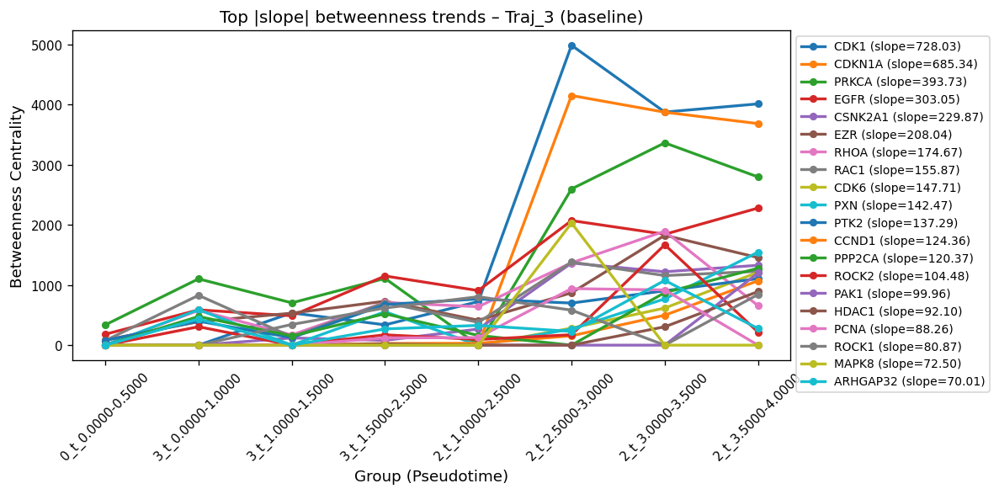

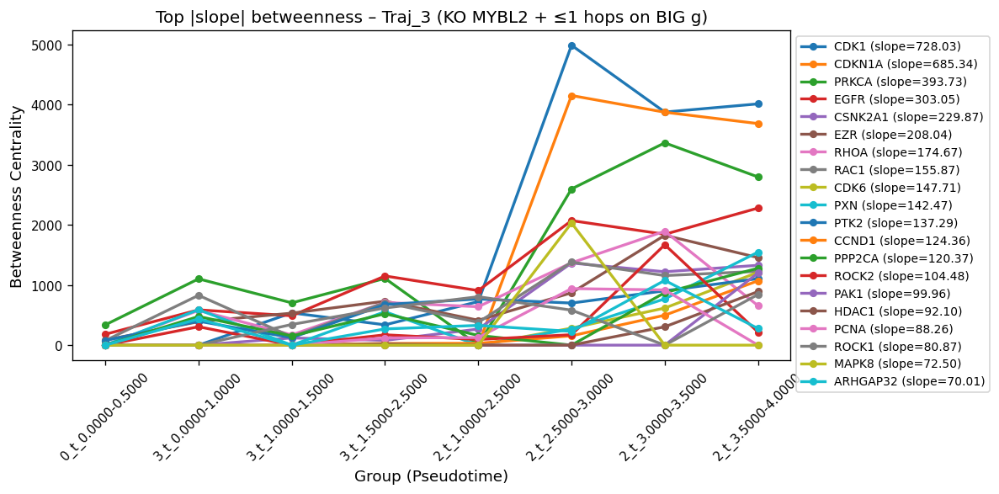

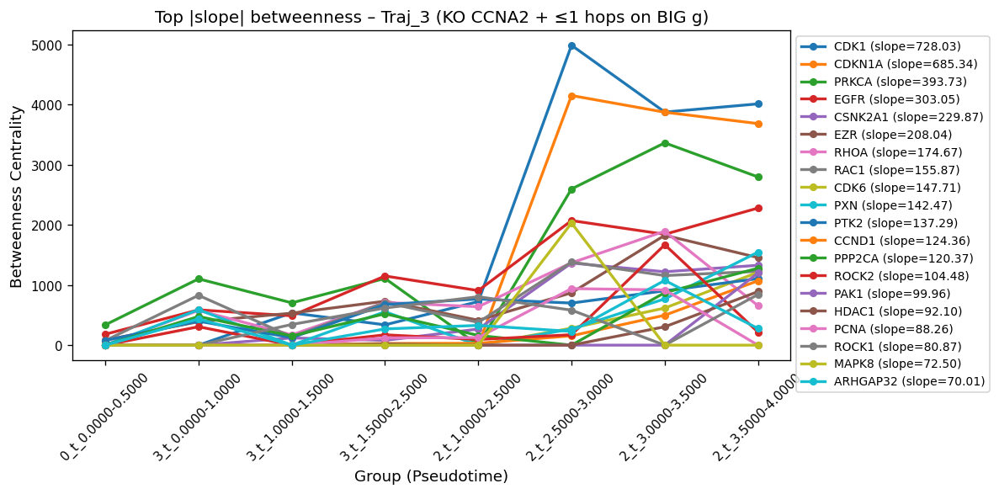

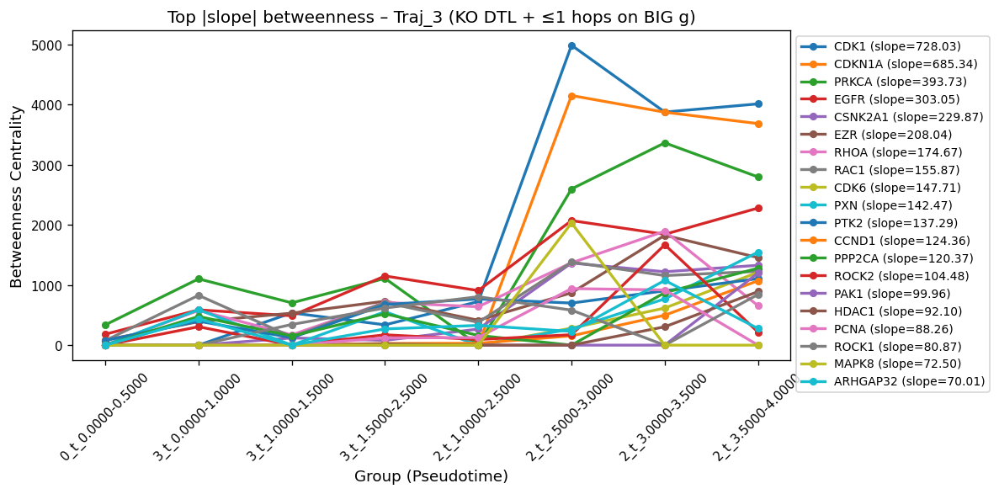

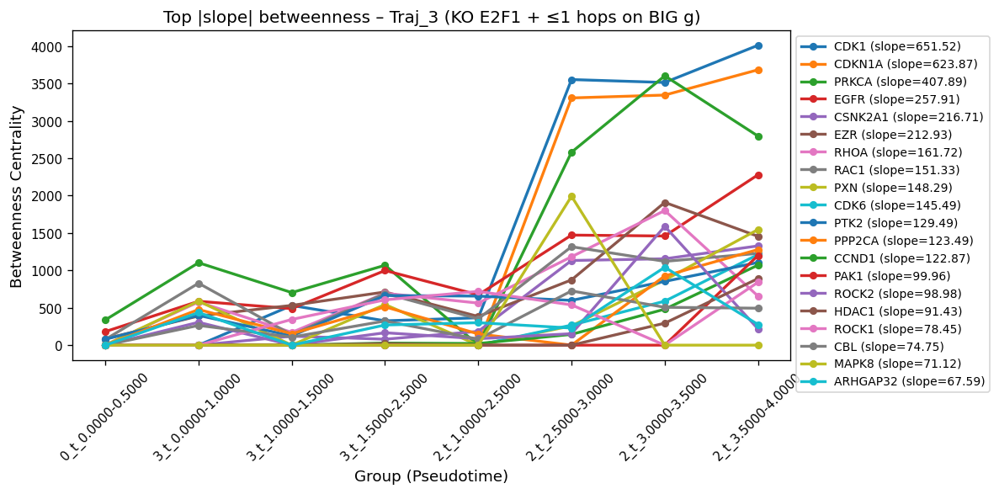

...

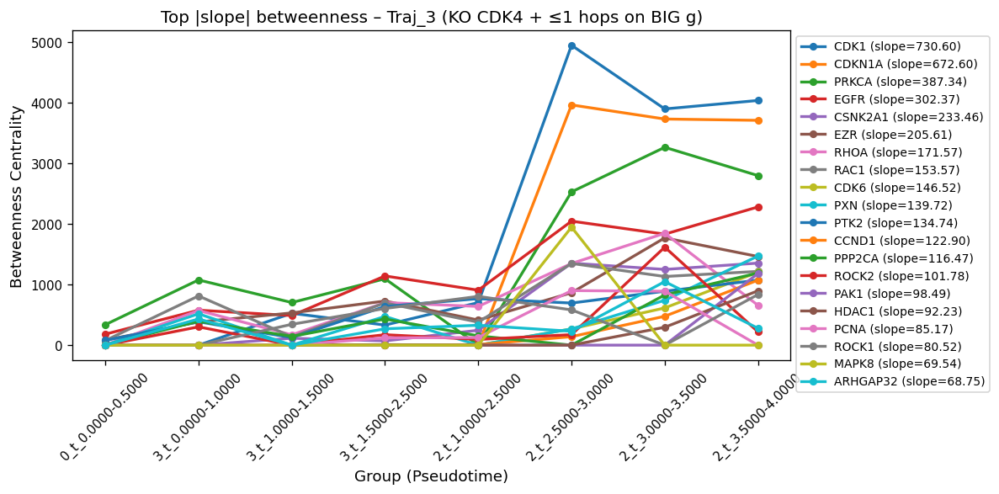

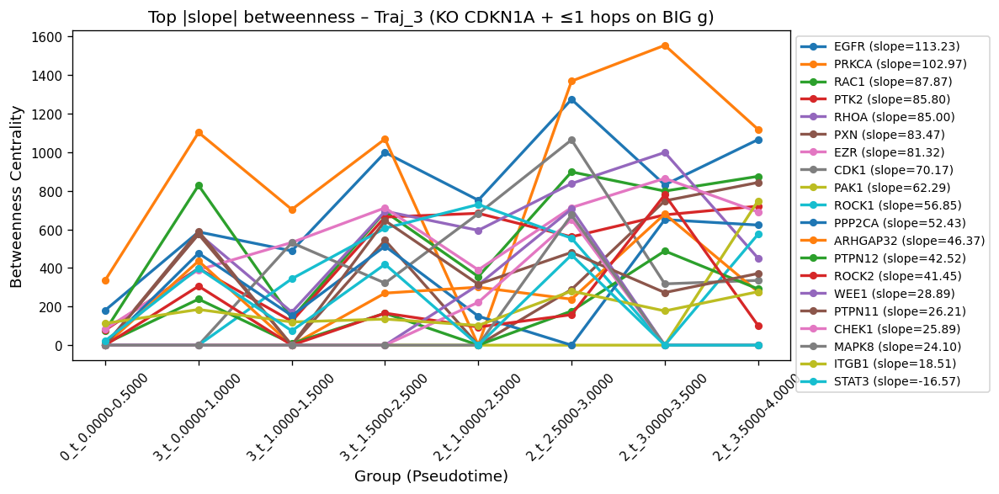

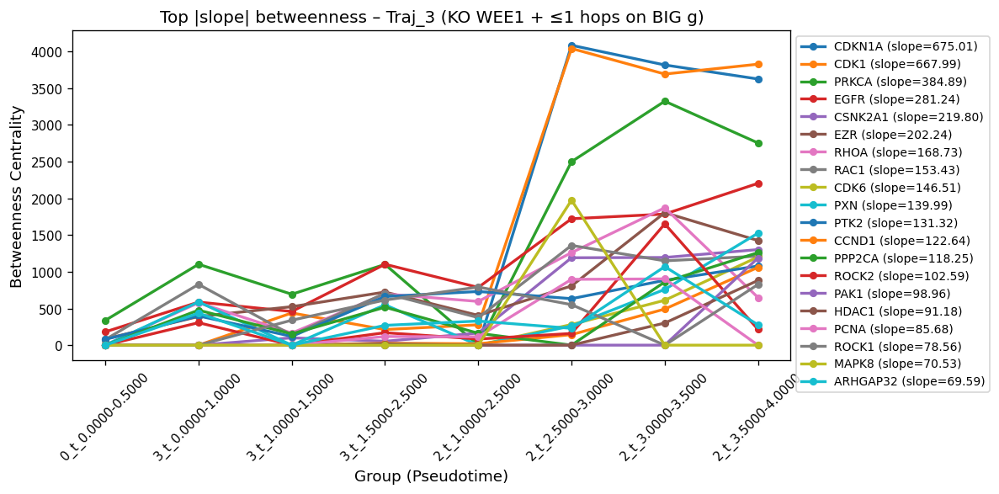

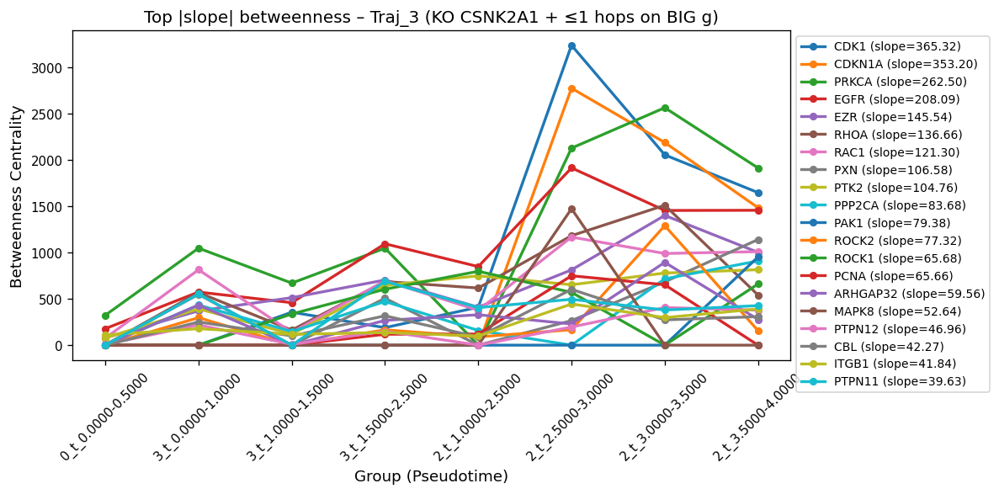

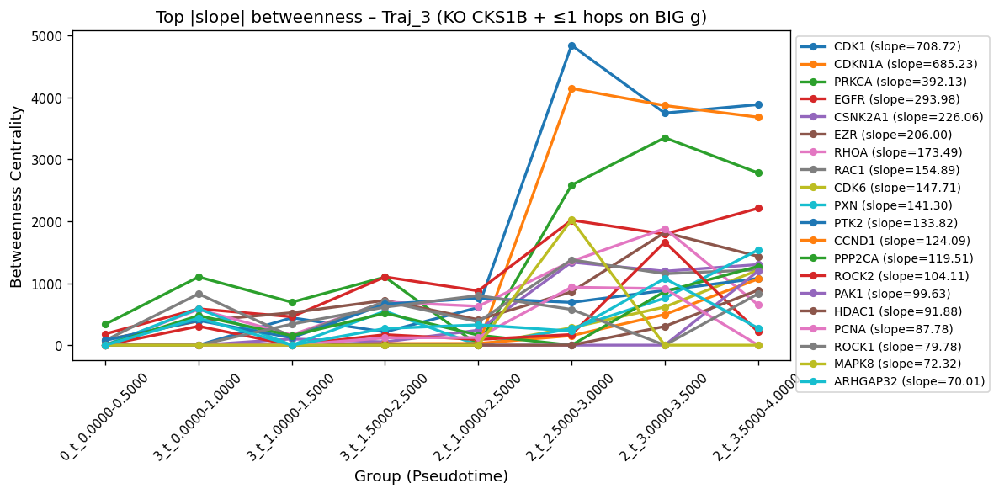

✅ Saved baseline + KO outputs under: /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/knockout


In [154]:
import os, json, re
from datetime import datetime
import pandas as pd
import matplotlib.pyplot as plt

# ----------------- paths -----------------
BASE_OUT = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/knockout"
os.makedirs(BASE_OUT, exist_ok=True)

def _slug(s: str) -> str:
    return re.sub(r"[^A-Za-z0-9._-]+", "_", s).strip("_")

def _save_fig(path_png: str, close=True, dpi=200, bbox_inches="tight"):
    os.makedirs(os.path.dirname(path_png), exist_ok=True)
    plt.gcf().savefig(path_png, dpi=dpi, bbox_inches=bbox_inches)
    if close:
        plt.close()

# ----------------- baseline -----------------
traj3_existing = [x for x in TRAJ_3 if x in group_graphs]
baseline_graphs = {k: group_graphs[k] for k in traj3_existing}

# Baseline betweenness – save table + plot
baseline_betw = betweenness_long_df(baseline_graphs, groups_order=traj3_existing)
baseline_dir  = os.path.join(BASE_OUT, "baseline")
os.makedirs(baseline_dir, exist_ok=True)

baseline_csv = os.path.join(baseline_dir, "betweenness_long.csv")
baseline_betw.to_csv(baseline_csv, index=False)

plot_top_slope_trends(
    baseline_betw, traj3_existing, top_n=20,
    title="Top |slope| betweenness trends – Traj_3 (baseline)"
)
_save_fig(os.path.join(baseline_dir, "top_slope_trends.png"))

# ----------------- helpers -----------------
g_names = set(g.vs["name"]) if g.vcount() else set()
protected = set(EXCLUDE_IDS) | set(focus_up)

# (optional) capture a metadata snapshot
meta_path = os.path.join(BASE_OUT, "metadata.json")
with open(meta_path, "w") as f:
    json.dump({
        "created_at": datetime.now().isoformat(timespec="seconds"),
        "traj3_existing": traj3_existing,
        "protected_uniprot": sorted(protected),
        "candidates_uniprot": candidates,
        "k_down": k_down,
        "n_vertices": int(g.vcount()),
        "n_edges": int(g.ecount()),
    }, f, indent=2)

# ----------------- KO loop with saving -----------------
for ko_up in candidates:
    if ko_up not in g_names:
        print(f"ℹ️ Candidate {ko_up} ({sym(ko_up)}) not in BIG graph; skipping.")
        continue

    # Build KO set on BIG g: candidate + ≤k_down descendants (OUT)
    ko_set_big = {ko_up} | ig_downstream_k(g, ko_up, k_down)
    ko_set_big -= protected  # never remove protected

    if not ko_set_big:
        print(f"ℹ️ Candidate {ko_up} ({sym(ko_up)}): nothing to remove after protection; skipping.")
        continue

    # Subdir for this KO
    ko_dir = os.path.join(BASE_OUT, f"KO_{_slug(ko_up)}")
    os.makedirs(ko_dir, exist_ok=True)

    # Save KO set (UniProt) and present counts per subgraph
    with open(os.path.join(ko_dir, "ko_set_uniprot.txt"), "w") as f:
        for u in sorted(ko_set_big):
            f.write(f"{u}\t{sym(u)}\n")

    present_counts = {grp: len(set(ko_set_big) & set(baseline_graphs[grp].vs["name"]))
                      for grp in traj3_existing}
    pd.Series(present_counts, name="present_count").to_csv(
        os.path.join(ko_dir, "present_in_subgraphs.tsv"), sep="\t", header=True
    )

    # Apply KO and compute betweenness
    ko_graphs = apply_ko_to_group_graphs(baseline_graphs, ko_set_big, exclude_ids=protected)
    betw_ko   = betweenness_long_df(ko_graphs, traj3_existing)

    # Save KO betweenness table
    ko_csv = os.path.join(ko_dir, "betweenness_long.csv")
    betw_ko.to_csv(ko_csv, index=False)

    # Plot: KO-only top |slope| trends — save
    plot_top_slope_trends(
        betw_ko, traj3_existing, top_n=20,
        title=f"Top |slope| betweenness – Traj_3 (KO {sym(ko_up)} + ≤{k_down} hops on BIG g)"
    )
    _save_fig(os.path.join(ko_dir, "top_slope_trends.png"))

    # Overlay baseline vs KO for focus genes — save
    base_pv = baseline_betw.pivot_table(index="gene_symbol", columns="group",
                                        values="betweenness", fill_value=0.0)
    ko_pv   = betw_ko.pivot_table(index="gene_symbol", columns="group",
                                  values="betweenness", fill_value=0.0)

    focus_syms = [sym(up) for up in focus_up]
    plt.figure(figsize=(8, 4.5))
    for gsym in focus_syms:
        if gsym in base_pv.index:
            plt.plot(traj3_existing, base_pv.loc[gsym, traj3_existing].values,
                     marker='o', label=f"{gsym} baseline")
        if gsym in ko_pv.index:
            plt.plot(traj3_existing, ko_pv.loc[gsym, traj3_existing].values,
                     marker='x', linestyle="--",
                     label=f"{gsym} KO {sym(ko_up)} + ≤{k_down} hops")
    plt.title(f"Focus genes – baseline vs KO {sym(ko_up)} (KO set from BIG g)")
    plt.xlabel("Group (Pseudotime)")
    plt.ylabel("Betweenness Centrality")
    plt.xticks(rotation=45)
    plt.legend(fontsize="small", loc="upper left", bbox_to_anchor=(1,1))
    plt.tight_layout()
    _save_fig(os.path.join(ko_dir, "focus_overlay.png"))

print(f"✅ Saved baseline + KO outputs under: {BASE_OUT}")


### 11.6.3 Two ways to probe what drives CDK1 betweenness along pseudotime: a full pipeline vs a KO-focused sweep (Shared shortest pathways gene of CDK1 and random KO/perturbation, for both analysis of their inlfuence on CDK1 centrality)

In [159]:
candidates = ["P10244","P20248","Q9NZJ0","Q01094","Q9HAW4","Q96B01","Q9BX63","P84022","P11802","P38936","P30291","P68400","P61024"]

In [297]:
# CDK1 sensitivity workflow — randomized KOs + shortest‑path dependency (igraph)
# ---------------------------------------------------------------------------
# Drop this into your current notebook *after* you have:
#   - group_graphs: dict[str, ig.Graph] (directed, vertices have attributes: name=UniProt, gene_symbol)
#   - TRAJ_3: list[str] with your group ordering of interest
#   - ko_graphs_by_group_multi(...), betweenness_long_df(...), EXCLUDE_IDS
#
# This module adds:
#   1) Baseline CDK1 betweenness by group
#   2) Shortest‑path overlap dependency w.r.t. CDK1 (approximate, via sampling)
#   3) Randomized KO sweeps (single & multi‑gene), with per‑gene influence scores
#   4) Optional full single‑KO sweep for exact single‑gene effects
# ---------------------------------------------------------------------------

from __future__ import annotations
import igraph as ig
import numpy as np
import pandas as pd
import random
from collections import defaultdict, Counter
from typing import Dict, Iterable, List, Tuple, Set

# ---------- config ----------
CDK1_UNIPROT = "P06493"  # CDK1 UniProt (already in your EXCLUDE_IDS)

# ---------- utilities ----------

def _ensure_symbol_from_vs(v):
    sym = v["gene_symbol"] if "gene_symbol" in v.attributes() else None
    return sym if (sym and len(sym)) else v["name"]


def union_vertex_names(graphs: Dict[str, ig.Graph]) -> Set[str]:
    names = set()
    for g in graphs.values():
        if g.vcount():
            names.update(g.vs["name"])  # UniProt IDs
    return names


def compute_baseline_cdk1_betweenness_by_group(graphs_by_group: Dict[str, ig.Graph],
                                                groups_order: List[str]) -> pd.Series:
    """Return a Series indexed by group with CDK1 betweenness (0 if CDK1 absent)."""
    rows = []
    for grp in groups_order:
        if grp not in graphs_by_group:
            rows.append((grp, 0.0))
            continue
        g = graphs_by_group[grp]
        if CDK1_UNIPROT not in g.vs["name"]:
            rows.append((grp, 0.0))
            continue
        btwn = g.betweenness(directed=True)
        name_to_btwn = {v["name"]: s for v, s in zip(g.vs, btwn)}
        rows.append((grp, float(name_to_btwn.get(CDK1_UNIPROT, 0.0))))
    return pd.Series({k: v for k, v in rows})


# ---------- shortest‑path dependency (approximate) ----------

def cdk1_shortest_path_overlap(
    g: ig.Graph,
    cdk1_uid: str = CDK1_UNIPROT,
    sample_pairs: int = 5000,
    rng: random.Random | None = None,
) -> pd.DataFrame:
    """
    Approximate the dependency of other nodes on CDK1 by sampling source/target pairs
    and counting co‑occurrence on shortest paths that include CDK1.

    Returns a DataFrame with columns:
      - uniprot, gene_symbol, overlap_count, overlap_frac
    where overlap_frac = overlap_count / total_paths_through_CDK1 (in the sample).

    If there are no sampled shortest paths through CDK1, returns empty DataFrame.
    """
    if cdk1_uid not in g.vs["name"] or g.vcount() == 0:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_count","overlap_frac"]).astype({"overlap_count":int,"overlap_frac":float})

    rng = rng or random.Random(0)
    vids = list(range(g.vcount()))
    cdk1_vid = g.vs.find(name=cdk1_uid).index

    # sample ordered pairs (s != t)
    pairs = set()
    while len(pairs) < min(sample_pairs, g.vcount() * (g.vcount() - 1)):
        s = rng.choice(vids)
        t = rng.choice(vids)
        if s != t:
            pairs.add((s, t))

    overlap = Counter()
    total_cdk1_paths = 0

    for s, t in pairs:
        # all shortest paths from s to t in the directed sense
        paths = g.get_all_shortest_paths(s, to=t, mode="OUT")
        if not paths:
            continue
        # If *any* shortest path includes CDK1, we count all such paths that include CDK1
        for path in paths:
            if cdk1_vid in path:
                total_cdk1_paths += 1
                for v in path:
                    if v != cdk1_vid:
                        overlap[v] += 1

    if total_cdk1_paths == 0:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_count","overlap_frac"]).astype({"overlap_count":int,"overlap_frac":float})

    data = []
    for v_idx, cnt in overlap.items():
        data.append({
            "uniprot": g.vs[v_idx]["name"],
            "gene_symbol": _ensure_symbol_from_vs(g.vs[v_idx]),
            "overlap_count": int(cnt),
            "overlap_frac": cnt / total_cdk1_paths,
        })
    df = pd.DataFrame(data).sort_values(["overlap_frac","overlap_count"], ascending=False).reset_index(drop=True)
    return df


# ---------- randomized KO sweeps ----------

def _extract_cdk1_from_betw_df(betw_df: pd.DataFrame, groups_order: List[str]) -> pd.Series:
    pv = betw_df.pivot_table(index="uniprot", columns="group", values="betweenness", fill_value=0.0)
    if CDK1_UNIPROT not in pv.index:
        return pd.Series({grp: 0.0 for grp in groups_order})
    s = pv.loc[CDK1_UNIPROT, groups_order]
    # ensure all groups present
    return pd.Series({grp: float(s.get(grp, 0.0)) for grp in groups_order})


def randomized_ko_sweeps(
    baseline_graphs: Dict[str, ig.Graph],
    groups_order: List[str],
    m_list: Iterable[int] = (1, 3, 5, 10),
    n_trials: int = 500,
    k_down: int = 0,
    exclude_ids: Set[str] | None = None,
    rng: random.Random | None = None,
) -> Tuple[pd.DataFrame, pd.DataFrame]:
    """
    Perform randomized KO sweeps for sizes in m_list, each with n_trials.

    For each trial:
      - Randomly sample m vertex names from the union of all nodes across baseline_graphs
      - Remove those nodes (and optionally their <=k_down descendants) in every group graph
      - Compute ΔCDK1 betweenness (mean over groups) relative to baseline
      - Attribute the Δ equally to all genes in the KO set and accumulate

    Returns:
      per_gene_df with columns [gene, trials, mean_delta, hit_rate_top1pct]
      per_trial_df with columns [m, trial, delta_mean, delta_abs, ko_genes]
    """
    rng = rng or random.Random(0)
    exclude_ids = set(exclude_ids or [])

    # Baseline CDK1 betweenness by group
    base_betw = betweenness_long_df(baseline_graphs, groups_order)
    base_cdk1 = _extract_cdk1_from_betw_df(base_betw, groups_order)
    base_mean = float(base_cdk1.mean())

    universe = sorted(union_vertex_names(baseline_graphs) - exclude_ids)
    if not universe:
        raise ValueError("Universe of KO candidates is empty.")

    # Accumulators
    contrib_sum = defaultdict(float)  # sum of attributed delta per gene
    contrib_count = defaultdict(int)  # number of trials gene participated in
    hit_counter = defaultdict(int)    # number of times gene appears in top‑1% trials by |delta|

    trials_records = []

    total_trials = 0
    for m in m_list:
        for trial in range(n_trials):
            if m > len(universe):
                continue
            ko_set = set(rng.sample(universe, m))
            # build KO graphs
            ko_graphs = ko_graphs_by_group_multi(
                baseline_graphs, seeds=list(ko_set), k_down=k_down, exclude_ids=exclude_ids
            )
            betw_ko = betweenness_long_df(ko_graphs, groups_order)
            cdk1_ko = _extract_cdk1_from_betw_df(betw_ko, groups_order)
            delta = float(cdk1_ko.mean() - base_mean)

            trials_records.append({
                "m": m,
                "trial": total_trials,
                "delta_mean": delta,
                "delta_abs": abs(delta),
                "ko_genes": tuple(sorted(ko_set)),
            })

            # attribute equally to members of the KO set
            share = (delta / m) if m > 0 else 0.0
            for gname in ko_set:
                contrib_sum[gname] += share
                contrib_count[gname] += 1

            total_trials += 1

    per_trial_df = pd.DataFrame(trials_records)

    # determine top‑1% absolute‑effect trials
    if not per_trial_df.empty:
        cutoff = per_trial_df["delta_abs"].quantile(0.99)
        top_trials = per_trial_df[per_trial_df["delta_abs"] >= cutoff]
        for _, row in top_trials.iterrows():
            for gname in row["ko_genes"]:
                hit_counter[gname] += 1

    # assemble per‑gene table
    genes = sorted(set(contrib_count.keys()))
    per_gene_df = pd.DataFrame({
        "gene": genes,
        "trials": [contrib_count[g] for g in genes],
        "mean_delta": [contrib_sum[g] / contrib_count[g] if contrib_count[g] else 0.0 for g in genes],
        "hit_rate_top1pct": [hit_counter[g] / max(1, contrib_count[g]) for g in genes],
    }).sort_values(["hit_rate_top1pct","mean_delta"], ascending=[False, False]).reset_index(drop=True)

    return per_gene_df, per_trial_df


# ---------- single‑KO sweep (exact) ----------

def single_ko_sweep(
    baseline_graphs: Dict[str, ig.Graph],
    groups_order: List[str],
    k_down: int = 0,
    exclude_ids: Set[str] | None = None,
) -> pd.DataFrame:
    """Exact single‑KO impact on mean CDK1 betweenness across groups."""
    exclude_ids = set(exclude_ids or [])
    base_betw = betweenness_long_df(baseline_graphs, groups_order)
    base_cdk1 = _extract_cdk1_from_betw_df(base_betw, groups_order)
    base_mean = float(base_cdk1.mean())

    universe = sorted(union_vertex_names(baseline_graphs) - exclude_ids)
    rows = []
    for ko in universe:
        ko_graphs = ko_graphs_by_group_multi(baseline_graphs, seeds=[ko], k_down=k_down, exclude_ids=exclude_ids)
        betw_ko = betweenness_long_df(ko_graphs, groups_order)
        cdk1_ko = _extract_cdk1_from_betw_df(betw_ko, groups_order)
        delta = float(cdk1_ko.mean() - base_mean)
        rows.append({"gene": ko, "delta_mean": delta})
    df = pd.DataFrame(rows).sort_values("delta_mean", ascending=False).reset_index(drop=True)
    return df


# ---------- convenience: run end‑to‑end on your Traj_3 ----------

def run_cdk1_sensitivity_pipeline(
    group_graphs: Dict[str, ig.Graph],
    traj_groups: List[str],
    *,
    sample_pairs: int = 5000,
    m_list: Iterable[int] = (1, 3, 5, 10),
    n_trials: int = 500,
    k_down_random: int = 0,
    k_down_single: int = 0,
    exclude_ids: Set[str] | None = None,
    rng_seed: int = 0,
) -> Dict[str, pd.DataFrame]:
    """
    1) Baseline CDK1 betweenness (per group)
    2) Shortest‑path overlap per group (approximate)
    3) Randomized KO sweeps (multi‑m)
    4) Exact single‑KO sweep
    """
    rng = random.Random(rng_seed)

    # Restrict to existing groups
    groups = [g for g in traj_groups if g in group_graphs]
    baseline_graphs = {k: group_graphs[k] for k in groups}

    # Baseline per‑group betweenness for CDK1
    baseline_cdk1_by_group = compute_baseline_cdk1_betweenness_by_group(baseline_graphs, groups)

    # Shortest‑path overlap (one group at a time)
    # We compute for each group separately; you can inspect late‑pseudotime groups in particular.
    overlap_tables = {}
    for grp, g in baseline_graphs.items():
        overlap_tables[grp] = cdk1_shortest_path_overlap(g, CDK1_UNIPROT, sample_pairs=sample_pairs, rng=rng)

    # Randomized sweeps
    per_gene_rand, per_trial_rand = randomized_ko_sweeps(
        baseline_graphs, groups, m_list=m_list, n_trials=n_trials,
        k_down=k_down_random, exclude_ids=exclude_ids, rng=rng
    )

    # Exact single‑KO
    single_ko = single_ko_sweep(
        baseline_graphs, groups, k_down=k_down_single, exclude_ids=exclude_ids
    )

    return {
        "baseline_cdk1_by_group": baseline_cdk1_by_group.to_frame(name="cdk1_betweenness"),
        "overlap_tables": overlap_tables,   # dict[group] -> DataFrame
        "random_per_gene": per_gene_rand,
        "random_per_trial": per_trial_rand,
        "single_ko": single_ko,
    }


# ---------- example usage (uncomment to run) ----------
# traj3_existing = [g for g in TRAJ_3 if g in group_graphs]
# results = run_cdk1_sensitivity_pipeline(
#     group_graphs,
#     traj3_existing,
#     sample_pairs=3000,          # increase for more accuracy, at higher cost
#     m_list=(1,3,5,10),
#     n_trials=400,               # increase for tighter estimates
#     k_down_random=0,            # set >0 to also KO downstreams in random sweeps
#     k_down_single=0,
#     exclude_ids=EXCLUDE_IDS,
#     rng_seed=1,
# )
#
# # Inspect results
# results["baseline_cdk1_by_group"]      # Series -> DataFrame
# results["overlap_tables"][traj3_existing[-1]].head(20)  # top influencers in latest group
# results["random_per_gene"].head(20)     # genes frequently in high‑impact KO sets
# results["single_ko"].head(20)           # exact single‑KO ranking


#### KO-only sweep (independent perturbation experiment)

In [298]:
TRAJ_3

['0_t_0.0000-0.5000',
 '3_t_1.0000-1.5000',
 '3_t_0.0000-1.0000',
 '3_t_1.5000-2.5000',
 '2_t_3.5000-4.0000',
 '1_t_0.5000-1.5000',
 '2_t_1.0000-2.5000',
 '1_t_3.0000-3.5000',
 '1_t_1.5000-2.5000',
 '1_t_2.5000-3.0000',
 '2_t_2.5000-3.0000',
 '2_t_3.0000-3.5000']

In [299]:
EXCLUDE_IDS = {"P06493"}

traj3_existing = [g for g in TRAJ_3 if g in group_graphs]

results = run_cdk1_sensitivity_pipeline(
    group_graphs,
    traj3_existing,
    sample_pairs=3000,      # ↑ for more accurate path overlap
    m_list=(1,2),
    n_trials=400,           # ↑ for tighter randomized estimates
    k_down_random=0,        # set >0 to KO descendants too
    k_down_single=0,
    exclude_ids=EXCLUDE_IDS,
    rng_seed=1,
)

# Inspect:
results["baseline_cdk1_by_group"]
results["overlap_tables"][traj3_existing[-1]].head(20)  # top co-occurring nodes w/ CDK1 paths
results["random_per_gene"].head(20)                     # frequent high-impact KO contributors
results["single_ko"].head(20)                           # exact single-KO effects

NameError: name 'ko_graphs_by_group_multi' is not defined

#### Generate random knockout of the graph and determine their influence on the betweeness centrality of CDK1

In [163]:
# 1) Choose the groups you actually have
traj3_existing = [g for g in TRAJ_3 if g in group_graphs]
baseline_graphs = {k: group_graphs[k] for k in traj3_existing}

# 2) Run randomized sweeps
per_gene_rand, per_trial_rand = randomized_ko_sweeps(
    baseline_graphs,
    traj3_existing,
    m_list=(1, 3, 6, 9, 12, 24),   # sizes of KO sets per trial
    n_trials=800,           # trials per m; increase for tighter estimates
    k_down=3,               # set >0 to also KO ≤k_down downstream nodes
    exclude_ids=EXCLUDE_IDS,# keep CDK1 etc. safe from removal
)

# 3) Inspect the per-gene influence table
#    - mean_delta: avg change in mean CDK1 betweenness attributed to this gene across trials it appeared in
#    - hit_rate_top1pct: fraction of times the gene appears in the top 1% highest-|delta| trials
print(per_gene_rand.head(20))

# (Optional) add gene symbols for readability
per_gene_rand_sym = per_gene_rand.copy()
per_gene_rand_sym["gene_symbol"] = per_gene_rand_sym["gene"].map(lambda u: sym_map.get(u, u))
per_gene_rand_sym = per_gene_rand_sym[["gene","gene_symbol","trials","mean_delta","hit_rate_top1pct"]]
print(per_gene_rand_sym.head(20))

# 4) Inspect high-impact trials (the extreme perturbations)
top_trials = per_trial_rand.sort_values("delta_abs", ascending=False).head(10)
for _, row in top_trials.iterrows():
    print(f"m={row.m}, trial={row.trial}, Δmean={row.delta_mean:+.3f}, |Δ|={row.delta_abs:.3f}")
    print("KO genes:", [f"{g}({sym_map.get(g,g)})" for g in row.ko_genes])
    print("---")

# 5) (Optional) Focused list of suspects:
#    Genes that frequently occur in extreme trials AND tend to increase CDK1 betweenness when removed
suspects = (
    per_gene_rand_sym
    .query("hit_rate_top1pct > 0")
    .sort_values(["hit_rate_top1pct","mean_delta"], ascending=[False, False])
    .head(25)
)
print(suspects)


NameError: name 'ko_graphs_by_group_multi' is not defined

### 11.6.4 CDK1 BRIDGE ANALYSIS — shortest-path overlap + randomized KOs + bridge map

In [164]:
# =========================
# Optimized CDK1 overlap + Random KOs
# =========================
import igraph as ig
import numpy as np
import pandas as pd
import random
from collections import defaultdict
from typing import Dict, List, Iterable, Tuple, Set

CDK1_UP = "P06493"                 # protect CDK1
EXCLUDE_IDS = {CDK1_UP}
K_DOWN_BIG = 2                     # expand KOs on BIG graph g
RNG = random.Random(1)

# ---------- helpers ----------
def ensure_sym_map_from_graphs(graphs: Dict[str, ig.Graph]) -> dict:
    m = {}
    for G in graphs.values():
        if G.vcount():
            for v in G.vs:
                sym = v["gene_symbol"] if "gene_symbol" in v.attributes() else ""
                if sym:
                    m[v["name"]] = sym
    return m

def cdk1_betweenness_only(G: ig.Graph, cdk1=CDK1_UP) -> float:
    """Return betweenness for CDK1 only (0 if absent)."""
    if G.vcount() == 0 or cdk1 not in G.vs["name"]:
        return 0.0
    vid = G.vs.find(name=cdk1).index
    return float(G.betweenness(vertices=[vid], directed=True)[0])

def mean_cdk1_betweenness(graphs: Dict[str, ig.Graph]) -> float:
    vals = [cdk1_betweenness_only(G) for G in graphs.values()]
    return float(np.mean(vals)) if len(vals) else 0.0

# ---------- 1) EXACT shortest-path overlap with CDK1 (pair-level) ----------
def cdk1_shortest_path_overlap_exact(G: ig.Graph, cdk1=CDK1_UP, max_n_exact=2000, sample_pairs=4000, rng=RNG):
    """
    Exact pair-level overlap:
      Count (s,t) pairs whose global shortest distance equals dist(s->CDK1)+dist(CDK1->t).
      For each vertex v!=CDK1, count how many such pairs have a shortest path via CDK1 that also includes v.
    If graph is very large (n>max_n_exact), fallback to the prior sampler.

    Returns DataFrame: [uniprot, gene_symbol, overlap_pairs, overlap_frac_pairs]
    """
    n = G.vcount()
    if n == 0 or cdk1 not in G.vs["name"]:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_pairs","overlap_frac_pairs"])

    # fallback to sampler for very large graphs
    if n > max_n_exact:
        # --- sampler from your earlier function ---
        df = cdk1_shortest_path_overlap(G, cdk1_uid=cdk1, sample_pairs=sample_pairs, rng=rng).copy()
        return df.rename(columns={"overlap_count":"overlap_pairs", "overlap_frac":"overlap_frac_pairs"})

    c = G.vs.find(name=cdk1).index
    # full distance matrix (unweighted directed)
    D = np.array(G.shortest_paths(mode="OUT"), dtype=float)            # shape (n,n)
    inf = np.inf
    # distances to/from CDK1
    ds_c = D[:, c]             # s -> CDK1
    c_t  = D[c, :]             # CDK1 -> t
    # mask for pairs whose shortest path goes via CDK1
    via_c_len = ds_c[:, None] + c_t[None, :]
    sp_via_c  = np.isfinite(via_c_len) & (via_c_len == D)
    # ignore s==t
    idx = np.arange(n)
    sp_via_c[idx, idx] = False
    total_pairs = int(sp_via_c.sum())
    if total_pairs == 0:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_pairs","overlap_frac_pairs"])

    # pre-extract rows/cols we need from D
    # column v is dist(s -> v);  row v is dist(v -> t)
    names = G.vs["name"]
    syms  = G.vs["gene_symbol"] if "gene_symbol" in G.vs.attributes() else [""]*n
    out_rows = []
    for v in range(n):
        if v == c:     # skip CDK1 itself
            continue
        # v before CDK1: dist s->v + v->CDK1 + CDK1->t == dist s->t  AND path via CDK1 is shortest
        before = (D[:, v][:, None] + D[v, c] + c_t[None, :]) == D
        # v after CDK1:  dist s->CDK1 + CDK1->v + v->t == dist s->t
        after  = (ds_c[:, None] + D[c, v] + D[v, :][None, :]) == D
        mask_v = (before | after) & sp_via_c
        cnt = int(mask_v.sum())
        if cnt > 0:
            out_rows.append({
                "uniprot": names[v],
                "gene_symbol": (syms[v] if syms[v] else names[v]),
                "overlap_pairs": cnt,
                "overlap_frac_pairs": cnt / total_pairs,
            })

    out = pd.DataFrame(out_rows).sort_values(
        ["overlap_frac_pairs","overlap_pairs"], ascending=False
    ).reset_index(drop=True)
    return out

# ---------- 2) Precompute KO expansion on BIG g (≤2 hops OUT) ----------
def build_twohop_out_map(g_big: ig.Graph) -> Dict[str, Set[str]]:
    """For each UniProt (name), return {u} ∪ 1-hop OUT ∪ 2-hop OUT on BIG graph."""
    names = g_big.vs["name"]
    idx_by_name = {n:i for i,n in enumerate(names)}
    neigh_out = {i: set(g_big.neighbors(i, mode="OUT")) for i in range(g_big.vcount())}
    out_map = {}
    for i, u in enumerate(names):
        hop1 = neigh_out[i]
        hop2 = set()
        for j in hop1:
            hop2 |= neigh_out[j]
        # map indices to names; include the seed itself
        ko_idx = {i} | hop1 | hop2
        out_map[u] = {names[k] for k in ko_idx}
    return out_map

# ---------- 3) Fast randomized KO sweeps (expand on BIG g, compute CDK1 only) ----------
def randomized_ko_sweeps_bigdesc_fast(
    g_big: ig.Graph,
    baseline_graphs: Dict[str, ig.Graph],
    groups_order: List[str],
    m_list: Iterable[int] = (1,2,3),
    n_trials: int = 400,
    k_down_big: int = 2,      # only 0 or 2 supported by this fast map; (1 works as subset)
    exclude_ids: Set[str] = EXCLUDE_IDS,
    rng: random.Random = RNG,
    cdk1_id: str = CDK1_UP,
) -> Tuple[pd.DataFrame, pd.DataFrame]:
    # Precompute KO expansion map on BIG g
    if k_down_big not in (0, 1, 2):
        raise ValueError("This fast version supports k_down_big ∈ {0,1,2}.")
    twomap = build_twohop_out_map(g_big) if k_down_big >= 1 else {u:{u} for u in g_big.vs["name"]}
    if k_down_big == 1:
        # collapse to ≤1-hop: just keep {u} ∪ OUT(u)
        modmap = {}
        for u, s in twomap.items():
            # drop 2-hop by recomputing: seed + its direct neighbors only
            i = g_big.vs.find(name=u).index
            hop1 = set(g_big.vs[g_big.neighbors(i, mode="OUT")]["name"])
            modmap[u] = hop1 | {u}
        twomap = modmap

    # Universe (from baseline graphs), protect excludes
    universe = sorted(
        set().union(*[set(G.vs["name"]) for G in baseline_graphs.values()]) - set(exclude_ids)
    )
    if not universe:
        raise ValueError("KO universe is empty (after exclusions).")

    # Pre-index group names once for faster filtering
    group_name_lists = {k: G.vs["name"] for k, G in baseline_graphs.items()}

    # Baseline CDK1 mean
    base_mean = mean_cdk1_betweenness(baseline_graphs)

    # Accumulators
    contrib_sum = defaultdict(float)
    contrib_count = defaultdict(int)
    trials_records = []

    trial_id = 0
    for m in m_list:
        for _ in range(n_trials):
            if m > len(universe):
                continue
            seeds = rng.sample(universe, m)
            # Expand on BIG g (union), then respect exclusions
            ko_set = set().union(*[twomap.get(s, {s}) for s in seeds]) - set(exclude_ids)

            # Apply to each baseline group and compute CDK1 btwn only
            vals = []
            for grp, G in baseline_graphs.items():
                names = group_name_lists[grp]
                if not ko_set & set(names):
                    vals.append(cdk1_betweenness_only(G, cdk1=cdk1_id))
                else:
                    keep_idx = [i for i, n in enumerate(names) if n not in ko_set]
                    G2 = G.subgraph(ig.VertexSeq(G, keep_idx))
                    vals.append(cdk1_betweenness_only(G2, cdk1=cdk1_id))
            delta = float(np.mean(vals) - base_mean)
            delta_abs = abs(delta)

            trials_records.append({
                "m": m,
                "trial": trial_id,
                "delta_mean": delta,
                "delta_abs": delta_abs,
                "ko_genes": tuple(sorted(seeds)),   # attribute to seeds only
            })
            trial_id += 1

            share = (delta / m) if m > 0 else 0.0
            for s in seeds:
                contrib_sum[s] += share
                contrib_count[s] += 1

    per_trial = pd.DataFrame(trials_records)
    # Mark top-1% absolute effect trials
    hit = defaultdict(int)
    if not per_trial.empty:
        cut = per_trial["delta_abs"].quantile(0.99)
        for _, r in per_trial.loc[per_trial["delta_abs"] >= cut].iterrows():
            for s in r["ko_genes"]:
                hit[s] += 1

    genes = sorted(contrib_count.keys())
    per_gene = pd.DataFrame({
        "gene": genes,
        "trials": [contrib_count[g] for g in genes],
        "mean_delta": [contrib_sum[g] / contrib_count[g] if contrib_count[g] else 0.0 for g in genes],
        "hit_rate_top1pct": [hit[g] / max(1, contrib_count[g]) for g in genes],
    }).sort_values(["hit_rate_top1pct","mean_delta"], ascending=[False, False]).reset_index(drop=True)

    return per_gene, per_trial

# ---------- 4) Exact single-KO (seed expanded on BIG g) ----------
def single_ko_sweep_bigdesc(
    g_big: ig.Graph,
    baseline_graphs: Dict[str, ig.Graph],
    groups_order: List[str],
    k_down_big: int = 2,
    exclude_ids: Set[str] = EXCLUDE_IDS,
    cdk1_id: str = CDK1_UP,
) -> pd.DataFrame:
    twomap = build_twohop_out_map(g_big) if k_down_big >= 1 else {u:{u} for u in g_big.vs["name"]}
    universe = sorted(
        set().union(*[set(G.vs["name"]) for G in baseline_graphs.values()]) - set(exclude_ids)
    )
    base_mean = mean_cdk1_betweenness(baseline_graphs)
    rows = []
    for seed in universe:
        ko_set = set(twomap.get(seed, {seed})) - set(exclude_ids)
        vals = []
        for grp, G in baseline_graphs.items():
            names = G.vs["name"]
            if not ko_set & set(names):
                vals.append(cdk1_betweenness_only(G, cdk1=cdk1_id))
            else:
                keep_idx = [i for i, n in enumerate(names) if n not in ko_set]
                G2 = G.subgraph(ig.VertexSeq(G, keep_idx))
                vals.append(cdk1_betweenness_only(G2, cdk1=cdk1_id))
        rows.append({"gene": seed, "delta_mean": float(np.mean(vals) - base_mean)})
    return pd.DataFrame(rows).sort_values("delta_mean", ascending=False).reset_index(drop=True)

# =========================
# RUN (example)
# =========================
traj3_existing  = [x for x in TRAJ_3 if x in group_graphs]
baseline_graphs = {k: group_graphs[k] for k in traj3_existing}
latest_group    = traj3_existing[-1]
sym_map         = ensure_sym_map_from_graphs(baseline_graphs)
def sym(u): return sym_map.get(u, u)

# A) exact shortest-path overlap on latest group
ssp = cdk1_shortest_path_overlap_exact(baseline_graphs[latest_group], cdk1=CDK1_UP)
# B) randomized KOs (fast)
per_gene_rand, per_trial_rand = randomized_ko_sweeps_bigdesc_fast(
    g_big=g,
    baseline_graphs=baseline_graphs,
    groups_order=traj3_existing,
    m_list=(1,2),          # like your last run
    n_trials=600,
    k_down_big=K_DOWN_BIG,
    exclude_ids=EXCLUDE_IDS,
    rng=RNG,
    cdk1_id=CDK1_UP,
)
# C) single-KO exact
single_ko = single_ko_sweep_bigdesc(
    g_big=g,
    baseline_graphs=baseline_graphs,
    groups_order=traj3_existing,
    k_down_big=K_DOWN_BIG,
    exclude_ids=EXCLUDE_IDS,
    cdk1_id=CDK1_UP,
)

# Merge for review
comb = (
    ssp.rename(columns={"overlap_pairs":"overlap_count_latest","overlap_frac_pairs":"overlap_frac_latest"})
       .merge(per_gene_rand, left_on="uniprot", right_on="gene", how="outer")
       .merge(single_ko.rename(columns={"gene":"uniprot","delta_mean":"singleKO_delta"}), on="uniprot", how="left")
)
comb["gene_symbol"] = comb["gene_symbol"].fillna(comb["uniprot"].map(sym))
comb["expected_effect"] = -comb["mean_delta"]  # more positive => KO tends to reduce CDK1 btwn
comb = comb[["uniprot","gene_symbol","overlap_count_latest","overlap_frac_latest",
             "trials","mean_delta","hit_rate_top1pct","singleKO_delta","expected_effect"]]
comb = comb.sort_values(["overlap_frac_latest","expected_effect","hit_rate_top1pct"], ascending=[False,False,False])
pd.set_option("display.max_columns", None); pd.set_option("display.precision", 6)
print("\n=== CDK1: overlap + KO impact (top 25) ===\n")
print(comb.head(25))


/tmp/ipykernel_270652/140313392.py:60: DeprecationWarning: Graph.shortest_paths() is deprecated; use Graph.distances() instead
  D = np.array(G.shortest_paths(mode="OUT"), dtype=float)            # shape (n,n)



=== CDK1: overlap + KO impact (top 25) ===

    uniprot gene_symbol  overlap_count_latest  overlap_frac_latest  trials  \
151  P38936      CDKN1A                3775.0             0.890540       8   
100  P17252       PRKCA                2220.0             0.523708       3   
36   P00533        EGFR                1623.0             0.382873       5   
207  P68400     CSNK2A1                1513.0             0.356924       6   
93   P15311         EZR                1318.0             0.310922       2   
214  Q00534        CDK6                1273.0             0.300307       2   
121  P24385       CCND1                1203.0             0.283793       2   
338  Q9Y243        AKT3                1073.0             0.253126       5   
247  Q13547       HDAC1                1070.0             0.252418       3   
205  P67775      PPP2CA                1053.0             0.248408       7   
141  P31751        AKT2                1030.0             0.242982       4   
167  P49023        

/tmp/ipykernel_270652/4097862236.py:65: DeprecationWarning: Graph.shortest_paths() is deprecated; use Graph.distances() instead
  D = np.array(G.shortest_paths(mode="OUT"), dtype=float)



=== CDK1 — shared SP overlap (latest) + KO-desc impact (top 25) ===

   uniprot gene_symbol  overlap_pairs_latest  overlap_frac_latest  trials  \
0   P38936      CDKN1A                  3775             0.890540     4.0   
1   P17252       PRKCA                  2220             0.523708     8.0   
2   P00533        EGFR                  1623             0.382873     4.0   
3   P68400     CSNK2A1                  1513             0.356924     1.0   
4   P15311         EZR                  1318             0.310922     5.0   
5   Q00534        CDK6                  1273             0.300307     2.0   
6   P24385       CCND1                  1203             0.283793     3.0   
7   Q9Y243        AKT3                  1073             0.253126     9.0   
8   Q13547       HDAC1                  1070             0.252418     3.0   
9   P67775      PPP2CA                  1053             0.248408     3.0   
10  P31751        AKT2                  1030             0.242982     8.0   
11  P4

/tmp/ipykernel_270652/4097862236.py:304: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("tab20")


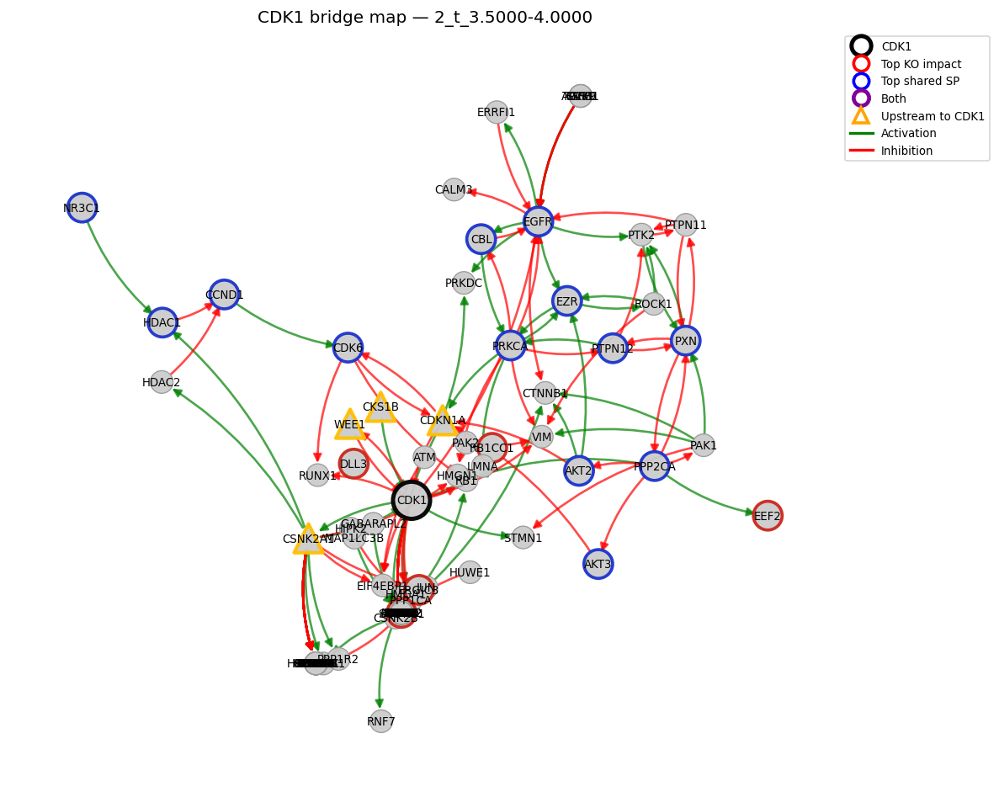

In [165]:
# =============================================================================
# CDK1 BRIDGE ANALYSIS — shortest-path overlap + randomized KOs + bridge map
# Requires: igraph `g` (full network, vertices: name=UniProt, gene_symbol, module),
#           dict `group_graphs` of igraphs per group (same ID space),
#           list `TRAJ_3` (group order). Uses UniProt IDs for operations.
# Outputs:  (A) exact shared-shortest-path overlap w.r.t. CDK1 (latest group),
#           (B) randomized KO influence on mean CDK1 betweenness across groups,
#               comparing seed-only vs seed+descendants≤2 (expanded on BIG `g`),
#           (C) compact visualization: CDK1 bridging modules; highlights genes
#               with highest KO/overlap influence; upstream regulators flagged.
# =============================================================================

import igraph as ig
import numpy as np
import pandas as pd
import random
from collections import defaultdict
from typing import Dict, List, Iterable, Tuple, Set
import matplotlib.pyplot as plt
import networkx as nx
from matplotlib.cm import get_cmap
from matplotlib.patches import Patch
from matplotlib.lines import Line2D

CDK1_UP = "P06493"                   # UniProt for CDK1 (protected from KO)
EXCLUDE_IDS = {CDK1_UP}              # never remove these
RNG = random.Random(1)

# -------------------------- helpers --------------------------
def ensure_sym_map_from_graphs(graphs: Dict[str, ig.Graph]) -> dict:
    m = {}
    for G in graphs.values():
        if G.vcount():
            for v in G.vs:
                if "gene_symbol" in v.attributes() and v["gene_symbol"]:
                    m[v["name"]] = v["gene_symbol"]
    return m

def cdk1_betweenness_only(G: ig.Graph, cdk1=CDK1_UP) -> float:
    if G.vcount() == 0 or cdk1 not in G.vs["name"]:
        return 0.0
    vid = G.vs.find(name=cdk1).index
    return float(G.betweenness(vertices=[vid], directed=True)[0])

def mean_cdk1_betweenness(graphs: Dict[str, ig.Graph]) -> float:
    vals = [cdk1_betweenness_only(G) for G in graphs.values()]
    return float(np.mean(vals)) if len(vals) else 0.0

# ------------------ A) exact shortest-path overlap ------------------
def cdk1_shortest_path_overlap_exact(G: ig.Graph, cdk1=CDK1_UP, max_n_exact=2000,
                                     sample_pairs=4000, rng=RNG) -> pd.DataFrame:
    """
    Exact pair-level overlap with CDK1: counts (s,t) pairs whose shortest path goes via CDK1,
    and for each v!=CDK1 counts how often v is also on those shortest paths. Falls back
    to sampler if graph is very large.
    """
    n = G.vcount()
    if n == 0 or cdk1 not in G.vs["name"]:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_pairs","overlap_frac_pairs"])
    if n > max_n_exact:
        # fallback to light sampler
        return _cdk1_overlap_sampler(G, cdk1, sample_pairs, rng)

    c = G.vs.find(name=cdk1).index
    D = np.array(G.shortest_paths(mode="OUT"), dtype=float)
    ds_c = D[:, c]        # s -> c
    c_t  = D[c, :]        # c -> t
    via_c_len = ds_c[:, None] + c_t[None, :]
    sp_via_c = np.isfinite(via_c_len) & (via_c_len == D)
    idx = np.arange(n)
    sp_via_c[idx, idx] = False
    total_pairs = int(sp_via_c.sum())
    if total_pairs == 0:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_pairs","overlap_frac_pairs"])

    names = G.vs["name"]
    syms  = G.vs["gene_symbol"] if "gene_symbol" in G.vs.attributes() else [""]*n
    out = []
    for v in range(n):
        if v == c: 
            continue
        before = (D[:, v][:, None] + D[v, c] + c_t[None, :]) == D
        after  = (ds_c[:, None] + D[c, v] + D[v, :][None, :]) == D
        mask_v = (before | after) & sp_via_c
        cnt = int(mask_v.sum())
        if cnt > 0:
            out.append({
                "uniprot": names[v],
                "gene_symbol": (syms[v] if syms[v] else names[v]),
                "overlap_pairs": cnt,
                "overlap_frac_pairs": cnt / total_pairs,
            })
    return (pd.DataFrame(out)
              .sort_values(["overlap_frac_pairs","overlap_pairs"], ascending=False)
              .reset_index(drop=True))

def _cdk1_overlap_sampler(G: ig.Graph, cdk1=CDK1_UP, sample_pairs=4000, rng=RNG) -> pd.DataFrame:
    """Lightweight fallback sampler (ordered source/target pairs)."""
    if cdk1 not in G.vs["name"]:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_pairs","overlap_frac_pairs"])
    vids = list(range(G.vcount()))
    c = G.vs.find(name=cdk1).index
    pairs = set()
    while len(pairs) < min(sample_pairs, G.vcount() * (G.vcount() - 1)):
        s = rng.choice(vids); t = rng.choice(vids)
        if s != t: pairs.add((s,t))

    from collections import Counter
    overlap, total = Counter(), 0
    for s,t in pairs:
        paths = G.get_all_shortest_paths(s, to=t, mode="OUT")
        for p in paths:
            if c in p:
                total += 1
                for v in p:
                    if v != c: overlap[v] += 1
    if total == 0:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_pairs","overlap_frac_pairs"])
    out = [{
        "uniprot": G.vs[v]["name"],
        "gene_symbol": (G.vs[v]["gene_symbol"] if "gene_symbol" in G.vs.attributes() and G.vs[v]["gene_symbol"] else G.vs[v]["name"]),
        "overlap_pairs": int(cnt),
        "overlap_frac_pairs": cnt/total
    } for v,cnt in overlap.items()]
    return (pd.DataFrame(out)
              .sort_values(["overlap_frac_pairs","overlap_pairs"], ascending=False)
              .reset_index(drop=True))

# ----------- KO expansion on BIG graph (seed + ≤2-hop OUT) -----------
def build_out_map_k(g_big: ig.Graph, k: int) -> Dict[str, Set[str]]:
    names = g_big.vs["name"]
    idx_by_name = {n:i for i,n in enumerate(names)}
    out_map = {}
    for i, u in enumerate(names):
        current = {i}
        frontier = {i}
        for _ in range(k):
            nxt = set()
            for v in frontier:
                nxt |= set(g_big.neighbors(v, mode="OUT"))
            current |= nxt
            frontier = nxt
            if not frontier: break
        out_map[u] = {names[j] for j in current}
    return out_map

# ------------------ B) randomized KO sweeps (fast) ------------------
def randomized_ko_sweeps_bigdesc_fast(
    g_big: ig.Graph,
    baseline_graphs: Dict[str, ig.Graph],
    m_list: Iterable[int] = (1,2),
    n_trials: int = 400,
    k_down_big: int = 2,      # expand seed on BIG g to ≤k OUT (0/1/2…)
    exclude_ids: Set[str] = EXCLUDE_IDS,
    rng: random.Random = RNG,
    cdk1_id: str = CDK1_UP,
) -> Tuple[pd.DataFrame, pd.DataFrame]:
    # Precompute expansion
    exp_map = build_out_map_k(g_big, k_down_big) if k_down_big > 0 else {u:{u} for u in g_big.vs["name"]}

    # Universe from baseline graphs
    universe = sorted(set().union(*[set(G.vs["name"]) for G in baseline_graphs.values()]) - set(exclude_ids))
    if not universe:
        raise ValueError("KO universe is empty (after exclusions).")

    # Baseline mean CDK1 betweenness across groups
    base_mean = mean_cdk1_betweenness(baseline_graphs)

    # Pre-cache names per group
    names_by_group = {k: set(G.vs["name"]) for k,G in baseline_graphs.items()}

    contrib_sum, contrib_count = defaultdict(float), defaultdict(int)
    trials = []
    tid = 0

    for m in m_list:
        for _ in range(n_trials):
            if m > len(universe): continue
            seeds = rng.sample(universe, m)
            # Expand on BIG g, then subtract excluded
            ko_set = set().union(*[exp_map.get(s,{s}) for s in seeds]) - set(exclude_ids)

            # Apply per group & compute CDK1-only betweenness
            vals = []
            for grp, G in baseline_graphs.items():
                if not (ko_set & names_by_group[grp]):
                    vals.append(cdk1_betweenness_only(G, cdk1_id))
                else:
                    keep_idx = [i for i,n in enumerate(G.vs["name"]) if n not in ko_set]
                    G2 = G.subgraph(ig.VertexSeq(G, keep_idx))
                    vals.append(cdk1_betweenness_only(G2, cdk1_id))
            delta = float(np.mean(vals) - base_mean)

            trials.append({
                "m": m, "trial": tid,
                "delta_mean": delta,
                "delta_abs": abs(delta),
                "ko_genes": tuple(sorted(seeds)),
            })
            tid += 1

            share = (delta/m) if m>0 else 0.0
            for s in seeds:
                contrib_sum[s] += share
                contrib_count[s] += 1

    per_trial = pd.DataFrame(trials)
    top_cut = per_trial["delta_abs"].quantile(0.99) if not per_trial.empty else np.inf
    hits = defaultdict(int)
    if not per_trial.empty:
        for _,r in per_trial.loc[per_trial["delta_abs"]>=top_cut].iterrows():
            for s in r["ko_genes"]:
                hits[s] += 1

    genes = sorted(contrib_count.keys())
    per_gene = pd.DataFrame({
        "gene": genes,
        "trials": [contrib_count[g] for g in genes],
        "mean_delta": [contrib_sum[g]/contrib_count[g] if contrib_count[g] else 0.0 for g in genes],
        "hit_rate_top1pct": [hits[g]/max(1, contrib_count[g]) for g in genes],
    }).sort_values(["hit_rate_top1pct","mean_delta"], ascending=[False, False]).reset_index(drop=True)

    return per_gene, per_trial

def single_ko_sweep_bigdesc(
    g_big: ig.Graph,
    baseline_graphs: Dict[str, ig.Graph],
    k_down_big: int = 2,
    exclude_ids: Set[str] = EXCLUDE_IDS,
    cdk1_id: str = CDK1_UP,
) -> pd.DataFrame:
    exp_map = build_out_map_k(g_big, k_down_big) if k_down_big>0 else {u:{u} for u in g_big.vs["name"]}
    universe = sorted(set().union(*[set(G.vs["name"]) for G in baseline_graphs.values()]) - set(exclude_ids))
    base_mean = mean_cdk1_betweenness(baseline_graphs)
    rows = []
    for seed in universe:
        ko_set = set(exp_map.get(seed,{seed})) - set(exclude_ids)
        vals = []
        for grp, G in baseline_graphs.items():
            if not (ko_set & set(G.vs["name"])):
                vals.append(cdk1_betweenness_only(G, cdk1_id))
            else:
                keep_idx = [i for i,n in enumerate(G.vs["name"]) if n not in ko_set]
                G2 = G.subgraph(ig.VertexSeq(G, keep_idx))
                vals.append(cdk1_betweenness_only(G2, cdk1_id))
        rows.append({"gene": seed, "delta_mean": float(np.mean(vals) - base_mean)})
    return pd.DataFrame(rows).sort_values("delta_mean", ascending=False).reset_index(drop=True)

# ------------------ C) compact bridge visualization ------------------
def draw_cdk1_bridge_map(
    G: ig.Graph,
    sym_map: dict,
    ssp_df: pd.DataFrame,             # from A
    per_gene_rand: pd.DataFrame,      # from B (descendants ≤2 mode recommended)
    top_k_sp: int = 15,
    top_k_ko: int = 15,
    neigh_hops: int = 2,
    title: str = "CDK1 bridge map"
):
    """Draw a compact network around CDK1 highlighting module bridges + impactful genes."""
    if CDK1_UP not in G.vs["name"] or G.vcount()==0:
        print("CDK1 not in this group; cannot draw.")
        return
    # sets to highlight
    top_sp = set(ssp_df.sort_values("overlap_pairs", ascending=False).head(top_k_sp)["uniprot"]) if not ssp_df.empty else set()
    top_ko = set(per_gene_rand.sort_values(["hit_rate_top1pct","mean_delta"], ascending=[False,False]).head(top_k_ko)["gene"]) if not per_gene_rand.empty else set()

    # k-neighborhood of CDK1 (mode=ALL)
    c = G.vs.find(name=CDK1_UP).index
    kept = {c}
    frontier = {c}
    for _ in range(neigh_hops):
        nxt = set()
        for v in frontier:
            nxt |= set(G.neighbors(v, mode="ALL"))
        kept |= nxt
        frontier = nxt
        if not frontier: break

    # also keep highlighted nodes (if outside)
    name2idx = {G.vs[i]["name"]: i for i in range(G.vcount())}
    kept |= {name2idx[u] for u in (top_sp|top_ko) if u in name2idx}

    H = G.subgraph(ig.VertexSeq(G, sorted(list(kept))))
    # convert to NetworkX for flexible styling
    nxg = nx.DiGraph()
    for v in H.vs:
        up = v["name"]
        nxg.add_node(up,
                     label=sym_map.get(up, up),
                     module=v["module"] if "module" in v.attributes() else None)
    for e in H.es:
        s,t = H.vs[e.source]["name"], H.vs[e.target]["name"]
        et = e["type"] if "type" in e.attributes() else None
        nxg.add_edge(s,t, type=et)

    # upstream regulators (1-hop IN to CDK1)
    upstream = set(nxg.predecessors(CDK1_UP)) if CDK1_UP in nxg else set()

    # layout + styles
    pos = nx.kamada_kawai_layout(nxg)
    modules = [nxg.nodes[n].get("module") for n in nxg.nodes()]
    uniq_mod = sorted({m for m in modules if m is not None})
    cmap = get_cmap("tab20")
    mod2col = {m: cmap(i/ max(1, len(uniq_mod)-1)) for i,m in enumerate(uniq_mod)}
    node_colors = []
    node_shapes = {}
    node_edgecolors = []
    node_sizes = []
    for n in nxg.nodes():
        mod = nxg.nodes[n].get("module")
        col = mod2col.get(mod, (0.8,0.8,0.8,1.0))
        # highlight membership
        is_cdk1 = (n == CDK1_UP)
        in_sp   = (n in top_sp)
        in_ko   = (n in top_ko)
        is_up   = (n in upstream)

        edgecol = (0.6,0.6,0.6,1.0)
        lw = 0.8
        if in_sp and in_ko:
            edgecol = (0.5,0.0,0.6,1.0)  # purple ring
            lw = 2.8
        elif in_sp:
            edgecol = (0.1,0.2,0.8,1.0)  # blue ring
            lw = 2.2
        elif in_ko:
            edgecol = (0.8,0.15,0.1,1.0) # red ring
            lw = 2.2
        if is_up:
            edgecol = (1.0,0.75,0.0,1.0) # gold ring for upstream
            lw = 2.5
        if is_cdk1:
            edgecol = (0,0,0,1)
            lw = 3.0

        nxg.nodes[n]["_facecolor"] = col
        nxg.nodes[n]["_edgecolor"] = edgecol
        nxg.nodes[n]["_lw"] = lw
        nxg.nodes[n]["_shape"] = "^" if is_up else "o"
        nxg.nodes[n]["_size"] = 700 if is_cdk1 else (420 if (in_sp or in_ko or is_up) else 260)

    # draw
    plt.figure(figsize=(10,8))
    # edges
    act = [(u,v) for u,v,d in nxg.edges(data=True) if d.get("type")=="activation"]
    inh = [(u,v) for u,v,d in nxg.edges(data=True) if d.get("type")=="inhibition"]
    oth = [(u,v) for u,v,d in nxg.edges(data=True) if d.get("type") not in {"activation","inhibition"}]
    if act: nx.draw_networkx_edges(nxg, pos, edgelist=act, edge_color="green", arrowsize=12, width=1.6, alpha=0.7, connectionstyle="arc3,rad=0.14")
    if inh: nx.draw_networkx_edges(nxg, pos, edgelist=inh, edge_color="red",   arrowsize=12, width=1.6, alpha=0.7, connectionstyle="arc3,rad=0.14")
    if oth: nx.draw_networkx_edges(nxg, pos, edgelist=oth, edge_color="grey",  arrowsize=10, width=1.0, alpha=0.45,connectionstyle="arc3,rad=0.12")

    # nodes by shape
    for shape in {"o","^"}:
        nodes = [n for n in nxg.nodes() if nxg.nodes[n]["_shape"]==shape]
        if not nodes: continue
        nx.draw_networkx_nodes(
            nxg, pos, nodelist=nodes,
            node_color=[nxg.nodes[n]["_facecolor"] for n in nodes],
            node_size=[nxg.nodes[n]["_size"] for n in nodes],
            node_shape=shape,
            linewidths=[nxg.nodes[n]["_lw"] for n in nodes],
            edgecolors=[nxg.nodes[n]["_edgecolor"] for n in nodes],
            alpha=0.95
        )

    # labels
    labels = {n: nxg.nodes[n]["label"] for n in nxg.nodes()}
    nx.draw_networkx_labels(nxg, pos, labels=labels, font_size=8)

    # legend
    legend_nodes = [
        Line2D([0],[0], marker='o', color='w', label='CDK1', markerfacecolor='w',
               markeredgecolor='black', markeredgewidth=3, markersize=14),
        Line2D([0],[0], marker='o', color='w', label='Top KO impact', markerfacecolor='w',
               markeredgecolor='red', markeredgewidth=2.2, markersize=11),
        Line2D([0],[0], marker='o', color='w', label='Top shared SP', markerfacecolor='w',
               markeredgecolor='blue', markeredgewidth=2.2, markersize=11),
        Line2D([0],[0], marker='o', color='w', label='Both', markerfacecolor='w',
               markeredgecolor=(0.5,0,0.6,1), markeredgewidth=2.8, markersize=11),
        Line2D([0],[0], marker='^', color='w', label='Upstream to CDK1', markerfacecolor='w',
               markeredgecolor='orange', markeredgewidth=2.2, markersize=11),
        Line2D([0],[0], color='green', lw=2, label='Activation'),
        Line2D([0],[0], color='red', lw=2, label='Inhibition'),
    ]
    plt.legend(handles=legend_nodes, fontsize=8, loc="upper left", bbox_to_anchor=(1,1))
    plt.title(title)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

# ========================== RUN ==========================
# 1) choose groups you actually have
traj3_existing  = [x for x in TRAJ_3 if x in group_graphs]
baseline_graphs = {k: group_graphs[k] for k in traj3_existing}
latest_group    = traj3_existing[-1]
sym_map         = ensure_sym_map_from_graphs(baseline_graphs)

# 2) shared shortest paths (exact) on latest group
ssp_exact = cdk1_shortest_path_overlap_exact(baseline_graphs[latest_group], cdk1=CDK1_UP)

# 3) randomized KOs: seed-only vs seed+descendants≤2 (expanded on BIG g)
per_gene_seed,  per_trial_seed  = randomized_ko_sweeps_bigdesc_fast(
    g_big=g, baseline_graphs=baseline_graphs,
    m_list=(1,2), n_trials=600, k_down_big=0, exclude_ids=EXCLUDE_IDS
)
per_gene_desc,  per_trial_desc  = randomized_ko_sweeps_bigdesc_fast(
    g_big=g, baseline_graphs=baseline_graphs,
    m_list=(1,2), n_trials=600, k_down_big=2, exclude_ids=EXCLUDE_IDS
)

# 4) exact single-KO (descendants≤2) if you want a clean ranking
single_ko_desc = single_ko_sweep_bigdesc(g, baseline_graphs, k_down_big=2, exclude_ids=EXCLUDE_IDS)

# 5) quick merged table (latest group overlap + KO-desc summary)
merged = (
    ssp_exact.rename(columns={"overlap_pairs":"overlap_pairs_latest","overlap_frac_pairs":"overlap_frac_latest"})
    .merge(per_gene_desc, left_on="uniprot", right_on="gene", how="left")
    .merge(single_ko_desc.rename(columns={"gene":"uniprot","delta_mean":"singleKO_delta"}), on="uniprot", how="left")
)
merged["gene_symbol"] = merged["gene_symbol"].fillna(merged["uniprot"].map(sym_map))
merged = merged[["uniprot","gene_symbol","overlap_pairs_latest","overlap_frac_latest","trials","mean_delta","hit_rate_top1pct","singleKO_delta"]]
merged = merged.sort_values(["overlap_frac_latest","hit_rate_top1pct","mean_delta"], ascending=[False, False, False]).reset_index(drop=True)

pd.set_option("display.max_columns", None); pd.set_option("display.precision", 6)
print("\n=== CDK1 — shared SP overlap (latest) + KO-desc impact (top 25) ===\n")
print(merged.head(25))

# 6) compact visualization for the latest group (use KO-desc results)
draw_cdk1_bridge_map(
    G=baseline_graphs[latest_group],
    sym_map=sym_map,
    ssp_df=ssp_exact,
    per_gene_rand=per_gene_desc,
    top_k_sp=15, top_k_ko=15, neigh_hops=2,
    title=f"CDK1 bridge map — {latest_group}"
)


/tmp/ipykernel_270652/4097862236.py:65: DeprecationWarning: Graph.shortest_paths() is deprecated; use Graph.distances() instead
  D = np.array(G.shortest_paths(mode="OUT"), dtype=float)



=== CDK1 — shared SP overlap (latest) + KO-desc impact (top 25) ===

   uniprot gene_symbol  overlap_pairs_latest  overlap_frac_latest  trials  \
0   P38936      CDKN1A                  3775             0.890540     4.0   
1   P17252       PRKCA                  2220             0.523708     8.0   
2   P00533        EGFR                  1623             0.382873     4.0   
3   P68400     CSNK2A1                  1513             0.356924     1.0   
4   P15311         EZR                  1318             0.310922     5.0   
5   Q00534        CDK6                  1273             0.300307     2.0   
6   P24385       CCND1                  1203             0.283793     3.0   
7   Q9Y243        AKT3                  1073             0.253126     9.0   
8   Q13547       HDAC1                  1070             0.252418     3.0   
9   P67775      PPP2CA                  1053             0.248408     3.0   
10  P31751        AKT2                  1030             0.242982     8.0   
11  P4

/tmp/ipykernel_270652/4097862236.py:304: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("tab20")


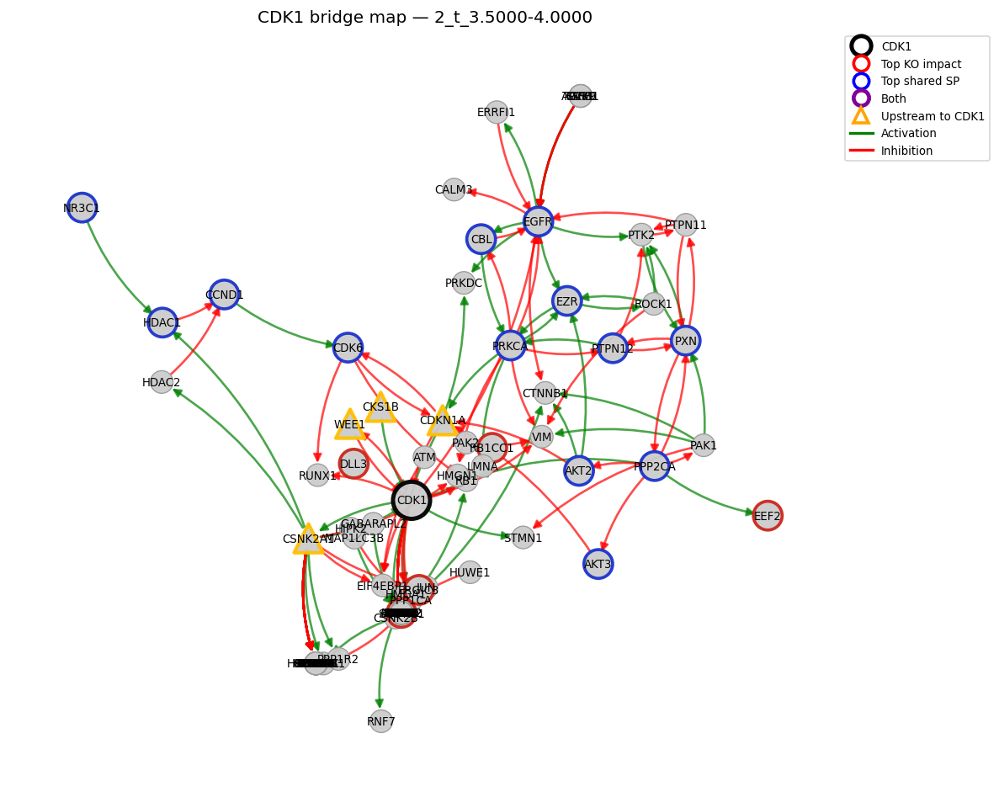

In [166]:
# =============================================================================
# CDK1 BRIDGE ANALYSIS — shortest-path overlap + randomized KOs + bridge map
# Requires: igraph `g` (full network, vertices: name=UniProt, gene_symbol, module),
#           dict `group_graphs` of igraphs per group (same ID space),
#           list `TRAJ_3` (group order). Uses UniProt IDs for operations.
# Outputs:  (A) exact shared-shortest-path overlap w.r.t. CDK1 (latest group),
#           (B) randomized KO influence on mean CDK1 betweenness across groups,
#               comparing seed-only vs seed+descendants≤2 (expanded on BIG `g`),
#           (C) compact visualization: CDK1 bridging modules; highlights genes
#               with highest KO/overlap influence; upstream regulators flagged.
# =============================================================================

import igraph as ig
import numpy as np
import pandas as pd
import random
from collections import defaultdict
from typing import Dict, List, Iterable, Tuple, Set
import matplotlib.pyplot as plt
import networkx as nx
from matplotlib.cm import get_cmap
from matplotlib.patches import Patch
from matplotlib.lines import Line2D

CDK1_UP = "P06493"                   # UniProt for CDK1 (protected from KO)
EXCLUDE_IDS = {CDK1_UP}              # never remove these
RNG = random.Random(1)

# -------------------------- helpers --------------------------
def ensure_sym_map_from_graphs(graphs: Dict[str, ig.Graph]) -> dict:
    m = {}
    for G in graphs.values():
        if G.vcount():
            for v in G.vs:
                if "gene_symbol" in v.attributes() and v["gene_symbol"]:
                    m[v["name"]] = v["gene_symbol"]
    return m

def cdk1_betweenness_only(G: ig.Graph, cdk1=CDK1_UP) -> float:
    if G.vcount() == 0 or cdk1 not in G.vs["name"]:
        return 0.0
    vid = G.vs.find(name=cdk1).index
    return float(G.betweenness(vertices=[vid], directed=True)[0])

def mean_cdk1_betweenness(graphs: Dict[str, ig.Graph]) -> float:
    vals = [cdk1_betweenness_only(G) for G in graphs.values()]
    return float(np.mean(vals)) if len(vals) else 0.0

# ------------------ A) exact shortest-path overlap ------------------
def cdk1_shortest_path_overlap_exact(G: ig.Graph, cdk1=CDK1_UP, max_n_exact=2000,
                                     sample_pairs=4000, rng=RNG) -> pd.DataFrame:
    """
    Exact pair-level overlap with CDK1: counts (s,t) pairs whose shortest path goes via CDK1,
    and for each v!=CDK1 counts how often v is also on those shortest paths. Falls back
    to sampler if graph is very large.
    """
    n = G.vcount()
    if n == 0 or cdk1 not in G.vs["name"]:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_pairs","overlap_frac_pairs"])
    if n > max_n_exact:
        # fallback to light sampler
        return _cdk1_overlap_sampler(G, cdk1, sample_pairs, rng)

    c = G.vs.find(name=cdk1).index
    D = np.array(G.shortest_paths(mode="OUT"), dtype=float)
    ds_c = D[:, c]        # s -> c
    c_t  = D[c, :]        # c -> t
    via_c_len = ds_c[:, None] + c_t[None, :]
    sp_via_c = np.isfinite(via_c_len) & (via_c_len == D)
    idx = np.arange(n)
    sp_via_c[idx, idx] = False
    total_pairs = int(sp_via_c.sum())
    if total_pairs == 0:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_pairs","overlap_frac_pairs"])

    names = G.vs["name"]
    syms  = G.vs["gene_symbol"] if "gene_symbol" in G.vs.attributes() else [""]*n
    out = []
    for v in range(n):
        if v == c: 
            continue
        before = (D[:, v][:, None] + D[v, c] + c_t[None, :]) == D
        after  = (ds_c[:, None] + D[c, v] + D[v, :][None, :]) == D
        mask_v = (before | after) & sp_via_c
        cnt = int(mask_v.sum())
        if cnt > 0:
            out.append({
                "uniprot": names[v],
                "gene_symbol": (syms[v] if syms[v] else names[v]),
                "overlap_pairs": cnt,
                "overlap_frac_pairs": cnt / total_pairs,
            })
    return (pd.DataFrame(out)
              .sort_values(["overlap_frac_pairs","overlap_pairs"], ascending=False)
              .reset_index(drop=True))

def _cdk1_overlap_sampler(G: ig.Graph, cdk1=CDK1_UP, sample_pairs=4000, rng=RNG) -> pd.DataFrame:
    """Lightweight fallback sampler (ordered source/target pairs)."""
    if cdk1 not in G.vs["name"]:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_pairs","overlap_frac_pairs"])
    vids = list(range(G.vcount()))
    c = G.vs.find(name=cdk1).index
    pairs = set()
    while len(pairs) < min(sample_pairs, G.vcount() * (G.vcount() - 1)):
        s = rng.choice(vids); t = rng.choice(vids)
        if s != t: pairs.add((s,t))

    from collections import Counter
    overlap, total = Counter(), 0
    for s,t in pairs:
        paths = G.get_all_shortest_paths(s, to=t, mode="OUT")
        for p in paths:
            if c in p:
                total += 1
                for v in p:
                    if v != c: overlap[v] += 1
    if total == 0:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_pairs","overlap_frac_pairs"])
    out = [{
        "uniprot": G.vs[v]["name"],
        "gene_symbol": (G.vs[v]["gene_symbol"] if "gene_symbol" in G.vs.attributes() and G.vs[v]["gene_symbol"] else G.vs[v]["name"]),
        "overlap_pairs": int(cnt),
        "overlap_frac_pairs": cnt/total
    } for v,cnt in overlap.items()]
    return (pd.DataFrame(out)
              .sort_values(["overlap_frac_pairs","overlap_pairs"], ascending=False)
              .reset_index(drop=True))

# ----------- KO expansion on BIG graph (seed + ≤2-hop OUT) -----------
def build_out_map_k(g_big: ig.Graph, k: int) -> Dict[str, Set[str]]:
    names = g_big.vs["name"]
    idx_by_name = {n:i for i,n in enumerate(names)}
    out_map = {}
    for i, u in enumerate(names):
        current = {i}
        frontier = {i}
        for _ in range(k):
            nxt = set()
            for v in frontier:
                nxt |= set(g_big.neighbors(v, mode="OUT"))
            current |= nxt
            frontier = nxt
            if not frontier: break
        out_map[u] = {names[j] for j in current}
    return out_map

# ------------------ B) randomized KO sweeps (fast) ------------------
def randomized_ko_sweeps_bigdesc_fast(
    g_big: ig.Graph,
    baseline_graphs: Dict[str, ig.Graph],
    m_list: Iterable[int] = (1,2),
    n_trials: int = 400,
    k_down_big: int = 2,      # expand seed on BIG g to ≤k OUT (0/1/2…)
    exclude_ids: Set[str] = EXCLUDE_IDS,
    rng: random.Random = RNG,
    cdk1_id: str = CDK1_UP,
) -> Tuple[pd.DataFrame, pd.DataFrame]:
    # Precompute expansion
    exp_map = build_out_map_k(g_big, k_down_big) if k_down_big > 0 else {u:{u} for u in g_big.vs["name"]}

    # Universe from baseline graphs
    universe = sorted(set().union(*[set(G.vs["name"]) for G in baseline_graphs.values()]) - set(exclude_ids))
    if not universe:
        raise ValueError("KO universe is empty (after exclusions).")

    # Baseline mean CDK1 betweenness across groups
    base_mean = mean_cdk1_betweenness(baseline_graphs)

    # Pre-cache names per group
    names_by_group = {k: set(G.vs["name"]) for k,G in baseline_graphs.items()}

    contrib_sum, contrib_count = defaultdict(float), defaultdict(int)
    trials = []
    tid = 0

    for m in m_list:
        for _ in range(n_trials):
            if m > len(universe): continue
            seeds = rng.sample(universe, m)
            # Expand on BIG g, then subtract excluded
            ko_set = set().union(*[exp_map.get(s,{s}) for s in seeds]) - set(exclude_ids)

            # Apply per group & compute CDK1-only betweenness
            vals = []
            for grp, G in baseline_graphs.items():
                if not (ko_set & names_by_group[grp]):
                    vals.append(cdk1_betweenness_only(G, cdk1_id))
                else:
                    keep_idx = [i for i,n in enumerate(G.vs["name"]) if n not in ko_set]
                    G2 = G.subgraph(ig.VertexSeq(G, keep_idx))
                    vals.append(cdk1_betweenness_only(G2, cdk1_id))
            delta = float(np.mean(vals) - base_mean)

            trials.append({
                "m": m, "trial": tid,
                "delta_mean": delta,
                "delta_abs": abs(delta),
                "ko_genes": tuple(sorted(seeds)),
            })
            tid += 1

            share = (delta/m) if m>0 else 0.0
            for s in seeds:
                contrib_sum[s] += share
                contrib_count[s] += 1

    per_trial = pd.DataFrame(trials)
    top_cut = per_trial["delta_abs"].quantile(0.99) if not per_trial.empty else np.inf
    hits = defaultdict(int)
    if not per_trial.empty:
        for _,r in per_trial.loc[per_trial["delta_abs"]>=top_cut].iterrows():
            for s in r["ko_genes"]:
                hits[s] += 1

    genes = sorted(contrib_count.keys())
    per_gene = pd.DataFrame({
        "gene": genes,
        "trials": [contrib_count[g] for g in genes],
        "mean_delta": [contrib_sum[g]/contrib_count[g] if contrib_count[g] else 0.0 for g in genes],
        "hit_rate_top1pct": [hits[g]/max(1, contrib_count[g]) for g in genes],
    }).sort_values(["hit_rate_top1pct","mean_delta"], ascending=[False, False]).reset_index(drop=True)

    return per_gene, per_trial

def single_ko_sweep_bigdesc(
    g_big: ig.Graph,
    baseline_graphs: Dict[str, ig.Graph],
    k_down_big: int = 2,
    exclude_ids: Set[str] = EXCLUDE_IDS,
    cdk1_id: str = CDK1_UP,
) -> pd.DataFrame:
    exp_map = build_out_map_k(g_big, k_down_big) if k_down_big>0 else {u:{u} for u in g_big.vs["name"]}
    universe = sorted(set().union(*[set(G.vs["name"]) for G in baseline_graphs.values()]) - set(exclude_ids))
    base_mean = mean_cdk1_betweenness(baseline_graphs)
    rows = []
    for seed in universe:
        ko_set = set(exp_map.get(seed,{seed})) - set(exclude_ids)
        vals = []
        for grp, G in baseline_graphs.items():
            if not (ko_set & set(G.vs["name"])):
                vals.append(cdk1_betweenness_only(G, cdk1_id))
            else:
                keep_idx = [i for i,n in enumerate(G.vs["name"]) if n not in ko_set]
                G2 = G.subgraph(ig.VertexSeq(G, keep_idx))
                vals.append(cdk1_betweenness_only(G2, cdk1_id))
        rows.append({"gene": seed, "delta_mean": float(np.mean(vals) - base_mean)})
    return pd.DataFrame(rows).sort_values("delta_mean", ascending=False).reset_index(drop=True)

# ------------------ C) compact bridge visualization ------------------
def draw_cdk1_bridge_map(
    G: ig.Graph,
    sym_map: dict,
    ssp_df: pd.DataFrame,             # from A
    per_gene_rand: pd.DataFrame,      # from B (descendants ≤2 mode recommended)
    top_k_sp: int = 15,
    top_k_ko: int = 15,
    neigh_hops: int = 2,
    title: str = "CDK1 bridge map"
):
    """Draw a compact network around CDK1 highlighting module bridges + impactful genes."""
    if CDK1_UP not in G.vs["name"] or G.vcount()==0:
        print("CDK1 not in this group; cannot draw.")
        return
    # sets to highlight
    top_sp = set(ssp_df.sort_values("overlap_pairs", ascending=False).head(top_k_sp)["uniprot"]) if not ssp_df.empty else set()
    top_ko = set(per_gene_rand.sort_values(["hit_rate_top1pct","mean_delta"], ascending=[False,False]).head(top_k_ko)["gene"]) if not per_gene_rand.empty else set()

    # k-neighborhood of CDK1 (mode=ALL)
    c = G.vs.find(name=CDK1_UP).index
    kept = {c}
    frontier = {c}
    for _ in range(neigh_hops):
        nxt = set()
        for v in frontier:
            nxt |= set(G.neighbors(v, mode="ALL"))
        kept |= nxt
        frontier = nxt
        if not frontier: break

    # also keep highlighted nodes (if outside)
    name2idx = {G.vs[i]["name"]: i for i in range(G.vcount())}
    kept |= {name2idx[u] for u in (top_sp|top_ko) if u in name2idx}

    H = G.subgraph(ig.VertexSeq(G, sorted(list(kept))))
    # convert to NetworkX for flexible styling
    nxg = nx.DiGraph()
    for v in H.vs:
        up = v["name"]
        nxg.add_node(up,
                     label=sym_map.get(up, up),
                     module=v["module"] if "module" in v.attributes() else None)
    for e in H.es:
        s,t = H.vs[e.source]["name"], H.vs[e.target]["name"]
        et = e["type"] if "type" in e.attributes() else None
        nxg.add_edge(s,t, type=et)

    # upstream regulators (1-hop IN to CDK1)
    upstream = set(nxg.predecessors(CDK1_UP)) if CDK1_UP in nxg else set()

    # layout + styles
    pos = nx.kamada_kawai_layout(nxg)
    modules = [nxg.nodes[n].get("module") for n in nxg.nodes()]
    uniq_mod = sorted({m for m in modules if m is not None})
    cmap = get_cmap("tab20")
    mod2col = {m: cmap(i/ max(1, len(uniq_mod)-1)) for i,m in enumerate(uniq_mod)}
    node_colors = []
    node_shapes = {}
    node_edgecolors = []
    node_sizes = []
    for n in nxg.nodes():
        mod = nxg.nodes[n].get("module")
        col = mod2col.get(mod, (0.8,0.8,0.8,1.0))
        # highlight membership
        is_cdk1 = (n == CDK1_UP)
        in_sp   = (n in top_sp)
        in_ko   = (n in top_ko)
        is_up   = (n in upstream)

        edgecol = (0.6,0.6,0.6,1.0)
        lw = 0.8
        if in_sp and in_ko:
            edgecol = (0.5,0.0,0.6,1.0)  # purple ring
            lw = 2.8
        elif in_sp:
            edgecol = (0.1,0.2,0.8,1.0)  # blue ring
            lw = 2.2
        elif in_ko:
            edgecol = (0.8,0.15,0.1,1.0) # red ring
            lw = 2.2
        if is_up:
            edgecol = (1.0,0.75,0.0,1.0) # gold ring for upstream
            lw = 2.5
        if is_cdk1:
            edgecol = (0,0,0,1)
            lw = 3.0

        nxg.nodes[n]["_facecolor"] = col
        nxg.nodes[n]["_edgecolor"] = edgecol
        nxg.nodes[n]["_lw"] = lw
        nxg.nodes[n]["_shape"] = "^" if is_up else "o"
        nxg.nodes[n]["_size"] = 700 if is_cdk1 else (420 if (in_sp or in_ko or is_up) else 260)

    # draw
    plt.figure(figsize=(10,8))
    # edges
    act = [(u,v) for u,v,d in nxg.edges(data=True) if d.get("type")=="activation"]
    inh = [(u,v) for u,v,d in nxg.edges(data=True) if d.get("type")=="inhibition"]
    oth = [(u,v) for u,v,d in nxg.edges(data=True) if d.get("type") not in {"activation","inhibition"}]
    if act: nx.draw_networkx_edges(nxg, pos, edgelist=act, edge_color="green", arrowsize=12, width=1.6, alpha=0.7, connectionstyle="arc3,rad=0.14")
    if inh: nx.draw_networkx_edges(nxg, pos, edgelist=inh, edge_color="red",   arrowsize=12, width=1.6, alpha=0.7, connectionstyle="arc3,rad=0.14")
    if oth: nx.draw_networkx_edges(nxg, pos, edgelist=oth, edge_color="grey",  arrowsize=10, width=1.0, alpha=0.45,connectionstyle="arc3,rad=0.12")

    # nodes by shape
    for shape in {"o","^"}:
        nodes = [n for n in nxg.nodes() if nxg.nodes[n]["_shape"]==shape]
        if not nodes: continue
        nx.draw_networkx_nodes(
            nxg, pos, nodelist=nodes,
            node_color=[nxg.nodes[n]["_facecolor"] for n in nodes],
            node_size=[nxg.nodes[n]["_size"] for n in nodes],
            node_shape=shape,
            linewidths=[nxg.nodes[n]["_lw"] for n in nodes],
            edgecolors=[nxg.nodes[n]["_edgecolor"] for n in nodes],
            alpha=0.95
        )

    # labels
    labels = {n: nxg.nodes[n]["label"] for n in nxg.nodes()}
    nx.draw_networkx_labels(nxg, pos, labels=labels, font_size=8)

    # legend
    legend_nodes = [
        Line2D([0],[0], marker='o', color='w', label='CDK1', markerfacecolor='w',
               markeredgecolor='black', markeredgewidth=3, markersize=14),
        Line2D([0],[0], marker='o', color='w', label='Top KO impact', markerfacecolor='w',
               markeredgecolor='red', markeredgewidth=2.2, markersize=11),
        Line2D([0],[0], marker='o', color='w', label='Top shared SP', markerfacecolor='w',
               markeredgecolor='blue', markeredgewidth=2.2, markersize=11),
        Line2D([0],[0], marker='o', color='w', label='Both', markerfacecolor='w',
               markeredgecolor=(0.5,0,0.6,1), markeredgewidth=2.8, markersize=11),
        Line2D([0],[0], marker='^', color='w', label='Upstream to CDK1', markerfacecolor='w',
               markeredgecolor='orange', markeredgewidth=2.2, markersize=11),
        Line2D([0],[0], color='green', lw=2, label='Activation'),
        Line2D([0],[0], color='red', lw=2, label='Inhibition'),
    ]
    plt.legend(handles=legend_nodes, fontsize=8, loc="upper left", bbox_to_anchor=(1,1))
    plt.title(title)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

# ========================== RUN ==========================
# 1) choose groups you actually have
traj3_existing  = [x for x in TRAJ_3 if x in group_graphs]
baseline_graphs = {k: group_graphs[k] for k in traj3_existing}
latest_group    = traj3_existing[-1]
sym_map         = ensure_sym_map_from_graphs(baseline_graphs)

# 2) shared shortest paths (exact) on latest group
ssp_exact = cdk1_shortest_path_overlap_exact(baseline_graphs[latest_group], cdk1=CDK1_UP)

# 3) randomized KOs: seed-only vs seed+descendants≤2 (expanded on BIG g)
per_gene_seed,  per_trial_seed  = randomized_ko_sweeps_bigdesc_fast(
    g_big=g, baseline_graphs=baseline_graphs,
    m_list=(1,2), n_trials=600, k_down_big=0, exclude_ids=EXCLUDE_IDS
)
per_gene_desc,  per_trial_desc  = randomized_ko_sweeps_bigdesc_fast(
    g_big=g, baseline_graphs=baseline_graphs,
    m_list=(1,2), n_trials=600, k_down_big=2, exclude_ids=EXCLUDE_IDS
)

# 4) exact single-KO (descendants≤2) if you want a clean ranking
single_ko_desc = single_ko_sweep_bigdesc(g, baseline_graphs, k_down_big=2, exclude_ids=EXCLUDE_IDS)

# 5) quick merged table (latest group overlap + KO-desc summary)
merged = (
    ssp_exact.rename(columns={"overlap_pairs":"overlap_pairs_latest","overlap_frac_pairs":"overlap_frac_latest"})
    .merge(per_gene_desc, left_on="uniprot", right_on="gene", how="left")
    .merge(single_ko_desc.rename(columns={"gene":"uniprot","delta_mean":"singleKO_delta"}), on="uniprot", how="left")
)
merged["gene_symbol"] = merged["gene_symbol"].fillna(merged["uniprot"].map(sym_map))
merged = merged[["uniprot","gene_symbol","overlap_pairs_latest","overlap_frac_latest","trials","mean_delta","hit_rate_top1pct","singleKO_delta"]]
merged = merged.sort_values(["overlap_frac_latest","hit_rate_top1pct","mean_delta"], ascending=[False, False, False]).reset_index(drop=True)

pd.set_option("display.max_columns", None); pd.set_option("display.precision", 6)
print("\n=== CDK1 — shared SP overlap (latest) + KO-desc impact (top 25) ===\n")
print(merged.head(25))

# 6) compact visualization for the latest group (use KO-desc results)
draw_cdk1_bridge_map(
    G=baseline_graphs[latest_group],
    sym_map=sym_map,
    ssp_df=ssp_exact,
    per_gene_rand=per_gene_desc,
    top_k_sp=15, top_k_ko=15, neigh_hops=2,
    title=f"CDK1 bridge map — {latest_group}"
)


In [300]:
# ============================================================
# CDK1 overlap + Random KOs (parametric radius, robust scoring)
# ============================================================
import igraph as ig
import numpy as np
import pandas as pd
import random
from collections import defaultdict
from typing import Dict, List, Iterable, Tuple, Set, Optional

CDK1_UP = "P06493"                  # protect CDK1
EXCLUDE_IDS: Set[str] = {CDK1_UP}
RNG = random.Random(1)              # reproducible RNG

# -------------------- helpers --------------------
def ensure_sym_map_from_graphs(graphs: Dict[str, ig.Graph]) -> dict:
    m = {}
    for G in graphs.values():
        if G.vcount():
            names = G.vs["name"]
            syms  = G.vs["gene_symbol"] if "gene_symbol" in G.vs.attributes() else [""]*G.vcount()
            for n, s in zip(names, syms):
                if s:
                    m[n] = s
    return m

def cdk1_betweenness_only(G: ig.Graph, cdk1: str = CDK1_UP) -> float:
    """Return directed betweenness for CDK1 only (0 if absent)."""
    if G.vcount() == 0 or cdk1 not in G.vs["name"]:
        return 0.0
    vid = G.vs.find(name=cdk1).index
    return float(G.betweenness(vertices=[vid], directed=True)[0])

def mean_cdk1_betweenness(graphs: Dict[str, ig.Graph], cdk1: str = CDK1_UP) -> float:
    vals = [cdk1_betweenness_only(G, cdk1=cdk1) for G in graphs.values()]
    return float(np.mean(vals)) if len(vals) else 0.0

# -------------------- radius maps --------------------
def build_out_map(g_big: ig.Graph, radius: int) -> Dict[str, Set[str]]:
    """
    For each node u (by UniProt name), return KO set expanded by OUT neighbors up to 'radius' hops.
    radius ∈ {0,1,2}. radius=0 → {u} only.
    """
    names = g_big.vs["name"]
    idx   = {n: i for i, n in enumerate(names)}

    if radius == 0:
        return {u: {u} for u in names}

    neigh_out = {i: set(g_big.neighbors(i, mode="OUT")) for i in range(g_big.vcount())}

    def hop_union(start_idx: int, r: int) -> Set[int]:
        seen = {start_idx}
        frontier = {start_idx}
        for _ in range(r):
            nxt = set()
            for j in frontier:
                nxt |= neigh_out[j]
            nxt -= seen
            seen |= nxt
            frontier = nxt
        return seen

    out_map = {}
    for i, u in enumerate(names):
        ko_idx = hop_union(i, radius)
        out_map[u] = {names[k] for k in ko_idx}
    return out_map

# -------------------- overlap (exact) --------------------
def cdk1_shortest_path_overlap_exact(
    G: ig.Graph,
    cdk1: str = CDK1_UP,
    max_n_exact: int = 2000,
) -> pd.DataFrame:
    """
    Count (s,t) pairs whose global shortest path length equals dist(s→CDK1)+dist(CDK1→t).
    For each vertex v≠CDK1, count how many such pairs include v (before or after CDK1).
    Returns: [uniprot, gene_symbol, overlap_pairs, overlap_frac_pairs]
    """
    n = G.vcount()
    if n == 0 or cdk1 not in G.vs["name"]:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_pairs","overlap_frac_pairs"])
    if n > max_n_exact:
        raise ValueError(f"Graph too large for exact overlap (n={n} > {max_n_exact}). "
                         "Downselect nodes or increase max_n_exact.")

    c = G.vs.find(name=cdk1).index
    D = np.array(G.shortest_paths(mode="OUT"), dtype=float)  # (n,n)
    ds_c = D[:, c]           # s -> CDK1
    c_t  = D[c, :]           # CDK1 -> t

    via_c_len = ds_c[:, None] + c_t[None, :]
    sp_via_c  = np.isfinite(via_c_len) & (via_c_len == D)

    # ignore s==t
    idx = np.arange(n)
    sp_via_c[idx, idx] = False
    total_pairs = int(sp_via_c.sum())
    if total_pairs == 0:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_pairs","overlap_frac_pairs"])

    names = G.vs["name"]
    syms  = G.vs["gene_symbol"] if "gene_symbol" in G.vs.attributes() else [""]*n
    out_rows = []

    for v in range(n):
        if v == c:
            continue
        before = (D[:, v][:, None] + D[v, c] + c_t[None, :]) == D
        after  = (ds_c[:, None] + D[c, v] + D[v, :][None, :]) == D
        mask_v = (before | after) & sp_via_c
        cnt = int(mask_v.sum())
        if cnt > 0:
            out_rows.append({
                "uniprot": names[v],
                "gene_symbol": (syms[v] if syms[v] else names[v]),
                "overlap_pairs": cnt,
                "overlap_frac_pairs": cnt / total_pairs,
            })

    return (pd.DataFrame(out_rows)
              .sort_values(["overlap_frac_pairs","overlap_pairs"], ascending=False)
              .reset_index(drop=True))

# -------------------- randomized KO sweeps --------------------
def randomized_ko_sweeps(
    g_big: ig.Graph,
    baseline_graphs: Dict[str, ig.Graph],
    m_list: Iterable[int] = (1,2),
    n_trials: int = 1000,
    radius: int = 2,
    exclude_ids: Set[str] = EXCLUDE_IDS,
    rng: random.Random = RNG,
    cdk1_id: str = CDK1_UP,
) -> Tuple[pd.DataFrame, pd.DataFrame]:
    """
    Random KOs of size m (expanded by OUT-neighbors up to 'radius' hops on BIG graph),
    recomputing CDK1 betweenness across all baseline graphs.
    Returns:
      per_gene: [gene, trials, mean_delta, hit_rate_top1pct]
      per_trial: [m, trial, radius, delta_mean, delta_abs, ko_genes]
    """
    if radius not in (0,1,2):
        raise ValueError("radius must be 0, 1, or 2.")
    out_map = build_out_map(g_big, radius=radius)

    # KO universe from baseline graphs (respect exclusions)
    universe = sorted(set().union(*[set(G.vs["name"]) for G in baseline_graphs.values()]) - set(exclude_ids))
    if not universe:
        raise ValueError("KO universe is empty (after exclusions).")

    names_by_group = {k: G.vs["name"] for k, G in baseline_graphs.items()}
    base_mean = mean_cdk1_betweenness(baseline_graphs, cdk1=cdk1_id)

    contrib_sum = defaultdict(float)
    contrib_count = defaultdict(int)
    trials_records = []

    trial_id = 0
    for m in m_list:
        if m <= 0: 
            continue
        for _ in range(n_trials):
            if m > len(universe):
                continue
            seeds = rng.sample(universe, m)

            # Expand on BIG g
            ko_set = set().union(*[out_map.get(s, {s}) for s in seeds]) - set(exclude_ids)

            vals = []
            for grp, G in baseline_graphs.items():
                names = names_by_group[grp]
                if not ko_set & set(names):
                    vals.append(cdk1_betweenness_only(G, cdk1=cdk1_id))
                else:
                    keep_idx = [i for i, n in enumerate(names) if n not in ko_set]
                    G2 = G.subgraph(ig.VertexSeq(G, keep_idx))
                    vals.append(cdk1_betweenness_only(G2, cdk1=cdk1_id))

            delta = float(np.mean(vals) - base_mean)
            dabs  = abs(delta)

            trials_records.append({
                "m": m,
                "trial": trial_id,
                "radius": radius,
                "delta_mean": delta,
                "delta_abs": dabs,
                "ko_genes": tuple(sorted(seeds)),
            })
            trial_id += 1

            share = (delta / m)
            for s in seeds:
                contrib_sum[s] += share
                contrib_count[s] += 1

    per_trial = pd.DataFrame(trials_records)

    # Top-1% absolute effect attribution
    hit = defaultdict(int)
    if not per_trial.empty:
        cut = per_trial["delta_abs"].quantile(0.99)
        for _, r in per_trial.loc[per_trial["delta_abs"] >= cut].iterrows():
            for s in r["ko_genes"]:
                hit[s] += 1

    genes = sorted(contrib_count.keys())
    per_gene = pd.DataFrame({
        "gene": genes,
        "trials": [contrib_count[g] for g in genes],
        "mean_delta": [contrib_sum[g] / contrib_count[g] if contrib_count[g] else 0.0 for g in genes],
        "hit_rate_top1pct": [hit[g] / max(1, contrib_count[g]) for g in genes],
        "radius": radius,
    }).sort_values(["hit_rate_top1pct","mean_delta"], ascending=[False, False]).reset_index(drop=True)

    return per_gene, per_trial

# -------------------- exact single KO --------------------
def single_ko_sweep(
    g_big: ig.Graph,
    baseline_graphs: Dict[str, ig.Graph],
    radius: int = 2,
    exclude_ids: Set[str] = EXCLUDE_IDS,
    cdk1_id: str = CDK1_UP,
) -> pd.DataFrame:
    out_map = build_out_map(g_big, radius=radius)
    universe = sorted(set().union(*[set(G.vs["name"]) for G in baseline_graphs.values()]) - set(exclude_ids))
    base_mean = mean_cdk1_betweenness(baseline_graphs, cdk1=cdk1_id)

    rows = []
    for seed in universe:
        ko_set = set(out_map.get(seed, {seed})) - set(exclude_ids)
        vals = []
        for grp, G in baseline_graphs.items():
            names = G.vs["name"]
            if not ko_set & set(names):
                vals.append(cdk1_betweenness_only(G, cdk1=cdk1_id))
            else:
                keep_idx = [i for i, n in enumerate(names) if n not in ko_set]
                G2 = G.subgraph(ig.VertexSeq(G, keep_idx))
                vals.append(cdk1_betweenness_only(G2, cdk1=cdk1_id))
        rows.append({"uniprot": seed, "singleKO_delta": float(np.mean(vals) - base_mean), "radius": radius})

    return pd.DataFrame(rows).sort_values("singleKO_delta", ascending=False).reset_index(drop=True)

# -------------------- run & aggregate across radii --------------------
def run_cdk1_overlap_and_kos(
    g_big: ig.Graph,
    group_graphs: Dict[str, ig.Graph],
    traj_groups: List[str],
    latest_group: Optional[str] = None,
    m_list: Iterable[int] = (1,2),
    n_trials: int = 2000,         # increase for stability
    radii: Iterable[int] = (0,1,2),
    exclude_ids: Set[str] = EXCLUDE_IDS,
    rng: random.Random = RNG,
    cdk1_id: str = CDK1_UP,
    max_n_exact: int = 2500,
) -> Tuple[pd.DataFrame, pd.DataFrame, pd.DataFrame]:
    """Returns: comb (merged), per_gene_all, per_trial_all"""
    baseline_graphs = {k: group_graphs[k] for k in traj_groups if k in group_graphs}
    if latest_group is None:
        latest_group = traj_groups[-1]

    # Overlap on latest group (exact)
    ssp = cdk1_shortest_path_overlap_exact(baseline_graphs[latest_group], cdk1=cdk1_id, max_n_exact=max_n_exact)
    ssp = ssp.rename(columns={"overlap_pairs":"overlap_count_latest","overlap_frac_pairs":"overlap_frac_latest"})

    # KO sweeps & single KO per radius
    per_gene_all = []
    per_trial_all = []
    singles_all   = []
    for r in radii:
        pg, pt = randomized_ko_sweeps(
            g_big=g_big, baseline_graphs=baseline_graphs, m_list=m_list, n_trials=n_trials,
            radius=r, exclude_ids=exclude_ids, rng=rng, cdk1_id=cdk1_id
        )
        per_gene_all.append(pg)
        per_trial_all.append(pt)
        singles_all.append(single_ko_sweep(g_big=g_big, baseline_graphs=baseline_graphs, radius=r,
                                           exclude_ids=exclude_ids, cdk1_id=cdk1_id))

    per_gene_all = pd.concat(per_gene_all, ignore_index=True)
    per_trial_all = pd.concat(per_trial_all, ignore_index=True)
    singles_all = pd.concat(singles_all, ignore_index=True)

    # Merge per radius into one table (average across radii)
    per_gene_pvt = (per_gene_all
                    .pivot_table(index="gene", values=["trials","mean_delta","hit_rate_top1pct"],
                                 aggfunc={"trials":"sum","mean_delta":"mean","hit_rate_top1pct":"mean"})
                    .reset_index()
                    .rename(columns={"gene":"uniprot"}))

    singles_pvt = singles_all.pivot_table(index="uniprot", values=["singleKO_delta"], aggfunc="mean").reset_index()

    comb = (ssp
            .merge(per_gene_pvt, on="uniprot", how="outer")
            .merge(singles_pvt, on="uniprot", how="left"))

    # Add symbols if available
    sym_map = ensure_sym_map_from_graphs(baseline_graphs)
    comb["gene_symbol"] = comb.get("gene_symbol", pd.Series(dtype=str))
    comb["gene_symbol"] = comb["gene_symbol"].fillna(comb["uniprot"].map(sym_map)).fillna(comb["uniprot"])

    # Expected effect: positive means KO tends to reduce CDK1 betweenness
    comb["expected_effect"] = -comb["mean_delta"]

    # -------------------- overall KO score --------------------
    # Normalize (z) and weighted sum (tune weights as needed)
    def z(x):
        x = pd.to_numeric(x, errors="coerce")
        return (x - x.mean()) / (x.std(ddof=0) + 1e-12)

    # Favor: high overlap_frac, high expected_effect, high hit_rate, strong negative singleKO_delta
    comb["z_overlap"]     = z(comb["overlap_frac_latest"])
    comb["z_expected"]    = z(comb["expected_effect"])
    comb["z_hit"]         = z(comb["hit_rate_top1pct"])
    comb["z_singleKO"]    = z(-comb["singleKO_delta"])  # more reduction → larger score

    # weights can be adjusted; these are balanced defaults
    w = dict(overlap=0.35, expected=0.35, hit=0.20, singleKO=0.10)
    comb["overall_KO_score"] = (
        w["overlap"] * comb["z_overlap"] +
        w["expected"] * comb["z_expected"] +
        w["hit"]      * comb["z_hit"] +
        w["singleKO"] * comb["z_singleKO"]
    )

    comb = comb[[
        "uniprot","gene_symbol",
        "overlap_count_latest","overlap_frac_latest",
        "trials","mean_delta","hit_rate_top1pct","singleKO_delta",
        "expected_effect","overall_KO_score"
    ]].sort_values(
        ["overall_KO_score","overlap_frac_latest","expected_effect","hit_rate_top1pct"],
        ascending=[False, False, False, False]
    ).reset_index(drop=True)

    return comb, per_gene_all, per_trial_all


In [ ]:
traj3_existing = [x for x in TRAJ_3 if x in group_graphs]
comb, per_gene_all, per_trial_all = run_cdk1_overlap_and_kos(
    g_big=g,
    group_graphs=group_graphs,
    traj_groups=traj3_existing,
    latest_group=traj3_existing[-1],
    m_list=(1,2),
    n_trials=4000,          # increase for stability
    radii=(0,1,2),          # compare no-hop, 1-hop, 2-hop
    exclude_ids=EXCLUDE_IDS,
    rng=RNG,
    cdk1_id=CDK1_UP,
    max_n_exact=3000,
)


In [302]:
print("\n=== CDK1: overlap + KO impact (top 25, aggregated radii) ===\n")
print(comb.head(10))



=== CDK1: overlap + KO impact (top 25, aggregated radii) ===

  uniprot gene_symbol  overlap_count_latest  overlap_frac_latest  trials  \
0  P38936      CDKN1A                3697.0             0.889986      78   
1  P68400     CSNK2A1                1423.0             0.342561     110   
2  P17252       PRKCA                1900.0             0.457390      95   
3  P00533        EGFR                1238.0             0.298026      95   
4  Q00534        CDK6                 659.0             0.158642     106   
5  P12004        PCNA                 912.0             0.219547      92   
6  P30291        WEE1                 183.0             0.044054     100   
7  P31751        AKT2                 516.0             0.124218     105   
8  P61024       CKS1B                 126.0             0.030332     104   
9  P15311         EZR                1103.0             0.265527      96   

   mean_delta  hit_rate_top1pct  singleKO_delta  expected_effect  \
0 -697.764749          0.679012 

### 11.6.5 CDK1/CDKN1A betweenness jump → SP + KO impact toolkit

In [167]:
# -------- config (edit as needed) --------------------------------------------

# Requirements already in your session:
#   - g : igraph.Graph (the big/union network). Vertices have "name"=UniProt, "gene_symbol" (if available)
#   - group_graphs : Dict[str, ig.Graph] (directed subgraphs by group)
#   - TRAJ_3 (or your ordered list of group names)


TARGETS = {
    "CDK1":  "P06493"
    #,
    #"CDKN1A":"P38936",
}
PRIMARY_TARGET = TARGETS["CDK1"]     # focus of betweenness impact
EXCLUDE_IDS   = set(TARGETS.values())  # never KO CDK1/CDKN1A by accident

# SP sampling & KO settings
SAMPLE_PAIRS_SP = 4000       # shortest-path pairs to sample
TOP_SP_GENES    = 100        # how many top Δ-overlap genes to keep as the SP pool
KDOWN_FOR_KO    = 1          # remove seed + ≤2-hop OUT descendants (computed on FULL graph g)

# Random sweeps
RAND_POOL_M_LIST   = (1, 2, 3)    # sizes for SP-pool-restricted sweeps
RAND_POOL_TRIALS   = 1200
RAND_ALL_M_LIST    = list(range(1, 21))  # sizes for full-universe sweeps
RAND_ALL_TRIALS    = 1200

In [168]:
TRAJ_3

['0_t_0.0000-0.5000',
 '3_t_0.0000-1.0000',
 '3_t_1.0000-1.5000',
 '3_t_1.5000-2.5000',
 '2_t_1.0000-2.5000',
 '2_t_2.5000-3.0000',
 '2_t_3.0000-3.5000',
 '2_t_3.5000-4.0000']

In [169]:
# ========================= RUN THE PIPELINE ==================================
# 0) choose groups present
groups = [gname for gname in TRAJ_3 if gname in group_graphs]
graphs = {k: group_graphs[k] for k in groups}

# 1) detect biggest jump for the primary target (CDK1 by default)
bt_series = betweenness_series_for(graphs, groups, PRIMARY_TARGET)
jump = find_biggest_jump(bt_series)
print("Primary target betweenness jump:", jump)  # (grp_prev, grp_next, delta, idx_prev, idx_next)

# fallback if needed
if jump is None:
    grp_prev, grp_next = groups[-2], groups[-1]
else:
    grp_prev, grp_next, _, _, _ = jump

g_prev, g_next = graphs[grp_prev], graphs[grp_next]
print(f"Analyzing transition: {grp_prev}  →  {grp_next}")

# 2) SHORTEST-PATH study at the jump (prev vs next)
rng = random.Random(0)
sp_prev = shortest_path_overlap_table(g_prev, PRIMARY_TARGET, sample_pairs=SAMPLE_PAIRS_SP, rng=rng)
sp_next = shortest_path_overlap_table(g_next, PRIMARY_TARGET, sample_pairs=SAMPLE_PAIRS_SP, rng=rng)
sp_delta = overlap_delta(g_prev, g_next, PRIMARY_TARGET, sample_pairs=SAMPLE_PAIRS_SP, rng=rng)

print("\nTop shared shortest-path Δ with target (after - before):")
print(sp_delta.head(20)[["uniprot","gene_symbol","d_overlap_frac","prev_overlap_frac","next_overlap_frac"]])

# Build SP pool = top Δ-overlap (positive) genes
sp_pool = sp_delta.query("d_overlap_frac > 0").head(TOP_SP_GENES)["uniprot"].tolist()
print(f"\nSP pool size (top {TOP_SP_GENES} with positive Δ):", len(sp_pool))

# 3) KO of the SP-top genes + their ≤k_down descendants (determined on FULL g)
ko_graphs_sp = ko_graphs_by_group_multi_fulldesc(
    graphs, seeds=sp_pool, g_full=g, k_down=KDOWN_FOR_KO, exclude_ids=EXCLUDE_IDS
)
base_mean = extract_target_bt_mean(graphs, groups, PRIMARY_TARGET)
ko_mean   = extract_target_bt_mean(ko_graphs_sp, groups, PRIMARY_TARGET)
delta_sp_ko = ko_mean - base_mean
print(f"\nΔ mean betweenness of {PRIMARY_TARGET} after KO(SP pool + ≤{KDOWN_FOR_KO}-hop descendants): {delta_sp_ko:+.3f}")

# 4) RANDOMIZED KO sweeps (independent of SP tables)
# 4a) Restricted to SP pool
per_gene_pool, per_trial_pool = randomized_ko_sweeps_full(
    graphs, groups, g_full=g,
    m_list=RAND_POOL_M_LIST, n_trials=RAND_POOL_TRIALS, k_down=KDOWN_FOR_KO,
    exclude_ids=EXCLUDE_IDS, rng_seed=1, target_up=PRIMARY_TARGET, seed_pool=sp_pool
)

# 4b) Full-universe (your KO-only study)
per_gene_all, per_trial_all = randomized_ko_sweeps_full(
    graphs, groups, g_full=g,
    m_list=RAND_ALL_M_LIST, n_trials=RAND_ALL_TRIALS, k_down=KDOWN_FOR_KO,
    exclude_ids=EXCLUDE_IDS, rng_seed=2, target_up=PRIMARY_TARGET, seed_pool=None
)

# add symbols for readability
sym_map={}
for G in graphs.values():
    for v in G.vs:
        sy = v["gene_symbol"] if "gene_symbol" in v.attributes() else ""
        if sy: sym_map[v["name"]] = sy

for df in (per_gene_pool, per_gene_all):
    df["gene_symbol"] = df["gene"].map(lambda u: sym_map.get(u, u))

print("\nRandom KO (SP-pool) – top genes by hit_rate then mean_delta:")
print(per_gene_pool.head(20)[["gene","gene_symbol","trials","mean_delta","hit_rate_top1pct"]])

print("\nRandom KO (full universe) – top genes by hit_rate then mean_delta:")
print(per_gene_all.head(20)[["gene","gene_symbol","trials","mean_delta","hit_rate_top1pct"]])

# 5) CONSOLIDATED REPORT for the transition
#    Merge SP Δ with KO impacts (both SP-pool and all-universe); fill NAs with 0
rep = (
    sp_delta[["uniprot","gene_symbol","d_overlap_frac","prev_overlap_frac","next_overlap_frac"]]
      .rename(columns={"uniprot":"id"})
      .merge(per_gene_pool.rename(columns={
          "gene":"id","mean_delta":"rand_pool_mean_delta",
          "hit_rate_top1pct":"rand_pool_hit_rate"
      })[["id","rand_pool_mean_delta","rand_pool_hit_rate"]], on="id", how="left")
      .merge(per_gene_all.rename(columns={
          "gene":"id","mean_delta":"rand_all_mean_delta",
          "hit_rate_top1pct":"rand_all_hit_rate"
      })[["id","rand_all_mean_delta","rand_all_hit_rate"]], on="id", how="left")
      .fillna(0.0)
      .sort_values(["d_overlap_frac","rand_pool_mean_delta","rand_all_mean_delta"], ascending=[False,True,True])
)

print("\n=== Consolidated report (transition drivers) ===")
print(rep.head(30))



NameError: name 'betweenness_series_for' is not defined

In [170]:
# 6) VISUALIZATION on the AFTER graph (grp_next):
#    Highlight: top SP-Δ genes, top KO influencers from both sweeps (union), minus target
hi_sp   = set(sp_delta.head(12)["uniprot"])
hi_ko1  = set(per_gene_pool.head(12)["gene"])
hi_ko2  = set(per_gene_all.head(12)["gene"])
highlight = (hi_sp | hi_ko1 | hi_ko2) - {PRIMARY_TARGET}

draw_target_ego(
    graphs[grp_next],
    target_up=PRIMARY_TARGET,
    module_attr="module",  # use existing module attribute if present; otherwise a local community is computed
    highlight_uniprots=highlight,
    title=f"{PRIMARY_TARGET} ego (k=2) in {grp_next} – modules colored; SPΔ/KO hits outlined"
)


NameError: name 'sp_delta' is not defined

### 11.6.6 Pseudotime-aware CDK1 isthmus analysis (per-transition)

In [171]:
# --- lightweight helpers (reuse from your notebook where possible) ----------
import igraph as ig
import numpy as np
import pandas as pd
import random
from collections import Counter, defaultdict
import matplotlib.pyplot as plt

In [172]:

def _sym(v):
    sy = v["gene_symbol"] if "gene_symbol" in v.attributes() else None
    return sy if (sy and len(sy)) else v["name"]

def betweenness_series_for(graphs_by_group, group_order, uniprot):
    rows=[]
    for grp in group_order:
        if grp not in graphs_by_group: 
            rows.append((grp,0.0)); 
            continue
        G = graphs_by_group[grp]
        if G.vcount()==0 or uniprot not in G.vs["name"]:
            rows.append((grp,0.0))
            continue
        bt = G.betweenness(directed=True)
        rows.append((grp, float({v["name"]:s for v,s in zip(G.vs, bt)}.get(uniprot,0.0))))
    return pd.Series(dict(rows)).reindex(group_order).fillna(0.0)

def shortest_path_overlap_table(g: ig.Graph, target_up: str, sample_pairs=3000, rng=None):
    if g.vcount()==0 or target_up not in g.vs["name"]:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_count","overlap_frac"])
    rng = rng or random.Random(0)
    vids = list(range(g.vcount()))
    tvid = g.vs.find(name=target_up).index
    pairs=set()
    lim = min(sample_pairs, g.vcount()*(g.vcount()-1))
    while len(pairs) < lim:
        s = rng.choice(vids); t = rng.choice(vids)
        if s!=t: pairs.add((s,t))
    overlap=Counter(); total_t_paths=0
    for s,t in pairs:
        paths = g.get_all_shortest_paths(s, to=t, mode="OUT")
        if not paths: continue
        for path in paths:
            if tvid in path:
                total_t_paths += 1
                for v in path:
                    if v!=tvid: overlap[v]+=1
    if total_t_paths==0:
        return pd.DataFrame(columns=["uniprot","gene_symbol","overlap_count","overlap_frac"])
    data=[{
        "uniprot": g.vs[i]["name"],
        "gene_symbol": _sym(g.vs[i]),
        "overlap_count": int(c),
        "overlap_frac": c/total_t_paths
    } for i,c in overlap.items()]
    return pd.DataFrame(data).sort_values(["overlap_frac","overlap_count"], ascending=False).reset_index(drop=True)

def overlap_delta(g_prev, g_next, target_up, sample_pairs=SAMPLE_PAIRS, rng=None):
    a = shortest_path_overlap_table(g_prev, target_up, sample_pairs, rng=rng).set_index("uniprot")
    b = shortest_path_overlap_table(g_next, target_up, sample_pairs, rng=rng).set_index("uniprot")
    a = a.rename(columns=lambda c: "prev_"+c)
    b = b.rename(columns=lambda c: "next_"+c)
    df = a.join(b, how="outer").fillna(0.0)
    df["d_overlap_frac"]  = df["next_overlap_frac"]  - df["prev_overlap_frac"]
    df["d_overlap_count"] = df["next_overlap_count"] - df["prev_overlap_count"]
    # symbols from either graph
    name2sym={}
    for G in (g_prev, g_next):
        for v in getattr(G, "vs", []):
            sy = v["gene_symbol"] if "gene_symbol" in v.attributes() else ""
            if sy: name2sym[v["name"]] = sy
    df["gene_symbol"] = [name2sym.get(up, up) for up in df.index]
    return df.reset_index(names="uniprot").sort_values("d_overlap_frac", ascending=False)

def ig_downstream_k(g: ig.Graph, src_name: str, k: int) -> set:
    if k<=0 or src_name not in g.vs["name"]: return set()
    src = g.vs.find(name=src_name).index
    reached=set(); frontier={src}; seen={src}
    for _ in range(k):
        nxt=set()
        for v in frontier:
            for w in g.neighbors(v, mode="OUT"):
                if w not in seen:
                    seen.add(w); nxt.add(w)
        reached |= nxt; frontier = nxt
    return set(g.vs[list(reached)]["name"])

def _downstream_k_names_from(big_g, seed_name: str, k: int) -> set:
    """
    In the BIG igraph `g`: return UniProt IDs OUT-reachable from `seed_name`
    within ≤ k hops (excluding the seed itself).
    """
    if k <= 0 or seed_name not in big_g.vs["name"]:
        return set()
    src = big_g.vs.find(name=seed_name).index
    reached, frontier, seen = set(), {src}, {src}
    for _ in range(k):
        nxt = set()
        for v in frontier:
            for w in big_g.neighbors(v, mode="OUT"):
                if w not in seen:
                    seen.add(w); nxt.add(w)
        reached |= nxt
        frontier = nxt
        if not frontier:
            break
    return set(big_g.vs[list(reached)]["name"])


def _compute_remove_in_graph(seed_name: str, g_small, big_g, k_down: int, exclude_ids: set) -> set:
    """
    Descendants = {seed} ∪ OUT-descendants≤k_down computed on BIG `g`.
    Then intersect with nodes present in `g_small` and drop EXCLUDE_IDS.
    """
    remove_big = {seed_name} | _downstream_k_names_from(big_g, seed_name, k_down)
    present    = set(g_small.vs["name"])
    return (remove_big & present) - set(exclude_ids or [])
    

def ko_single_graph(
    g_small,               # the per-group graph to evaluate
    target_up: str,
    seeds,                 # iterable of UniProt IDs (seeds to KO)
    k_down: int = 1,       # ≤k-hop descendants
    exclude_ids=None,
    big_g=None,            # <-- pass the BIG graph `g` here to compute descendants
    return_removed: bool = False,
):
    """
    Single-graph KO screen where downstream sets are computed on BIG `g` (if given).
    Returns a DataFrame with columns: [gene, delta_bt] (sorted asc).
    If return_removed=True, also returns a dict[seed -> sorted(removed IDs)].
    """
    exclude_ids = set(exclude_ids or [])
    removed_map = {} if return_removed else None

    # baseline CDK1 betweenness in this group
    if g_small.vcount() == 0:
        out = pd.DataFrame(columns=["gene", "delta_bt"])
        return (out, removed_map) if return_removed else out

    if target_up not in g_small.vs["name"]:
        base_bt = 0.0
    else:
        bt = g_small.betweenness(directed=True)
        base_bt = float({v["name"]: s for v, s in zip(g_small.vs, bt)}.get(target_up, 0.0))

    rows = []
    small_names = set(g_small.vs["name"])
    for s in seeds:
        if s not in small_names or s in exclude_ids:
            continue
        if big_g is not None:
            remove = _compute_remove_in_graph(s, g_small, big_g, k_down, exclude_ids)
        else:
            # fallback: compute descendants on the local graph only
            remove = {s} | _downstream_k_names_from(g_small, s, k_down)
            remove -= exclude_ids
        if return_removed:
            removed_map[s] = sorted(remove)

        if not remove:
            rows.append({"gene": s, "delta_bt": 0.0})
            continue

        keep_mask = [name not in remove for name in g_small.vs["name"]]
        g2 = g_small.subgraph([i for i, m in enumerate(keep_mask) if m])

        if target_up not in g2.vs["name"]:
            ko_bt = 0.0
        else:
            bt2 = g2.betweenness(directed=True)
            ko_bt = float({v["name"]: s for v, s in zip(g2.vs, bt2)}.get(target_up, 0.0))

        rows.append({"gene": s, "delta_bt": ko_bt - base_bt})

    df = pd.DataFrame(rows).sort_values("delta_bt").reset_index(drop=True)
    return (df, removed_map) if return_removed else df


def randomized_ko_sweeps_one_graph(
    g_small,
    target_up: str,
    *,
    m_list=(1,),            # keep default (single-KO) unless you want combos
    n_trials=600,
    k_down=1,
    exclude_ids=None,
    rng_seed=1,
    big_g=None,             # <-- pass BIG `g` here for descendants
):
    """
    Random KO sweeps where the descendant sets are taken from BIG `g` and then
    intersected with nodes present in `g_small`.
    Returns (per_gene_df, per_trial_df) as before.
    """
    exclude_ids = set(exclude_ids or [])
    rng = random.Random(rng_seed)

    # baseline in this group
    if g_small.vcount() == 0:
        return (
            pd.DataFrame(columns=["gene", "trials", "mean_delta", "hit_rate_top1pct"]),
            pd.DataFrame(columns=["m", "trial", "delta_mean", "delta_abs", "ko_genes"]),
        )

    if target_up not in g_small.vs["name"]:
        base_bt = 0.0
    else:
        bt = g_small.betweenness(directed=True)
        base_bt = float({v["name"]: s for v, s in zip(g_small.vs, bt)}.get(target_up, 0.0))

    # KO universe = nodes present in this group (we'll expand to descendants via BIG `g`)
    universe = sorted(set(g_small.vs["name"]) - exclude_ids)

    contrib_sum = defaultdict(float)
    contrib_count = defaultdict(int)
    trials = []
    tid = 0

    for m in m_list:
        for _ in range(n_trials):
            if m > len(universe):
                continue
            seeds = rng.sample(universe, m)

            # compute removal on BIG graph, then intersect with this group
            remove = set()
            for s in seeds:
                if big_g is not None:
                    remove |= _compute_remove_in_graph(s, g_small, big_g, k_down, exclude_ids)
                else:
                    rem_local = {s} | _downstream_k_names_from(g_small, s, k_down)
                    remove |= (rem_local - exclude_ids)

            keep_mask = [name not in remove for name in g_small.vs["name"]]
            g2 = g_small.subgraph([i for i, mk in enumerate(keep_mask) if mk])

            if target_up not in g2.vs["name"]:
                ko_bt = 0.0
            else:
                bt2 = g2.betweenness(directed=True)
                ko_bt = float({v["name"]: s for v, s in zip(g2.vs, bt2)}.get(target_up, 0.0))

            delta = ko_bt - base_bt
            trials.append({
                "m": m, "trial": tid, "delta_mean": delta,
                "delta_abs": abs(delta), "ko_genes": tuple(seeds)
            })

            share = (delta / m) if m > 0 else 0.0
            for s in seeds:
                contrib_sum[s] += share
                contrib_count[s] += 1
            tid += 1

    per_trial = pd.DataFrame(trials)

    # top-1% trials by |delta|
    hit = defaultdict(int)
    if not per_trial.empty:
        cutoff = per_trial["delta_abs"].quantile(0.99)
        for _, r in per_trial[per_trial["delta_abs"] >= cutoff].iterrows():
            for s in r["ko_genes"]:
                hit[s] += 1

    genes = sorted(contrib_count.keys())
    per_gene = pd.DataFrame({
        "gene": genes,
        "trials": [contrib_count[g] for g in genes],
        "mean_delta": [contrib_sum[g] / contrib_count[g] if contrib_count[g] else 0.0 for g in genes],
        "hit_rate_top1pct": [hit[g] / max(1, contrib_count[g]) for g in genes],
    }).sort_values(["hit_rate_top1pct", "mean_delta"], ascending=[False, False]).reset_index(drop=True)

    return per_gene, per_trial





NameError: name 'SAMPLE_PAIRS' is not defined

In [173]:
# ==== Pseudotime-aware CDK1 isthmus analysis (per-transition) ================
# What this does (for each adjacent pair Gi -> Gi+1):
#   1) Shortest-path overlap Δ: nodes that newly co-occur with CDK1 on shortest paths
#   2) Single-KO effects in Gi+1: Δ(CDK1 betweenness) when KO (seed + ≤k_down descendants)
#   3) Optional random KO sweeps in Gi+1 (default single-KO only) for robustness
#   4) Compact ego-graph view around CDK1 in Gi+1 (modules colored, key hits outlined)
#
# Inputs you already have:
#   - group_graphs: Dict[str, ig.Graph] with vertices: "name"=UniProt, "gene_symbol"
#   - TRAJ_3: list[str] in pseudotime order
#
# Edit these to taste:
PRIMARY_TARGET = "P06493"         # CDK1 UniProt
EXCLUDE_IDS    = {PRIMARY_TARGET}  # never remove the target
K_DOWN         = 0                # KO seed + ≤2-hop OUT descendants
SAMPLE_PAIRS   = 4000              # SP sampling for co-traffic
TOP_SP_DELTA   = 800                # how many SPΔ nodes to keep per transition
RNG_SEED       = 1


In [174]:
# ================== RUN over all transitions (time-aware) ====================
groups  = [grp for grp in TRAJ_3 if grp in group_graphs]
graphs  = {k: group_graphs[k] for k in groups}
rng     = random.Random(RNG_SEED)

# time series (for context)
cdk1_bt = betweenness_series_for(graphs, groups, PRIMARY_TARGET)

all_transitions  = []
sp_tables        = {}
singleKO_tables  = {}   # DataFrame per transition (kept same shape as before)
singleKO_removed = {}   # NEW: dict[(g0,g1)] -> {seed -> [removed IDs]}
randKO_tables    = {}

for i in range(len(groups) - 1):
    g0, g1 = groups[i], groups[i+1]
    G0, G1 = graphs[g0], graphs[g1]

    # (1) SP Δ between g0 and g1
    sp = overlap_delta(G0, G1, PRIMARY_TARGET, SAMPLE_PAIRS, rng=rng)
    sp_pos = sp.query("d_overlap_frac > 0").copy()
    sp_pos["transition"] = f"{g0}→{g1}"
    sp_tables[(g0, g1)] = sp_pos.sort_values("d_overlap_frac", ascending=False).head(200)

    # (2) Single-KO effects IN THE AFTER GRAPH ONLY (descendants from BIG `g`)
    #     seeds: top SPΔ nodes (by UniProt) + nodes newly appearing in G1
    top_sp    = sp_pos.sort_values("d_overlap_frac", ascending=False)["uniprot"].head(TOP_SP_DELTA).tolist()
    new_nodes = list(set(G1.vs["name"]) - set(G0.vs["name"]))
    seeds     = list(dict.fromkeys(top_sp + new_nodes))  # uniqueness, order-preserving

    single_ko_df, removed_map = ko_single_graph(
        G1, PRIMARY_TARGET,
        seeds=seeds,
        k_down=K_DOWN,                # e.g. 1 → seed + 1-hop OUT descendants
        exclude_ids=EXCLUDE_IDS,
        big_g=g,                      # <-- compute descendants on BIG graph
        return_removed=True
    )
    # attach symbols
    name2sym = {v["name"]: _sym(v) for v in G1.vs}
    single_ko_df["gene_symbol"] = single_ko_df["gene"].map(lambda u: name2sym.get(u, u))
    single_ko_df["transition"]  = f"{g0}→{g1}"

    singleKO_tables[(g0, g1)]  = single_ko_df       # keep same structure as before
    singleKO_removed[(g0, g1)] = removed_map        # NEW: optional inspection

    # (3) Random KO sweeps IN THE AFTER GRAPH ONLY (descendants from BIG `g`)
    per_gene, per_trial = randomized_ko_sweeps_one_graph(
        G1, PRIMARY_TARGET,
        m_list=(1,), n_trials=800,
        k_down=K_DOWN,
        exclude_ids=EXCLUDE_IDS,
        rng_seed=RNG_SEED,
        big_g=g                      # <-- descendants from BIG graph
    )
    per_gene["gene_symbol"] = per_gene["gene"].map(lambda u: name2sym.get(u, u))
    randKO_tables[(g0, g1)] = {"per_gene": per_gene, "per_trial": per_trial}

    # (4) Compact summary for this transition
    bt0 = float(cdk1_bt.loc[g0]); bt1 = float(cdk1_bt.loc[g1])
    all_transitions.append({
        "from": g0,
        "to": g1,
        "cdk1_bt_prev": bt0,
        "cdk1_bt_next": bt1,
        "delta_bt": bt1 - bt0,
        "top_sp_gain": ", ".join([f"{r.gene_symbol}({r.uniprot})" for _, r in sp_pos.head(5).iterrows()]),
        "top_singleKO_hits": ", ".join([
            f"{r.gene_symbol}({r.gene})Δ{r.delta_bt:.0f}" for _, r in single_ko_df.head(5).iterrows()
        ]),
    })

# Pretty transition summary
transition_df = pd.DataFrame(all_transitions).sort_values("from").reset_index(drop=True)
print("\n=== Transition summary (time-resolved) ===")
print(transition_df)


NameError: name 'overlap_delta' is not defined

In [175]:
# ---- compact ego viz (improved; de-overlaps labels) --------------------------
def draw_target_ego(
    G,
    target_up="P06493",
    module_attr="module",
    highlight_uniprots=None,      # set of UniProt OR dict {"sp": set(...), "ko": set(...)}
    title="Target ego (k=2) with modules",
    k=2,                          # ego radius (hops) around target
    seed=42,
    # NEW label controls
    label_mode="important",       # "important" | "all" | "none"
    max_labels=60,
    min_label_sep=0.045,          # ~axis fraction; increase to spread more
    leader_lines=True,
):
    """
    Draw an ego-k subgraph around `target_up` with:
      - node fill color = module
      - node size        ~ sqrt(degree)
      - node outline     = highlight rings (supports one set OR a dict {"sp","ko"})
      - '^' shape        = 1-hop upstream regulators of target (u -> target)
      - edge color       = green (activation) / red (inhibition) / gray (other)
      - NEW: label placement that reduces overlap; optional leader lines
    """
    import networkx as nx
    import matplotlib.pyplot as plt
    from matplotlib.cm import get_cmap
    from matplotlib.lines import Line2D

    # try optional adjustText for extra niceness (falls back if missing)
    try:
        from adjustText import adjust_text  # type: ignore
        HAVE_ADJUST = True
    except Exception:
        HAVE_ADJUST = False

    if G.vcount() == 0 or target_up not in G.vs["name"]:
        print("Nothing to draw.")
        return

    def _sym(v):
        sy = v["gene_symbol"] if "gene_symbol" in v.attributes() else None
        return sy if (sy and len(sy)) else v["name"]

    # --- ego-k around target (ALL directions) ---
    center = G.vs.find(name=target_up).index
    ego_vids = set([center]); frontier={center}
    for _ in range(max(0, int(k))):
        nxt=set()
        for v in frontier:
            nxt |= set(G.neighbors(v, mode="ALL"))
        ego_vids |= nxt; frontier = nxt
        if not frontier: break
    ego = G.subgraph(sorted(list(ego_vids)))
    if ego.vcount() == 0:
        print("Empty ego.")
        return

    # --- modules: global if present, else local ---
    if module_attr in G.vs.attributes():
        glob = dict(zip(G.vs["name"], G.vs[module_attr]))
        mods = [glob.get(n, -1) for n in ego.vs["name"]]
    else:
        part = ego.as_undirected().community_multilevel()
        mods = part.membership
    up2mod = {name: m for name, m in zip(ego.vs["name"], mods)}

    # --- copy to NetworkX + edge sign attribute if present ---
    H = nx.DiGraph()
    for v in ego.vs:
        H.add_node(v["name"], label=_sym(v), module=up2mod.get(v["name"], None))
    sign_attr = None
    for cand in ("type", "sign", "effect", "interaction", "polarity"):
        if cand in ego.es.attributes():
            sign_attr = cand; break
    for e in ego.es:
        s, t = e.tuple
        et = e[sign_attr] if (sign_attr and sign_attr in e.attributes()) else None
        H.add_edge(ego.vs[s]["name"], ego.vs[t]["name"], sign=et)

    # --- upstream regulators (1-hop IN to target) ---
    upstream = set(ego.neighbors(ego.vs.find(name=target_up).index, mode="IN"))
    upstream = {ego.vs[i]["name"] for i in upstream}

    # --- layout ---
    pos = nx.kamada_kawai_layout(H)  # stable, low overlap
    if target_up in pos:
        pos[target_up] = (0.0, 0.0)

    # --- node visuals ---
    modules = [H.nodes[n].get("module") for n in H.nodes()]
    uniq_mods = sorted({m for m in modules if m is not None})
    cmap = get_cmap("tab20")
    mod2col = {m: cmap(i / max(1, len(uniq_mods)-1)) for i, m in enumerate(uniq_mods)}
    facecolors = [mod2col.get(H.nodes[n].get("module"), (0.85,0.85,0.85,1.0)) for n in H.nodes()]

    deg = H.to_undirected().degree()
    sizes = []
    for n in H.nodes():
        d = max(1, deg[n])
        sz = 260 + 110 * (d ** 0.5)
        if n == target_up:
            sz = 740
        sizes.append(sz)

    # outlines for highlights
    hi_dict = {}
    if isinstance(highlight_uniprots, dict):
        hi_dict = {str(k): set(v) for k, v in highlight_uniprots.items()}
    elif highlight_uniprots:
        hi_dict = {"hi": set(highlight_uniprots)}
    cat2edge = {"sp": "#ff7f00", "ko": "#984ea3", "hi": "black"}

    edgecolors = []
    linewidths = []
    nodes_list = list(H.nodes())
    for n in nodes_list:
        cats = [c for c,S in hi_dict.items() if n in S]
        if n == target_up:
            edgecolors.append("black"); linewidths.append(3.0)
        elif len(cats) == 1:
            edgecolors.append(cat2edge.get(cats[0], "black")); linewidths.append(2.2)
        elif len(cats) >= 2:
            edgecolors.append("black"); linewidths.append(2.6)
        else:
            edgecolors.append("none"); linewidths.append(1.0)

    shapes = ["^" if n in upstream else "o" for n in nodes_list]

    # --- edges by sign ---
    def _parse_sign(val):
        if val is None: return None
        s = " ".join(val) if isinstance(val,(list,tuple,set)) else str(val)
        s = s.lower()
        act = any(k in s for k in ["activ", "stimulat", "pos", "+", "phospho+"])
        inh = any(k in s for k in ["inhib", "repress", "neg", "-", "block", "phospho-"])
        if act and inh: return "both"
        if act: return "act"
        if inh: return "inh"
        return None

    e_act = [(u,v) for u,v,d in H.edges(data=True) if _parse_sign(d.get("sign")) == "act"]
    e_inh = [(u,v) for u,v,d in H.edges(data=True) if _parse_sign(d.get("sign")) == "inh"]
    e_mix = [(u,v) for u,v,d in H.edges(data=True) if _parse_sign(d.get("sign")) == "both"]
    e_oth = [(u,v) for u,v,d in H.edges(data=True) if _parse_sign(d.get("sign")) is None]

    # ---------------- LABELS: reduce overlap ----------------
    import numpy as _np
    import random as _random
    _random.seed(seed)

    # importance score for labeling
    def _importance(n):
        score = 0.0
        if n == target_up: score += 100
        if n in upstream:  score += 20
        if any(n in S for S in hi_dict.values()): score += 15
        score += (deg[n] ** 0.5)
        return score

    label_candidates = nodes_list if label_mode == "all" else \
        sorted(nodes_list, key=_importance, reverse=True)

    # cap number of labels
    if label_mode == "none":
        label_nodes = []
    else:
        label_nodes = label_candidates[:max_labels]

    # create outward-offset label positions & prune collisions
    def _unit(v):
        nrm = (_np.linalg.norm(v) + 1e-9)
        return v / nrm

    center_xy = _np.array(pos.get(target_up, (0.0, 0.0)))
    placed = []  # list of (x,y) for labels
    label_pos = {}

    for n in label_nodes:
        p = _np.array(pos[n])
        # default direction: outward from target; jitter a bit
        d = _unit(p - center_xy)
        if not _np.isfinite(d).all() or _np.linalg.norm(d) < 1e-6:
            d = _unit(_np.array([_random.uniform(-1,1), _random.uniform(-1,1)]))
        r0 = 0.02 + _random.uniform(0.0, 0.01)  # base offset
        placed_xy = p + r0 * d

        # push away if too close to existing labels
        pushed = False
        for _ in range(80):  # small iterations
            ok = True
            for (x0,y0) in placed:
                if _np.linalg.norm(placed_xy - _np.array([x0,y0])) < min_label_sep:
                    placed_xy = placed_xy + 0.02 * d
                    ok = False; pushed = True
                    break
            if ok: break
        placed.append(tuple(placed_xy))
        label_pos[n] = (float(placed_xy[0]), float(placed_xy[1]))

    # ---------------- draw ----------------
    plt.figure(figsize=(9.8, 7.8))

    if e_act:
        nx.draw_networkx_edges(H, pos, edgelist=e_act, edge_color="#2ca02c",
                               arrows=True, arrowsize=11, width=1.6, alpha=0.65,
                               connectionstyle="arc3,rad=0.14")
    if e_inh:
        nx.draw_networkx_edges(H, pos, edgelist=e_inh, edge_color="#d62728",
                               arrows=True, arrowsize=11, width=1.6, alpha=0.65,
                               connectionstyle="arc3,rad=0.14")
    if e_mix:
        nx.draw_networkx_edges(H, pos, edgelist=e_mix, edge_color="#9467bd",
                               arrows=True, arrowsize=11, width=1.6, alpha=0.65,
                               connectionstyle="arc3,rad=0.14")
    if e_oth:
        nx.draw_networkx_edges(H, pos, edgelist=e_oth, edge_color="#9e9e9e",
                               arrows=True, arrowsize=9, width=1.2, alpha=0.45,
                               connectionstyle="arc3,rad=0.12")

    # nodes by shape
    for shp in {"o","^"}:
        idx = [i for i,n in enumerate(nodes_list) if shapes[i]==shp]
        if not idx: continue
        nx.draw_networkx_nodes(
            H, pos,
            nodelist=[nodes_list[i] for i in idx],
            node_size=[sizes[i] for i in idx],
            node_color=[facecolors[i] for i in idx],
            edgecolors=[edgecolors[i] for i in idx],
            linewidths=[linewidths[i] for i in idx],
            node_shape=shp,
            alpha=0.96
        )

    # leader lines from node to offset label
    ax = plt.gca()
    if leader_lines and label_nodes:
        for n in label_nodes:
            if n in label_pos:
                x0, y0 = pos[n]
                x1, y1 = label_pos[n]
                ax.plot([x0, x1], [y0, y1], color=(0,0,0,0.25), lw=0.8, zorder=1)

    # labels
    if label_nodes:
        if HAVE_ADJUST:
            texts = []
            for n in label_nodes:
                xy = label_pos.get(n, pos[n])
                texts.append(ax.text(xy[0], xy[1], H.nodes[n].get("label", n),
                                     fontsize=8, ha="center", va="center"))
            adjust_text(texts, ax=ax, only_move={'points':'y','texts':'xy'}, force_points=0.2, force_text=0.8)
        else:
            nx.draw_networkx_labels(H, label_pos, labels={n: H.nodes[n].get("label", n) for n in label_nodes}, font_size=8)

    # legend
    leg_nodes = [
        Line2D([0],[0], marker='o', color='w', label='Target', markerfacecolor='w',
               markeredgecolor='black', markeredgewidth=3, markersize=12),
        Line2D([0],[0], marker='^', color='w', label='Upstream→Target', markerfacecolor='w',
               markeredgecolor='#f1a340', markeredgewidth=2.4, markersize=11),
        Line2D([0],[0], color="#2ca02c", lw=2, label='Activation'),
        Line2D([0],[0], color="#d62728", lw=2, label='Inhibition'),
        Line2D([0],[0], color="#9e9e9e", lw=2, label='Other/unknown'),
    ]
    if isinstance(highlight_uniprots, dict):
        if "sp" in highlight_uniprots:
            leg_nodes.append(Line2D([0],[0], marker='o', color='w', label='SP hit',
                                    markerfacecolor='w', markeredgecolor='#ff7f00',
                                    markeredgewidth=2.2, markersize=11))
        if "ko" in highlight_uniprots:
            leg_nodes.append(Line2D([0],[0], marker='o', color='w', label='KO hit',
                                    markerfacecolor='w', markeredgecolor='#984ea3',
                                    markeredgewidth=2.2, markersize=11))
    elif highlight_uniprots:
        leg_nodes.append(Line2D([0],[0], marker='o', color='w', label='Highlighted',
                                markerfacecolor='w', markeredgecolor='black',
                                markeredgewidth=2.2, markersize=11))

    plt.legend(handles=leg_nodes, fontsize=8, loc="upper left", bbox_to_anchor=(1,1))
    plt.title(title)
    plt.axis("off")
    plt.tight_layout()
    plt.show()

def plot_transition_ego(
    g0, g1,
    *,
    top_sp=12,           # how many SP-gainers to highlight
    top_ko=12,           # how many KO-hits (most negative delta_bt) to highlight
    k=2,                 # ego radius
    label_mode="important",
    max_labels=45,
    min_label_sep=0.06,
    leader_lines=True,
    module_attr="module",
    use_randKO=False,    # set True to use randKO_tables per-gene hits instead of singleKO_tables
):
    """Convenience wrapper to render the after-graph ego for a transition g0→g1."""
    G1 = group_graphs[g1]

    # ---- SP gainers from your time-resolved table (Δ overlap > 0) ----
    if (g0, g1) in sp_tables and not sp_tables[(g0, g1)].empty:
        sp_hits = set(
            sp_tables[(g0, g1)]
            .sort_values("d_overlap_frac", ascending=False)
            .head(top_sp)["uniprot"]
        )
    else:
        sp_hits = set()

    # ---- KO hits for this transition (AFTER graph) ----
    if use_randKO:
        # randomized per-gene (higher hit_rate_top1pct first, then mean_delta)
        if (g0, g1) in randKO_tables:
            per_gene = randKO_tables[(g0, g1)]["per_gene"]
            ko_hits = set(
                per_gene.sort_values(["hit_rate_top1pct","mean_delta"], ascending=[False, False])
                        .head(top_ko)["gene"]
            )
        else:
            ko_hits = set()
    else:
        # single-KO table (most negative delta_bt)
        if (g0, g1) in singleKO_tables and not singleKO_tables[(g0, g1)].empty:
            ko_hits = set(
                singleKO_tables[(g0, g1)]
                .sort_values("delta_bt")  # ascending → most negative first
                .head(top_ko)["gene"]
            )
        else:
            ko_hits = set()

    # ---- draw the ego map on the AFTER graph ----
    draw_target_ego(
        G1,
        target_up=PRIMARY_TARGET,
        module_attr=module_attr,
        highlight_uniprots={"sp": sp_hits, "ko": ko_hits},
        title=f"{PRIMARY_TARGET} ego (k={k}) — {g0} → {g1}",
        k=k,
        label_mode=label_mode,
        max_labels=max_labels,
        min_label_sep=min_label_sep,
        leader_lines=leader_lines,
    )


In [176]:
TRAJ_3

['0_t_0.0000-0.5000',
 '3_t_0.0000-1.0000',
 '3_t_1.0000-1.5000',
 '3_t_1.5000-2.5000',
 '2_t_1.0000-2.5000',
 '2_t_2.5000-3.0000',
 '2_t_3.0000-3.5000',
 '2_t_3.5000-4.0000']

/tmp/ipykernel_270652/3631229065.py:93: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("tab20")


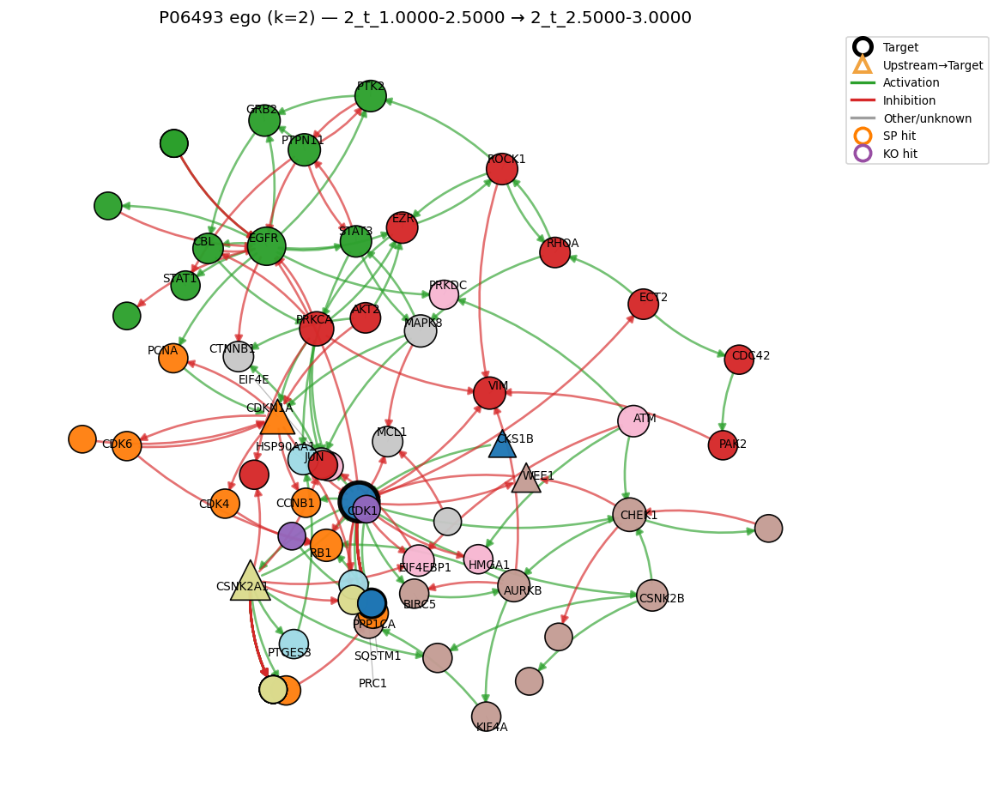

In [177]:
g0, g1 = "2_t_1.0000-2.5000", "2_t_2.5000-3.0000"
plot_transition_ego(g0, g1, top_sp=25, top_ko=25, k=2)

/tmp/ipykernel_270652/3631229065.py:93: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("tab20")


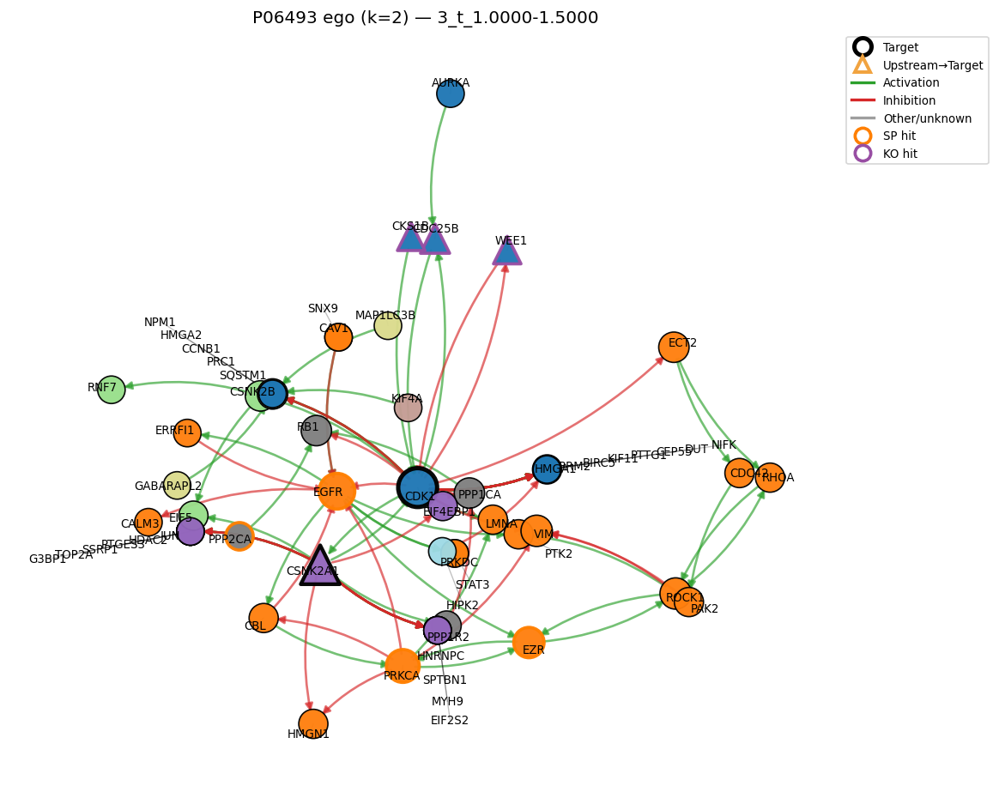

In [178]:
# pick the group & graph
grp = [g for g in TRAJ_3 if g in group_graphs][-6]
G   = group_graphs[grp]

# highlights (examples — adjust to what you computed)
# If you ran the “exact SP overlap” on the latest group:
sp_hits = set(ssp_exact.sort_values("overlap_pairs", ascending=False).head(12)["uniprot"])

# If you ran randomized KO with descendants≤2 across groups (per_gene_desc):
ko_hits = set(per_gene_desc.sort_values(["hit_rate_top1pct","mean_delta"], ascending=[False,False]).head(12)["gene"])

# draw
draw_target_ego(
    G,
    target_up=PRIMARY_TARGET,                 # "P06493" for CDK1
    highlight_uniprots={"sp": sp_hits, "ko": ko_hits},
    title=f"{PRIMARY_TARGET} ego (k=2) — {grp}",
    k=2
)


In [208]:
# ======================= CONFIG + HELPERS =====================================
# One place to control inputs & style for ego plots and per-transition overlays.
# -----------------------------------------------------------------------------

from typing import Dict, Optional, Set
import igraph as ig
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
from matplotlib.lines import Line2D

# --------- 1) CONFIG (edit these values) -------------------------------------
CONFIG = {
    "graphs": {
        "big": g,                    # igraph: full network
        "groups": group_graphs,      # dict[str, ig.Graph]
        "order": TRAJ_3,             # list[str] (pseudotime order)
    },
    "target": "P06493",              # UniProt for CDK1 (or replace with your target)
    "module_attr": "module",         # vertex attribute name with module labels (if present)
    "module_scope": "global",        # "global" -> color by modules from BIG graph; "local" -> compute in ego
    "ego": {
        # How to collect neighbors around the target
        # mode="ALL" uses a single radius k (undirected neighborhood in practice).
        # mode="custom" lets you set asymmetric IN/OUT hops below.
        "mode": "ALL",               # "ALL" | "custom"
        "k": 2,                      # radius when mode="ALL"
        "ego_in_hops": 2,            # used when mode="custom"
        "ego_out_hops": 2,           # used when mode="custom"

        # Upstream regulator marking (triangles): nodes within this many IN-hops to target
        "upstream_hops": 1,

        # Layout for the ego drawing
        "layout": "kk",              # "kk" | "spring" | "fr" | "spectral" | "circle"
        "fix_target_center": True,   # force target at (0,0)
        "layout_seed": 42,
    },
    "labels": {
        "mode": "important",         # "important" | "all" | "none"
        "max_labels": 45,
        "min_sep": 0.06,             # increase to spread labels more
        "leader_lines": True,
        "fontsize": 8,
        "title_fontsize": 12,
        "try_adjusttext": True,      # if adjustText is installed, use it
    },
    "evidence": {
        # Where to take KO hits from (per-transition helper)
        "use_randKO": False,         # False -> singleKO_tables; True -> randKO_tables["per_gene"]
        "top_sp": 12,                # how many SP gainers to highlight
        "top_ko": 12,                # how many KO hits to highlight

        # Evidence ring colors
        "sp_color":   "#ff7f00",     # orange (SP)
        "ko_color":   "#984ea3",     # purple (KO)
        "both_color": "#00bcd4",     # cyan (both) — brighter than black
        "ring_lw":    (2.2, 2.2, 2.6),  # (sp, ko, both) linewidths
        "target_lw":  3.0,           # CDK1 outline thickness
    }
}

# --------- 2) UTILITIES -------------------------------------------------------

def _nx_layout(H: nx.Graph, layout: str, seed: int = 42):
    layout = (layout or "kk").lower()
    if layout == "spring":
        return nx.spring_layout(H, seed=seed)
    if layout in ("fr", "fruchterman"):
        return nx.fruchterman_reingold_layout(H, seed=seed)
    if layout == "spectral":
        return nx.spectral_layout(H)
    if layout == "circle":
        return nx.circular_layout(H)
    # default KK
    return nx.kamada_kawai_layout(H)

def _sym_label_map(G: ig.Graph) -> Dict[str, str]:
    out = {}
    have_sym = "gene_symbol" in G.vs.attributes()
    for v in G.vs:
        sy = v["gene_symbol"] if have_sym else None
        out[v["name"]] = sy if (sy and len(sy)) else v["name"]
    return out

def _pick_edge_sign_attr(G: ig.Graph) -> Optional[str]:
    for cand in ("type", "sign", "effect", "interaction", "polarity"):
        if cand in G.es.attributes():
            return cand
    return None

def _parse_sign(val):
    if val is None: return None
    s = " ".join(val) if isinstance(val,(list,tuple,set)) else str(val)
    s = s.lower()
    act = any(k in s for k in ["activ","stimulat","pos","+","phospho+"])
    inh = any(k in s for k in ["inhib","repress","neg","-","block","phospho-"])
    if act and inh: return "both"
    if act: return "act"
    if inh: return "inh"
    return None

def _collect_ego_vids(G: ig.Graph, target: str, cfg_ego: dict) -> Set[int]:
    """Return set of vertex indices for the ego neighborhood per config."""
    if target not in G.vs["name"]: return set()
    t = G.vs.find(name=target).index
    vids = {t}
    mode = cfg_ego.get("mode","ALL").upper()
    if mode == "CUSTOM":
        # asymmetric IN/OUT hops
        k_in  = int(cfg_ego.get("ego_in_hops", 0))
        k_out = int(cfg_ego.get("ego_out_hops", 0))
        # IN
        frontier = {t}; seen = {t}
        for _ in range(max(0,k_in)):
            nxt=set()
            for v in frontier: nxt |= set(G.neighbors(v, mode="IN"))
            nxt -= seen
            vids |= nxt; seen |= nxt; frontier = nxt
            if not frontier: break
        # OUT
        frontier = {t}; seen = {t}
        for _ in range(max(0,k_out)):
            nxt=set()
            for v in frontier: nxt |= set(G.neighbors(v, mode="OUT"))
            nxt -= seen
            vids |= nxt; seen |= nxt; frontier = nxt
            if not frontier: break
    else:
        # ALL with radius k
        k = int(cfg_ego.get("k", 2))
        frontier = {t}; seen = {t}
        for _ in range(max(0,k)):
            nxt=set()
            for v in frontier: nxt |= set(G.neighbors(v, mode="ALL"))
            nxt -= seen
            vids |= nxt; seen |= nxt; frontier = nxt
            if not frontier: break
    return vids

def _upstream_set(G: ig.Graph, target: str, hops: int) -> Set[str]:
    if target not in G.vs["name"] or hops <= 0: return set()
    t = G.vs.find(name=target).index
    frontier = {t}; seen = {t}; reached=set()
    for _ in range(hops):
        nxt=set()
        for v in frontier: nxt |= set(G.neighbors(v, mode="IN"))
        nxt -= seen
        reached |= nxt; seen |= nxt; frontier = nxt
        if not frontier: break
    return set(G.vs[list(reached)]["name"])

def _module_map_for(G_ego: ig.Graph, cfg: dict) -> Dict[str, int]:
    scope = (cfg.get("module_scope") or "global").lower()
    attr  = cfg.get("module_attr") or "module"
    names = set(G_ego.vs["name"])
    if scope == "global":
        Gbig = CONFIG["graphs"]["big"]
        if attr in Gbig.vs.attributes():
            glob = dict(zip(Gbig.vs["name"], Gbig.vs[attr]))
            return {n: glob.get(n, -1) for n in names}
    # local fallback (existing attribute or compute community)
    if attr in G_ego.vs.attributes():
        return {v["name"]: v[attr] for v in G_ego.vs}
    part = G_ego.as_undirected().community_multilevel()
    return {n: m for n, m in zip(G_ego.vs["name"], part.membership)}

# --------- 3) EGO DRAWING (from CONFIG) --------------------------------------

def draw_target_ego_cfg(cfg: dict,
                        G: Optional[ig.Graph] = None,
                        sp_hits: Optional[Set[str]] = None,
                        ko_hits: Optional[Set[str]] = None,
                        title: Optional[str] = None,
                        bin_name: Optional[str] = None):
    """Draw target ego per CONFIG; pass sp_hits/ko_hits to override highlights."""
    # pick graph
    if G is None:
        grp = [x for x in cfg["graphs"]["order"] if x in cfg["graphs"]["groups"]][-1]
        G = cfg["graphs"]["groups"][grp]
    target = cfg.get("target", "P06493")

    if G.vcount()==0 or target not in G.vs["name"]:
        print("Nothing to draw (target not in graph)."); return

    # ego subgraph
    vids = sorted(list(_collect_ego_vids(G, target, cfg["ego"])))
    ego  = G.subgraph(ig.VertexSeq(G, vids))
    if ego.vcount()==0:
        print("Empty ego."); return

    # module map + labels
    mod_map  = _module_map_for(ego, cfg)
    sym_map  = _sym_label_map(ego)

    # upstream set (triangles)
    upstream = _upstream_set(ego, target, int(cfg["ego"].get("upstream_hops", 1)))

    # copy to NetworkX (keep edge sign)
    H = nx.DiGraph()
    for v in ego.vs:
        up = v["name"]
        H.add_node(up, label=sym_map.get(up, up), module=mod_map.get(up, -1))
    sign_attr = _pick_edge_sign_attr(ego)
    for e in ego.es:
        s,t = e.tuple
        et  = ego.es[e.index][sign_attr] if sign_attr else None
        H.add_edge(ego.vs[s]["name"], ego.vs[t]["name"], sign=et)

    # layout
    pos = _nx_layout(H, cfg["ego"].get("layout","kk"), seed=int(cfg["ego"].get("layout_seed",42)))
    if cfg["ego"].get("fix_target_center", True) and target in pos:
        pos[target] = (0.0, 0.0)

    # node fills by module
    #modules  = [H.nodes[n].get("module") for n in H.nodes()]
    #uniq_mod = sorted({m for m in modules if m is not None})
    #cmap     = get_cmap("tab20")
    #mod2col  = {m: cmap(i/max(1, len(uniq_mod)-1)) for i,m in enumerate(uniq_mod)}
    #facecols = [mod2col.get(H.nodes[n].get("module"), (0.85,0.85,0.85,1)) for n in H.nodes()]

    # colors by module (default)
    modules  = [H.nodes[n].get("module") for n in H.nodes()]
    uniq_mod = sorted({m for m in modules if m is not None})
    cmap_mod = get_cmap("tab20")
    mod2col  = {m: cmap_mod(i/max(1, len(uniq_mod)-1)) for i,m in enumerate(uniq_mod)}

    nc_mode = (cfg.get("node_color", {}).get("mode") or "module").lower()
    if nc_mode == "zscore" and bin_name is not None:
        facecols = _node_fill_colors_by_zscore(ego, H, cfg, bin_name)
    elif nc_mode == "flat":
        facecols = [(0.95,0.95,0.95,1.0) for _ in H.nodes()]
    else:  # "module"
        facecols = [mod2col.get(H.nodes[n].get("module"), (0.85,0.85,0.85,1)) for n in H.nodes()]

    # node sizes ~ sqrt(degree)
    deg_ud = H.to_undirected().degree()
    sizes = []
    for n in H.nodes():
        d = max(1, deg_ud[n])
        sz = 260 + 110 * (d ** 0.5)
        if n == target: sz = 740
        sizes.append(sz)

    # evidence rings
    sp_set = set(sp_hits or [])
    ko_set = set(ko_hits or [])
    sp_col, ko_col, both_col = cfg["evidence"]["sp_color"], cfg["evidence"]["ko_color"], cfg["evidence"]["both_color"]
    lw_sp, lw_ko, lw_both    = cfg["evidence"]["ring_lw"]
    edgecols=[]; lws=[]
    for n in H.nodes():
        in_sp = n in sp_set
        in_ko = n in ko_set
        if n == target:
            edgecols.append("black"); lws.append(float(cfg["evidence"]["target_lw"]))
        elif in_sp and in_ko:
            edgecols.append(both_col); lws.append(lw_both)
        elif in_sp:
            edgecols.append(sp_col);   lws.append(lw_sp)
        elif in_ko:
            edgecols.append(ko_col);   lws.append(lw_ko)
        else:
            edgecols.append("none");   lws.append(1.0)

    # shapes (triangles for upstream, no special outline color)
    shapes = ["^" if n in upstream else "o" for n in H.nodes()]

    # edges colored by sign
    e_act = [(u,v) for u,v,d in H.edges(data=True) if _parse_sign(d.get("sign")) == "act"]
    e_inh = [(u,v) for u,v,d in H.edges(data=True) if _parse_sign(d.get("sign")) == "inh"]
    e_mix = [(u,v) for u,v,d in H.edges(data=True) if _parse_sign(d.get("sign")) == "both"]
    e_oth = [(u,v) for u,v,d in H.edges(data=True) if _parse_sign(d.get("sign")) is None]

    # label plan
    lbl_cfg = cfg["labels"]
    label_mode   = (lbl_cfg.get("mode") or "important").lower()
    max_labels   = int(lbl_cfg.get("max_labels", 45))
    min_labelsep = float(lbl_cfg.get("min_sep", 0.06))
    leader_lines = bool(lbl_cfg.get("leader_lines", True))
    fontsize     = int(lbl_cfg.get("fontsize", 8))
    title_fs     = int(lbl_cfg.get("title_fontsize", 12))
    try_adjust    = bool(lbl_cfg.get("try_adjusttext", True))

    # importance scoring
    def _importance(n):
        score = 0.0
        if n == target: score += 100
        if n in upstream: score += 20
        if n in sp_set or n in ko_set: score += 15
        score += (deg_ud[n] ** 0.5)
        return score

    nodes_list = list(H.nodes())
    if label_mode == "none":
        label_nodes = []
    elif label_mode == "all":
        label_nodes = nodes_list
    else:
        label_nodes = sorted(nodes_list, key=_importance, reverse=True)[:max_labels]

    # offset label positions radially and push apart
    import random as _random
    _random.seed(int(cfg["ego"].get("layout_seed",42)))
    center = np.array(pos.get(target,(0.0,0.0)))
    def _unit(v): 
        nrm = np.linalg.norm(v) + 1e-9
        return v / nrm
    placed=[]; label_pos={}
    for n in label_nodes:
        p = np.array(pos[n])
        d = _unit(p - center)
        if not np.isfinite(d).all() or np.linalg.norm(d) < 1e-6:
            d = _unit(np.array([_random.uniform(-1,1), _random.uniform(-1,1)]))
        xy = p + (0.02 + _random.uniform(0.0, 0.01)) * d
        # repel from existing labels
        for _ in range(80):
            ok=True
            for (x0,y0) in placed:
                if np.linalg.norm(xy - np.array([x0,y0])) < min_labelsep:
                    xy = xy + 0.02 * d; ok=False; break
            if ok: break
        placed.append(tuple(xy)); label_pos[n] = (float(xy[0]), float(xy[1]))

    # ---------------- draw ----------------
    plt.figure(figsize=(9.8, 7.8))
    if e_act: nx.draw_networkx_edges(H, pos, edgelist=e_act, edge_color="#2ca02c",
                                     arrows=True, arrowsize=11, width=1.6, alpha=0.65,
                                     connectionstyle="arc3,rad=0.14")
    if e_inh: nx.draw_networkx_edges(H, pos, edgelist=e_inh, edge_color="#d62728",
                                     arrows=True, arrowsize=11, width=1.6, alpha=0.65,
                                     connectionstyle="arc3,rad=0.14")
    if e_mix: nx.draw_networkx_edges(H, pos, edgelist=e_mix, edge_color="#9467bd",
                                     arrows=True, arrowsize=11, width=1.6, alpha=0.65,
                                     connectionstyle="arc3,rad=0.14")
    if e_oth: nx.draw_networkx_edges(H, pos, edgelist=e_oth, edge_color="#9e9e9e",
                                     arrows=True, arrowsize=9, width=1.2, alpha=0.45,
                                     connectionstyle="arc3,rad=0.12")

    # nodes by shape (so upstream '^' pops)
    for shp in {"o","^"}:
        idx = [i for i,n in enumerate(nodes_list) if shapes[i]==shp]
        if not idx: continue
        nx.draw_networkx_nodes(
            H, pos,
            nodelist=[nodes_list[i] for i in idx],
            node_size=[sizes[i] for i in idx],
            node_color=[facecols[i] for i in idx],
            edgecolors=[edgecols[i] for i in idx],
            linewidths=[lws[i] for i in idx],
            node_shape=shp,
            alpha=0.96
        )

    # leader lines + labels
    ax = plt.gca()
    if leader_lines and label_nodes:
        for n in label_nodes:
            if n in label_pos:
                x0,y0 = pos[n]; x1,y1 = label_pos[n]
                ax.plot([x0,x1],[y0,y1], color=(0,0,0,0.25), lw=0.8, zorder=1)

    if label_nodes:
        texts=None
        if try_adjust:
            try:
                from adjustText import adjust_text
                texts=[]
                for n in label_nodes:
                    xy = label_pos.get(n, pos[n])
                    texts.append(ax.text(xy[0], xy[1], H.nodes[n].get("label", n),
                                         fontsize=fontsize, ha="center", va="center"))
                adjust_text(texts, ax=ax, only_move={'points':'y','texts':'xy'},
                            force_points=0.2, force_text=0.8)
            except Exception:
                pass
        if not texts:
            nx.draw_networkx_labels(H, label_pos,
                labels={n: H.nodes[n].get("label", n) for n in label_nodes},
                font_size=fontsize
            )

    # legend (no gold outlines; triangles denote upstream)
    leg = [
        Line2D([0],[0], marker='o', color='w', label='Target',
               markerfacecolor='w', markeredgecolor='black', markeredgewidth=cfg["evidence"]["target_lw"], markersize=12),
        Line2D([0],[0], marker='^', color='w', label='Upstream→Target',
               markerfacecolor='w', markeredgecolor='black', markeredgewidth=1.0, markersize=11),
        Line2D([0],[0], color="#2ca02c", lw=2, label='Activation'),
        Line2D([0],[0], color="#d62728", lw=2, label='Inhibition'),
        Line2D([0],[0], color="#9467bd", lw=2, label='Mixed'),
        Line2D([0],[0], color="#9e9e9e", lw=2, label='Unknown'),
        Line2D([0],[0], marker='o', color='w', label='SP hit',
               markerfacecolor='w', markeredgecolor=cfg["evidence"]["sp_color"],
               markeredgewidth=cfg["evidence"]["ring_lw"][0], markersize=11),
        Line2D([0],[0], marker='o', color='w', label='KO hit',
               markerfacecolor='w', markeredgecolor=cfg["evidence"]["ko_color"],
               markeredgewidth=cfg["evidence"]["ring_lw"][1], markersize=11),
        Line2D([0],[0], marker='o', color='w', label='Both',
               markerfacecolor='w', markeredgecolor=cfg["evidence"]["both_color"],
               markeredgewidth=cfg["evidence"]["ring_lw"][2], markersize=11),
    ]
    plt.legend(handles=leg, fontsize=8, loc="upper left", bbox_to_anchor=(1,1))
    ttl = title if title is not None else f"{target} ego (k={cfg['ego'].get('k',2)})"
    plt.title(ttl, fontsize=title_fs)
    plt.axis("off"); plt.tight_layout(); plt.show()


# --------- 4) PER-TRANSITION WRAPPER -----------------------------------------

def plot_transition_ego_cfg(cfg: dict, g0: str, g1: str):
    """Use sp_tables + KO tables to highlight hits on the AFTER graph g1."""
    G1 = cfg["graphs"]["groups"][g1]
    ev = cfg["evidence"]

    # SP gainers (Δ overlap > 0) for this transition
    if (g0, g1) in sp_tables and not sp_tables[(g0, g1)].empty:
        sp_hits = set(
            sp_tables[(g0, g1)]
            .sort_values("d_overlap_frac", ascending=False)
            .head(int(ev["top_sp"]))["uniprot"]
        )
    else:
        sp_hits = set()

    # KO hits for this transition
    if ev.get("use_randKO", False):
        if (g0, g1) in randKO_tables:
            per_gene = randKO_tables[(g0, g1)]["per_gene"]
            ko_hits = set(
                per_gene.sort_values(["hit_rate_top1pct","mean_delta"], ascending=[False,False])
                        .head(int(ev["top_ko"]))["gene"]
            )
        else:
            ko_hits = set()
    else:
        if (g0, g1) in singleKO_tables and not singleKO_tables[(g0, g1)].empty:
            ko_hits = set(
                singleKO_tables[(g0, g1)].sort_values("delta_bt")  # most negative first
                                  .head(int(ev["top_ko"]))["gene"]
            )
        else:
            ko_hits = set()

    draw_target_ego_cfg(
        cfg, G=G1, sp_hits=sp_hits, ko_hits=ko_hits,
        title=f"{cfg['target']} ego — {g0} → {g1}"
    )


In [209]:
# Choose bins
bins_to_plot = [
    "0_t_0.0000-0.5000",
    "1_t_3.0000-3.5000",
    "3_t_1.0000-1.5000",
    "2_t_3.5000-4.0000",
]
bins_to_plot = [b for b in bins_to_plot if b in CONFIG["graphs"]["groups"]]

# Global scale across these bins:
CONFIG["node_color"]["bins"] = bins_to_plot
CONFIG["node_color"]["mode"] = "zscore"
CONFIG["node_color"]["cmap"] = "coolwarm"
CONFIG["node_color"]["global_norm"] = True   # all panels share the same scale
CONFIG["node_color"]["absmax"] = None        # or set e.g. 3.0 to clamp at ±3

for b in bins_to_plot:
    Gbin = CONFIG["graphs"]["groups"][b]
    draw_target_ego_cfg(CONFIG, G=Gbin,
                        title=f"{CONFIG['target']} ego — {b} (z-score)",
                        bin_name=b)


KeyError: 'node_color'

#### Final

In [206]:
# ======================= CONFIG (extended) ====================================
from typing import Dict, Optional, Set
import igraph as ig
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
from collections import Counter

CONFIG = {
    "graphs": {
        "big": g,                    # igraph: full network
        "groups": group_graphs,      # dict[str, ig.Graph]
        "order": TRAJ_3,             # list[str] in pseudotime order
    },
    "target": "P06493",              # UniProt for CDK1 (or any target)
    "module_attr": "module",         # numeric module id on vertices
    "module_scope": "global",        # "global" (from big g) | "local" (compute in ego)
    "modules": {
        "name_attr": "module_name",  # where the human-friendly name lives
        "name_map": {},              # optional {module_id: "DNA repair"} to attach
    },
    "ego": {
        "mode": "custom",            # "ALL" | "custom"
        "k": 2,                      # used if mode="ALL"
        "ego_in_hops": 3,            # used if mode="custom"
        "ego_out_hops": 2,           # used if mode="custom"
        "upstream_hops": 3,          # triangles if within this many IN-hops
        "layout": "kk",              # "kk" | "spring" | "fr" | "spectral" | "circle"
        "fix_target_center": True,
        "layout_seed": 42,

        # NEW — extend node set beyond strict k/hops
        "extra_all_hops": 0,         # add this many undirected rings after ego build
        "grow_until_nodes": None,    # int or None: expand ring-by-ring until ≥ this size
        "include_highlights": True,  # always include SP/KO nodes if present in G
    },
    "labels": {
        "mode": "all",               # "important" | "all" | "none"
        "max_labels": 9999,
        "min_sep": 0.05,
        "leader_lines": True,
        "fontsize": 8,
        "title_fontsize": 12,
        "try_adjusttext": True,
    },
    "legend": {
        "show_module_legend": True,
        "modules_max": 14,           # show top-N modules (by size) in legend
        "show_counts": True,
    },
    "evidence": {
        "use_randKO": False,         # per-transition KO source
        "top_sp": 12,
        "top_ko": 12,
        # ring colors
        "sp_color":   "#ff7f00",
        "ko_color":   "#984ea3",
        "both_color": "#00bcd4",
        "ring_lw":    (2.2, 2.2, 2.6),
        "target_lw":  3.0,
    }
}

# ======================= HELPERS (updated) ====================================
def attach_module_names_from_map(G: ig.Graph, module_attr="module", name_attr="module_name", name_map: Dict[int,str]={}):
    """One-time helper: attach module names onto vertices using a provided id->name map."""
    if module_attr not in G.vs.attributes():
        return
    names = []
    for v in G.vs:
        mid = v[module_attr]
        label = name_map.get(mid, None)
        names.append(label)
    G.vs[name_attr] = names

def _nx_layout(H: nx.Graph, layout: str, seed: int = 42):
    layout = (layout or "kk").lower()
    if layout == "spring":
        return nx.spring_layout(H, seed=seed)
    if layout in ("fr", "fruchterman"):
        return nx.fruchterman_reingold_layout(H, seed=seed)
    if layout == "spectral":
        return nx.spectral_layout(H)
    if layout == "circle":
        return nx.circular_layout(H)
    return nx.kamada_kawai_layout(H)

def _sym_label_map(G: ig.Graph) -> Dict[str, str]:
    have_sym = "gene_symbol" in G.vs.attributes()
    out = {}
    for v in G.vs:
        sy = v["gene_symbol"] if have_sym else None
        out[v["name"]] = sy if (sy and len(sy)) else v["name"]
    return out

def _pick_edge_sign_attr(G: ig.Graph) -> Optional[str]:
    for cand in ("type", "sign", "effect", "interaction", "polarity"):
        if cand in G.es.attributes():
            return cand
    return None

def _parse_sign(val):
    if val is None: return None
    s = " ".join(val) if isinstance(val,(list,tuple,set)) else str(val)
    s = s.lower()
    act = any(k in s for k in ["activ","stimulat","pos","+","phospho+"])
    inh = any(k in s for k in ["inhib","repress","neg","-","block","phospho-"])
    if act and inh: return "both"
    if act: return "act"
    if inh: return "inh"
    return None

def _collect_ego_vids(G: ig.Graph, target: str, cfg_ego: dict) -> Set[int]:
    """Collect ego per config (custom IN/OUT or ALL), then extend per extra hops / grow_until."""
    if target not in G.vs["name"]: return set()
    t = G.vs.find(name=target).index
    vids = {t}
    mode = (cfg_ego.get("mode") or "ALL").upper()
    if mode == "CUSTOM":
        k_in  = int(cfg_ego.get("ego_in_hops", 0))
        k_out = int(cfg_ego.get("ego_out_hops", 0))
        # IN
        frontier = {t}; seen = {t}
        for _ in range(max(0,k_in)):
            nxt=set()
            for v in frontier: nxt |= set(G.neighbors(v, mode="IN"))
            nxt -= seen; vids |= nxt; seen |= nxt; frontier = nxt
            if not frontier: break
        # OUT
        frontier = {t}; seen = {t}
        for _ in range(max(0,k_out)):
            nxt=set()
            for v in frontier: nxt |= set(G.neighbors(v, mode="OUT"))
            nxt -= seen; vids |= nxt; seen |= nxt; frontier = nxt
            if not frontier: break
    else:
        k = int(cfg_ego.get("k", 2))
        frontier = {t}; seen = {t}
        for _ in range(max(0,k)):
            nxt=set()
            for v in frontier: nxt |= set(G.neighbors(v, mode="ALL"))
            nxt -= seen; vids |= nxt; seen |= nxt; frontier = nxt
            if not frontier: break

    # extra undirected rings
    extra = int(cfg_ego.get("extra_all_hops", 0))
    frontier = set(vids)
    for _ in range(max(0, extra)):
        nxt=set()
        for v in frontier: nxt |= set(G.neighbors(v, mode="ALL"))
        nxt -= vids
        if not nxt: break
        vids |= nxt
        frontier = nxt

    # grow until node budget
    target_n = cfg_ego.get("grow_until_nodes", None)
    if target_n is not None:
        target_n = int(target_n)
        if target_n > len(vids):
            frontier = set(vids)
            while len(vids) < target_n and frontier:
                nxt=set()
                for v in frontier: nxt |= set(G.neighbors(v, mode="ALL"))
                nxt -= vids
                if not nxt: break
                vids |= nxt
                frontier = nxt
    return vids

def _upstream_set(G: ig.Graph, target: str, hops: int) -> Set[str]:
    if target not in G.vs["name"] or hops <= 0: return set()
    t = G.vs.find(name=target).index
    frontier = {t}; seen = {t}; reached=set()
    for _ in range(hops):
        nxt=set()
        for v in frontier: nxt |= set(G.neighbors(v, mode="IN"))
        nxt -= seen; reached |= nxt; seen |= nxt; frontier = nxt
        if not frontier: break
    return set(G.vs[list(reached)]["name"])

def _module_map_for(ego: ig.Graph, cfg: dict) -> Dict[str, int]:
    scope = (cfg.get("module_scope") or "global").lower()
    attr  = cfg.get("module_attr") or "module"
    names = set(ego.vs["name"])
    if scope == "global":
        Gbig = CONFIG["graphs"]["big"]
        if attr in Gbig.vs.attributes():
            glob = dict(zip(Gbig.vs["name"], Gbig.vs[attr]))
            return {n: glob.get(n, -1) for n in names}
    if attr in ego.vs.attributes():
        return {v["name"]: v[attr] for v in ego.vs}
    part = ego.as_undirected().community_multilevel()
    return {n: m for n, m in zip(ego.vs["name"], part.membership)}

def _module_name_map_for(names: Set[str], cfg: dict) -> Dict[int, str]:
    """Return {module_id: module_name or fallback} for nodes in 'names' from BIG graph."""
    module_attr = cfg.get("module_attr","module")
    name_attr   = cfg.get("modules",{}).get("name_attr","module_name")
    big = CONFIG["graphs"]["big"]
    id_by_name = {v["name"]: v[module_attr] for v in big.vs if module_attr in big.vs.attributes()}
    nm_by_name = {v["name"]: v[name_attr]   for v in big.vs if name_attr   in big.vs.attributes()}
    m2label = {}
    for n in names:
        mid = id_by_name.get(n, None)
        if mid is None: continue
        label = nm_by_name.get(n, None)
        if (mid not in m2label) and label: m2label[mid] = label
    # overlay with user-provided map (takes precedence)
    user_map = cfg.get("modules",{}).get("name_map",{}) or {}
    for mid, nm in user_map.items():
        m2label[mid] = nm
    return m2label

# ======================= DRAW (updated) =======================================
def draw_target_ego_cfg(cfg: dict,
                        G: Optional[ig.Graph] = None,
                        sp_hits: Optional[Set[str]] = None,
                        ko_hits: Optional[Set[str]] = None,
                        title: Optional[str] = None,
                        new_modules: Optional[Set[int]] = None,
                        bin_name: Optional[str] = None):
    if G is None:
        grp = [x for x in cfg["graphs"]["order"] if x in cfg["graphs"]["groups"]][-1]
        G = cfg["graphs"]["groups"][grp]
    target = cfg.get("target", "P06493")
    if G.vcount()==0 or target not in G.vs["name"]:
        print("Nothing to draw (target not in graph)."); return

    # ego subgraph (with extensions)
    vids = sorted(list(_collect_ego_vids(G, target, cfg["ego"])))
    ego  = G.subgraph(ig.VertexSeq(G, vids))

    # ensure highlights are included if requested
    if cfg["ego"].get("include_highlights", True):
        add = set(sp_hits or set()) | set(ko_hits or set())
        if add:
            present = set(ego.vs["name"])
            to_add = [i for i,v in enumerate(G.vs) if v["name"] in add and v["name"] not in present]
            if to_add:
                vids2 = vids + to_add
                ego = G.subgraph(ig.VertexSeq(G, sorted(set(vids2))))

    mod_map  = _module_map_for(ego, cfg)
    sym_map  = _sym_label_map(ego)
    upstream = _upstream_set(ego, target, int(cfg["ego"].get("upstream_hops", 1)))

    # to networkx
    H = nx.DiGraph()
    for v in ego.vs:
        up = v["name"]
        H.add_node(up, label=sym_map.get(up, up), module=mod_map.get(up, -1))
    sign_attr = _pick_edge_sign_attr(ego)
    for e in ego.es:
        s,t = e.tuple
        et  = ego.es[e.index][sign_attr] if sign_attr else None
        H.add_edge(ego.vs[s]["name"], ego.vs[t]["name"], sign=et)

    # layout
    pos = _nx_layout(H, cfg["ego"].get("layout","kk"), seed=int(cfg["ego"].get("layout_seed",42)))
    if cfg["ego"].get("fix_target_center", True) and target in pos:
        pos[target] = (0.0, 0.0)

    # colors by module
    modules  = [H.nodes[n].get("module") for n in H.nodes()]
    uniq_mod = sorted({m for m in modules if m is not None})
    cmap     = get_cmap("tab20")
    mod2col  = {m: cmap(i/max(1, len(uniq_mod)-1)) for i,m in enumerate(uniq_mod)}
    facecols = [mod2col.get(H.nodes[n].get("module"), (0.85,0.85,0.85,1)) for n in H.nodes()]

    # size ~ sqrt(degree)
    deg_ud = H.to_undirected().degree()
    sizes=[]
    for n in H.nodes():
        d=max(1,deg_ud[n])
        sz = 260 + 110 * (d ** 0.5)
        if n == target: sz = 740
        sizes.append(sz)

    # evidence rings
    ev = cfg["evidence"]
    sp_set = set(sp_hits or [])
    ko_set = set(ko_hits or [])
    edgecols=[]; lws=[]
    for n in H.nodes():
        in_sp = n in sp_set; in_ko = n in ko_set
        if n == target: edgecols.append("black"); lws.append(float(ev["target_lw"]))
        elif in_sp and in_ko: edgecols.append(ev["both_color"]); lws.append(ev["ring_lw"][2])
        elif in_sp:           edgecols.append(ev["sp_color"]);   lws.append(ev["ring_lw"][0])
        elif in_ko:           edgecols.append(ev["ko_color"]);   lws.append(ev["ring_lw"][1])
        else:                 edgecols.append("none");            lws.append(1.0)

    # shapes (triangles for upstream)
    shapes = ["^" if n in upstream else "o" for n in H.nodes()]

    # edge colors
    e_act = [(u,v) for u,v,d in H.edges(data=True) if _parse_sign(d.get("sign")) == "act"]
    e_inh = [(u,v) for u,v,d in H.edges(data=True) if _parse_sign(d.get("sign")) == "inh"]
    e_mix = [(u,v) for u,v,d in H.edges(data=True) if _parse_sign(d.get("sign")) == "both"]
    e_oth = [(u,v) for u,v,d in H.edges(data=True) if _parse_sign(d.get("sign")) is None]

    # label plan
    lbl_cfg = cfg["labels"]
    label_mode   = (lbl_cfg.get("mode") or "important").lower()
    max_labels   = int(lbl_cfg.get("max_labels", 45))
    min_labelsep = float(lbl_cfg.get("min_sep", 0.06))
    leader_lines = bool(lbl_cfg.get("leader_lines", True))
    fontsize     = int(lbl_cfg.get("fontsize", 8))
    title_fs     = int(lbl_cfg.get("title_fontsize", 12))
    try_adjust    = bool(lbl_cfg.get("try_adjusttext", True))

    def _importance(n):
        score = 0.0
        if n == target: score += 100
        if n in upstream: score += 20
        if n in sp_set or n in ko_set: score += 15
        score += (deg_ud[n] ** 0.5)
        return score

    nodes_list = list(H.nodes())
    if label_mode == "none":
        label_nodes = []
    elif label_mode == "all":
        label_nodes = nodes_list
    else:
        label_nodes = sorted(nodes_list, key=_importance, reverse=True)[:max_labels]

    # offset label positions
    import random as _random
    _random.seed(int(cfg["ego"].get("layout_seed",42)))
    center = np.array(pos.get(target,(0.0,0.0)))
    def _unit(v):
        nrm = np.linalg.norm(v) + 1e-9
        return v / nrm
    placed=[]; label_pos={}
    for n in label_nodes:
        p = np.array(pos[n])
        d = _unit(p - center)
        if not np.isfinite(d).all() or np.linalg.norm(d)<1e-6:
            d = _unit(np.array([_random.uniform(-1,1), _random.uniform(-1,1)]))
        xy = p + (0.02 + _random.uniform(0.0,0.01))*d
        for _ in range(80):
            ok=True
            for (x0,y0) in placed:
                if np.linalg.norm(xy - np.array([x0,y0])) < min_labelsep:
                    xy = xy + 0.02*d; ok=False; break
            if ok: break
        placed.append(tuple(xy)); label_pos[n]=(float(xy[0]), float(xy[1]))

    # draw
    plt.figure(figsize=(10.2, 7.9))
    if e_act: nx.draw_networkx_edges(H, pos, edgelist=e_act, edge_color="#2ca02c",
                                     arrows=True, arrowsize=11, width=1.6, alpha=0.65,
                                     connectionstyle="arc3,rad=0.14")
    if e_inh: nx.draw_networkx_edges(H, pos, edgelist=e_inh, edge_color="#d62728",
                                     arrows=True, arrowsize=11, width=1.6, alpha=0.65,
                                     connectionstyle="arc3,rad=0.14")
    if e_mix: nx.draw_networkx_edges(H, pos, edgelist=e_mix, edge_color="#9467bd",
                                     arrows=True, arrowsize=11, width=1.6, alpha=0.65,
                                     connectionstyle="arc3,rad=0.14")
    if e_oth: nx.draw_networkx_edges(H, pos, edgelist=e_oth, edge_color="#9e9e9e",
                                     arrows=True, arrowsize=9, width=1.2, alpha=0.45,
                                     connectionstyle="arc3,rad=0.12")

    # nodes by shape
    for shp in {"o","^"}:
        idx = [i for i,n in enumerate(nodes_list) if shapes[i]==shp]
        if not idx: continue
        nx.draw_networkx_nodes(
            H, pos,
            nodelist=[nodes_list[i] for i in idx],
            node_size=[sizes[i] for i in idx],
            node_color=[facecols[i] for i in idx],
            edgecolors=[edgecols[i] for i in idx],
            linewidths=[lws[i] for i in idx],
            node_shape=shp,
            alpha=0.96
        )

    # leader lines + labels
    ax = plt.gca()
    if leader_lines and label_nodes:
        for n in label_nodes:
            if n in label_pos:
                x0,y0 = pos[n]; x1,y1 = label_pos[n]
                ax.plot([x0,x1],[y0,y1], color=(0,0,0,0.25), lw=0.8, zorder=1)
    if label_nodes:
        texts=None
        if try_adjust:
            try:
                from adjustText import adjust_text
                texts=[]
                for n in label_nodes:
                    xy = label_pos.get(n, pos[n])
                    texts.append(ax.text(xy[0], xy[1], H.nodes[n].get("label", n),
                                         fontsize=fontsize, ha="center", va="center"))
                adjust_text(texts, ax=ax, only_move={'points':'y','texts':'xy'},
                            force_points=0.2, force_text=0.8)
            except Exception:
                pass
        if not texts:
            nx.draw_networkx_labels(H, label_pos,
                labels={n: H.nodes[n].get("label", n) for n in label_nodes},
                font_size=fontsize
            )

    # legends: evidence + modules
    ev_leg = [
        Line2D([0],[0], marker='o', color='w', label='Target',
               markerfacecolor='w', markeredgecolor='black',
               markeredgewidth=cfg["evidence"]["target_lw"], markersize=12),
        Line2D([0],[0], marker='^', color='w', label='Upstream→Target',
               markerfacecolor='w', markeredgecolor='black', markeredgewidth=1.0, markersize=11),
        Line2D([0],[0], color="#2ca02c", lw=2, label='Activation'),
        Line2D([0],[0], color="#d62728", lw=2, label='Inhibition'),
        Line2D([0],[0], color="#9467bd", lw=2, label='Mixed'),
        Line2D([0],[0], color="#9e9e9e", lw=2, label='Unknown'),
        Line2D([0],[0], marker='o', color='w', label='SP hit',
               markerfacecolor='w', markeredgecolor=ev["sp_color"],
               markeredgewidth=ev["ring_lw"][0], markersize=11),
        Line2D([0],[0], marker='o', color='w', label='KO hit',
               markerfacecolor='w', markeredgecolor=ev["ko_color"],
               markeredgewidth=ev["ring_lw"][1], markersize=11),
        Line2D([0],[0], marker='o', color='w', label='Both',
               markerfacecolor='w', markeredgecolor=ev["both_color"],
               markeredgewidth=ev["ring_lw"][2], markersize=11),
    ]
    leg1 = plt.legend(handles=ev_leg, fontsize=8, loc="upper left", bbox_to_anchor=(1,1))
    ax.add_artist(leg1)

    if cfg["legend"].get("show_module_legend", True):
        # build module legend (top-N by size)
        mod_counts = Counter([H.nodes[n].get("module") for n in H.nodes()])
        # drop -1/None
        if -1 in mod_counts: del mod_counts[-1]
        modules_sorted = [m for m,_ in mod_counts.most_common(cfg["legend"].get("modules_max", 14))]
        # map id -> name
        present_names = set(H.nodes[n]["label"] for n in H.nodes())
        id2name = _module_name_map_for(set(H.nodes()), cfg)
        name_attr = cfg.get("modules",{}).get("name_attr","module_name")
        # prefer global name; else first seen; else fallback "Module {id}"
        patches=[]
        for m in modules_sorted:
            col = mod2col.get(m, (0.85,0.85,0.85,1))
            nm  = id2name.get(m, None)
            label = f"M{m}: {nm}" if nm else f"Module {m}"
            if cfg["legend"].get("show_counts", True):
                label += f" ({mod_counts[m]})"
            # mark newly connected modules with a star
            if new_modules and (m in new_modules):
                label += " ★"
            patches.append(Patch(facecolor=col, edgecolor='none', label=label))
        if patches:
            plt.legend(handles=patches, fontsize=8, loc="upper left", bbox_to_anchor=(1,0.45),
                       title="Modules in ego", frameon=False)

    ttl = title if title is not None else f"{target} ego"
    plt.title(ttl, fontsize=title_fs)
    plt.axis("off"); plt.tight_layout(); plt.show()

# ======================= TRANSITION WRAPPER (updated) =========================
def plot_transition_ego_cfg(cfg: dict, g0: str, g1: str):
    """Highlight SP gainers & KO hits on AFTER graph; mark NEW modules (g1 \ g0) with ★."""
    Gs = cfg["graphs"]["groups"]
    G0, G1 = Gs[g0], Gs[g1]
    ev = cfg["evidence"]

    # SP gainers
    if (g0, g1) in sp_tables and not sp_tables[(g0, g1)].empty:
        sp_hits = set(
            sp_tables[(g0, g1)]
            .sort_values("d_overlap_frac", ascending=False)
            .head(int(ev["top_sp"]))["uniprot"]
        )
    else:
        sp_hits = set()

    # KO hits
    if ev.get("use_randKO", False) and (g0, g1) in randKO_tables:
        per_gene = randKO_tables[(g0, g1)]["per_gene"]
        ko_hits = set(
            per_gene.sort_values(["hit_rate_top1pct","mean_delta"], ascending=[False,False])
                    .head(int(ev["top_ko"]))["gene"]
        )
    elif (g0, g1) in singleKO_tables and not singleKO_tables[(g0, g1)].empty:
        ko_hits = set(singleKO_tables[(g0, g1)].sort_values("delta_bt").head(int(ev["top_ko"]))["gene"])
    else:
        ko_hits = set()

    # Compute NEW modules (present in g1 ego but not g0 ego)
    def _ego_modules(G):
        vids = sorted(list(_collect_ego_vids(G, cfg["target"], cfg["ego"])))
        ego  = G.subgraph(ig.VertexSeq(G, vids))
        mod_map = _module_map_for(ego, cfg)
        return set(mod_map.values()) - {-1, None}
    mods0 = _ego_modules(G0)
    mods1 = _ego_modules(G1)
    new_mods = mods1 - mods0

    draw_target_ego_cfg(
        cfg, G=G1, sp_hits=sp_hits, ko_hits=ko_hits,
        title=f"{cfg['target']} ego — {g0} → {g1}",
        new_modules=new_mods
    )


In [192]:
# Soft expansion, keeps layout readable:
CONFIG["ego"]["extra_all_hops"] = 1          # add one undirected ring
CONFIG["ego"]["grow_until_nodes"] = 350      # or: expand until ≥ 350 nodes if possible
CONFIG["ego"]["include_highlights"] = True   # make sure top SP/KO are inside


In [193]:
CONFIG["modules"]["name_map"] = {7: "DNA repair", 12: "TGF-β signaling"}  # etc.
attach_module_names_from_map(CONFIG["graphs"]["big"],
                             module_attr=CONFIG["module_attr"],
                             name_attr=CONFIG["modules"]["name_attr"],
                             name_map=CONFIG["modules"]["name_map"])


/tmp/ipykernel_270652/3403274623.py:269: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap     = get_cmap("tab20")


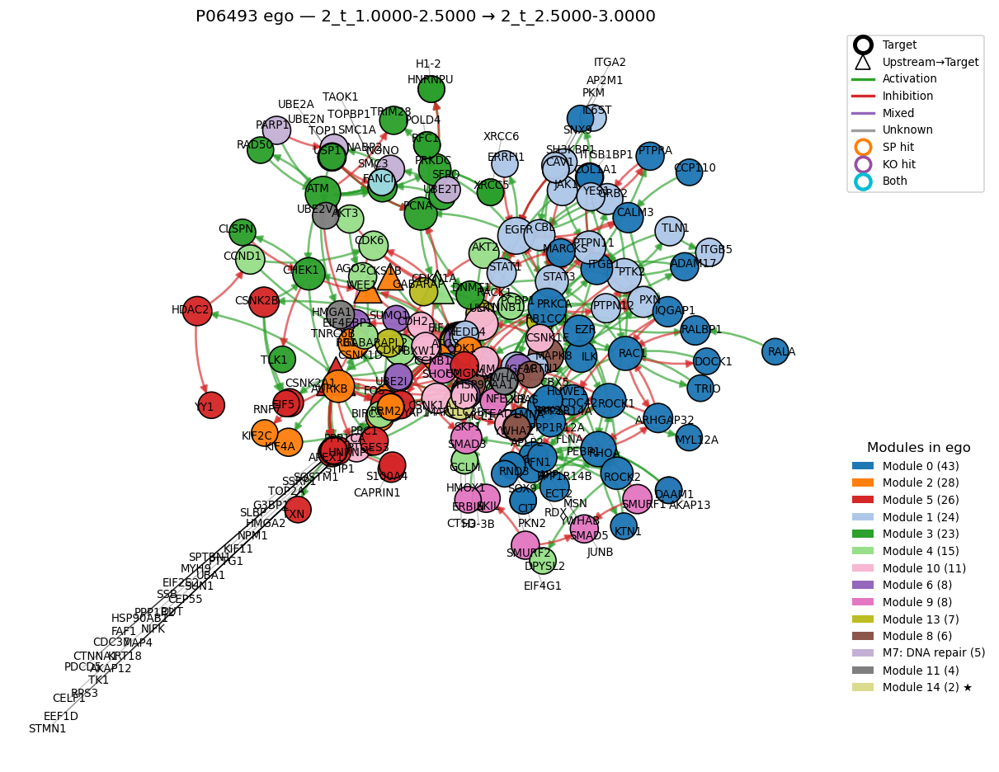

In [194]:
CONFIG["module_scope"] = "global"         # color by modules from BIG graph g
CONFIG["ego"]["mode"] = "custom"          # asymmetric neighborhood
CONFIG["ego"]["ego_in_hops"]  = 2         # upstream
CONFIG["ego"]["ego_out_hops"] = 1         # downstream
CONFIG["ego"]["upstream_hops"] = 1        # triangles within 1-hop IN
CONFIG["ego"]["layout"] = "kk"            # fixed layout family
CONFIG["labels"]["mode"] = "all"
CONFIG["labels"]["max_labels"] = 9999
CONFIG["labels"]["min_sep"] = 0.05

# pick a transition:
g0, g1 = "2_t_1.0000-2.5000", "2_t_2.5000-3.0000"
plot_transition_ego_cfg(CONFIG, g0, g1)


/tmp/ipykernel_270652/3403274623.py:269: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap     = get_cmap("tab20")


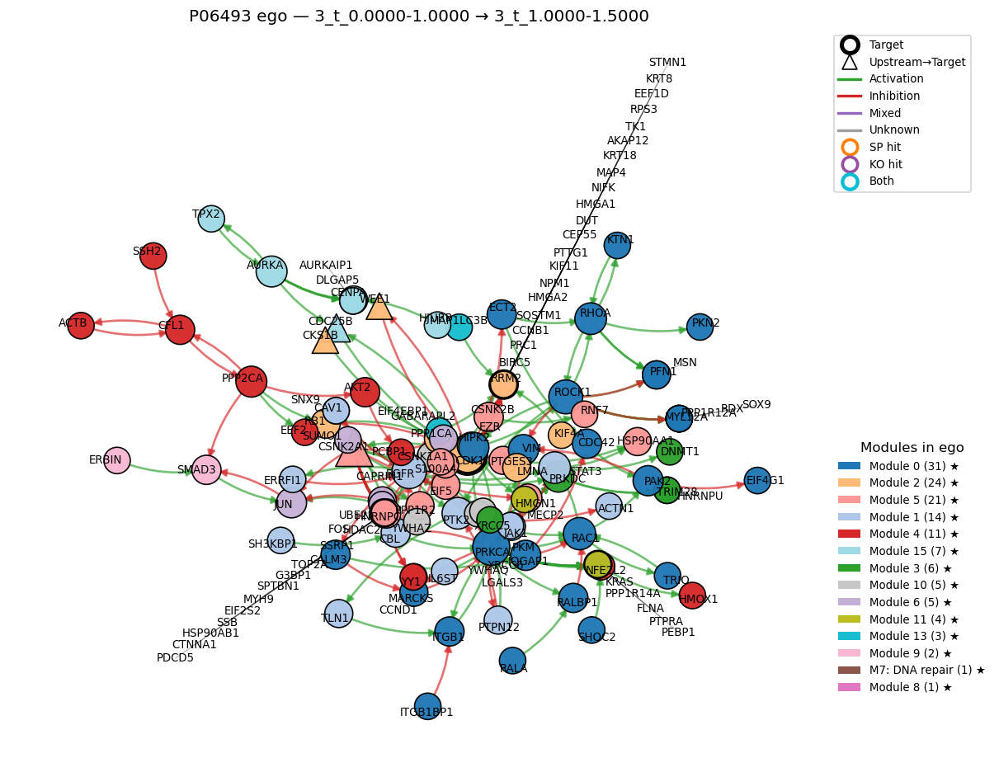

In [195]:
CONFIG["module_scope"] = "global"         # color by modules from BIG graph g
CONFIG["ego"]["mode"] = "custom"          # asymmetric neighborhood
CONFIG["ego"]["ego_in_hops"]  = 2         # upstream
CONFIG["ego"]["ego_out_hops"] = 1         # downstream
CONFIG["ego"]["upstream_hops"] = 1        # triangles within 1-hop IN
CONFIG["ego"]["layout"] = "kk"            # fixed layout family
CONFIG["labels"]["mode"] = "all"
CONFIG["labels"]["max_labels"] = 9999
CONFIG["labels"]["min_sep"] = 0.05

# pick a transition:
g0, g1 = "3_t_0.0000-1.0000", "3_t_1.0000-1.5000"
plot_transition_ego_cfg(CONFIG, g0, g1)


#### Calmer graph for quick inspection

/tmp/ipykernel_270652/3403274623.py:269: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap     = get_cmap("tab20")


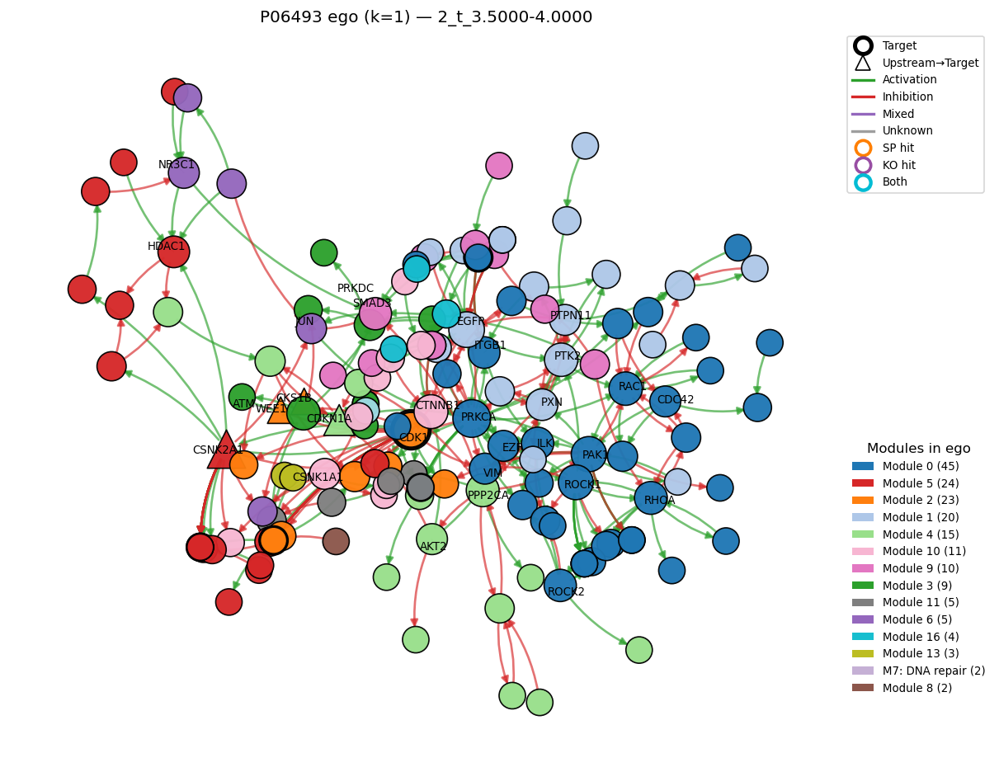

In [185]:
# tighter ego, fewer labels & hits
CONFIG["ego"]["mode"] = "ALL"
CONFIG["ego"]["k"] = 1
CONFIG["labels"]["mode"] = "important"
CONFIG["labels"]["max_labels"] = 30
CONFIG["labels"]["min_sep"]   = 0.06
CONFIG["evidence"]["top_sp"]  = 10
CONFIG["evidence"]["top_ko"]  = 10

# draw latest group:
latest = [x for x in CONFIG["graphs"]["order"] if x in CONFIG["graphs"]["groups"]][-1]
draw_target_ego_cfg(CONFIG, G=CONFIG["graphs"]["groups"][latest],
                    title=f"{CONFIG['target']} ego (k=1) — {latest}")


#### Full(er) view with asymmetric hops and fixed global module colors

In [186]:
TRAJ_3

['0_t_0.0000-0.5000',
 '3_t_0.0000-1.0000',
 '3_t_1.0000-1.5000',
 '3_t_1.5000-2.5000',
 '2_t_1.0000-2.5000',
 '2_t_2.5000-3.0000',
 '2_t_3.0000-3.5000',
 '2_t_3.5000-4.0000']

/tmp/ipykernel_270652/3403274623.py:269: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap     = get_cmap("tab20")


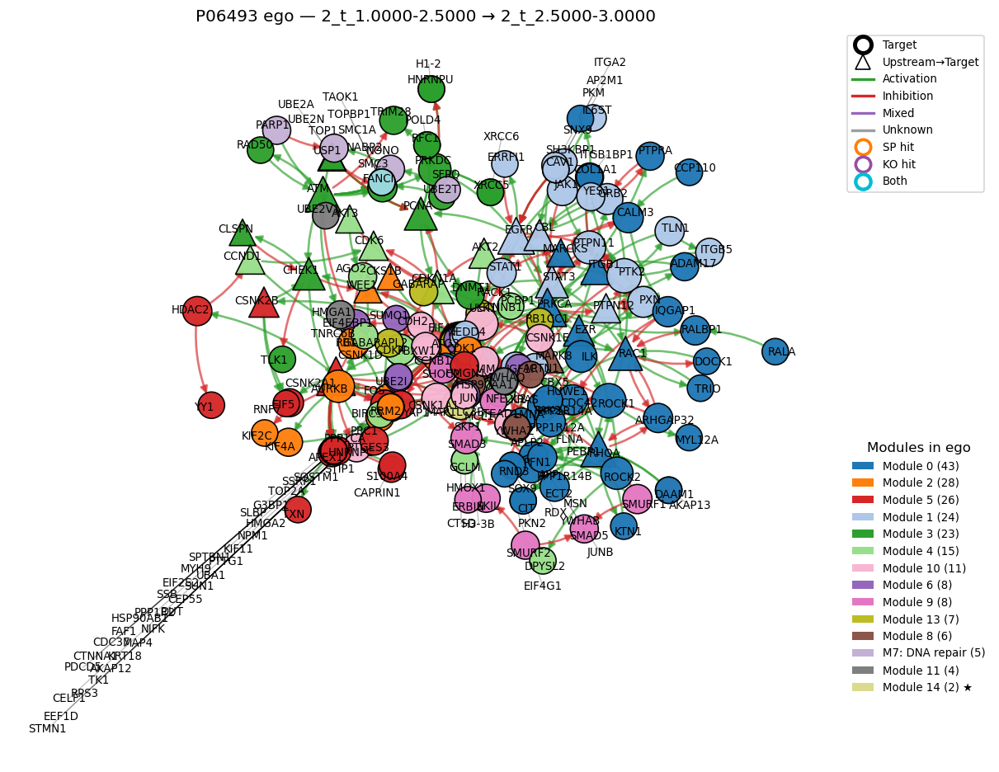

In [187]:
CONFIG["module_scope"] = "global"         # color by modules from BIG graph g
CONFIG["ego"]["mode"] = "custom"          # asymmetric neighborhood
CONFIG["ego"]["ego_in_hops"]  = 3         # upstream
CONFIG["ego"]["ego_out_hops"] = 2         # downstream
CONFIG["ego"]["upstream_hops"] = 3        # triangles within 1-hop IN
CONFIG["ego"]["layout"] = "kk"            # fixed layout family
CONFIG["labels"]["mode"] = "all"
CONFIG["labels"]["max_labels"] = 9999
CONFIG["labels"]["min_sep"] = 0.05

# pick a transition:
g0, g1 = "2_t_1.0000-2.5000", "2_t_2.5000-3.0000"
plot_transition_ego_cfg(CONFIG, g0, g1)


In [188]:
TRAJ_3

['0_t_0.0000-0.5000',
 '3_t_0.0000-1.0000',
 '3_t_1.0000-1.5000',
 '3_t_1.5000-2.5000',
 '2_t_1.0000-2.5000',
 '2_t_2.5000-3.0000',
 '2_t_3.0000-3.5000',
 '2_t_3.5000-4.0000']

/tmp/ipykernel_270652/3403274623.py:269: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap     = get_cmap("tab20")


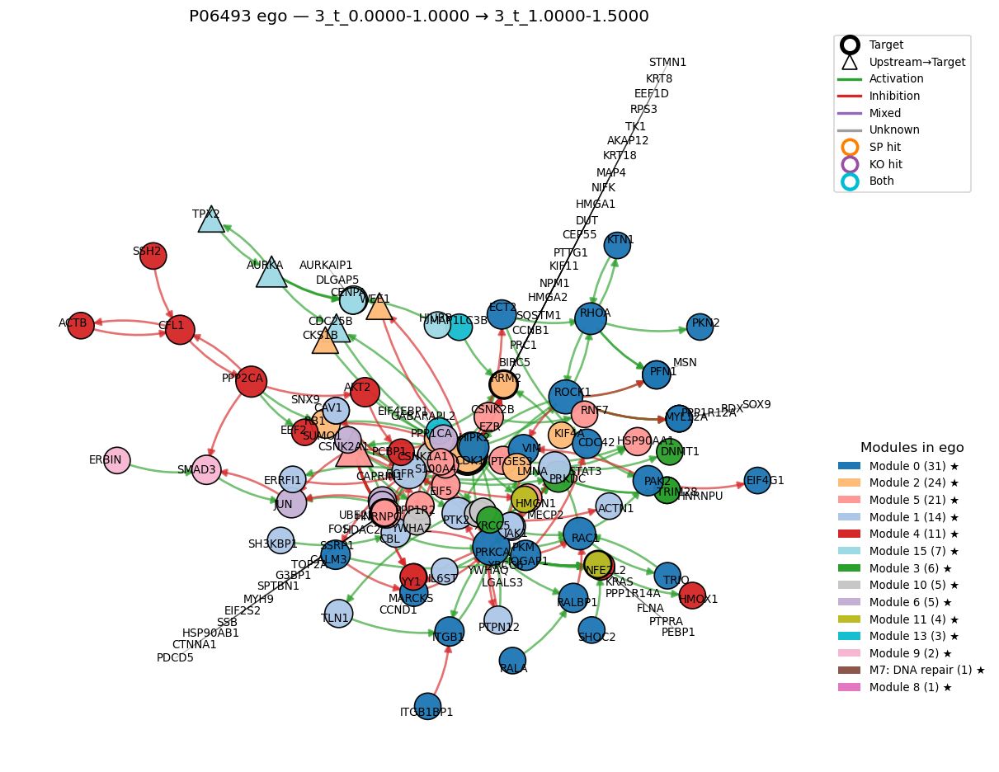

In [189]:
CONFIG["module_scope"] = "global"         # color by modules from BIG graph g
CONFIG["ego"]["mode"] = "custom"          # asymmetric neighborhood
CONFIG["ego"]["ego_in_hops"]  = 3         # upstream
CONFIG["ego"]["ego_out_hops"] = 2         # downstream
CONFIG["ego"]["upstream_hops"] = 3        # triangles within 1-hop IN
CONFIG["ego"]["layout"] = "kk"            # fixed layout family
CONFIG["labels"]["mode"] = "all"
CONFIG["labels"]["max_labels"] = 9999
CONFIG["labels"]["min_sep"] = 0.05

# pick a transition:
g0, g1 = "3_t_0.0000-1.0000", "3_t_1.0000-1.5000"
plot_transition_ego_cfg(CONFIG, g0, g1)


#### More final

In [196]:
# pip install gprofiler-official
from gprofiler import GProfiler

def go_names_for_modules(Gbig, module_attr="module", symbol_attr="gene_symbol",
                         organism="hsapiens", top_per_module=1):
    gp = GProfiler(return_dataframe=True)
    # collect module -> gene list
    mod2genes = {}
    for v in Gbig.vs:
        if module_attr in Gbig.vs.attributes() and symbol_attr in Gbig.vs.attributes():
            mid = v[module_attr]; gs = v[symbol_attr]
            if mid is None or gs in (None, ""): continue
            mod2genes.setdefault(mid, []).append(gs)

    # batch profile (one query per module)
    results = []
    for mid, genes in mod2genes.items():
        if len(genes) < 3:  # skip tiny modules
            continue
        df = gp.profile(organism=organism, query=genes, sources=["GO:BP"])
        if df is None or df.empty: 
            continue
        df = df.sort_values("p_value").head(top_per_module)
        if not df.empty:
            row = df.iloc[0]
            name = f"{row['name']} (GO:{row['native']}), q={row['p_value']:.2e}"
            results.append((mid, name))

    return dict(results)

# attach to big graph
name_map = go_names_for_modules(g, module_attr="module", symbol_attr="gene_symbol")
attach_module_names_from_map(g, module_attr="module",
                             name_attr=CONFIG["modules"]["name_attr"], name_map=name_map)


In [197]:
import networkx as nx

def make_union_reference(CONFIG, groups):
    Gs = CONFIG["graphs"]["groups"]
    target = CONFIG["target"]

    union_nodes = set()
    union_edges = set()
    for grp in groups:
        G = Gs[grp]
        vids = _collect_ego_vids(G, target, CONFIG["ego"])
        names = set(G.vs[vids]["name"])
        union_nodes |= names
        # keep only edges inside the ego for that group
        eattr = G.es.attributes()
        has_type = "type" in eattr
        for e in G.es:
            s = G.vs[e.source]["name"]; t = G.vs[e.target]["name"]
            if s in names and t in names:
                et = e["type"] if has_type else None
                union_edges.add((s, t, et))

    # Build reference graph for layout & grey “background”
    H_ref = nx.DiGraph()
    # node labels from big graph (prefer gene_symbol)
    big = CONFIG["graphs"]["big"]
    sym_map = {v["name"]: v["gene_symbol"] if "gene_symbol" in big.vs.attributes() else v["name"]
               for v in big.vs}
    for n in union_nodes:
        H_ref.add_node(n, label=sym_map.get(n, n))
    for s, t, et in union_edges:
        H_ref.add_edge(s, t, type=et)

    # Single, fixed layout used for all panels
    pos = _nx_layout(H_ref, CONFIG["ego"]["layout"], seed=int(CONFIG["ego"]["layout_seed"]))
    if CONFIG["ego"].get("fix_target_center", True) and CONFIG["target"] in pos:
        pos[CONFIG["target"]] = (0.0, 0.0)
    return H_ref, pos


In [200]:
def draw_on_reference(CONFIG, H_ref, pos, group, outpath=None,
                      alpha_bg=0.15, node_size_bg=120):
    G = CONFIG["graphs"]["groups"][group]

    # --- present set must match union logic ---
    vids = _collect_ego_vids(G, CONFIG["target"], CONFIG["ego"])
    present_nodes = set(G.vs[vids]["name"])
    ref_nodes = set(H_ref.nodes())
    if missing := (present_nodes - ref_nodes):
        # This can happen if you changed CONFIG after building H_ref
        print(f"⚠️ {len(missing)} nodes are present in {group} ego but not in reference; "
              f"first few: {sorted(list(missing))[:5]}")
    present_nodes &= ref_nodes  # keep only nodes that have positions

    # restrict edges to present nodes
    present_edges = {
        (G.vs[e.source]["name"], G.vs[e.target]["name"])
        for e in G.es
        if (G.vs[e.source]["name"] in present_nodes and G.vs[e.target]["name"] in present_nodes)
    }

    # ---- background (union, faint) ----
    import networkx as nx
    nx.draw_networkx_edges(H_ref, pos, edge_color="#9e9e9e", width=1.0, alpha=alpha_bg, arrows=False)
    nx.draw_networkx_nodes(H_ref, pos, nodelist=list(H_ref.nodes()),
                           node_size=node_size_bg, node_color="#efefef",
                           edgecolors="#cfcfcf", linewidths=0.5, alpha=alpha_bg)

    # ---- overlay by type, only edges present in this group ----
    e_act = [(u,v) for (u,v,d) in H_ref.edges(data=True)
             if (u,v) in present_edges and str(d.get("type","")).lower().startswith("activ")]
    e_inh = [(u,v) for (u,v,d) in H_ref.edges(data=True)
             if (u,v) in present_edges and "inhib" in str(d.get("type","")).lower()]
    e_oth = [(u,v) for (u,v,d) in H_ref.edges(data=True)
             if (u,v) in present_edges and d.get("type") not in (None, "") and
                (not str(d.get("type","")).lower().startswith(("activ","inhib")))]

    if e_act: nx.draw_networkx_edges(H_ref, pos, edgelist=e_act, edge_color="#2ca02c",
                                     arrows=True, arrowsize=10, width=1.8, alpha=0.8)
    if e_inh: nx.draw_networkx_edges(H_ref, pos, edgelist=e_inh, edge_color="#d62728",
                                     arrows=True, arrowsize=10, width=1.8, alpha=0.8)
    if e_oth: nx.draw_networkx_edges(H_ref, pos, edgelist=e_oth, edge_color="#7a7a7a",
                                     arrows=True, arrowsize=10, width=1.6, alpha=0.7, style="dashed")

    # present nodes overlay
    nx.draw_networkx_nodes(H_ref, pos, nodelist=list(present_nodes),
                           node_size=260, node_color="#ffffff",
                           edgecolors="#444444", linewidths=1.2, alpha=0.95)

    labels = {n: H_ref.nodes[n].get("label", n) for n in H_ref.nodes()}
    nx.draw_networkx_labels(H_ref, pos, labels=labels, font_size=8)

    import matplotlib.pyplot as plt, os
    plt.title(f"{CONFIG['target']} union-ego — {group}", fontsize=12)
    plt.axis("off"); plt.tight_layout()
    if outpath:
        os.makedirs(os.path.dirname(outpath), exist_ok=True)
        plt.savefig(outpath, dpi=200, bbox_inches="tight"); plt.close()
    else:
        plt.show()


In [201]:
PLOTS_OUT = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/ego_small_multiples"

# Choose your (possibly expanded) order
ORDER = [
 '0_t_0.0000-0.5000','1_t_0.5000-1.5000','1_t_1.5000-2.5000','1_t_2.5000-3.0000','1_t_3.0000-3.5000',
 '2_t_1.0000-2.5000','2_t_2.5000-3.0000','2_t_3.0000-3.500','2_t_3.5000-4.0000',
 '3_t_0.0000-1.0000','3_t_1.0000-1.5000','3_t_1.5000-2.5000'
]
ORDER = [g for g in ORDER if g in CONFIG["graphs"]["groups"]]

H_ref, pos = make_union_reference(CONFIG, ORDER)

# One big PDF or separate PNGs
for grp in ORDER:
    out = f"{PLOTS_OUT}/{CONFIG['target']}/{grp}.png"
    draw_on_reference(CONFIG, H_ref, pos, grp, outpath=out)
print(f"Saved union-ego panels under {PLOTS_OUT}/{CONFIG['target']}")


Saved union-ego panels under /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/ego_small_multiples/P06493


#### Using zscore

In [220]:
# All column names as a Python list
cols = zscore_df.columns.tolist()
print(f"{len(cols)} columns:\n", cols)


12 columns:
 ['0_t_0.0000-0.5000', '1_t_0.5000-1.5000', '1_t_1.5000-2.5000', '1_t_2.5000-3.0000', '1_t_3.0000-3.5000', '2_t_1.0000-2.5000', '2_t_2.5000-3.0000', '2_t_3.0000-3.5000', '2_t_3.5000-4.0000', '3_t_0.0000-1.0000', '3_t_1.0000-1.5000', '3_t_1.5000-2.5000']


/tmp/ipykernel_270652/1164105566.py:92: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap(CMAP_NAME)


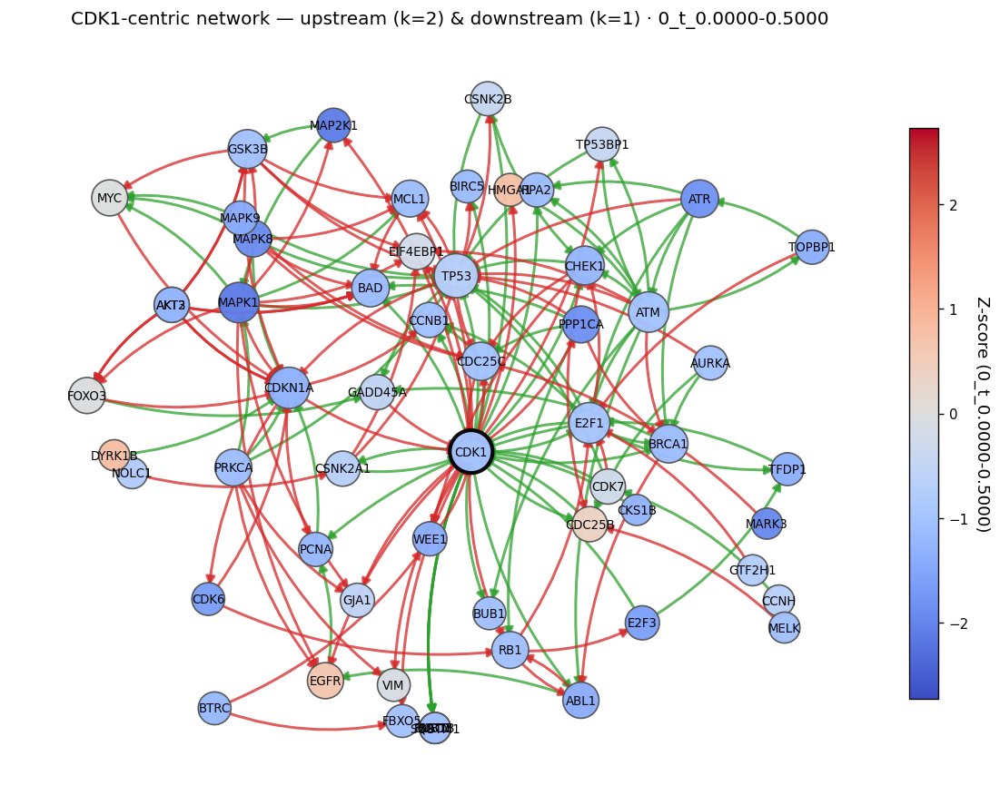

In [221]:
# ================== CDK1-centric z-score plot (compact) ==================
import igraph as ig
import networkx as nx
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import get_cmap

# ----------- CONFIG (edit these) -----------
TARGET_UP = "P06493"              # CDK1 UniProt
BIN       = "0_t_0.0000-0.5000"   # one of your z-score columns / group names
K_IN      = 2                     # hops upstream (regulators of CDK1)
K_OUT     = 1                     # hops downstream (targets of CDK1)
MAX_DOWNSTREAM = 30               # limit direct downstream targets (None = all)
GLOBAL_NORM = True                # global color scale across all bins in zscore_df
CMAP_NAME   = "coolwarm"          # z-score colormap
SAVE_PATH   = None                # e.g. "/path/figure.png" or None to just show

# ----------- HELPERS -----------
def _neighbors_k(G: ig.Graph, start_idx: int, k: int, mode: str) -> set[int]:
    """k-hop expansion from start_idx in IN/OUT/ALL; returns set of vertex indices (excl start)."""
    seen, frontier = {start_idx}, {start_idx}
    reached = set()
    for _ in range(max(0, k)):
        nxt = set()
        for v in frontier:
            nxt |= set(G.neighbors(v, mode=mode))
        nxt -= seen
        if not nxt: break
        reached |= nxt
        seen |= nxt
        frontier = nxt
    return reached

def _pick_top_downstream(G: ig.Graph, t_idx: int, limit: int | None) -> list[int]:
    """Return indices of direct OUT neighbors of target, optionally top by degree in BIG g."""
    outs = list(G.neighbors(t_idx, mode="OUT"))
    if (limit is None) or (len(outs) <= limit):
        return outs
    deg = G.degree()  # total degree in BIG g
    outs_sorted = sorted(outs, key=lambda i: deg[i], reverse=True)
    return outs_sorted[:limit]

def _absmax_for_bin(zdf: pd.DataFrame, bins: list[str] | None, global_norm: bool) -> float:
    if global_norm:
        vals = zdf[bins] if bins else zdf
        arr = np.asarray(vals.values, dtype=float)
        if arr.size == 0 or not np.isfinite(arr).any(): return 1.0
        m = float(np.nanmax(np.abs(arr)))
        return m if m > 0 else 1.0
    return None  # will compute per-bin later

# ----------- BUILD CDK1-CENTRIC NODE SET -----------
if TARGET_UP not in g.vs["name"]:
    raise ValueError(f"Target {TARGET_UP} not found in g.vs['name'].")

t_idx = g.vs.find(name=TARGET_UP).index
up_inds   = _neighbors_k(g, t_idx, K_IN,  mode="IN")
down_inds = set(_pick_top_downstream(g, t_idx, MAX_DOWNSTREAM))
if K_OUT > 1:
    # expand further OUT rings if you really want (kept simple here)
    extra = _neighbors_k(g, t_idx, K_OUT-1, mode="OUT")
    down_inds |= extra

node_inds = {t_idx} | set(up_inds) | set(down_inds)
subg = g.subgraph(ig.VertexSeq(g, sorted(node_inds)))

# ----------- BUILD NetworkX graph w/ attributes -----------
H = nx.DiGraph()
has_sym = "gene_symbol" in subg.vs.attributes()
has_ens = "ensembl_gene_id" in subg.vs.attributes()

for v in subg.vs:
    up  = v["name"]
    sym = v["gene_symbol"] if has_sym else up
    ens = v["ensembl_gene_id"] if has_ens else None
    H.add_node(up, label=(sym if sym else up), ensembl=ens)

# edges among selected nodes
etype_attr = "type" if "type" in subg.es.attributes() else None
for e in subg.es:
    s, t = e.tuple
    u, v = subg.vs[s]["name"], subg.vs[t]["name"]
    et   = (subg.es[e.index][etype_attr] if etype_attr else None)
    H.add_edge(u, v, type=(et or ""))

# ----------- Z-score coloring (index = Ensembl) -----------
if BIN not in zscore_df.columns:
    raise ValueError(f"Bin '{BIN}' not found in zscore_df.columns")

cmap = get_cmap(CMAP_NAME)
bins_for_norm = list(zscore_df.columns) if GLOBAL_NORM else [BIN]
absmax = _absmax_for_bin(zscore_df, bins_for_norm, GLOBAL_NORM)
if absmax is None:
    col = zscore_df[BIN]
    absmax = float(np.nanmax(np.abs(col.values))) or 1.0
norm = Normalize(vmin=-absmax, vmax=absmax)

def _node_color(up_name: str):
    ens = H.nodes[up_name].get("ensembl", None)
    if ens is not None and ens in zscore_df.index:
        z = zscore_df.at[ens, BIN]
        if np.isfinite(z):
            return cmap(norm(float(z)))
    return (0.92, 0.92, 0.92, 1.0)  # missing

node_colors = [_node_color(n) for n in H.nodes()]

# ----------- Layout, sizes, styling -----------
pos   = nx.kamada_kawai_layout(H, weight=None)
deg_u = H.to_undirected().degree()
node_sizes = [300 + 120 * (max(1, deg_u[n]) ** 0.5) for n in H.nodes()]
# emphasize target
for i, n in enumerate(H.nodes()):
    if n == TARGET_UP: node_sizes[i] = 800

# split edges by sign
def _sign(d: dict) -> str | None:
    s = str(d.get("type","")).lower()
    if "activ" in s or "stimulat" in s or s in {"+","pos"}: return "act"
    if "inhib" in s or "repress" in s or s in {"-","neg"}:  return "inh"
    return None

e_act = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "act"]
e_inh = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "inh"]
e_oth = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) is None]

labels = {n: H.nodes[n].get("label", n) for n in H.nodes()}

# ----------- DRAW -----------
fig, ax = plt.subplots(figsize=(10, 7.5))

# edges first
if e_act:
    nx.draw_networkx_edges(H, pos, edgelist=e_act, edge_color="#2ca02c",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_inh:
    nx.draw_networkx_edges(H, pos, edgelist=e_inh, edge_color="#d62728",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_oth:
    nx.draw_networkx_edges(H, pos, edgelist=e_oth, edge_color="#9e9e9e",
                           arrows=True, arrowsize=10, width=1.2, alpha=0.5,
                           connectionstyle="arc3,rad=0.12", style="dashed", ax=ax)

# nodes
nx.draw_networkx_nodes(H, pos,
    node_color=node_colors, node_size=node_sizes,
    edgecolors=["black" if n==TARGET_UP else "#555555" for n in H.nodes()],
    linewidths=[2.5 if n==TARGET_UP else 1.0 for n in H.nodes()],
    alpha=0.97, ax=ax
)
nx.draw_networkx_labels(H, pos, labels=labels, font_size=8, ax=ax)

# colorbar
sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array(np.array([-absmax, absmax]))
cbar = plt.colorbar(sm, ax=ax, shrink=0.75, pad=0.02)
cbar.set_label(f"Z-score ({BIN})", rotation=270, labelpad=14)

ax.set_title(f"CDK1-centric network — upstream (k={K_IN}) & downstream (k={K_OUT}) · {BIN}", fontsize=12)
ax.axis("off")
plt.tight_layout()
if SAVE_PATH:
    import os
    os.makedirs(os.path.dirname(SAVE_PATH), exist_ok=True)
    plt.savefig(SAVE_PATH, dpi=220, bbox_inches="tight")
else:
    plt.show()


/tmp/ipykernel_270652/1488829577.py:92: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap(CMAP_NAME)


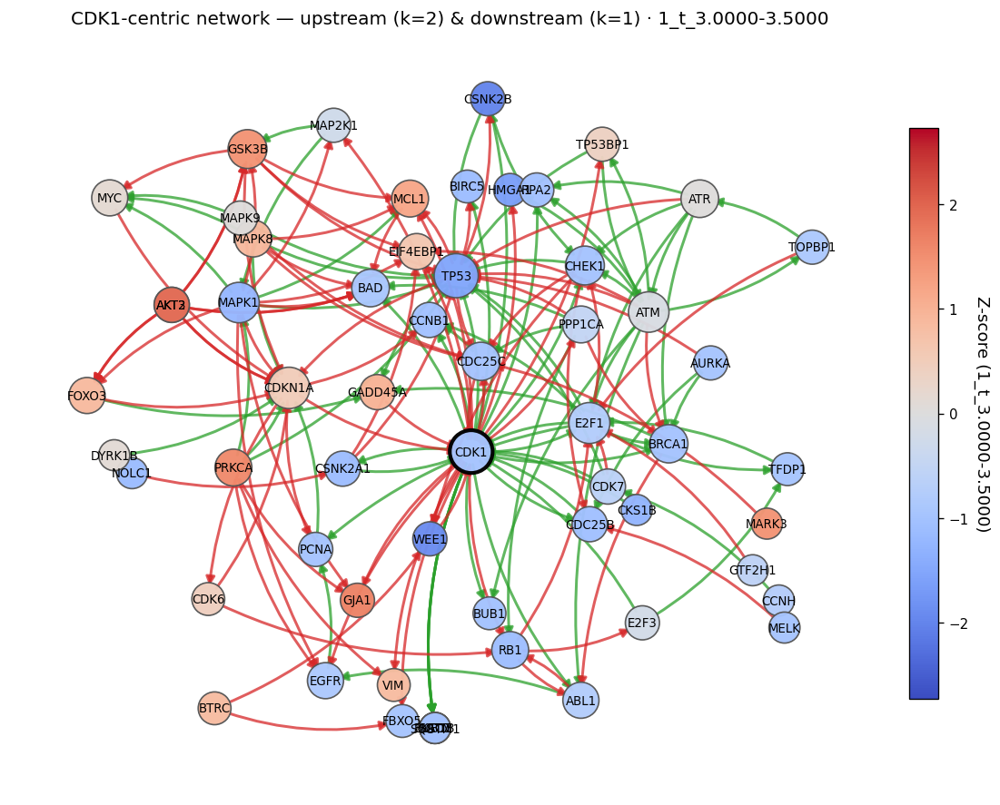

In [222]:
# ================== CDK1-centric z-score plot (compact) ==================
import igraph as ig
import networkx as nx
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import get_cmap

# ----------- CONFIG (edit these) -----------
TARGET_UP = "P06493"              # CDK1 UniProt
BIN       = "1_t_3.0000-3.5000"   # one of your z-score columns / group names
K_IN      = 2                     # hops upstream (regulators of CDK1)
K_OUT     = 1                     # hops downstream (targets of CDK1)
MAX_DOWNSTREAM = 30               # limit direct downstream targets (None = all)
GLOBAL_NORM = True                # global color scale across all bins in zscore_df
CMAP_NAME   = "coolwarm"          # z-score colormap
SAVE_PATH   = None                # e.g. "/path/figure.png" or None to just show

# ----------- HELPERS -----------
def _neighbors_k(G: ig.Graph, start_idx: int, k: int, mode: str) -> set[int]:
    """k-hop expansion from start_idx in IN/OUT/ALL; returns set of vertex indices (excl start)."""
    seen, frontier = {start_idx}, {start_idx}
    reached = set()
    for _ in range(max(0, k)):
        nxt = set()
        for v in frontier:
            nxt |= set(G.neighbors(v, mode=mode))
        nxt -= seen
        if not nxt: break
        reached |= nxt
        seen |= nxt
        frontier = nxt
    return reached

def _pick_top_downstream(G: ig.Graph, t_idx: int, limit: int | None) -> list[int]:
    """Return indices of direct OUT neighbors of target, optionally top by degree in BIG g."""
    outs = list(G.neighbors(t_idx, mode="OUT"))
    if (limit is None) or (len(outs) <= limit):
        return outs
    deg = G.degree()  # total degree in BIG g
    outs_sorted = sorted(outs, key=lambda i: deg[i], reverse=True)
    return outs_sorted[:limit]

def _absmax_for_bin(zdf: pd.DataFrame, bins: list[str] | None, global_norm: bool) -> float:
    if global_norm:
        vals = zdf[bins] if bins else zdf
        arr = np.asarray(vals.values, dtype=float)
        if arr.size == 0 or not np.isfinite(arr).any(): return 1.0
        m = float(np.nanmax(np.abs(arr)))
        return m if m > 0 else 1.0
    return None  # will compute per-bin later

# ----------- BUILD CDK1-CENTRIC NODE SET -----------
if TARGET_UP not in g.vs["name"]:
    raise ValueError(f"Target {TARGET_UP} not found in g.vs['name'].")

t_idx = g.vs.find(name=TARGET_UP).index
up_inds   = _neighbors_k(g, t_idx, K_IN,  mode="IN")
down_inds = set(_pick_top_downstream(g, t_idx, MAX_DOWNSTREAM))
if K_OUT > 1:
    # expand further OUT rings if you really want (kept simple here)
    extra = _neighbors_k(g, t_idx, K_OUT-1, mode="OUT")
    down_inds |= extra

node_inds = {t_idx} | set(up_inds) | set(down_inds)
subg = g.subgraph(ig.VertexSeq(g, sorted(node_inds)))

# ----------- BUILD NetworkX graph w/ attributes -----------
H = nx.DiGraph()
has_sym = "gene_symbol" in subg.vs.attributes()
has_ens = "ensembl_gene_id" in subg.vs.attributes()

for v in subg.vs:
    up  = v["name"]
    sym = v["gene_symbol"] if has_sym else up
    ens = v["ensembl_gene_id"] if has_ens else None
    H.add_node(up, label=(sym if sym else up), ensembl=ens)

# edges among selected nodes
etype_attr = "type" if "type" in subg.es.attributes() else None
for e in subg.es:
    s, t = e.tuple
    u, v = subg.vs[s]["name"], subg.vs[t]["name"]
    et   = (subg.es[e.index][etype_attr] if etype_attr else None)
    H.add_edge(u, v, type=(et or ""))

# ----------- Z-score coloring (index = Ensembl) -----------
if BIN not in zscore_df.columns:
    raise ValueError(f"Bin '{BIN}' not found in zscore_df.columns")

cmap = get_cmap(CMAP_NAME)
bins_for_norm = list(zscore_df.columns) if GLOBAL_NORM else [BIN]
absmax = _absmax_for_bin(zscore_df, bins_for_norm, GLOBAL_NORM)
if absmax is None:
    col = zscore_df[BIN]
    absmax = float(np.nanmax(np.abs(col.values))) or 1.0
norm = Normalize(vmin=-absmax, vmax=absmax)

def _node_color(up_name: str):
    ens = H.nodes[up_name].get("ensembl", None)
    if ens is not None and ens in zscore_df.index:
        z = zscore_df.at[ens, BIN]
        if np.isfinite(z):
            return cmap(norm(float(z)))
    return (0.92, 0.92, 0.92, 1.0)  # missing

node_colors = [_node_color(n) for n in H.nodes()]

# ----------- Layout, sizes, styling -----------
pos   = nx.kamada_kawai_layout(H, weight=None)
deg_u = H.to_undirected().degree()
node_sizes = [300 + 120 * (max(1, deg_u[n]) ** 0.5) for n in H.nodes()]
# emphasize target
for i, n in enumerate(H.nodes()):
    if n == TARGET_UP: node_sizes[i] = 800

# split edges by sign
def _sign(d: dict) -> str | None:
    s = str(d.get("type","")).lower()
    if "activ" in s or "stimulat" in s or s in {"+","pos"}: return "act"
    if "inhib" in s or "repress" in s or s in {"-","neg"}:  return "inh"
    return None

e_act = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "act"]
e_inh = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "inh"]
e_oth = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) is None]

labels = {n: H.nodes[n].get("label", n) for n in H.nodes()}

# ----------- DRAW -----------
fig, ax = plt.subplots(figsize=(10, 7.5))

# edges first
if e_act:
    nx.draw_networkx_edges(H, pos, edgelist=e_act, edge_color="#2ca02c",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_inh:
    nx.draw_networkx_edges(H, pos, edgelist=e_inh, edge_color="#d62728",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_oth:
    nx.draw_networkx_edges(H, pos, edgelist=e_oth, edge_color="#9e9e9e",
                           arrows=True, arrowsize=10, width=1.2, alpha=0.5,
                           connectionstyle="arc3,rad=0.12", style="dashed", ax=ax)

# nodes
nx.draw_networkx_nodes(H, pos,
    node_color=node_colors, node_size=node_sizes,
    edgecolors=["black" if n==TARGET_UP else "#555555" for n in H.nodes()],
    linewidths=[2.5 if n==TARGET_UP else 1.0 for n in H.nodes()],
    alpha=0.97, ax=ax
)
nx.draw_networkx_labels(H, pos, labels=labels, font_size=8, ax=ax)

# colorbar
sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array(np.array([-absmax, absmax]))
cbar = plt.colorbar(sm, ax=ax, shrink=0.75, pad=0.02)
cbar.set_label(f"Z-score ({BIN})", rotation=270, labelpad=14)

ax.set_title(f"CDK1-centric network — upstream (k={K_IN}) & downstream (k={K_OUT}) · {BIN}", fontsize=12)
ax.axis("off")
plt.tight_layout()
if SAVE_PATH:
    import os
    os.makedirs(os.path.dirname(SAVE_PATH), exist_ok=True)
    plt.savefig(SAVE_PATH, dpi=220, bbox_inches="tight")
else:
    plt.show()


/tmp/ipykernel_270652/2544640900.py:92: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap(CMAP_NAME)


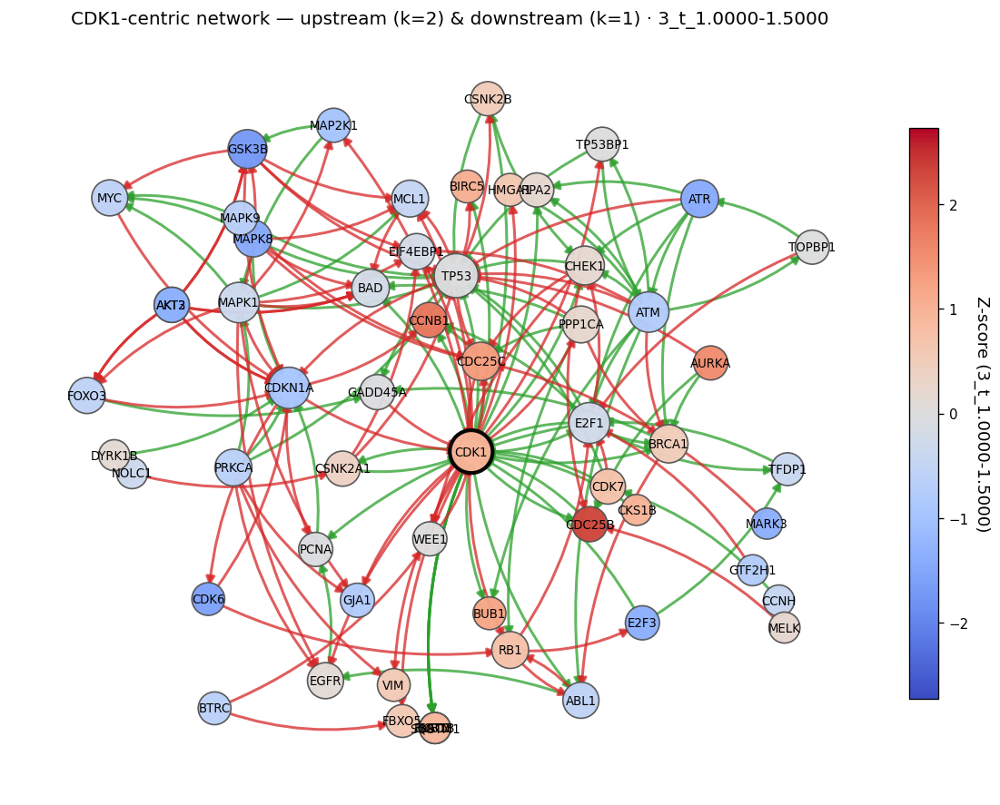

In [219]:
# ================== CDK1-centric z-score plot (compact) ==================
import igraph as ig
import networkx as nx
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import get_cmap

# ----------- CONFIG (edit these) -----------
TARGET_UP = "P06493"              # CDK1 UniProt
BIN       = "3_t_1.0000-1.5000"   # one of your z-score columns / group names
K_IN      = 2                     # hops upstream (regulators of CDK1)
K_OUT     = 1                     # hops downstream (targets of CDK1)
MAX_DOWNSTREAM = 30               # limit direct downstream targets (None = all)
GLOBAL_NORM = True                # global color scale across all bins in zscore_df
CMAP_NAME   = "coolwarm"          # z-score colormap
SAVE_PATH   = None                # e.g. "/path/figure.png" or None to just show

# ----------- HELPERS -----------
def _neighbors_k(G: ig.Graph, start_idx: int, k: int, mode: str) -> set[int]:
    """k-hop expansion from start_idx in IN/OUT/ALL; returns set of vertex indices (excl start)."""
    seen, frontier = {start_idx}, {start_idx}
    reached = set()
    for _ in range(max(0, k)):
        nxt = set()
        for v in frontier:
            nxt |= set(G.neighbors(v, mode=mode))
        nxt -= seen
        if not nxt: break
        reached |= nxt
        seen |= nxt
        frontier = nxt
    return reached

def _pick_top_downstream(G: ig.Graph, t_idx: int, limit: int | None) -> list[int]:
    """Return indices of direct OUT neighbors of target, optionally top by degree in BIG g."""
    outs = list(G.neighbors(t_idx, mode="OUT"))
    if (limit is None) or (len(outs) <= limit):
        return outs
    deg = G.degree()  # total degree in BIG g
    outs_sorted = sorted(outs, key=lambda i: deg[i], reverse=True)
    return outs_sorted[:limit]

def _absmax_for_bin(zdf: pd.DataFrame, bins: list[str] | None, global_norm: bool) -> float:
    if global_norm:
        vals = zdf[bins] if bins else zdf
        arr = np.asarray(vals.values, dtype=float)
        if arr.size == 0 or not np.isfinite(arr).any(): return 1.0
        m = float(np.nanmax(np.abs(arr)))
        return m if m > 0 else 1.0
    return None  # will compute per-bin later

# ----------- BUILD CDK1-CENTRIC NODE SET -----------
if TARGET_UP not in g.vs["name"]:
    raise ValueError(f"Target {TARGET_UP} not found in g.vs['name'].")

t_idx = g.vs.find(name=TARGET_UP).index
up_inds   = _neighbors_k(g, t_idx, K_IN,  mode="IN")
down_inds = set(_pick_top_downstream(g, t_idx, MAX_DOWNSTREAM))
if K_OUT > 1:
    # expand further OUT rings if you really want (kept simple here)
    extra = _neighbors_k(g, t_idx, K_OUT-1, mode="OUT")
    down_inds |= extra

node_inds = {t_idx} | set(up_inds) | set(down_inds)
subg = g.subgraph(ig.VertexSeq(g, sorted(node_inds)))

# ----------- BUILD NetworkX graph w/ attributes -----------
H = nx.DiGraph()
has_sym = "gene_symbol" in subg.vs.attributes()
has_ens = "ensembl_gene_id" in subg.vs.attributes()

for v in subg.vs:
    up  = v["name"]
    sym = v["gene_symbol"] if has_sym else up
    ens = v["ensembl_gene_id"] if has_ens else None
    H.add_node(up, label=(sym if sym else up), ensembl=ens)

# edges among selected nodes
etype_attr = "type" if "type" in subg.es.attributes() else None
for e in subg.es:
    s, t = e.tuple
    u, v = subg.vs[s]["name"], subg.vs[t]["name"]
    et   = (subg.es[e.index][etype_attr] if etype_attr else None)
    H.add_edge(u, v, type=(et or ""))

# ----------- Z-score coloring (index = Ensembl) -----------
if BIN not in zscore_df.columns:
    raise ValueError(f"Bin '{BIN}' not found in zscore_df.columns")

cmap = get_cmap(CMAP_NAME)
bins_for_norm = list(zscore_df.columns) if GLOBAL_NORM else [BIN]
absmax = _absmax_for_bin(zscore_df, bins_for_norm, GLOBAL_NORM)
if absmax is None:
    col = zscore_df[BIN]
    absmax = float(np.nanmax(np.abs(col.values))) or 1.0
norm = Normalize(vmin=-absmax, vmax=absmax)

def _node_color(up_name: str):
    ens = H.nodes[up_name].get("ensembl", None)
    if ens is not None and ens in zscore_df.index:
        z = zscore_df.at[ens, BIN]
        if np.isfinite(z):
            return cmap(norm(float(z)))
    return (0.92, 0.92, 0.92, 1.0)  # missing

node_colors = [_node_color(n) for n in H.nodes()]

# ----------- Layout, sizes, styling -----------
pos   = nx.kamada_kawai_layout(H, weight=None)
deg_u = H.to_undirected().degree()
node_sizes = [300 + 120 * (max(1, deg_u[n]) ** 0.5) for n in H.nodes()]
# emphasize target
for i, n in enumerate(H.nodes()):
    if n == TARGET_UP: node_sizes[i] = 800

# split edges by sign
def _sign(d: dict) -> str | None:
    s = str(d.get("type","")).lower()
    if "activ" in s or "stimulat" in s or s in {"+","pos"}: return "act"
    if "inhib" in s or "repress" in s or s in {"-","neg"}:  return "inh"
    return None

e_act = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "act"]
e_inh = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "inh"]
e_oth = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) is None]

labels = {n: H.nodes[n].get("label", n) for n in H.nodes()}

# ----------- DRAW -----------
fig, ax = plt.subplots(figsize=(10, 7.5))

# edges first
if e_act:
    nx.draw_networkx_edges(H, pos, edgelist=e_act, edge_color="#2ca02c",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_inh:
    nx.draw_networkx_edges(H, pos, edgelist=e_inh, edge_color="#d62728",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_oth:
    nx.draw_networkx_edges(H, pos, edgelist=e_oth, edge_color="#9e9e9e",
                           arrows=True, arrowsize=10, width=1.2, alpha=0.5,
                           connectionstyle="arc3,rad=0.12", style="dashed", ax=ax)

# nodes
nx.draw_networkx_nodes(H, pos,
    node_color=node_colors, node_size=node_sizes,
    edgecolors=["black" if n==TARGET_UP else "#555555" for n in H.nodes()],
    linewidths=[2.5 if n==TARGET_UP else 1.0 for n in H.nodes()],
    alpha=0.97, ax=ax
)
nx.draw_networkx_labels(H, pos, labels=labels, font_size=8, ax=ax)

# colorbar
sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array(np.array([-absmax, absmax]))
cbar = plt.colorbar(sm, ax=ax, shrink=0.75, pad=0.02)
cbar.set_label(f"Z-score ({BIN})", rotation=270, labelpad=14)

ax.set_title(f"CDK1-centric network — upstream (k={K_IN}) & downstream (k={K_OUT}) · {BIN}", fontsize=12)
ax.axis("off")
plt.tight_layout()
if SAVE_PATH:
    import os
    os.makedirs(os.path.dirname(SAVE_PATH), exist_ok=True)
    plt.savefig(SAVE_PATH, dpi=220, bbox_inches="tight")
else:
    plt.show()


/tmp/ipykernel_270652/1395178387.py:92: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap(CMAP_NAME)


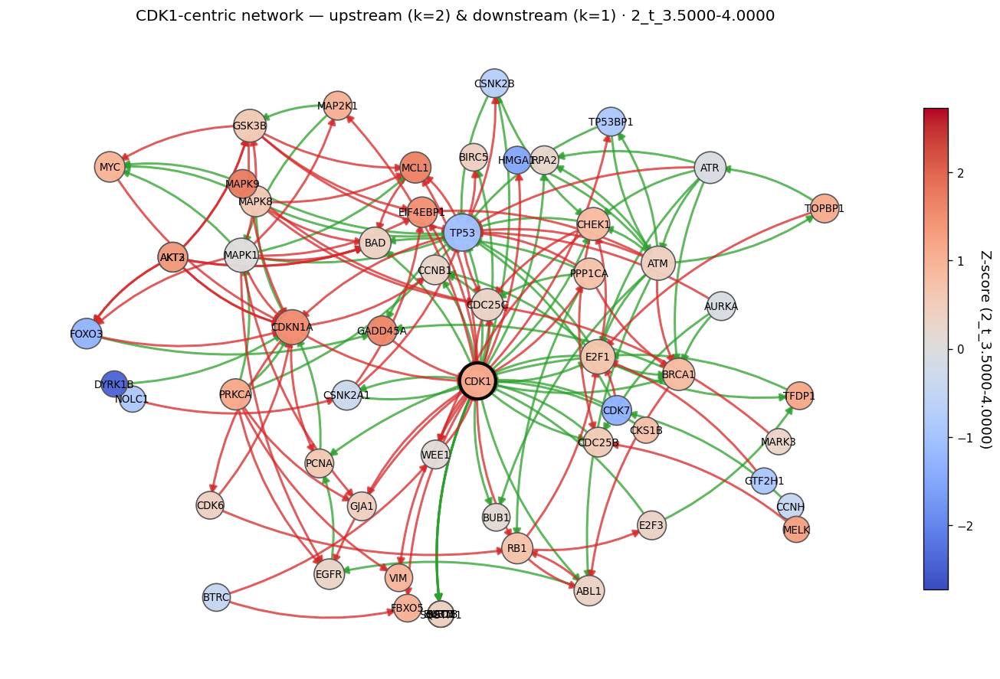

In [225]:
# ================== CDK1-centric z-score plot (compact, no label overlap) ==================
import igraph as ig
import networkx as nx
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import get_cmap

# ----------- CONFIG (edit these) -----------
TARGET_UP = "P06493"              # CDK1 UniProt
BIN       = "2_t_3.5000-4.0000"   # one of your z-score columns / group names
K_IN      = 2                     # hops upstream (regulators of CDK1)
K_OUT     = 1                     # hops downstream (targets of CDK1)
MAX_DOWNSTREAM = 30               # limit direct downstream targets (None = all)
GLOBAL_NORM = True                # global color scale across all bins in zscore_df
CMAP_NAME   = "coolwarm"          # z-score colormap
SAVE_PATH   = "                # e.g. "/path/figure.png" or None to just show

# ----------- HELPERS -----------
def _neighbors_k(G: ig.Graph, start_idx: int, k: int, mode: str) -> set[int]:
    """k-hop expansion from start_idx in IN/OUT/ALL; returns set of vertex indices (excl start)."""
    seen, frontier = {start_idx}, {start_idx}
    reached = set()
    for _ in range(max(0, k)):
        nxt = set()
        for v in frontier:
            nxt |= set(G.neighbors(v, mode=mode))
        nxt -= seen
        if not nxt: break
        reached |= nxt
        seen |= nxt
        frontier = nxt
    return reached

def _pick_top_downstream(G: ig.Graph, t_idx: int, limit: int | None) -> list[int]:
    """Return indices of direct OUT neighbors of target, optionally top by degree in BIG g."""
    outs = list(G.neighbors(t_idx, mode="OUT"))
    if (limit is None) or (len(outs) <= limit):
        return outs
    deg = G.degree()  # total degree in BIG g
    outs_sorted = sorted(outs, key=lambda i: deg[i], reverse=True)
    return outs_sorted[:limit]

def _absmax_for_bin(zdf: pd.DataFrame, bins: list[str] | None, global_norm: bool) -> float:
    if global_norm:
        vals = zdf[bins] if bins else zdf
        arr = np.asarray(vals.values, dtype=float)
        if arr.size == 0 or not np.isfinite(arr).any(): return 1.0
        m = float(np.nanmax(np.abs(arr)))
        return m if m > 0 else 1.0
    return None  # will compute per-bin later

# ----------- BUILD CDK1-CENTRIC NODE SET -----------
if TARGET_UP not in g.vs["name"]:
    raise ValueError(f"Target {TARGET_UP} not found in g.vs['name'].")

t_idx = g.vs.find(name=TARGET_UP).index
up_inds   = _neighbors_k(g, t_idx, K_IN,  mode="IN")
down_inds = set(_pick_top_downstream(g, t_idx, MAX_DOWNSTREAM))
if K_OUT > 1:
    # expand further OUT rings if you really want (kept simple here)
    extra = _neighbors_k(g, t_idx, K_OUT-1, mode="OUT")
    down_inds |= extra

node_inds = {t_idx} | set(up_inds) | set(down_inds)
subg = g.subgraph(ig.VertexSeq(g, sorted(node_inds)))

# ----------- BUILD NetworkX graph w/ attributes -----------
H = nx.DiGraph()
has_sym = "gene_symbol" in subg.vs.attributes()
has_ens = "ensembl_gene_id" in subg.vs.attributes()

for v in subg.vs:
    up  = v["name"]
    sym = v["gene_symbol"] if has_sym else up
    ens = v["ensembl_gene_id"] if has_ens else None
    H.add_node(up, label=(sym if sym else up), ensembl=ens)

# edges among selected nodes
etype_attr = "type" if "type" in subg.es.attributes() else None
for e in subg.es:
    s, t = e.tuple
    u, v = subg.vs[s]["name"], subg.vs[t]["name"]
    et   = (subg.es[e.index][etype_attr] if etype_attr else None)
    H.add_edge(u, v, type=(et or ""))

# ----------- Z-score coloring (index = Ensembl) -----------
if BIN not in zscore_df.columns:
    raise ValueError(f"Bin '{BIN}' not found in zscore_df.columns")

cmap = get_cmap(CMAP_NAME)
bins_for_norm = list(zscore_df.columns) if GLOBAL_NORM else [BIN]
absmax = _absmax_for_bin(zscore_df, bins_for_norm, GLOBAL_NORM)
if absmax is None:
    col = zscore_df[BIN]
    absmax = float(np.nanmax(np.abs(col.values))) or 1.0
norm = Normalize(vmin=-absmax, vmax=absmax)

def _node_color(up_name: str):
    ens = H.nodes[up_name].get("ensembl", None)
    if ens is not None and ens in zscore_df.index:
        z = zscore_df.at[ens, BIN]
        if np.isfinite(z):
            return cmap(norm(float(z)))
    return (0.92, 0.92, 0.92, 1.0)  # missing

node_colors = [_node_color(n) for n in H.nodes()]

# ----------- Layout, sizes, styling -----------
pos   = nx.kamada_kawai_layout(H, weight=None)
deg_u = H.to_undirected().degree()
node_sizes = [300 + 120 * (max(1, deg_u[n]) ** 0.5) for n in H.nodes()]
# emphasize target
for i, n in enumerate(H.nodes()):
    if n == TARGET_UP: node_sizes[i] = 800

# split edges by sign
def _sign(d: dict) -> str | None:
    s = str(d.get("type","")).lower()
    if "activ" in s or "stimulat" in s or s in {"+","pos"}: return "act"
    if "inhib" in s or "repress" in s or s in {"-","neg"}:  return "inh"
    return None

e_act = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "act"]
e_inh = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "inh"]
e_oth = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) is None]

labels = {n: H.nodes[n].get("label", n) for n in H.nodes()}

# ----------- Build non-overlapping label positions + leader lines -----------
import random as _random
_random.seed(42)

center = np.array(pos.get(TARGET_UP, (0.0, 0.0)))
def _unit(v):
    nrm = np.linalg.norm(v) + 1e-9
    return v / nrm

min_labelsep = 0.06   # adjust if you still see clashes (layout units)
initial_off  = 0.02   # initial radial shift
bump_step    = 0.02   # extra shift when overlapping

label_pos = {}
placed = []

for n in H.nodes():
    p = np.array(pos[n])
    d = _unit(p - center)
    if not np.isfinite(d).all() or np.linalg.norm(d) < 1e-6:
        d = _unit(np.array([_random.uniform(-1,1), _random.uniform(-1,1)]))
    xy = p + (initial_off + _random.uniform(0.0, 0.01)) * d

    # bump away from already placed labels until minimally separated
    for _ in range(100):
        ok = True
        for (x0, y0) in placed:
            if np.linalg.norm(xy - np.array([x0, y0])) < min_labelsep:
                xy = xy + bump_step * d
                ok = False
                break
        if ok:
            break
    label_pos[n] = (float(xy[0]), float(xy[1]))
    placed.append(label_pos[n])

# ----------- DRAW -----------
fig, ax = plt.subplots(figsize=(10, 7.5))

# edges first
if e_act:
    nx.draw_networkx_edges(H, pos, edgelist=e_act, edge_color="#2ca02c",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_inh:
    nx.draw_networkx_edges(H, pos, edgelist=e_inh, edge_color="#d62728",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_oth:
    nx.draw_networkx_edges(H, pos, edgelist=e_oth, edge_color="#9e9e9e",
                           arrows=True, arrowsize=10, width=1.2, alpha=0.5,
                           connectionstyle="arc3,rad=0.12", style="dashed", ax=ax)

# nodes
nx.draw_networkx_nodes(H, pos,
    node_color=node_colors, node_size=node_sizes,
    edgecolors=["black" if n==TARGET_UP else "#555555" for n in H.nodes()],
    linewidths=[2.5 if n==TARGET_UP else 1.0 for n in H.nodes()],
    alpha=0.97, ax=ax
)

# leader lines from node to label
for n in H.nodes():
    x0, y0 = pos[n]
    x1, y1 = label_pos[n]
    if (abs(x0 - x1) + abs(y0 - y1)) > 1e-6:  # only draw if actually offset
        ax.plot([x0, x1], [y0, y1], color=(0,0,0,0.25), lw=0.8, zorder=1)

# labels at the de-overlapped positions
nx.draw_networkx_labels(H, label_pos, labels=labels, font_size=8, ax=ax)

# colorbar
sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array(np.array([-absmax, absmax]))
cbar = plt.colorbar(sm, ax=ax, shrink=0.75, pad=0.02)
cbar.set_label(f"Z-score ({BIN})", rotation=270, labelpad=14)

ax.set_title(f"CDK1-centric network — upstream (k={K_IN}) & downstream (k={K_OUT}) · {BIN}", fontsize=12)
ax.axis("off")
plt.tight_layout()
if SAVE_PATH:
    import os
    os.makedirs(os.path.dirname(SAVE_PATH), exist_ok=True)
    plt.savefig(SAVE_PATH, dpi=220, bbox_inches="tight")
else:
    plt.show()


In [ ]:
ORDER = [
 '0_t_0.0000-0.5000','1_t_0.5000-1.5000','1_t_1.5000-2.5000','1_t_2.5000-3.0000','1_t_3.0000-3.5000',
 '2_t_1.0000-2.5000','2_t_2.5000-3.0000','2_t_3.0000-3.500','2_t_3.5000-4.0000',
 '3_t_0.0000-1.0000','3_t_1.0000-1.5000','3_t_1.5000-2.5000'
]


Top-1 shortest path(s) TGFBR1 → CDKN1A:
  Path 1 (len 5): TGFBR1(P36897) → SHC1(P29353) → PTK2(Q05397) → RAC1(P63000) → MAPK8(P45983) → CDKN1A(P38936)


/tmp/ipykernel_270652/3611182580.py:187: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap(CMAP_NAME)


💾 Saved figure → /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/cdk1_ego/cdk1_center__TGFBR1_to_CDKN1A__2_t_3.5000-4.0000.png


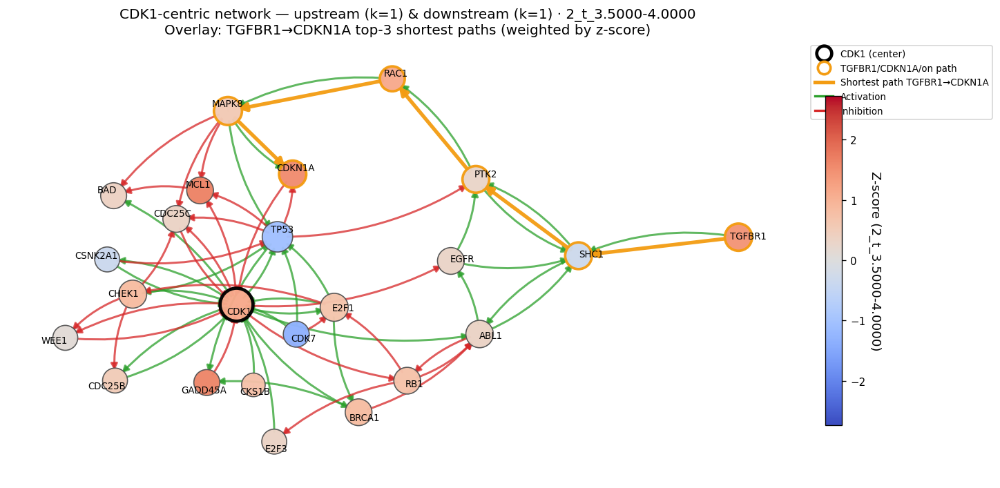

In [260]:
# ================= CDK1-centric plot + (SRC→DST) top-3 shortest paths (optionally z-score weighted) =================
import os
import igraph as ig
import networkx as nx
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import get_cmap
from matplotlib.lines import Line2D

# -------------------- CONFIG --------------------
CENTER_UP        = "P06493"             # CDK1 (center of the ego network)
SRC_UP_DEFAULT   = "P36897"             # TGFBR1 UniProt
DST_UP_DEFAULT   = "P38936"             # CDKN1A UniProt
SRC_GENE_FALLBK  = "TGFBR1"             # only used if UniProt not found; we try by gene_symbol
DST_GENE_FALLBK  = "CDKN1A"
BIN              = "2_t_3.5000-4.0000"  # one z-score column to color nodes
K_IN             = 1                     # upstream hops of CENTER_UP
K_OUT            = 1                    # downstream hops of CENTER_UP
MAX_DOWNSTREAM   = 10                   # limit direct downstream neighbors shown
CMAP_NAME        = "coolwarm"           # colormap for z-score coloring
GLOBAL_NORM      = True                 # normalize z-scale across all bins
SAVE_DIR         = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/cdk1_ego"
TOPK_PATHS       = 3                    # show top-K (equal-length) shortest paths SRC→DST

# ---- Path weighting by expression/z-score (optional) ----
# "none"  : unweighted (classic shortest paths)
# "zscore": weight edges by node costs derived from zscore_df[BIN] (high z => cheaper)
PATH_WEIGHT_MODE = "zscore"             # "none" or "zscore"
ZSCORE_BETA      = 0.35                 # per +1 z, cost multiplies by exp(-beta). beta≈0.35 halves cost ~ every 2 z.

# -------------------- HELPERS --------------------
def _safe_filename(s: str) -> str:
    return "".join(ch if (ch.isalnum() or ch in "-_.") else "_" for ch in s)

def _neighbors_k(G: ig.Graph, start_idx: int, k: int, mode: str) -> set[int]:
    seen, frontier = {start_idx}, {start_idx}
    reached = set()
    for _ in range(max(0, k)):
        nxt = set()
        for v in frontier:
            nxt |= set(G.neighbors(v, mode=mode))
        nxt -= seen
        if not nxt: break
        reached |= nxt
        seen |= nxt
        frontier = nxt
    return reached

def _pick_top_downstream(G: ig.Graph, t_idx: int, limit: int | None) -> list[int]:
    outs = list(G.neighbors(t_idx, mode="OUT"))
    if (limit is None) or (len(outs) <= limit):
        return outs
    deg = G.degree()
    outs_sorted = sorted(outs, key=lambda i: deg[i], reverse=True)
    return outs_sorted[:limit]

def _absmax_for_bin(zdf: pd.DataFrame, bins: list[str] | None, global_norm: bool) -> float:
    if global_norm:
        vals = zdf[bins] if bins else zdf
        arr = np.asarray(vals.values, dtype=float)
        if arr.size == 0 or not np.isfinite(arr).any(): return 1.0
        m = float(np.nanmax(np.abs(arr)))
        return m if m > 0 else 1.0
    return None

def _resolve_uniprot(G: ig.Graph, up_id: str | None, sym_fallback: str | None) -> str | None:
    """Return a UniProt ID present in G: prefer up_id; else search by gene_symbol."""
    if up_id and up_id in G.vs["name"]:
        return up_id
    if sym_fallback and "gene_symbol" in G.vs.attributes():
        for v in G.vs:
            if v["gene_symbol"] == sym_fallback:
                return v["name"]
    return None

def _node_costs_from_z(G: ig.Graph, zdf: pd.DataFrame, bin_name: str, beta: float) -> np.ndarray:
    """Return per-vertex cost (len = vcount) based on z-score in `bin_name`.
    cost = exp(-beta * z); high z => low cost. Missing z => cost = 1.0."""
    costs = np.ones(G.vcount(), dtype=float)
    has_ens = "ensembl_gene_id" in G.vs.attributes()
    if not has_ens or bin_name not in zdf.columns:
        return costs
    for i, v in enumerate(G.vs):
        ens = v["ensembl_gene_id"]
        if ens in zdf.index:
            z = zdf.at[ens, bin_name]
            if np.isfinite(z):
                costs[i] = float(np.exp(-beta * float(z)))
    return costs

def _edge_weights_from_node_costs(G: ig.Graph, node_costs: np.ndarray) -> list[float]:
    """Edge cost = average of endpoint node costs (>= tiny epsilon)."""
    eps = 1e-6
    w = []
    for e in G.es:
        s, t = e.tuple
        w.append(max(eps, 0.5 * (node_costs[s] + node_costs[t])))
    return w

def _topk_shortest_paths(G: ig.Graph, src_idx: int, dst_idx: int, k: int,
                         mode: str = "OUT", weights: list[float] | None = None) -> list[list[int]]:
    """Get up to top-k shortest paths (all with minimal length/cost)."""
    try:
        paths = G.get_all_shortest_paths(src_idx, to=dst_idx, mode=mode, weights=weights)
    except TypeError:
        # Fallback if igraph version lacks weights in get_all_shortest_paths:
        paths = G.get_all_shortest_paths(src_idx, to=dst_idx, mode=mode)
    if not paths:
        return []
    # For weighted case, paths returned are minimal-cost; take first k
    # For unweighted too, take first k
    return paths[:max(1, k)]

# -------------------- RESOLVE CENTER/SRC/DST --------------------
if CENTER_UP not in g.vs["name"]:
    raise ValueError(f"Center {CENTER_UP} not in g.vs['name'].")

SRC_UP = _resolve_uniprot(g, SRC_UP_DEFAULT, SRC_GENE_FALLBK)
DST_UP = _resolve_uniprot(g, DST_UP_DEFAULT, DST_GENE_FALLBK)

if SRC_UP is None or DST_UP is None:
    raise ValueError("Could not resolve SRC_UP or DST_UP in the graph (by UniProt or gene_symbol).")

c_idx  = g.vs.find(name=CENTER_UP).index
src_i  = g.vs.find(name=SRC_UP).index
dst_i  = g.vs.find(name=DST_UP).index

# -------------------- (Optional) weighted shortest paths --------------------
weights = None
if PATH_WEIGHT_MODE.lower() == "zscore":
    node_costs = _node_costs_from_z(g, zscore_df, BIN, ZSCORE_BETA)
    weights    = _edge_weights_from_node_costs(g, node_costs)

# -------------------- compute top-k SRC→DST paths --------------------
paths_nodes = set()
paths_edges = set()
top_paths   = _topk_shortest_paths(g, src_i, dst_i, TOPK_PATHS, mode="OUT", weights=weights)
for p in top_paths:
    paths_nodes.update(p)
    for u, v in zip(p[:-1], p[1:]):
        paths_edges.add((g.vs[u]["name"], g.vs[v]["name"]))

# Console print for transparency
def _lab(i):
    sym = g.vs[i]["gene_symbol"] if "gene_symbol" in g.vs.attributes() and g.vs[i]["gene_symbol"] else g.vs[i]["name"]
    return f"{sym}({g.vs[i]['name']})"
if top_paths:
    print(f"\nTop-{len(top_paths)} shortest path(s) {g.vs[src_i]['gene_symbol'] or SRC_UP} → {g.vs[dst_i]['gene_symbol'] or DST_UP}:")
    for k, p in enumerate(top_paths, 1):
        print(f"  Path {k} (len {len(p)-1}): " + " → ".join(_lab(i) for i in p))
else:
    print("ℹ️ No SRC→DST path found under current settings.")

# -------------------- build CDK1-centric node set --------------------
up_inds   = _neighbors_k(g, c_idx, K_IN,  mode="IN")
down_inds = set(_pick_top_downstream(g, c_idx, MAX_DOWNSTREAM))
if K_OUT > 1:
    down_inds |= _neighbors_k(g, c_idx, K_OUT-1, mode="OUT")

node_inds = {c_idx} | set(up_inds) | set(down_inds) | set(paths_nodes)  # include path nodes
subg = g.subgraph(ig.VertexSeq(g, sorted(node_inds)))

# -------------------- build NetworkX with attributes --------------------
H = nx.DiGraph()
has_sym = "gene_symbol" in subg.vs.attributes()
has_ens = "ensembl_gene_id" in subg.vs.attributes()

for v in subg.vs:
    up  = v["name"]
    sym = v["gene_symbol"] if has_sym else up
    ens = v["ensembl_gene_id"] if has_ens else None
    H.add_node(up, label=(sym if sym else up), ensembl=ens)

etype_attr = "type" if "type" in subg.es.attributes() else None
for e in subg.es:
    s, t = e.tuple
    u, v = subg.vs[s]["name"], subg.vs[t]["name"]
    et   = (subg.es[e.index][etype_attr] if etype_attr else None)
    H.add_edge(u, v, type=(et or ""))

# -------------------- z-score node coloring --------------------
if BIN not in zscore_df.columns:
    raise ValueError(f"Bin '{BIN}' not found in zscore_df.columns")

cmap = get_cmap(CMAP_NAME)
bins_for_norm = list(zscore_df.columns) if GLOBAL_NORM else [BIN]
absmax = _absmax_for_bin(zscore_df, bins_for_norm, GLOBAL_NORM)
if absmax is None:
    col = zscore_df[BIN]
    absmax = float(np.nanmax(np.abs(col.values))) or 1.0
norm = Normalize(vmin=-absmax, vmax=absmax)

def _node_color(up_name: str):
    ens = H.nodes[up_name].get("ensembl", None)
    if ens is not None and ens in zscore_df.index:
        z = zscore_df.at[ens, BIN]
        if np.isfinite(z):
            return cmap(norm(float(z)))
    return (0.92, 0.92, 0.92, 1.0)

node_colors = [_node_color(n) for n in H.nodes()]

# -------------------- layout, sizes, edges --------------------
pos   = nx.kamada_kawai_layout(H, weight=None)
deg_u = H.to_undirected().degree()
node_sizes = [300 + 120 * (max(1, deg_u[n]) ** 0.5) for n in H.nodes()]
for i, n in enumerate(H.nodes()):
    if n == CENTER_UP: node_sizes[i] = 820
    if n == SRC_UP or n == DST_UP: node_sizes[i] = max(node_sizes[i], 560)

def _sign(d: dict) -> str | None:
    s = str(d.get("type","")).lower()
    if "activ" in s or "stimulat" in s or s in {"+","pos"}: return "act"
    if "inhib" in s or "repress" in s or s in {"-","neg"}:  return "inh"
    return None

e_act = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "act"]
e_inh = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "inh"]
e_oth = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) is None]

labels = {n: H.nodes[n].get("label", n) for n in H.nodes()}

# -------------------- non-overlapping label positions + leader lines --------------------
import random as _random
_random.seed(42)
center_xy = np.array(pos.get(CENTER_UP, (0.0, 0.0)))
def _unit(v): 
    nrm = np.linalg.norm(v) + 1e-9
    return v / nrm

min_labelsep = 0.06
initial_off  = 0.02
bump_step    = 0.02

label_pos = {}
placed = []
for n in H.nodes():
    p = np.array(pos[n])
    d = _unit(p - center_xy)
    if not np.isfinite(d).all() or np.linalg.norm(d) < 1e-6:
        d = _unit(np.array([_random.uniform(-1,1), _random.uniform(-1,1)]))
    xy = p + (initial_off + _random.uniform(0.0, 0.01)) * d
    for _ in range(100):
        ok = True
        for (x0, y0) in placed:
            if np.linalg.norm(xy - np.array([x0, y0])) < min_labelsep:
                xy = xy + bump_step * d
                ok = False
                break
        if ok: break
    label_pos[n] = (float(xy[0]), float(xy[1]))
    placed.append(label_pos[n])

# -------------------- DRAW --------------------
fig, ax = plt.subplots(figsize=(12.5, 6.0))

# base edges
if e_act:
    nx.draw_networkx_edges(H, pos, edgelist=e_act, edge_color="#2ca02c",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_inh:
    nx.draw_networkx_edges(H, pos, edgelist=e_inh, edge_color="#d62728",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_oth:
    nx.draw_networkx_edges(H, pos, edgelist=e_oth, edge_color="#9e9e9e",
                           arrows=True, arrowsize=10, width=1.2, alpha=0.5,
                           connectionstyle="arc3,rad=0.12", style="dashed", ax=ax)

# overlay: SRC→DST paths (orange)
if paths_edges:
    path_edgelist = [(u, v) for (u, v) in paths_edges if H.has_edge(u, v)]
    nx.draw_networkx_edges(
        H, pos, edgelist=path_edgelist,
        edge_color="#f39c12", arrows=True, arrowsize=14, width=3.2, alpha=0.95,
        connectionstyle="arc3,rad=0.0", ax=ax
    )

# node borders: center (black), SRC/DST & on-path (orange), else grey
onpath_nodes = {u for uv in paths_edges for u in uv}
edgecolors, linewidths = [], []
for n in H.nodes():
    if n == CENTER_UP:
        edgecolors.append("black");    linewidths.append(2.8)
    elif (n == SRC_UP) or (n == DST_UP) or (n in onpath_nodes):
        edgecolors.append("#f39c12");  linewidths.append(2.2)
    else:
        edgecolors.append("#555555");  linewidths.append(1.0)

nx.draw_networkx_nodes(
    H, pos,
    node_color=node_colors, node_size=node_sizes,
    edgecolors=edgecolors, linewidths=linewidths,
    alpha=0.97, ax=ax
)

# leader lines + labels
for n in H.nodes():
    x0, y0 = pos[n]
    x1, y1 = label_pos[n]
    if (abs(x0 - x1) + abs(y0 - y1)) > 1e-6:
        ax.plot([x0, x1], [y0, y1], color=(0,0,0,0.25), lw=0.8, zorder=1)
nx.draw_networkx_labels(H, label_pos, labels=labels, font_size=8, ax=ax)

# colorbar
absmax = max(abs(norm.vmin), abs(norm.vmax))
sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array(np.array([-absmax, absmax]))
cbar = plt.colorbar(sm, ax=ax, shrink=0.75, pad=0.02)
cbar.set_label(f"Z-score ({BIN})", rotation=270, labelpad=14)

# legend
src_lbl = subg.vs.find(name=SRC_UP)["gene_symbol"] if "gene_symbol" in subg.vs.attributes() else SRC_UP
dst_lbl = subg.vs.find(name=DST_UP)["gene_symbol"] if "gene_symbol" in subg.vs.attributes() else DST_UP
legend_items = [
    Line2D([0],[0], marker='o', color='w', label='CDK1 (center)', markerfacecolor='w',
           markeredgecolor='black', markeredgewidth=2.8, markersize=13),
    Line2D([0],[0], marker='o', color='w', label=f'{src_lbl}/{dst_lbl}/on path', markerfacecolor='w',
           markeredgecolor='#f39c12', markeredgewidth=2.2, markersize=11),
    Line2D([0],[0], color="#f39c12", lw=3.2, label=f'Shortest path {src_lbl}→{dst_lbl}'),
    Line2D([0],[0], color="#2ca02c", lw=2.0, label='Activation'),
    Line2D([0],[0], color="#d62728", lw=2.0, label='Inhibition'),
]
ax.legend(handles=legend_items, fontsize=8, loc="upper left", bbox_to_anchor=(1,1))

title_weight = "weighted by z-score" if PATH_WEIGHT_MODE.lower()=="zscore" else "unweighted"
ax.set_title(f"CDK1-centric network — upstream (k={K_IN}) & downstream (k={K_OUT}) · {BIN}\n"
             f"Overlay: {src_lbl}→{dst_lbl} top-{TOPK_PATHS} shortest paths ({title_weight})",
             fontsize=12)
ax.axis("off")
plt.tight_layout()

# save with BIN + src/dst in name
safe_bin = _safe_filename(BIN)
safe_src = _safe_filename(src_lbl or SRC_UP)
safe_dst = _safe_filename(dst_lbl or DST_UP)
if SAVE_DIR:
    os.makedirs(SAVE_DIR, exist_ok=True)
    SAVE_PATH = os.path.join(SAVE_DIR, f"cdk1_center__{safe_src}_to_{safe_dst}__{safe_bin}.png")
else:
    SAVE_PATH = None

if SAVE_PATH:
    plt.savefig(SAVE_PATH, dpi=220, bbox_inches="tight")
    print(f"💾 Saved figure → {SAVE_PATH}")
else:
    plt.show()



Top-1 shortest path(s) TGFBR1 → CDKN1A:
  Path 1 (len 5): TGFBR1(P36897) → SMAD3(P84022) → JUN(P05412) → CTNNB1(P35222) → FOXO3(O43524) → CDKN1A(P38936)


/tmp/ipykernel_270652/2851571582.py:170: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap(CMAP_NAME)


💾 Saved figure → /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/cdk1_ego/cdk1_center__TGFBR1_to_CDKN1A__1_t_3.0000-3.5000.png


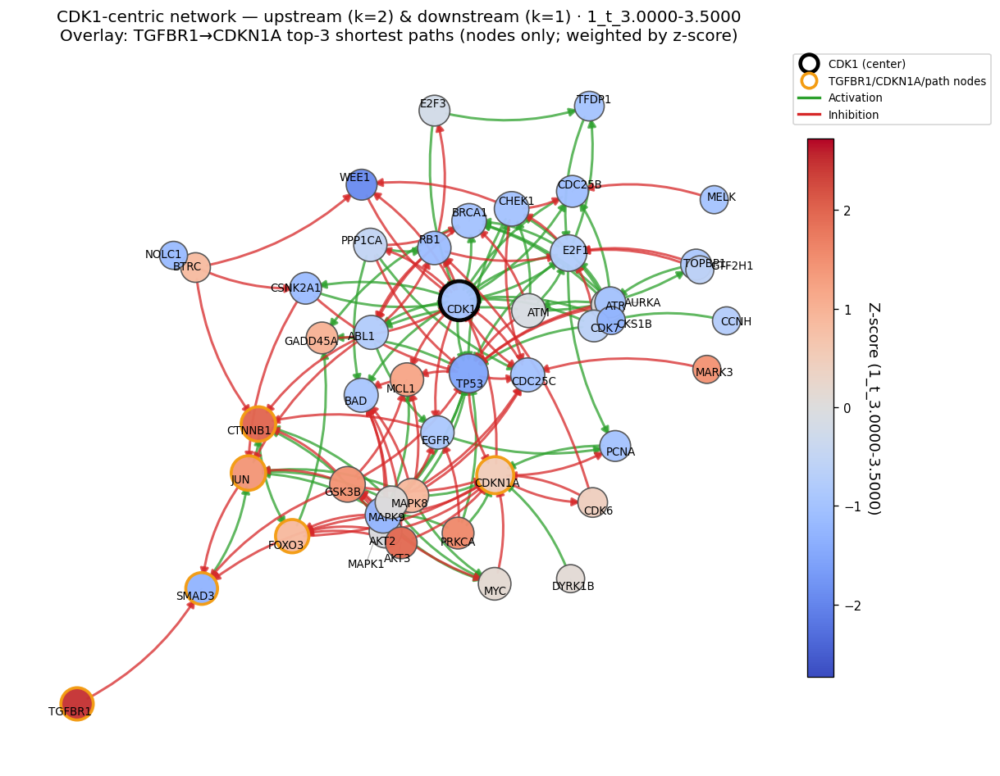

In [263]:
# = CDK1-centric z-score plot (SRC→DST top-3 shortest paths; edges NOT highlighted) =
import os
import igraph as ig
import networkx as nx
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import get_cmap
from matplotlib.lines import Line2D

# -------------------- CONFIG --------------------
CENTER_UP        = "P06493"             # CDK1 (center)
SRC_UP_DEFAULT   = "P36897"             # TGFBR1 UniProt
DST_UP_DEFAULT   = "P38936"             # CDKN1A UniProt
SRC_GENE_FALLBK  = "TGFBR1"             # fallback if UniProt not found
DST_GENE_FALLBK  = "CDKN1A"
BIN              = "1_t_3.0000-3.5000"  # one z-score column to color nodes
K_IN             = 2
K_OUT            = 1
MAX_DOWNSTREAM   = 10
CMAP_NAME        = "coolwarm"
GLOBAL_NORM      = True
SAVE_DIR         = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/cdk1_ego"
TOPK_PATHS       = 3

# Path weighting by expression/z-score
PATH_WEIGHT_MODE = "zscore"   # "none" or "zscore"
ZSCORE_BETA      = 0.35        # higher => stronger bias toward high-z nodes

# -------------------- HELPERS --------------------
def _safe_filename(s: str) -> str:
    return "".join(ch if (ch.isalnum() or ch in "-_.") else "_" for ch in s)

def _neighbors_k(G: ig.Graph, start_idx: int, k: int, mode: str) -> set[int]:
    seen, frontier = {start_idx}, {start_idx}
    reached = set()
    for _ in range(max(0, k)):
        nxt = set()
        for v in frontier:
            nxt |= set(G.neighbors(v, mode=mode))
        nxt -= seen
        if not nxt: break
        reached |= nxt
        seen |= nxt
        frontier = nxt
    return reached

def _pick_top_downstream(G: ig.Graph, t_idx: int, limit: int | None) -> list[int]:
    outs = list(G.neighbors(t_idx, mode="OUT"))
    if (limit is None) or (len(outs) <= limit):
        return outs
    deg = G.degree()
    return sorted(outs, key=lambda i: deg[i], reverse=True)[:limit]

def _absmax_for_bin(zdf: pd.DataFrame, bins: list[str] | None, global_norm: bool) -> float:
    if global_norm:
        vals = zdf[bins] if bins else zdf
        arr = np.asarray(vals.values, dtype=float)
        if arr.size == 0 or not np.isfinite(arr).any(): return 1.0
        m = float(np.nanmax(np.abs(arr)))
        return m if m > 0 else 1.0
    return None

def _resolve_uniprot(G: ig.Graph, up_id: str | None, sym_fallback: str | None) -> str | None:
    if up_id and up_id in G.vs["name"]:
        return up_id
    if sym_fallback and "gene_symbol" in G.vs.attributes():
        for v in G.vs:
            if v["gene_symbol"] == sym_fallback:
                return v["name"]
    return None

def _node_costs_from_z(G: ig.Graph, zdf: pd.DataFrame, bin_name: str, beta: float) -> np.ndarray:
    """Return per-vertex cost (len = vcount) based on z-score in `bin_name`.
    cost = exp(-beta * z); high z => low cost. Missing z => cost = 1.0."""
    costs = np.ones(G.vcount(), dtype=float)
    if "ensembl_gene_id" not in G.vs.attributes() or bin_name not in zdf.columns:
        return costs
    for i, v in enumerate(G.vs):
        ens = v["ensembl_gene_id"]
        if ens in zdf.index:
            z = zdf.at[ens, bin_name]
            if np.isfinite(z):
                costs[i] = float(np.exp(-beta * float(z)))
    return costs

def _edge_weights_from_node_costs(G: ig.Graph, node_costs: np.ndarray) -> list[float]:
    eps = 1e-6
    out = []
    for e in G.es:
        s, t = e.tuple
        out.append(max(eps, 0.5 * (node_costs[s] + node_costs[t])))
    return out

def _topk_shortest_paths(G: ig.Graph, src_idx: int, dst_idx: int, k: int,
                         mode: str = "OUT", weights: list[float] | None = None) -> list[list[int]]:
    """Get up to top-k shortest paths (all with minimal length/cost)."""
    try:
        paths = G.get_all_shortest_paths(src_idx, to=dst_idx, mode=mode, weights=weights)
    except TypeError:
        paths = G.get_all_shortest_paths(src_idx, to=dst_idx, mode=mode)
    return paths[:max(1, k)] if paths else []

# -------------------- RESOLVE IDs --------------------
if CENTER_UP not in g.vs["name"]:
    raise ValueError(f"Center {CENTER_UP} not in g.vs['name'].")

SRC_UP = _resolve_uniprot(g, SRC_UP_DEFAULT, SRC_GENE_FALLBK)
DST_UP = _resolve_uniprot(g, DST_UP_DEFAULT, DST_GENE_FALLBK)
if SRC_UP is None or DST_UP is None:
    raise ValueError("Could not resolve SRC_UP or DST_UP (by UniProt or gene_symbol).")

c_idx  = g.vs.find(name=CENTER_UP).index
src_i  = g.vs.find(name=SRC_UP).index
dst_i  = g.vs.find(name=DST_UP).index

# -------------------- paths (optionally z-score weighted) --------------------
weights = None
if PATH_WEIGHT_MODE.lower() == "zscore":
    node_costs = _node_costs_from_z(g, zscore_df, BIN, ZSCORE_BETA)
    weights    = _edge_weights_from_node_costs(g, node_costs)

top_paths   = _topk_shortest_paths(g, src_i, dst_i, TOPK_PATHS, mode="OUT", weights=weights)
paths_nodes = set(i for p in top_paths for i in p)
paths_edges = {(g.vs[u]["name"], g.vs[v]["name"]) for p in top_paths for u, v in zip(p[:-1], p[1:])}

# console print
def _lab(i):
    sym = g.vs[i]["gene_symbol"] if "gene_symbol" in g.vs.attributes() and g.vs[i]["gene_symbol"] else g.vs[i]["name"]
    return f"{sym}({g.vs[i]['name']})"
if top_paths:
    print(f"\nTop-{len(top_paths)} shortest path(s) {g.vs[src_i]['gene_symbol'] or SRC_UP} → {g.vs[dst_i]['gene_symbol'] or DST_UP}:")
    for k, p in enumerate(top_paths, 1):
        print(f"  Path {k} (len {len(p)-1}): " + " → ".join(_lab(i) for i in p))
else:
    print("ℹ️ No SRC→DST path found.")

# -------------------- build CDK1-centric node set (include path nodes) --------------------
up_inds   = _neighbors_k(g, c_idx, K_IN,  mode="IN")
down_inds = set(_pick_top_downstream(g, c_idx, MAX_DOWNSTREAM))
if K_OUT > 1:
    down_inds |= _neighbors_k(g, c_idx, K_OUT-1, mode="OUT")

node_inds = {c_idx} | set(up_inds) | set(down_inds) | set(paths_nodes)
subg = g.subgraph(ig.VertexSeq(g, sorted(node_inds)))

# -------------------- NetworkX graph --------------------
H = nx.DiGraph()
has_sym = "gene_symbol" in subg.vs.attributes()
has_ens = "ensembl_gene_id" in subg.vs.attributes()

for v in subg.vs:
    up  = v["name"]
    sym = v["gene_symbol"] if has_sym else up
    ens = v["ensembl_gene_id"] if has_ens else None
    H.add_node(up, label=(sym if sym else up), ensembl=ens)

etype_attr = "type" if "type" in subg.es.attributes() else None
for e in subg.es:
    s, t = e.tuple
    u, v = subg.vs[s]["name"], subg.vs[t]["name"]
    et   = (subg.es[e.index][etype_attr] if etype_attr else None)
    H.add_edge(u, v, type=(et or ""))

# -------------------- z-score coloring --------------------
if BIN not in zscore_df.columns:
    raise ValueError(f"Bin '{BIN}' not found in zscore_df.columns")

cmap = get_cmap(CMAP_NAME)
bins_for_norm = list(zscore_df.columns) if GLOBAL_NORM else [BIN]
absmax = _absmax_for_bin(zscore_df, bins_for_norm, GLOBAL_NORM)
if absmax is None:
    col = zscore_df[BIN]
    absmax = float(np.nanmax(np.abs(col.values))) or 1.0
norm = Normalize(vmin=-absmax, vmax=absmax)

def _node_color(up_name: str):
    ens = H.nodes[up_name].get("ensembl", None)
    if ens is not None and ens in zscore_df.index:
        z = zscore_df.at[ens, BIN]
        if np.isfinite(z):
            return cmap(norm(float(z)))
    return (0.92, 0.92, 0.92, 1.0)

node_colors = [_node_color(n) for n in H.nodes()]

# -------------------- layout, sizes, edges --------------------
pos   = nx.kamada_kawai_layout(H, weight=None)
deg_u = H.to_undirected().degree()
node_sizes = [300 + 120 * (max(1, deg_u[n]) ** 0.5) for n in H.nodes()]
for i, n in enumerate(H.nodes()):
    if n == CENTER_UP: node_sizes[i] = 820
    if n == SRC_UP or n == DST_UP: node_sizes[i] = max(node_sizes[i], 560)

def _sign(d: dict) -> str | None:
    s = str(d.get("type","")).lower()
    if "activ" in s or "stimulat" in s or s in {"+","pos"}: return "act"
    if "inhib" in s or "repress" in s or s in {"-","neg"}:  return "inh"
    return None

e_act = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "act"]
e_inh = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "inh"]
e_oth = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) is None]

labels = {n: H.nodes[n].get("label", n) for n in H.nodes()}  # <-- fixed brace

# -------------------- non-overlapping label positions + leader lines --------------------
import random as _random
_random.seed(42)
center_xy = np.array(pos.get(CENTER_UP, (0.0, 0.0)))
def _unit(v): 
    nrm = np.linalg.norm(v) + 1e-9
    return v / nrm

min_labelsep = 0.06
initial_off  = 0.02
bump_step    = 0.02

label_pos = {}
placed = []
for n in H.nodes():
    p = np.array(pos[n])
    d = _unit(p - center_xy)
    if not np.isfinite(d).all() or np.linalg.norm(d) < 1e-6:
        d = _unit(np.array([_random.uniform(-1,1), _random.uniform(-1,1)]))
    xy = p + (initial_off + _random.uniform(0.0, 0.01)) * d
    for _ in range(100):
        ok = True
        for (x0, y0) in placed:
            if np.linalg.norm(xy - np.array([x0, y0])) < min_labelsep:
                xy = xy + bump_step * d
                ok = False
                break
        if ok: break
    label_pos[n] = (float(xy[0]), float(xy[1]))
    placed.append(label_pos[n])

# -------------------- DRAW --------------------
fig, ax = plt.subplots(figsize=(10.5, 8.0))

# base edges
if e_act:
    nx.draw_networkx_edges(H, pos, edgelist=e_act, edge_color="#2ca02c",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_inh:
    nx.draw_networkx_edges(H, pos, edgelist=e_inh, edge_color="#d62728",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_oth:
    nx.draw_networkx_edges(H, pos, edgelist=e_oth, edge_color="#9e9e9e",
                           arrows=True, arrowsize=10, width=1.2, alpha=0.5,
                           connectionstyle="arc3,rad=0.12", style="dashed", ax=ax)

# (No path edge highlight) — only node borders indicate path membership
onpath_nodes = {u for uv in paths_edges for u in uv} if paths_edges else set()
edgecolors, linewidths = [], []
for n in H.nodes():
    if n == CENTER_UP:
        edgecolors.append("black");    linewidths.append(2.8)
    elif (n == SRC_UP) or (n == DST_UP) or (n in onpath_nodes):
        edgecolors.append("#f39c12");  linewidths.append(2.2)
    else:
        edgecolors.append("#555555");  linewidths.append(1.0)

nx.draw_networkx_nodes(
    H, pos,
    node_color=node_colors, node_size=node_sizes,
    edgecolors=edgecolors, linewidths=linewidths,
    alpha=0.97, ax=ax
)

# leader lines + labels
for n in H.nodes():
    x0, y0 = pos[n]
    x1, y1 = label_pos[n]
    if (abs(x0 - x1) + abs(y0 - y1)) > 1e-6:
        ax.plot([x0, x1], [y0, y1], color=(0,0,0,0.25), lw=0.8, zorder=1)
nx.draw_networkx_labels(H, label_pos, labels=labels, font_size=8, ax=ax)

# colorbar
sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
sm.set_array(np.array([-abs(norm.vmin), abs(norm.vmax)]))
cbar = plt.colorbar(sm, ax=ax, shrink=0.75, pad=0.02)
cbar.set_label(f"Z-score ({BIN})", rotation=270, labelpad=14)

# legend
src_lbl = subg.vs.find(name=SRC_UP)["gene_symbol"] if "gene_symbol" in subg.vs.attributes() else SRC_UP
dst_lbl = subg.vs.find(name=DST_UP)["gene_symbol"] if "gene_symbol" in subg.vs.attributes() else DST_UP
legend_items = [
    Line2D([0],[0], marker='o', color='w', label='CDK1 (center)', markerfacecolor='w',
           markeredgecolor='black', markeredgewidth=2.8, markersize=13),
    Line2D([0],[0], marker='o', color='w', label=f'{src_lbl}/{dst_lbl}/path nodes', markerfacecolor='w',
           markeredgecolor='#f39c12', markeredgewidth=2.2, markersize=11),
    Line2D([0],[0], color="#2ca02c", lw=2.0, label='Activation'),
    Line2D([0],[0], color="#d62728", lw=2.0, label='Inhibition'),
]
ax.legend(handles=legend_items, fontsize=8, loc="upper left", bbox_to_anchor=(1,1))

title_weight = "weighted by z-score" if PATH_WEIGHT_MODE.lower()=="zscore" else "unweighted"
ax.set_title(f"CDK1-centric network — upstream (k={K_IN}) & downstream (k={K_OUT}) · {BIN}\n"
             f"Overlay: {src_lbl}→{dst_lbl} top-{TOPK_PATHS} shortest paths (nodes only; {title_weight})",
             fontsize=12)
ax.axis("off")
plt.tight_layout()

# save
safe_bin = _safe_filename(BIN)
safe_src = _safe_filename(src_lbl or SRC_UP)
safe_dst = _safe_filename(dst_lbl or DST_UP)
if SAVE_DIR:
    os.makedirs(SAVE_DIR, exist_ok=True)
    SAVE_PATH = os.path.join(SAVE_DIR, f"cdk1_center__{safe_src}_to_{safe_dst}__{safe_bin}.png")
else:
    SAVE_PATH = None

if SAVE_PATH:
    plt.savefig(SAVE_PATH, dpi=220, bbox_inches="tight")
    print(f"💾 Saved figure → {SAVE_PATH}")
else:
    plt.show()


In [ ]:
ORDER = [
 '0_t_0.0000-0.5000','1_t_0.5000-1.5000','1_t_1.5000-2.5000','1_t_2.5000-3.0000','1_t_3.0000-3.5000',
 '2_t_1.0000-2.5000','2_t_2.5000-3.0000','2_t_3.0000-3.500','2_t_3.5000-4.0000',
 '3_t_0.0000-1.0000','3_t_1.0000-1.5000','3_t_1.5000-2.5000'
]


Chosen canonical shortest paths (fixed across bins):
  TGFBR1 → CDKN1A: TGFBR1(P36897) → SHC1(P29353) → ABL1(P00519) → MDM4(O15151) → TP53(P04637) → CDKN1A(P38936)
  SMAD3 → CDKN1A: SMAD3(P84022) → JUN(P05412) → CTNNB1(P35222) → FOXO3(O43524) → CDKN1A(P38936)


/tmp/ipykernel_270652/3219975388.py:160: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap(CMAP_NAME)


💾 Saved figure → /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/cdk1_ego_stable/cdk1_center__TGFBR1_and_SMAD3__to__CDKN1A__2_t_3.5000-4.0000.png


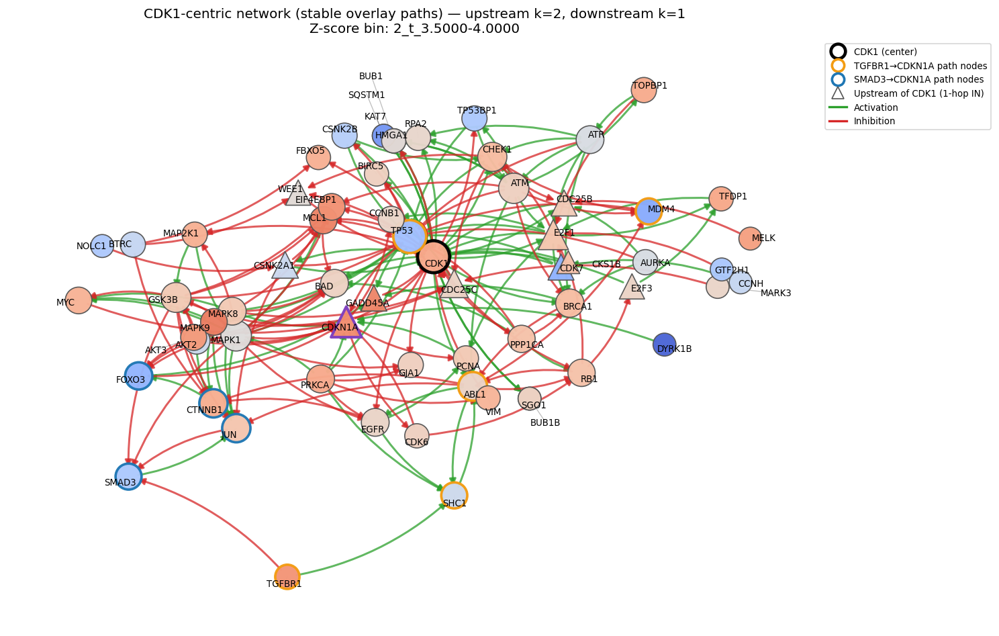

In [277]:
# === CDK1-centric, bin-stable path overlay (TGFBR1 & SMAD3/2 → CDKN1A) ===
import os
import igraph as ig
import networkx as nx
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import get_cmap
from matplotlib.lines import Line2D

# -------------------- CONFIG --------------------
CENTER_UP        = "P06493"             # CDK1 (center)
SRC1_FALLBACK_SYM= "TGFBR1"
SRC2_FALLBACK_SYM= "SMAD3"              # if not found, will try SMAD2
DST_FALLBACK_SYM = "CDKN1A"
BIN              = "2_t_3.5000-4.0000"  # one z-score column to color nodes

# CDK1 ego scope (always same across bins)
K_IN             = 2                    # upstream hops (IN)
K_OUT            = 1                    # downstream hops (OUT)
MAX_DOWNSTREAM   = 30                   # limit direct OUT neighbors kept
GLOBAL_NORM      = True                 # same color scale across all bins
CMAP_NAME        = "coolwarm"
SAVE_DIR         = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/cdk1_ego_stable"

# -------------------- HELPERS --------------------
def _safe_filename(s: str) -> str:
    return "".join(ch if (ch.isalnum() or ch in "-_.") else "_" for ch in s)

def _resolve_by_uniprot_or_symbol(G: ig.Graph, up_id: str | None, sym: str | None) -> str | None:
    """Return UniProt 'name' present in G for the given up_id or gene_symbol."""
    if up_id and up_id in G.vs["name"]:
        return up_id
    if sym and "gene_symbol" in G.vs.attributes():
        for v in G.vs:
            if v["gene_symbol"] == sym:
                return v["name"]
    return None

def _neighbors_k(G: ig.Graph, start_idx: int, k: int, mode: str) -> set[int]:
    seen, frontier = {start_idx}, {start_idx}
    reached = set()
    for _ in range(max(0, k)):
        nxt = set()
        for v in frontier:
            nxt |= set(G.neighbors(v, mode=mode))
        nxt -= seen
        if not nxt: break
        reached |= nxt
        seen |= nxt
        frontier = nxt
    return reached

def _pick_top_downstream(G: ig.Graph, t_idx: int, limit: int | None) -> list[int]:
    outs = list(G.neighbors(t_idx, mode="OUT"))
    if (limit is None) or (len(outs) <= limit):
        return outs
    deg = G.degree()
    return sorted(outs, key=lambda i: deg[i], reverse=True)[:limit]

def _absmax_for_bin(zdf: pd.DataFrame, bins: list[str] | None, global_norm: bool) -> float:
    if global_norm:
        vals = zdf[bins] if bins else zdf
        arr = np.asarray(vals.values, dtype=float)
        if arr.size == 0 or not np.isfinite(arr).any(): return 1.0
        m = float(np.nanmax(np.abs(arr)))
        return m if m > 0 else 1.0
    return None

def _canonical_unweighted_path(G: ig.Graph, src_up: str, dst_up: str) -> list[int]:
    """Choose a single deterministic shortest path (unweighted), lexicographically by UniProt IDs."""
    if src_up not in G.vs["name"] or dst_up not in G.vs["name"]:
        return []
    si, di = G.vs.find(name=src_up).index, G.vs.find(name=dst_up).index
    paths = G.get_all_shortest_paths(si, to=di, mode="OUT")  # unweighted, stable across bins
    if not paths:
        return []
    # deterministically pick the path with lexicographically smallest UniProt sequence
    seqs = [tuple(G.vs[p]["name"]) for p in paths]
    best_ix = min(range(len(paths)), key=lambda i: seqs[i])
    return paths[best_ix]

def _names(G: ig.Graph, vids: list[int]) -> list[str]:
    return [G.vs[i]["name"] for i in vids]

def _labels(G: ig.Graph, vids: list[int]) -> list[str]:
    if "gene_symbol" in G.vs.attributes():
        out = []
        for i in vids:
            sy = G.vs[i]["gene_symbol"]
            out.append(sy if sy else G.vs[i]["name"])
        return out
    return _names(G, vids)

# -------------------- RESOLVE KEY NODES ON BIG g --------------------
if CENTER_UP not in g.vs["name"]:
    raise ValueError(f"Center {CENTER_UP} not in g.vs['name'].")

center_i = g.vs.find(name=CENTER_UP).index
src1_up  = _resolve_by_uniprot_or_symbol(g, None, SRC1_FALLBACK_SYM)   # TGFBR1
src2_up  = _resolve_by_uniprot_or_symbol(g, None, SRC2_FALLBACK_SYM)   # SMAD3
if src2_up is None:
    src2_up = _resolve_by_uniprot_or_symbol(g, None, "SMAD2")          # fallback
dst_up   = _resolve_by_uniprot_or_symbol(g, None, DST_FALLBACK_SYM)    # CDKN1A
if (src1_up is None) or (dst_up is None):
    raise ValueError("Could not resolve TGFBR1 or CDKN1A on the big graph.")
if src2_up is None:
    print("⚠️ SMAD3/2 not found; only TGFBR1 path will be shown.")

# -------------------- FIXED (bin-stable) PATHS ON BIG g --------------------
p1 = _canonical_unweighted_path(g, src1_up, dst_up)          # TGFBR1 → CDKN1A
p2 = _canonical_unweighted_path(g, src2_up, dst_up) if src2_up else []

# report paths (gene_symbol(UP))
def _fmt_path(vids): 
    if not vids: return "—"
    return " → ".join(_labels(g, vids[i:i+1])[0] + f"({g.vs[vids[i]]['name']})" for i in range(len(vids)))
print("\nChosen canonical shortest paths (fixed across bins):")
print(f"  TGFBR1 → CDKN1A: { _fmt_path(p1) }")
if src2_up:
    print(f"  {g.vs.find(name=src2_up)['gene_symbol'] or src2_up} → CDKN1A: { _fmt_path(p2) }")

# path node/edge sets (by UniProt) — used as overlays inside each bin plot
path1_nodes = set(_names(g, p1))
path2_nodes = set(_names(g, p2)) if p2 else set()

# -------------------- BUILD CDK1-CENTRIC TEMPLATE NODE SET --------------------
up_inds   = _neighbors_k(g, center_i, K_IN,  mode="IN")
down_inds = set(_pick_top_downstream(g, center_i, MAX_DOWNSTREAM))
if K_OUT > 1:
    down_inds |= _neighbors_k(g, center_i, K_OUT-1, mode="OUT")

template_inds = {center_i} | set(up_inds) | set(down_inds) | {g.vs.find(name=n).index for n in (path1_nodes | path2_nodes if path2_nodes else path1_nodes) if n in g.vs["name"]}
template_subg = g.subgraph(ig.VertexSeq(g, sorted(template_inds)))

# -------------------- DRAW FOR ONE BIN (set BIN above) --------------------
if BIN not in zscore_df.columns:
    raise ValueError(f"Bin '{BIN}' not found in zscore_df.columns")

# NetworkX graph for styling
H = nx.DiGraph()
has_sym = "gene_symbol" in template_subg.vs.attributes()
has_ens = "ensembl_gene_id" in template_subg.vs.attributes()

for v in template_subg.vs:
    up  = v["name"]
    sym = v["gene_symbol"] if has_sym else up
    ens = v["ensembl_gene_id"] if has_ens else None
    H.add_node(up, label=(sym if sym else up), ensembl=ens)

etype_attr = "type" if "type" in template_subg.es.attributes() else None
for e in template_subg.es:
    s, t = e.tuple
    u, v = template_subg.vs[s]["name"], template_subg.vs[t]["name"]
    et   = (template_subg.es[e.index][etype_attr] if etype_attr else None)
    H.add_edge(u, v, type=(et or ""))

# z-score coloring
cmap = get_cmap(CMAP_NAME)
bins_for_norm = list(zscore_df.columns) if GLOBAL_NORM else [BIN]
absmax = _absmax_for_bin(zscore_df, bins_for_norm, GLOBAL_NORM)
if absmax is None:
    col = zscore_df[BIN]
    absmax = float(np.nanmax(np.abs(col.values))) or 1.0
norm = Normalize(vmin=-absmax, vmax=absmax)

def _node_color(up_name: str):
    ens = H.nodes[up_name].get("ensembl", None)
    if ens is not None and ens in zscore_df.index:
        z = zscore_df.at[ens, BIN]
        if np.isfinite(z):
            return cmap(norm(float(z)))
    return (0.92, 0.92, 0.92, 1.0)

node_colors = [_node_color(n) for n in H.nodes()]

# layout, sizes
pos   = nx.kamada_kawai_layout(H, weight=None)
deg_u = H.to_undirected().degree()
node_sizes = [300 + 120 * (max(1, deg_u[n]) ** 0.5) for n in H.nodes()]
for i, n in enumerate(H.nodes()):
    if n == CENTER_UP: node_sizes[i] = 820

# edge classes
def _sign(d: dict) -> str | None:
    s = str(d.get("type","")).lower()
    if "activ" in s or "stimulat" in s or s in {"+","pos"}: return "act"
    if "inhib" in s or "repress" in s or s in {"-","neg"}:  return "inh"
    return None
e_act = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "act"]
e_inh = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) == "inh"]
e_oth = [(u,v) for u,v,d in H.edges(data=True) if _sign(d) is None]

# upstream (1-hop IN) of CDK1 in the current subgraph
upstream_1hop = set(H.predecessors(CENTER_UP)) if CENTER_UP in H else set()

# label map
labels = {n: H.nodes[n].get("label", n) for n in H.nodes()}

# non-overlapping label positions & leader lines (deterministic around CDK1)
import random as _random
_random.seed(42)
center_xy = np.array(pos.get(CENTER_UP, (0.0, 0.0)))
def _unit(v): 
    nrm = np.linalg.norm(v) + 1e-9
    return v / nrm
min_labelsep = 0.06
initial_off  = 0.02
bump_step    = 0.02
label_pos, placed = {}, []
for n in H.nodes():
    p = np.array(pos[n])
    d = _unit(p - center_xy)
    if not np.isfinite(d).all() or np.linalg.norm(d) < 1e-6:
        d = _unit(np.array([_random.uniform(-1,1), _random.uniform(-1,1)]))
    xy = p + (initial_off + _random.uniform(0.0, 0.01)) * d
    for _ in range(100):
        ok = True
        for (x0, y0) in placed:
            if np.linalg.norm(xy - np.array([x0, y0])) < min_labelsep:
                xy = xy + bump_step * d
                ok = False
                break
        if ok: break
    label_pos[n] = (float(xy[0]), float(xy[1]))
    placed.append(label_pos[n])

# node borders (two fixed paths; stable colors)
edgecolors, linewidths, shapes = [], [], []
for n in H.nodes():
    on1 = n in path1_nodes
    on2 = n in path2_nodes
    # border color logic
    if n == CENTER_UP:
        edgecolors.append("black");     linewidths.append(2.8)
    elif on1 and on2:
        edgecolors.append("#7e3fbf");   linewidths.append(2.4)   # purple: both paths
    elif on1:
        edgecolors.append("#f39c12");   linewidths.append(2.2)   # orange: TGFBR1 path
    elif on2:
        edgecolors.append("#1f77b4");   linewidths.append(2.2)   # blue: SMAD path
    else:
        edgecolors.append("#555555");   linewidths.append(1.0)
    # shape: triangle if direct upstream of CDK1
    shapes.append("^" if n in upstream_1hop else "o")

# -------------------- DRAW --------------------
fig, ax = plt.subplots(figsize=(12.5, 8.0))

# base edges only (no path-edge highlighting)
if e_act:
    nx.draw_networkx_edges(H, pos, edgelist=e_act, edge_color="#2ca02c",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_inh:
    nx.draw_networkx_edges(H, pos, edgelist=e_inh, edge_color="#d62728",
                           arrows=True, arrowsize=12, width=1.8, alpha=0.75,
                           connectionstyle="arc3,rad=0.15", ax=ax)
if e_oth:
    nx.draw_networkx_edges(H, pos, edgelist=e_oth, edge_color="#9e9e9e",
                           arrows=True, arrowsize=10, width=1.2, alpha=0.5,
                           connectionstyle="arc3,rad=0.12", style="dashed", ax=ax)

# draw nodes by shape (circles vs triangles)
nodes_list = list(H.nodes())
for shp in {"o", "^"}:
    idx = [i for i, n in enumerate(nodes_list) if shapes[i] == shp]
    if not idx: continue
    nx.draw_networkx_nodes(
        H, pos,
        nodelist=[nodes_list[i] for i in idx],
        node_color=[node_colors[i] for i in idx],
        node_size=[node_sizes[i] for i in idx],
        node_shape=shp,
        edgecolors=[edgecolors[i] for i in idx],
        linewidths=[linewidths[i] for i in idx],
        alpha=0.97, ax=ax
    )

# leader lines + labels
for n in H.nodes():
    x0, y0 = pos[n]
    x1, y1 = label_pos[n]
    if (abs(x0 - x1) + abs(y0 - y1)) > 1e-6:
        ax.plot([x0, x1], [y0, y1], color=(0,0,0,0.25), lw=0.8, zorder=1)
nx.draw_networkx_labels(H, label_pos, labels=labels, font_size=8, ax=ax)

# colorbar
#sm = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
#sm.set_array(np.array([-absmax, absmax]))
#cbar = plt.colorbar(sm, ax=ax, shrink=0.75, pad=0.02)
#cbar.set_label(f"Z-score ({BIN})", rotation=270, labelpad=14)

# legend
src2_label = ""
if src2_up:
    src2_label = template_subg.vs.find(name=src2_up)["gene_symbol"] if "gene_symbol" in template_subg.vs.attributes() else src2_up
src1_label = template_subg.vs.find(name=src1_up)["gene_symbol"] if "gene_symbol" in template_subg.vs.attributes() else src1_up
dst_label  = template_subg.vs.find(name=dst_up)["gene_symbol"]  if "gene_symbol" in template_subg.vs.attributes() else dst_up

legend_items = [
    Line2D([0],[0], marker='o', color='w', label='CDK1 (center)', markerfacecolor='w',
           markeredgecolor='black', markeredgewidth=2.8, markersize=13),
    Line2D([0],[0], marker='o', color='w', label=f'{src1_label}→{dst_label} path nodes',
           markerfacecolor='w', markeredgecolor='#f39c12', markeredgewidth=2.2, markersize=11),
]
if src2_up:
    legend_items.append(
        Line2D([0],[0], marker='o', color='w', label=f'{src2_label}→{dst_label} path nodes',
               markerfacecolor='w', markeredgecolor='#1f77b4', markeredgewidth=2.2, markersize=11)
    )
legend_items.extend([
    Line2D([0],[0], marker='^', color='w', label='Upstream of CDK1 (1-hop IN)',
           markerfacecolor='w', markeredgecolor='#555555', markeredgewidth=1.0, markersize=11),
    Line2D([0],[0], color="#2ca02c", lw=2.0, label='Activation'),
    Line2D([0],[0], color="#d62728", lw=2.0, label='Inhibition'),
])
ax.legend(handles=legend_items, fontsize=8, loc="upper left", bbox_to_anchor=(1,1))

ax.set_title(
    f"CDK1-centric network (stable overlay paths) — upstream k={K_IN}, downstream k={K_OUT}\n"
    f"Z-score bin: {BIN}", fontsize=12
)
ax.axis("off")
plt.tight_layout()

# save with bin in filename
os.makedirs(SAVE_DIR, exist_ok=True)
safe_bin = _safe_filename(BIN)
safe_src1 = _safe_filename(src1_label)
safe_src2 = _safe_filename(src2_label) if src2_up else "NA"
safe_dst  = _safe_filename(dst_label)
out_path = os.path.join(SAVE_DIR, f"cdk1_center__{safe_src1}_and_{safe_src2}__to__{safe_dst}__{safe_bin}.png")
plt.savefig(out_path, dpi=220, bbox_inches="tight")
print(f"💾 Saved figure → {out_path}")


Using subnetwork for bin 2_t_3.5000-4.0000 (nodes=236, edges=312).
Mapped/retained Ensembl IDs on selected graph: 208/236 (88.1%)
💾 Saved table → /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/supplement/cdk1_downstream_top30__2_t_3.5000-4.0000.tsv


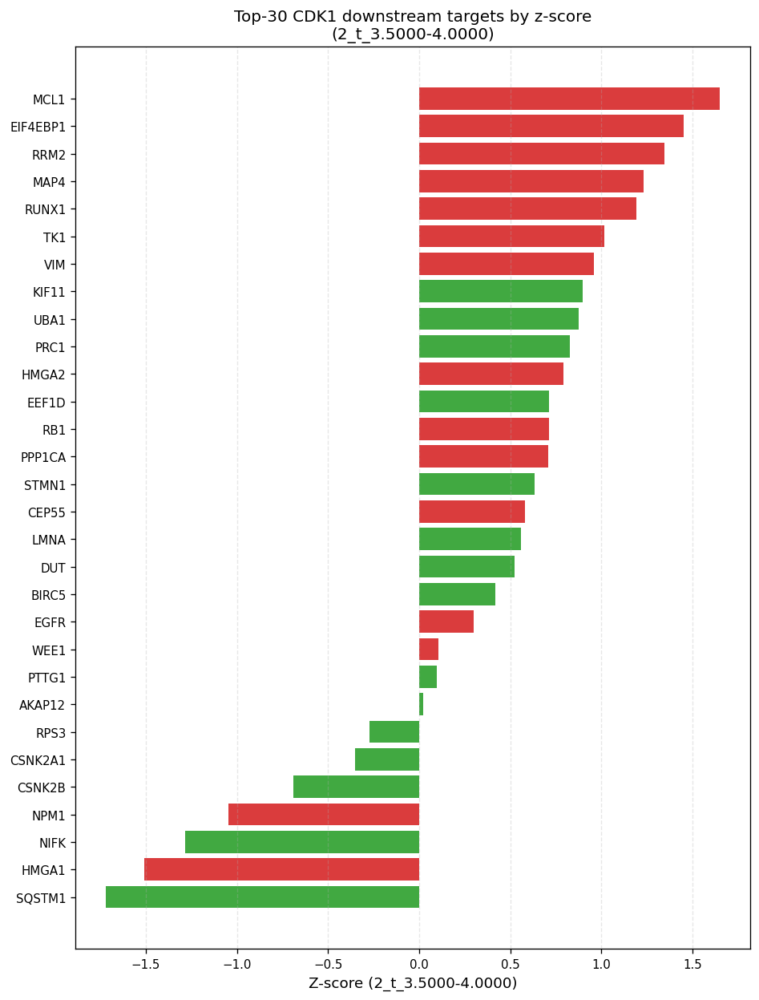

🖼️ Saved figure → /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/supplement/cdk1_downstream_top30__2_t_3.5000-4.0000.png

Top rows:
   uniprot gene_symbol  ensembl_gene_id   edge_type  zscore_2_t_3.5000-4.0000
0   Q07820        MCL1  ENSG00000143384  inhibition                  1.648617
1   Q13541    EIF4EBP1  ENSG00000187840  inhibition                  1.451877
2   P31350        RRM2  ENSG00000171848  inhibition                  1.346085
3   P27816        MAP4  ENSG00000047849  inhibition                  1.230631
4   Q01196       RUNX1  ENSG00000159216  inhibition                  1.194530
5   P04183         TK1  ENSG00000167900  inhibition                  1.015625
6   P08670         VIM  ENSG00000026025  inhibition                  0.957344
7   P52732       KIF11  ENSG00000138160  activation                  0.896560
8   P22314        UBA1  ENSG00000130985  activation                  0.875701
9   O43663        PRC1  ENSG00000198901  activation                  0

In [281]:
# --- CDK1 downstream targets ranked by z-score at a given bin (robust mapping) ---
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ===== Config =====
TARGET_UP   = "P06493"                         # CDK1 UniProt
BIN         = "2_t_3.5000-4.0000"              # z-score column to use
TOP_N       = 30                                # how many to show/save
OUT_DIR     = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/supplement"
MAKE_FIGURE = True                              # set False if you only want the table

# ===== Helpers =====
def _safe_filename(s: str) -> str:
    return "".join(ch if (ch.isalnum() or ch in "-_.") else "_" for ch in s)

def _choose_graph_for_bin(BIN):
    if 'group_graphs' in globals() and isinstance(group_graphs, dict) and BIN in group_graphs:
        Gbin = group_graphs[BIN]
        print(f"Using subnetwork for bin {BIN} (nodes={Gbin.vcount()}, edges={Gbin.ecount()}).")
    else:
        Gbin = g
        print(f"Bin {BIN} not in group_graphs; using BIG graph (nodes={Gbin.vcount()}, edges={Gbin.ecount()}).")
    return Gbin

def _build_maps_from_big(g_big, zidx=None):
    """Return UniProt->Ensembl map, and gene_symbol->set(Ensembl) map from BIG graph."""
    up2ens = {}
    sym2ens = {}
    has_list = "ensembl_gene_id_list" in g_big.vs.attributes()
    for v in g_big.vs:
        up  = v["name"]
        ens = v["ensembl_gene_id"] if "ensembl_gene_id" in v.attributes() else None
        if not ens and has_list:
            lst = v["ensembl_gene_id_list"]
            if isinstance(lst, (list, tuple)) and lst:
                # prefer one that exists in z-score index if provided
                if zidx is not None:
                    cand = next((x for x in lst if x in zidx), None)
                    ens = cand or lst[0]
                else:
                    ens = lst[0]
        if ens:
            up2ens[up] = ens
            if "gene_symbol" in v.attributes() and v["gene_symbol"]:
                sym2ens.setdefault(v["gene_symbol"], set()).add(ens)
    return up2ens, sym2ens

def _ensure_ensembl_on_graph(G, g_big, zscore_df):
    """Add/repair 'ensembl_gene_id' on G by mapping from BIG g and local attributes."""
    if "ensembl_gene_id" in G.vs.attributes():
        # Still try to fill empties if present
        current = G.vs["ensembl_gene_id"]
        need = any((x is None) or (x == "") for x in current)
        if not need:
            return

    zidx = set(zscore_df.index)
    up2ens_big, sym2ens_big = _build_maps_from_big(g_big, zidx=zidx)
    has_list = "ensembl_gene_id_list" in G.vs.attributes()
    has_sym  = "gene_symbol" in G.vs.attributes()

    ens_out = []
    fixed, total = 0, G.vcount()
    for v in G.vs:
        ens = v["ensembl_gene_id"] if "ensembl_gene_id" in v.attributes() else None
        if ens:
            ens_out.append(ens)
            continue

        # 1) From local list
        if not ens and has_list:
            lst = v["ensembl_gene_id_list"]
            if isinstance(lst, (list, tuple)) and lst:
                cand = next((x for x in lst if x in zidx), None)
                ens = cand or lst[0]

        # 2) From BIG by UniProt
        if not ens and v["name"] in up2ens_big:
            ens = up2ens_big[v["name"]]

        # 3) From BIG by unique gene_symbol
        if not ens and has_sym and v["gene_symbol"]:
            s = v["gene_symbol"]
            if s in sym2ens_big and len(sym2ens_big[s]) == 1:
                ens = next(iter(sym2ens_big[s]))

        ens_out.append(ens)
        if ens:
            fixed += 1

    G.vs["ensembl_gene_id"] = ens_out
    ok = sum(1 for x in ens_out if x)
    print(f"Mapped/retained Ensembl IDs on selected graph: {ok}/{total} ({ok/total:.1%})")

# ===== RUN =====
Gbin = _choose_graph_for_bin(BIN)

if TARGET_UP not in Gbin.vs["name"]:
    raise ValueError(f"CDK1 ({TARGET_UP}) not present in selected graph for bin '{BIN}'.")
if BIN not in zscore_df.columns:
    raise ValueError(f"Bin '{BIN}' not found in zscore_df.columns")

# Ensure Ensembl IDs exist (add if missing)
_ensure_ensembl_on_graph(Gbin, g, zscore_df)

# ===== Collect direct OUT neighbors of CDK1 in this graph =====
t_idx = Gbin.vs.find(name=TARGET_UP).index
downs = list(Gbin.neighbors(t_idx, mode="OUT"))

rows = []
has_sym = "gene_symbol" in Gbin.vs.attributes()
has_typ = "type" in Gbin.es.attributes()

for j in downs:
    v = Gbin.vs[j]
    up  = v["name"]
    sym = v["gene_symbol"] if has_sym else ""
    ens = v["ensembl_gene_id"] if "ensembl_gene_id" in v.attributes() else None

    # edge type (activation/inhibition/…); handle multi-edges safely
    eids = Gbin.get_eids(pairs=[(t_idx, j)], directed=True, error=False)
    if isinstance(eids, list):
        etypes = [Gbin.es[e]["type"] for e in eids if has_typ]
        etype  = etypes[0] if etypes else ""
    elif eids == -1:
        etype = ""
    else:
        etype = Gbin.es[eids]["type"] if has_typ else ""

    z = zscore_df.at[ens, BIN] if (ens in zscore_df.index) else np.nan

    rows.append({
        "uniprot": up,
        "gene_symbol": sym if sym else up,
        "ensembl_gene_id": ens if ens else "",
        "edge_type": etype,
        f"zscore_{BIN}": float(z) if np.isfinite(z) else np.nan,
    })

df = pd.DataFrame(rows)

# If some downstreams lack z-score, keep them but sort to the bottom
sort_col = f"zscore_{BIN}"
df["_sort_z"] = df[sort_col].fillna(-np.inf)
df = df.sort_values("_sort_z", ascending=False).drop(columns="_sort_z")

# Limit to TOP_N
df_top = df.head(TOP_N).reset_index(drop=True)

# ===== Save table =====
os.makedirs(OUT_DIR, exist_ok=True)
safe_bin = _safe_filename(BIN)
tsv_path = os.path.join(OUT_DIR, f"cdk1_downstream_top{TOP_N}__{safe_bin}.tsv")
df_top.to_csv(tsv_path, sep="\t", index=False)
print(f"💾 Saved table → {tsv_path}")

# ===== Optional: make a clean supplementary bar plot =====
if MAKE_FIGURE and not df_top.empty:
    fig, ax = plt.subplots(figsize=(8, max(3, 0.35*len(df_top))))
    ylabels = df_top["gene_symbol"].astype(str).tolist()
    zvals   = df_top[sort_col].values

    # color bars by edge_type for a quick visual cue (green/red/grey)
    def _bar_color(et):
        s = (et or "").lower()
        if "activ" in s or s in {"+", "pos"}: return "#2ca02c"
        if "inhib" in s or s in {"-", "neg", "repress"}: return "#d62728"
        return "#7a7a7a"
    colors = [_bar_color(et) for et in df_top["edge_type"]]

    ax.barh(range(len(df_top)), zvals, color=colors, alpha=0.9)
    ax.set_yticks(range(len(df_top)))
    ax.set_yticklabels(ylabels, fontsize=9)
    ax.invert_yaxis()
    ax.set_xlabel(f"Z-score ({BIN})")
    ax.set_title(f"Top-{TOP_N} CDK1 downstream targets by z-score\n({BIN})")
    ax.grid(axis="x", linestyle="--", alpha=0.3)

    fig.tight_layout()
    fig_path = os.path.join(OUT_DIR, f"cdk1_downstream_top{TOP_N}__{safe_bin}.png")
    plt.savefig(fig_path, dpi=220, bbox_inches="tight")
    plt.show()
    print(f"🖼️ Saved figure → {fig_path}")

# Peek in notebook
print("\nTop rows:")
print(df_top.head(min(50, TOP_N)))


Using subnetwork for bin 2_t_3.5000-4.0000 (nodes=236, edges=312).
Mapped/retained Ensembl IDs on selected graph: 208/236 (88.1%)
💾 Saved table → /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/supplement/cdk1_downstream_hops2_top30__2_t_3.5000-4.0000.tsv


/tmp/ipykernel_270652/3877943778.py:110: DeprecationWarning: Graph.shortest_paths() is deprecated; use Graph.distances() instead
  dist = Gbin.shortest_paths(source=t_idx, mode="OUT")[0]   # list of distances (inf if unreachable)


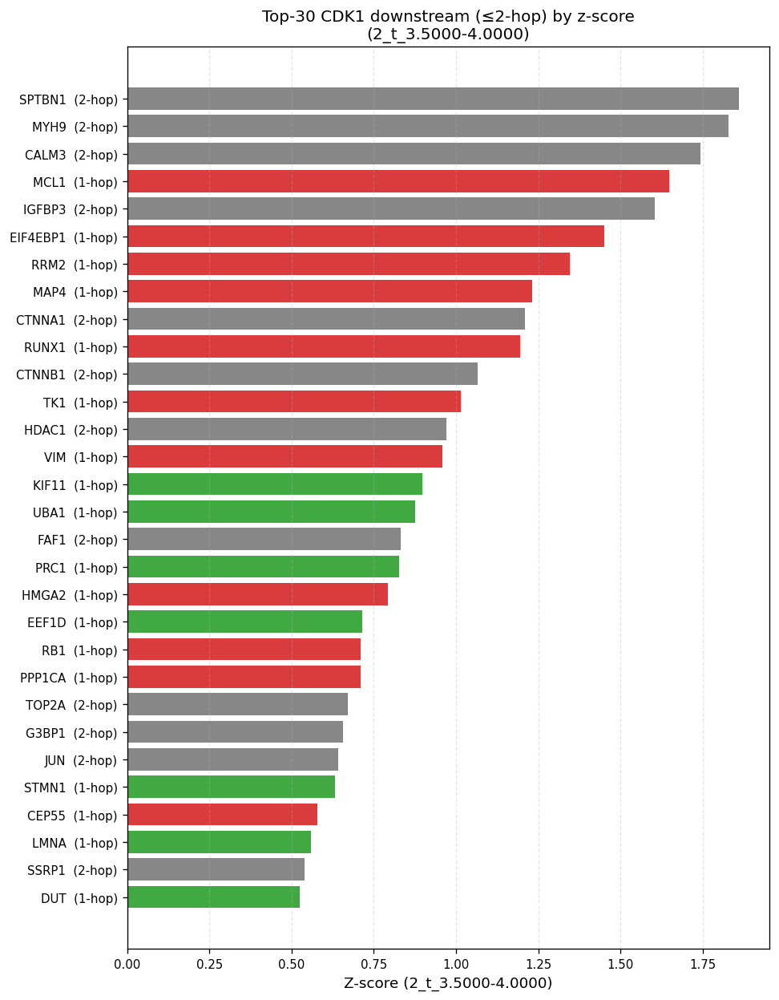

🖼️ Saved figure → /bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/supplement/cdk1_downstream_hops2_top30__2_t_3.5000-4.0000.png

Top rows:
   uniprot gene_symbol  ensembl_gene_id  hop   edge_type  \
0   Q01082      SPTBN1  ENSG00000115306    2     two-hop   
1   P35579        MYH9  ENSG00000100345    2     two-hop   
2   P0DP24       CALM3  ENSG00000143933    2     two-hop   
3   Q07820        MCL1  ENSG00000143384    1  inhibition   
4   P17936      IGFBP3  ENSG00000146674    2     two-hop   
5   Q13541    EIF4EBP1  ENSG00000187840    1  inhibition   
6   P31350        RRM2  ENSG00000171848    1  inhibition   
7   P27816        MAP4  ENSG00000047849    1  inhibition   
8   P35221      CTNNA1  ENSG00000044115    2     two-hop   
9   Q01196       RUNX1  ENSG00000159216    1  inhibition   
10  P35222      CTNNB1  ENSG00000168036    2     two-hop   
11  P04183         TK1  ENSG00000167900    1  inhibition   
12  Q13547       HDAC1  ENSG00000116478    2     two-hop   
13  

In [286]:
# --- CDK1 downstream (1-hop + 2-hop) ranked by z-score at a given bin (robust mapping) ---
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ===== Config =====
TARGET_UP   = "P06493"                         # CDK1 UniProt
BIN         = "2_t_3.5000-4.0000"              # z-score column to use
TOP_N       = 30                               # how many to show/save
INCLUDE_HOPS = 2                               # include nodes at OUT-distance 1..INCLUDE_HOPS
OUT_DIR     = "/bigstorage/users/job37yv/Projects/PANC_cancer/analysis/omnipath/supplement"
MAKE_FIGURE = True                             # set False if you only want the table

# ===== Helpers =====
def _safe_filename(s: str) -> str:
    return "".join(ch if (ch.isalnum() or ch in "-_.") else "_" for ch in s)

def _choose_graph_for_bin(BIN):
    if 'group_graphs' in globals() and isinstance(group_graphs, dict) and BIN in group_graphs:
        Gbin = group_graphs[BIN]
        print(f"Using subnetwork for bin {BIN} (nodes={Gbin.vcount()}, edges={Gbin.ecount()}).")
    else:
        Gbin = g
        print(f"Bin {BIN} not in group_graphs; using BIG graph (nodes={Gbin.vcount()}, edges={Gbin.ecount()}).")
    return Gbin

def _build_maps_from_big(g_big, zidx=None):
    """Return UniProt->Ensembl map, and gene_symbol->set(Ensembl) map from BIG graph."""
    up2ens = {}
    sym2ens = {}
    has_list = "ensembl_gene_id_list" in g_big.vs.attributes()
    for v in g_big.vs:
        up  = v["name"]
        ens = v["ensembl_gene_id"] if "ensembl_gene_id" in v.attributes() else None
        if not ens and has_list:
            lst = v["ensembl_gene_id_list"]
            if isinstance(lst, (list, tuple)) and lst:
                if zidx is not None:
                    cand = next((x for x in lst if x in zidx), None)
                    ens = cand or lst[0]
                else:
                    ens = lst[0]
        if ens:
            up2ens[up] = ens
            if "gene_symbol" in v.attributes() and v["gene_symbol"]:
                sym2ens.setdefault(v["gene_symbol"], set()).add(ens)
    return up2ens, sym2ens

def _ensure_ensembl_on_graph(G, g_big, zscore_df):
    """Add/repair 'ensembl_gene_id' on G by mapping from BIG g and local attributes."""
    if "ensembl_gene_id" in G.vs.attributes():
        current = G.vs["ensembl_gene_id"]
        need = any((x is None) or (x == "") for x in current)
        if not need:
            return

    zidx = set(zscore_df.index)
    up2ens_big, sym2ens_big = _build_maps_from_big(g_big, zidx=zidx)
    has_list = "ensembl_gene_id_list" in G.vs.attributes()
    has_sym  = "gene_symbol" in G.vs.attributes()

    ens_out = []
    fixed, total = 0, G.vcount()
    for v in G.vs:
        ens = v["ensembl_gene_id"] if "ensembl_gene_id" in v.attributes() else None
        if ens:
            ens_out.append(ens)
            continue

        # 1) From local list
        if not ens and has_list:
            lst = v["ensembl_gene_id_list"]
            if isinstance(lst, (list, tuple)) and lst:
                cand = next((x for x in lst if x in zidx), None)
                ens = cand or lst[0]

        # 2) From BIG by UniProt
        if not ens and v["name"] in up2ens_big:
            ens = up2ens_big[v["name"]]

        # 3) From BIG by unique gene_symbol
        if not ens and has_sym and v["gene_symbol"]:
            s = v["gene_symbol"]
            if s in sym2ens_big and len(sym2ens_big[s]) == 1:
                ens = next(iter(sym2ens_big[s]))

        ens_out.append(ens)
        if ens:
            fixed += 1

    G.vs["ensembl_gene_id"] = ens_out
    ok = sum(1 for x in ens_out if x)
    print(f"Mapped/retained Ensembl IDs on selected graph: {ok}/{total} ({ok/total:.1%})")

# ===== RUN =====
Gbin = _choose_graph_for_bin(BIN)

if TARGET_UP not in Gbin.vs["name"]:
    raise ValueError(f"CDK1 ({TARGET_UP}) not present in selected graph for bin '{BIN}'.")
if BIN not in zscore_df.columns:
    raise ValueError(f"Bin '{BIN}' not found in zscore_df.columns")

# Ensure Ensembl IDs exist (add if missing)
_ensure_ensembl_on_graph(Gbin, g, zscore_df)

# ===== Collect 1..INCLUDE_HOPS downstream of CDK1 =====
t_idx = Gbin.vs.find(name=TARGET_UP).index
# shortest path distances from CDK1 (OUT)
dist = Gbin.shortest_paths(source=t_idx, mode="OUT")[0]   # list of distances (inf if unreachable)

# indices at distance 1..INCLUDE_HOPS (exclude the source itself)
down_ix = [i for i,d in enumerate(dist) if (i != t_idx and np.isfinite(d) and 1 <= int(d) <= int(INCLUDE_HOPS))]

rows = []
has_sym = "gene_symbol" in Gbin.vs.attributes()
has_typ = "type" in Gbin.es.attributes()

for j in down_ix:
    v   = Gbin.vs[j]
    hop = int(dist[j])
    up  = v["name"]
    sym = v["gene_symbol"] if has_sym else ""
    ens = v["ensembl_gene_id"] if "ensembl_gene_id" in v.attributes() else None

    # For hop=1 we can report the direct edge type; for hop>=2 mark as "two-hop"
    if hop == 1:
        eids = Gbin.get_eids(pairs=[(t_idx, j)], directed=True, error=False)
        if isinstance(eids, list):
            etypes = [Gbin.es[e]["type"] for e in eids if has_typ]
            etype  = etypes[0] if etypes else ""
        elif eids == -1:
            etype = ""
        else:
            etype = Gbin.es[eids]["type"] if has_typ else ""
    else:
        etype = "two-hop"

    z = zscore_df.at[ens, BIN] if (ens in zscore_df.index) else np.nan

    rows.append({
        "uniprot": up,
        "gene_symbol": sym if sym else up,
        "ensembl_gene_id": ens if ens else "",
        "hop": hop,                    # 1 or 2
        "edge_type": etype,            # direct type for hop=1; "two-hop" otherwise
        f"zscore_{BIN}": float(z) if np.isfinite(z) else np.nan,
    })

df = pd.DataFrame(rows)

# Sort: highest z-score first; tie-break by hop (prefer 1-hop)
sort_col = f"zscore_{BIN}"
df["_sort_z"] = df[sort_col].fillna(-np.inf)
df = df.sort_values(by=["_sort_z", "hop"], ascending=[False, True]).drop(columns="_sort_z")

# Limit to TOP_N
df_top = df.head(TOP_N).reset_index(drop=True)

# ===== Save table =====
os.makedirs(OUT_DIR, exist_ok=True)
safe_bin = _safe_filename(BIN)
tsv_path = os.path.join(OUT_DIR, f"cdk1_downstream_hops{INCLUDE_HOPS}_top{TOP_N}__{safe_bin}.tsv")
df_top.to_csv(tsv_path, sep="\t", index=False)
print(f"💾 Saved table → {tsv_path}")

# ===== Optional: clean supplementary bar plot =====
if MAKE_FIGURE and not df_top.empty:
    fig, ax = plt.subplots(figsize=(8.2, max(3, 0.35*len(df_top))))
    ylabels = (df_top["gene_symbol"].astype(str) + "  (" + df_top["hop"].astype(str) + "-hop)").tolist()
    zvals   = df_top[sort_col].values

    # color bars by edge_type (activation=green, inhibition=red, others/2-hop=grey)
    def _bar_color(et):
        s = (et or "").lower()
        if "activ" in s or s in {"+", "pos"}: return "#2ca02c"
        if "inhib" in s or s in {"-", "neg", "repress"}: return "#d62728"
        return "#7a7a7a"  # includes "two-hop" or unknown

    colors = [_bar_color(et) for et in df_top["edge_type"]]

    ax.barh(range(len(df_top)), zvals, color=colors, alpha=0.9)
    ax.set_yticks(range(len(df_top)))
    ax.set_yticklabels(ylabels, fontsize=9)
    ax.invert_yaxis()
    ax.set_xlabel(f"Z-score ({BIN})")
    ax.set_title(f"Top-{TOP_N} CDK1 downstream (≤{INCLUDE_HOPS}-hop) by z-score\n({BIN})")
    ax.grid(axis="x", linestyle="--", alpha=0.3)

    fig.tight_layout()
    fig_path = os.path.join(OUT_DIR, f"cdk1_downstream_hops{INCLUDE_HOPS}_top{TOP_N}__{safe_bin}.png")
    plt.savefig(fig_path, dpi=220, bbox_inches="tight")
    plt.show()
    print(f"🖼️ Saved figure → {fig_path}")

# Peek in notebook
print("\nTop rows:")
print(df_top.head(min(50, TOP_N)))


## 11.7 shortest path from source to target

In [1458]:
nxg

In [1461]:
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.colors import rgb2hex

# 1) Build a directed NetworkX graph from your igraph `g`
nxg = nx.DiGraph()
# assume symbol_map: UniProtID → gene_symbol
for v in g.vs:
    up = v["name"]
    nxg.add_node(up,
                 gene_symbol=symbol_map.get(up, up),
                 module=v["modules"])
for e in g.es:
    src = g.vs[e.tuple[0]]["name"]
    tgt = g.vs[e.tuple[1]]["name"]
    nxg.add_edge(src, tgt, type=e["type"])

# 2) define your sources and targets
sources = ['P68400','P30291']
targets      = ['P06493']

# 3) search for shortest paths (directed first, then undirected as fallback)
all_paths = []
for r in sources:
    for h in taregts:
        try:
            # directed path
            p = nx.shortest_path(nxg, sources=r, targets=h)
            all_paths.append(p)
        except nx.NetworkXNoPath:
            try:
                # try undirected
                p = nx.shortest_path(nxg.to_undirected(), sources=r, targets=h)
                all_paths.append(p)
            except nx.NetworkXNoPath:
                continue

if not all_paths:
    print("No sources→targets paths found (even undirected).")
else:
    # flatten to set of nodes & edges
    path_nodes = set(sum(all_paths, []))
    path_edges = set()
    for p in all_paths:
        for u,v in zip(p, p[1:]):
            path_edges.add((u,v))
    
    # 4) induce the subgraph
    subg = nxg.subgraph(path_nodes).copy()
    pos  = nx.spring_layout(subg, seed=42)
    
    # 5) prepare edge colors by type
    edge_colors = []
    for u,v in subg.edges():
        t = None
        if nxg.has_edge(u,v):
            t = nxg[u][v]['type']
        elif nxg.has_edge(v,u):
            t = nxg[v][u]['type']
        edge_colors.append("green" if t=="activation" else
                           "red"   if t=="inhibition" else
                           "gray")
    
    # 6) draw
    plt.figure(figsize=(8,8))
    # edges
    nx.draw_networkx_edges(subg, pos,
                           edgelist=list(path_edges),
                           edge_color=edge_colors,
                           arrowstyle='-|>',
                           arrowsize=12,
                           width=2,
                           alpha=0.8)
    # nodes
    # color sources vs targets vs intermediates
    node_color = []
    for n in subg.nodes():
        if n in sources:
            node_color.append("yellow")
        elif n in targets:
            node_color.append("cyan")
        else:
            node_color.append("lightgray")
    nx.draw_networkx_nodes(subg, pos,
                           node_color=node_color,
                           node_size=300,
                           edgecolors="k")
    # labels
    labels = { n: subg.nodes[n]["gene_symbol"] for n in subg.nodes() }
    nx.draw_networkx_labels(subg, pos, labels, font_size=8)
    
    plt.title("Shortest sources→targets paths")
    plt.axis("off")
    plt.tight_layout()
    plt.show()


KeyError: 'Attribute does not exist'

## 11.8. Draw: Shortest-Path Summary Network (CDK1-centric, UniProt IDs)

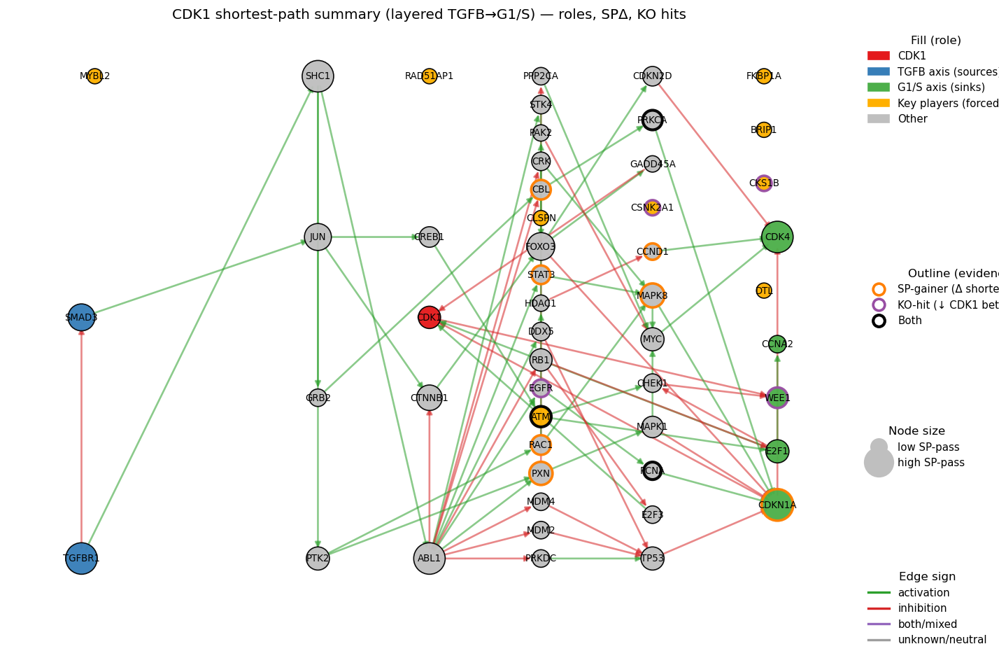

In [1685]:
# ==== Layered layout + full legend (gene-symbol labels + activation/inhibition edges) ====
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.lines import Line2D
import networkx as nx

EDGE_MODE = "sp_only"   # "sp_only" draws only union-of-shortest-path edges (recommended); use "all" for all edges

# --- Build an SP-only NetworkX graph (less clutter) ---------------------------
# Convert Eset (vid tuples) to UniProt tuples:
name2vid = {v["name"]: i for i, v in enumerate(g.vs)}  # on the BIG graph
vid2name = {i: v["name"] for i, v in enumerate(g.vs)}

# If you kept Eset from earlier, reuse it; otherwise reconstruct quickly:
try:
    Eset  # noqa: F821
except NameError:
    Eset = set()
    # (Optional) rebuild Eset from your SP collector if needed.

H = nx.DiGraph()
H.add_nodes_from([v["name"] for v in Gsp.vs])
if EDGE_MODE == "sp_only" and len(Eset) > 0:
    H.add_edges_from([(vid2name[s], vid2name[t]) for (s, t) in Eset
                      if vid2name[s] in H and vid2name[t] in H])
else:
    # all edges among nodes in the SP subgraph
    for e in Gsp.es:
        s, t = e.tuple
        us, ut = Gsp.vs[s]["name"], Gsp.vs[t]["name"]
        H.add_edge(us, ut)

# --- Annotate nodes with gene symbols ----------------------------------------
up2sym = {}
for v in Gsp.vs:
    sy = v["gene_symbol"] if "gene_symbol" in v.attributes() else None
    up2sym[v["name"]] = sy if (sy and len(sy)) else v["name"]
nx.set_node_attributes(H, up2sym, "gene_symbol")

def label_for(u):
    return H.nodes[u].get("gene_symbol", u) or u

# --- Edge sign → color mapping (activation/inhibition) ------------------------
EDGE_SIGN_ATTR_CANDIDATES = ["sign", "effect", "interaction", "type", "polarity"]

def _pick_edge_sign_attr(Gi):
    attrs = set(Gi.es.attributes())
    for cand in EDGE_SIGN_ATTR_CANDIDATES:
        if cand in attrs:
            return cand
    return None

def _parse_sign(val):
    """Return 'act', 'inh', 'both', or None from common encodings."""
    if val is None:
        return None
    # numeric encodings
    if isinstance(val, (int, float)):
        if val > 0:  return "act"
        if val < 0:  return "inh"
        return None
    # list/tuple encodings
    if isinstance(val, (list, tuple, set)):
        vals = " ".join(map(str, val)).lower()
    else:
        vals = str(val).lower()

    is_act = any(k in vals for k in ["activ", "pos", "+", "stimulat", "phospho+"])
    is_inh = any(k in vals for k in ["inhib", "neg", "-", "repress", "block", "phospho-"])
    if is_act and is_inh: return "both"
    if is_act:            return "act"
    if is_inh:            return "inh"
    return None

edge_sign_attr = _pick_edge_sign_attr(Gsp)
sign_map = {}
if edge_sign_attr is not None:
    for e in Gsp.es:
        s, t = e.tuple
        u, v = Gsp.vs[s]["name"], Gsp.vs[t]["name"]
        sign_map[(u, v)] = _parse_sign(e[edge_sign_attr])

def _edge_color(sig):
    if sig == "act":  return "#2ca02c"  # green
    if sig == "inh":  return "#d62728"  # red
    if sig == "both": return "#9467bd"  # purple (mixed)
    return "#9e9e9e"                    # gray (unknown)

edges = list(H.edges())
edge_colors = [_edge_color(sign_map.get((u, v))) for (u, v) in edges]

# --- Layered (left→right) coordinates based on directed distances -------------
# x ~ d_src / (d_src + d_snk); sources near 0, sinks near 1, CDK1 ~ 0.5
name2vid = {v["name"]: i for i, v in enumerate(g.vs)}  # UniProt -> vertex id

def min_dsrc_dnsnk_positions(G_big, nodes, src_ids, snk_ids):
    """
    x-position = d(src→node) / ( d(src→node) + d(node→sink) )
    Robust to missing nodes, empty sources/sinks, and INF distances.
    """
    present = [n for n in nodes if n in name2vid]
    if not present:
        return {n: 0.5 for n in nodes}

    tgt_vids = [name2vid[n] for n in present]
    src_vids = [name2vid[s] for s in src_ids if s in name2vid]
    snk_vids = [name2vid[t] for t in snk_ids if t in name2vid]

    if src_vids:
        d_src_to_node = np.array(G_big.distances(source=src_vids, target=tgt_vids, mode="OUT"), dtype=float)
        dsrc = d_src_to_node.min(axis=0)
    else:
        dsrc = np.full(len(present), np.inf)

    if snk_vids:
        d_node_to_sink = np.array(G_big.distances(source=tgt_vids, target=snk_vids, mode="OUT"), dtype=float)
        dns  = d_node_to_sink.min(axis=1)
    else:
        dns  = np.full(len(present), np.inf)

    INF = 1e12
    dsrc[~np.isfinite(dsrc)] = INF
    dns[~np.isfinite(dns)]   = INF

    x = np.zeros(len(present), dtype=float)
    for i in range(len(present)):
        s = dsrc[i]; t = dns[i]
        if s >= INF and t >= INF:
            xi = 0.5
        elif s >= INF:
            xi = 0.92
        elif t >= INF:
            xi = 0.08
        else:
            xi = s / max(1e-9, s + t)
        x[i] = np.clip(xi, 0.05, 0.95)

    xs = {n: 0.5 for n in nodes}
    for n, xi in zip(present, x):
        xs[n] = float(xi)
    return xs

nodes = list(H.nodes())
xpos  = min_dsrc_dnsnk_positions(g, nodes, src, snk)

# Assign y by bins of x (7 layers) to avoid collisions
layers = np.clip((np.array([xpos[n] for n in nodes]) * 6).round().astype(int), 0, 6)
bin_to_nodes = {}
for n, L in zip(nodes, layers):
    bin_to_nodes.setdefault(L, []).append(n)

pos = {}
for L, ns in bin_to_nodes.items():
    ys = np.linspace(-1, 1, max(2, len(ns)))
    xs = np.full(len(ns), (L / 6.0))
    for n, x, y in zip(ns, xs, ys):
        pos[n] = (float(x), float(y))

# Nudge key roles a little for clarity
for n in nodes:
    if n in src:
        pos[n] = (pos[n][0] - 0.02, pos[n][1])
    if n in snk:
        pos[n] = (pos[n][0] + 0.02, pos[n][1])
    if n == PRIMARY_TARGET:
        pos[n] = (0.5, 0.0)

# --- Styling (same semantics as before) ---------------------------------------
# sizes by SP pass count (with clipping)
pc_map = {v["name"]: v["sp_pass_count"] for v in Gsp.vs}
pc_vals = [pc_map.get(n, 0) for n in nodes]
pc_clip = [min(20, int(x)) for x in pc_vals]
sizes   = [170 + 28*c for c in pc_clip]

def fill_color(n):
    if n == PRIMARY_TARGET: return "#e41a1c"  # red
    if n in src:            return "#377eb8"  # blue
    if n in snk:            return "#4daf4a"  # green
    if n in keys:           return "#ffb000"  # amber
    return "#bfbfbf"                        # gray

colors = [fill_color(n) for n in nodes]

# outline by SP-gain / KO-hit
edgecolors = []
linewidths = []
for n in nodes:
    sp = (n in spg)
    ko = (n in koh)
    if sp and ko:
        edgecolors.append("black");    linewidths.append(2.5)
    elif sp:
        edgecolors.append("#ff7f00");  linewidths.append(2.2)
    elif ko:
        edgecolors.append("#984ea3");  linewidths.append(2.2)
    else:
        edgecolors.append("none");     linewidths.append(1.0)

plt.figure(figsize=(12, 8))

# edges (now colored by sign)
nx.draw_networkx_edges(
    H, pos,
    edgelist=edges,
    edge_color=edge_colors,
    alpha=0.55,
    arrows=True, arrowsize=10,
    width=1.6
)

# nodes
nx.draw_networkx_nodes(
    H, pos,
    nodelist=nodes,
    node_size=sizes,
    node_color=colors,
    edgecolors=edgecolors,
    linewidths=linewidths,
    alpha=0.96
)
nx.draw_networkx_labels(H, pos, labels={n: label_for(n) for n in nodes}, font_size=8)

# --- Legend -------------------------------------------------------------------
fill_leg = [
    mpatches.Patch(color="#e41a1c", label="CDK1"),
    mpatches.Patch(color="#377eb8", label="TGFB axis (sources)"),
    mpatches.Patch(color="#4daf4a", label="G1/S axis (sinks)"),
    mpatches.Patch(color="#ffb000", label="Key players (forced)"),
    mpatches.Patch(color="#bfbfbf", label="Other"),
]
outline_leg = [
    Line2D([0], [0], marker='o', color='w', label='SP-gainer (Δ shortest-path)',
           markerfacecolor='none', markeredgecolor='#ff7f00', markeredgewidth=2.2, markersize=10),
    Line2D([0], [0], marker='o', color='w', label='KO-hit (↓ CDK1 betweenness)',
           markerfacecolor='none', markeredgecolor='#984ea3', markeredgewidth=2.2, markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Both',
           markerfacecolor='none', markeredgecolor='black', markeredgewidth=2.5, markersize=10),
]
# size legend (SP-pass count proxy)
size_leg = [
    Line2D([0], [0], marker='o', color='w', label='low SP-pass',
           markerfacecolor='#bfbfbf', markeredgecolor='none', markersize=(170+28*2)**0.5),
    Line2D([0], [0], marker='o', color='w', label='high SP-pass',
           markerfacecolor='#bfbfbf', markeredgecolor='none', markersize=(170+28*18)**0.5),
]
# edge-sign legend
edge_sign_leg = [
    Line2D([0],[0], color="#2ca02c", lw=2, label="activation"),
    Line2D([0],[0], color="#d62728", lw=2, label="inhibition"),
    Line2D([0],[0], color="#9467bd", lw=2, label="both/mixed"),
    Line2D([0],[0], color="#9e9e9e", lw=2, label="unknown/neutral"),
]

leg1 = plt.legend(handles=fill_leg, loc='upper left', bbox_to_anchor=(1.01, 1.00), frameon=False, title="Fill (role)")
plt.gca().add_artist(leg1)
leg2 = plt.legend(handles=outline_leg, loc='upper left', bbox_to_anchor=(1.01, 0.60), frameon=False, title="Outline (evidence)")
plt.gca().add_artist(leg2)
leg3 = plt.legend(handles=size_leg, loc='upper left', bbox_to_anchor=(1.01, 0.33), frameon=False, title="Node size")
plt.gca().add_artist(leg3)
plt.legend(handles=edge_sign_leg, loc='upper left', bbox_to_anchor=(1.01, 0.08), frameon=False, title="Edge sign")

plt.title("CDK1 shortest-path summary (layered TGFB→G1/S) — roles, SPΔ, KO hits", fontsize=12)
plt.axis("off"); plt.tight_layout(); plt.show()


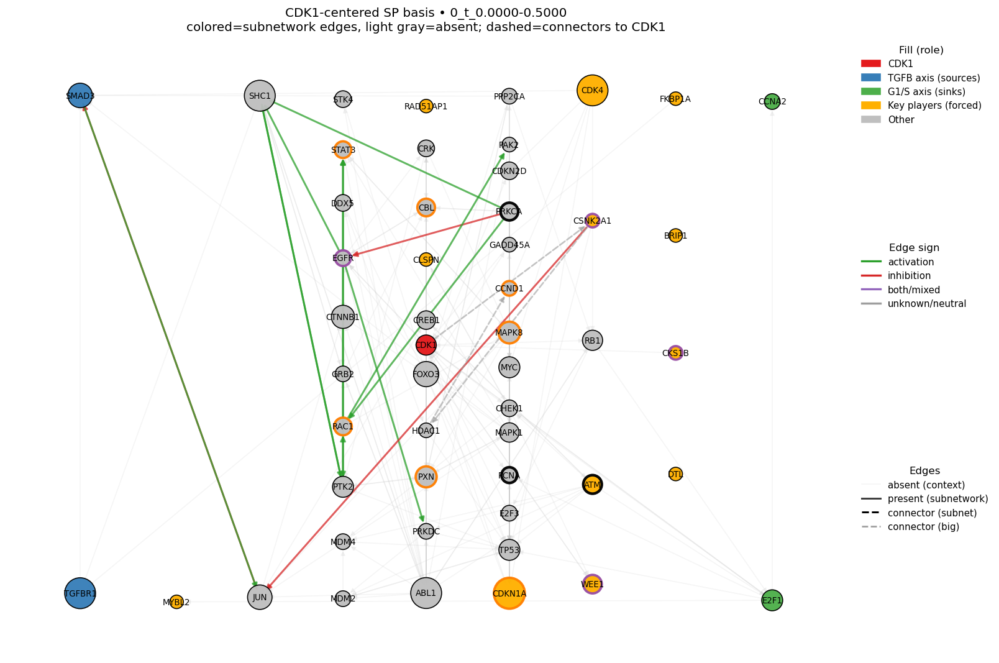

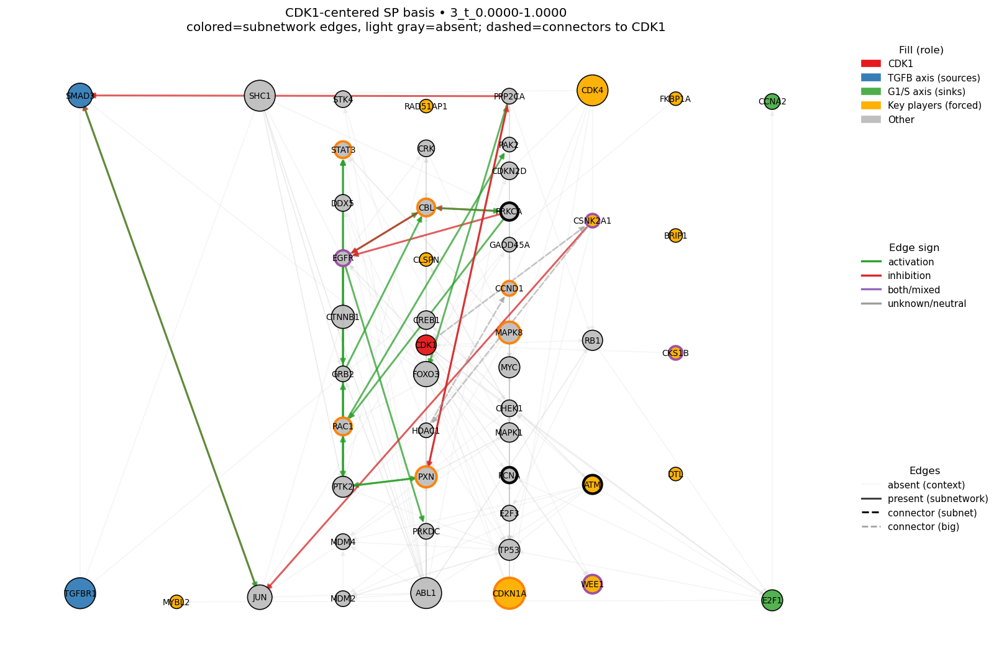

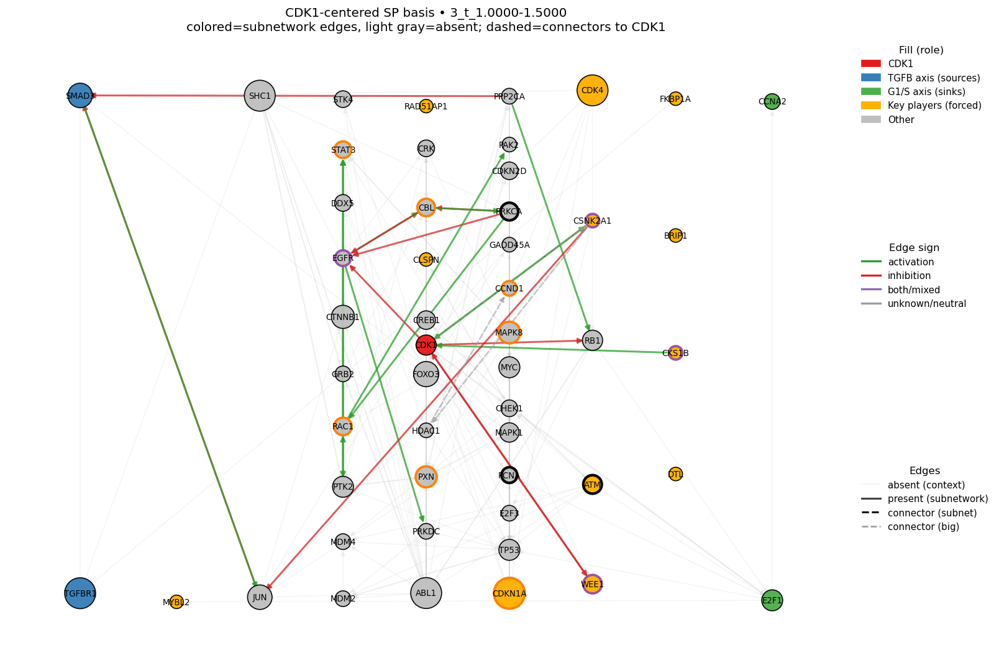

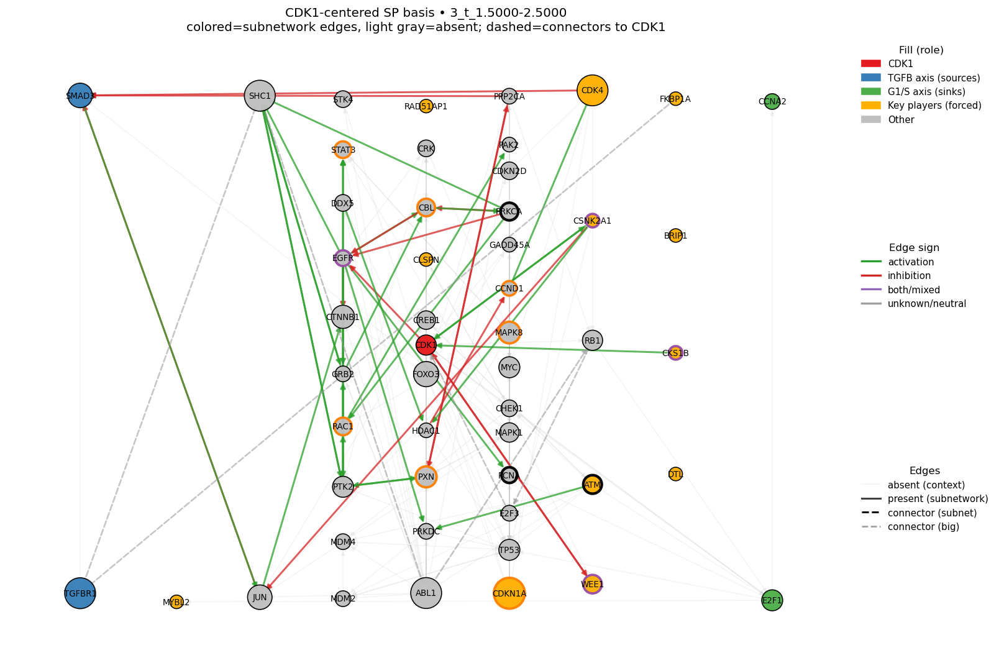

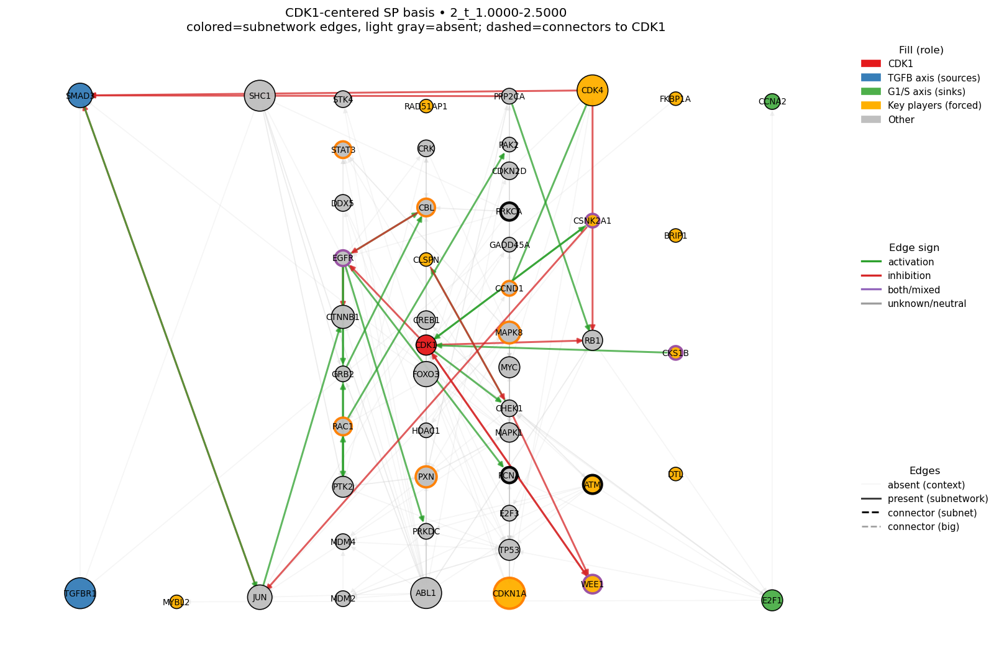

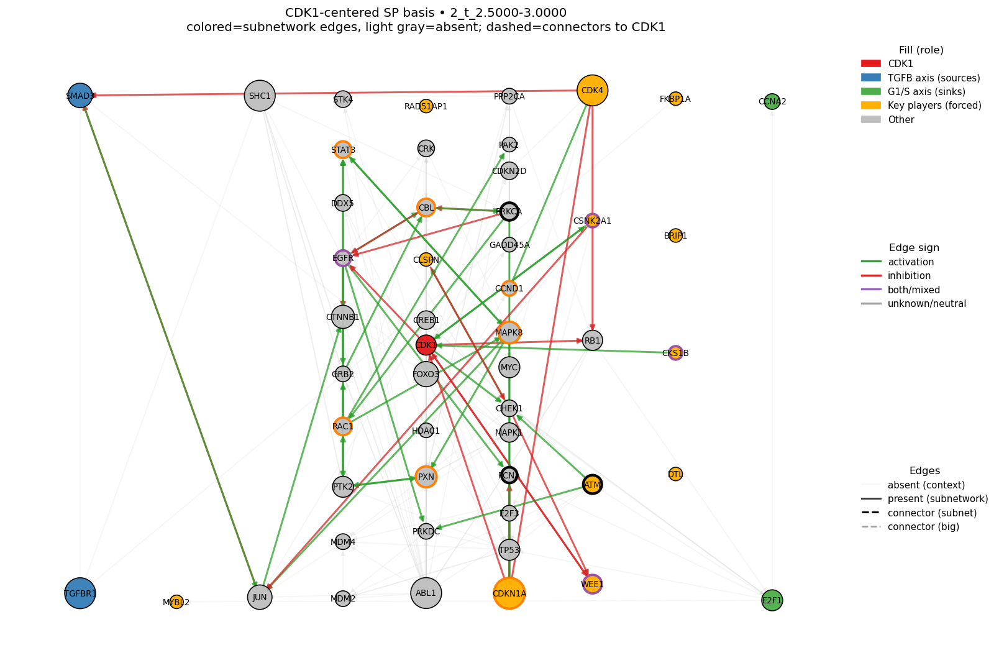

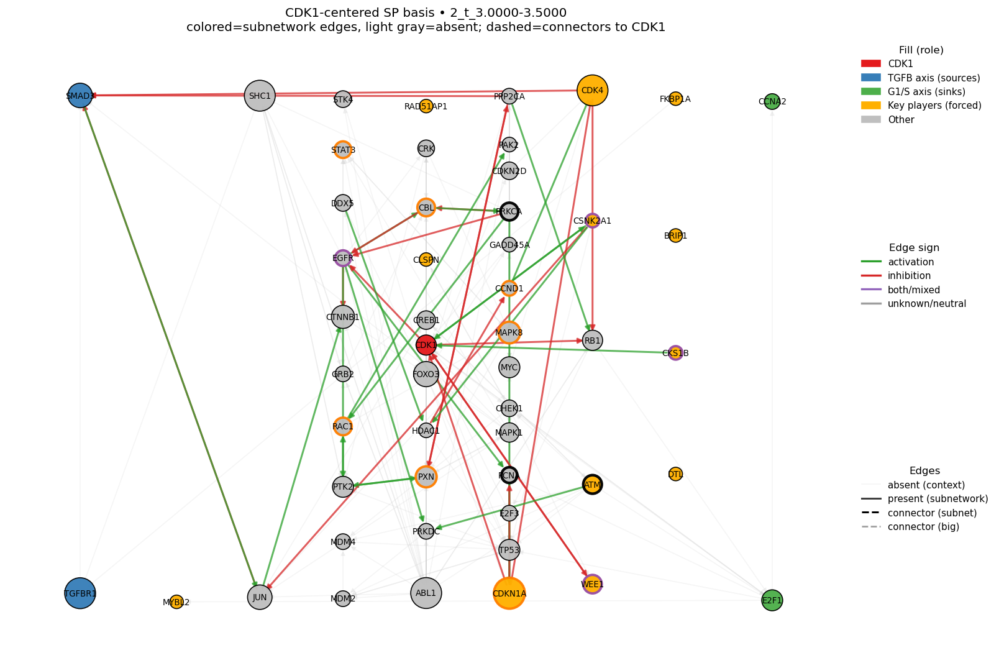

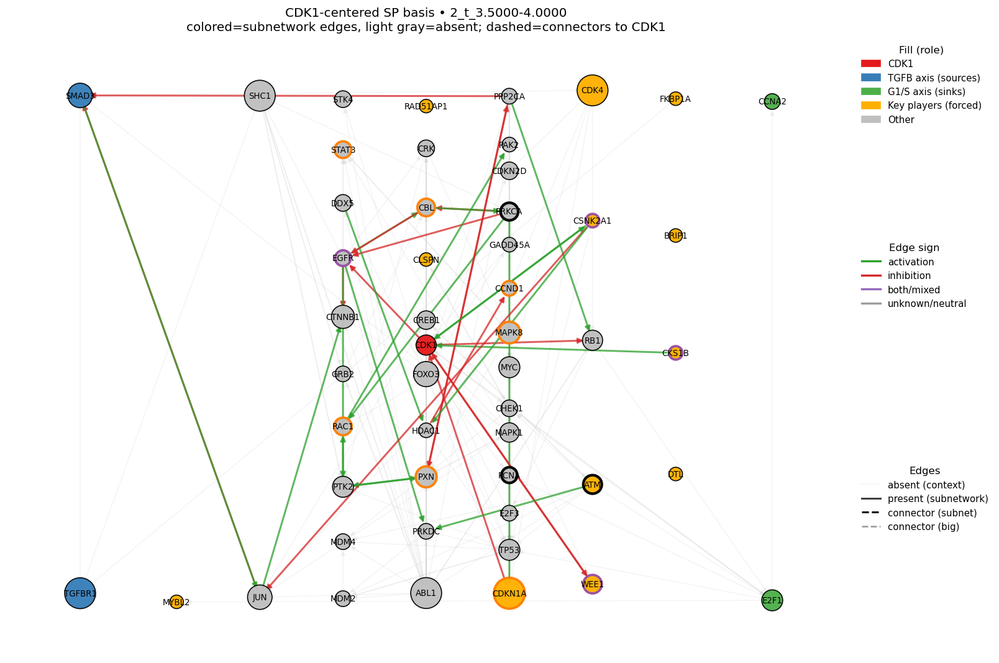

In [1702]:
# ==== Subnetwork overlays on a single big-network layout ======================
# - One consistent layout from the BIG graph (g) & big SP-union (Gsp)
# - Per-group overlays: present edges colored (act/inh), absent edges light gray
# - Optional dashed connectors to CDK1 for nodes isolated in a subnetwork
# ==============================================================================

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.lines import Line2D
import networkx as nx

# -------------------- CONFIG (edit) ------------------------------------------
PRIMARY_TARGET = "P06493"                  # CDK1 UniProt
src = {"P36897", "P84022"}                 # TGFB axis (e.g., TGFBR1, SMAD3)
snk = {"Q01094", "P20248"}                 # G1/S axis (e.g., E2F1, CCNA2)

# Forced key nodes: used for fill color and to guarantee inclusion in layout
KEY_SET = {
    "P06493","P10244","P20248","Q9NZJ0","Q01094","Q9HAW4","Q96B01","Q06609",
    "Q9BX63","P84022","P11802","P38936","P30291","P68400","P61024","P62942",
    "Q13315","P36897"
}

# Connector options
CONNECT_ISOLATES          = True   # add dashed path(s) for nodes with no subnetwork edges
CONNECT_MAX_HOPS          = 6      # cap connector length (edges); None for no cap
FALLBACK_CONNECT_FROM_BIG = True   # if subnetwork has no CDK1 path, try big graph
CONNECT_STYLE_SUB         = dict(style="dashed", alpha=0.8, width=1.8)   # in-subnetwork connector
CONNECT_STYLE_BIG         = dict(style="dashed", alpha=0.55, width=1.6)  # fallback-from-big connector

# Figure look
FIGSIZE = (13.5, 9)
LABEL_FONT_SIZE = 8
ABSENT_EDGE_ALPHA = 0.18
ABSENT_EDGE_WIDTH = 1.0
PRESENT_EDGE_ALPHA = 0.75
PRESENT_EDGE_WIDTH = 1.8

# -------------------- Helpers: names/ids, edge sign, labels -------------------
name2vid_big = {v["name"]: i for i, v in enumerate(g.vs)}
vid2name_big = {i: v["name"] for i, v in enumerate(g.vs)}

def _pick_edge_sign_attr(Gi):
    for cand in ("sign","effect","interaction","type","polarity"):
        if cand in Gi.es.attributes():
            return cand
    return None

def _parse_sign(val):
    if val is None: return None
    if isinstance(val, (int,float)):
        if val>0: return "act"
        if val<0: return "inh"
        return None
    s = " ".join(map(str, val)) if isinstance(val,(list,tuple,set)) else str(val)
    s = s.lower()
    a = any(k in s for k in ["activ","pos","+","stimulat","phospho+"])
    i = any(k in s for k in ["inhib","neg","-","repress","block","phospho-"])
    if a and i: return "both"
    if a: return "act"
    if i: return "inh"
    return None

def _edge_color_from_graph(Gi, u, v, default="#9e9e9e"):
    # map names -> vids in this graph
    try:
        name2vid_local = {vv["name"]: i for i, vv in enumerate(Gi.vs)}
        eu = name2vid_local.get(u, -1); ev = name2vid_local.get(v, -1)
        if eu == -1 or ev == -1: return default
        eid = Gi.get_eid(eu, ev, directed=True, error=False)
        if eid == -1: return default
        attr = _pick_edge_sign_attr(Gi)
        sig  = _parse_sign(Gi.es[eid][attr]) if attr else None
        return {"act":"#2ca02c","inh":"#d62728","both":"#9467bd"}.get(sig, default)
    except Exception:
        return default

def _label_map_from_graph(Gi):
    out={}
    for v in Gi.vs:
        sy = v["gene_symbol"] if "gene_symbol" in v.attributes() else None
        out[v["name"]] = sy if (sy and len(sy)) else v["name"]
    return out

# -------------------- Build the master (big) SP graph & layout ----------------
# Assumptions:
#   - Gsp is your "big" SP union igraph (already built earlier)
#   - Its vertices include a count like "sp_pass_count" (if not, default to 0)
H_master = nx.DiGraph()
H_master.add_nodes_from([v["name"] for v in Gsp.vs])
for e in Gsp.es:
    s, t = e.tuple
    us, ut = Gsp.vs[s]["name"], Gsp.vs[t]["name"]
    H_master.add_edge(us, ut)

# labels and node sizes from big SP
sym_master = _label_map_from_graph(Gsp)
nx.set_node_attributes(H_master, sym_master, "gene_symbol")
pc_map = {}
if "sp_pass_count" in Gsp.vs.attributes():
    pc_map = {v["name"]: cnt for v, cnt in zip(Gsp.vs, Gsp.vs["sp_pass_count"])}
else:
    pc_map = {v: 0 for v in H_master.nodes()}

# Layered positions once (big graph distances TGFB→G1/S)
def _layered_positions(G_big, nodes, src_ids, snk_ids):
    present = [n for n in nodes if n in name2vid_big]
    if not present:
        return {n:(0.5,0.0) for n in nodes}
    tgt_vids = [name2vid_big[n] for n in present]
    src_vids = [name2vid_big[s] for s in src_ids if s in name2vid_big]
    snk_vids = [name2vid_big[t] for t in snk_ids if t in name2vid_big]

    if src_vids:
        d_src_to_node = np.array(g.distances(source=src_vids, target=tgt_vids, mode="OUT"), dtype=float)
        dsrc = d_src_to_node.min(axis=0)
    else:
        dsrc = np.full(len(present), np.inf)
    if snk_vids:
        d_node_to_sink = np.array(g.distances(source=tgt_vids, target=snk_vids, mode="OUT"), dtype=float)
        dns  = d_node_to_sink.min(axis=1)
    else:
        dns  = np.full(len(present), np.inf)

    INF=1e12
    dsrc[~np.isfinite(dsrc)] = INF
    dns[~np.isfinite(dns)]   = INF

    x = np.zeros(len(present))
    for i in range(len(present)):
        s = dsrc[i]; t = dns[i]
        if s >= INF and t >= INF: xi = 0.5
        elif s >= INF:            xi = 0.92
        elif t >= INF:            xi = 0.08
        else:                     xi = s / max(1e-9, s+t)
        x[i] = np.clip(xi, 0.05, 0.95)

    # bin by x and spread vertically with jitter
    layers = np.clip((x * 8).round().astype(int), 0, 8)
    pos={}
    for L in sorted(set(layers)):
        idx = np.where(layers==L)[0]
        ns  = [present[i] for i in idx]
        ys  = np.linspace(-1, 1, max(2, len(ns)))
        rng = np.random.default_rng(L+7)
        ys  = ys + rng.normal(0, 0.02, size=len(ys))
        xs  = np.full(len(ns), (L/8.0))
        for n, xv, yv in zip(ns, xs, ys):
            pos[n] = (float(xv), float(yv))

    # nudge roles
    for n in present:
        if n in src: pos[n] = (pos[n][0]-0.02, pos[n][1])
        if n in snk: pos[n] = (pos[n][0]+0.02, pos[n][1])
        if n == PRIMARY_TARGET: pos[n] = (0.5, 0.0)

    # default center for any missing
    for n in nodes:
        pos.setdefault(n, (0.5, 0.0))
    return pos

pos_master = _layered_positions(g, list(H_master.nodes()), src, snk)

# -------------------- Per-subnetwork rendering --------------------------------
def _edge_set_from_graph(Gi, allowed_nodes):
    """Directed edges (u,v) present in Gi among allowed_nodes (by v['name'])."""
    name2vid_local = {v["name"]: i for i, v in enumerate(Gi.vs)}
    E=set()
    for u in allowed_nodes:
        for v in allowed_nodes:
            if u==v: continue
            eu = name2vid_local.get(u, -1); ev = name2vid_local.get(v, -1)
            if eu == -1 or ev == -1: continue
            eid = Gi.get_eid(eu, ev, directed=True, error=False)
            if eid != -1: E.add((u, v))
    return E

def _shortest_connector_edges(Gi, u, v, allowed_nodes, max_hops=None):
    """Return a list of (x,y) edges for a shortest path u->v within allowed_nodes; [] if none."""
    # Restrict Gi to allowed_nodes to keep layout consistent
    name2vid_local = {vv["name"]: i for i, vv in enumerate(Gi.vs)}
    keep_vids = [name2vid_local[n] for n in allowed_nodes if n in name2vid_local]
    if not keep_vids: return []
    sub = Gi.subgraph(keep_vids)
    # maps in subgraph
    s_name2vid = {sub.vs[i]["name"]: i for i in range(sub.vcount())}
    su = s_name2vid.get(u, None); sv = s_name2vid.get(v, None)
    if su is None or sv is None: return []
    paths = sub.get_all_shortest_paths(su, to=sv, mode="OUT")
    if not paths: return []
    # pick the first shortest path that passes max_hops filter
    for p in paths:
        if max_hops is not None and (len(p)-1) > max_hops:
            continue
        names = [sub.vs[i]["name"] for i in p]
        return list(zip(names[:-1], names[1:]))
    return []

def draw_group_overlay(G_sub: 'igraph.Graph', group_name: str):
    """
    Draw one figure for the given subnetwork:
      - edges present in G_sub: colored by sign (act/inh/both/unknown)
      - edges absent (but in master): light gray
      - isolated nodes in G_sub get a dashed connector path to CDK1
        (first try in G_sub; else fallback to big graph)
    """
    nodes = list(H_master.nodes())
    # Present edges from subnetwork among master nodes
    E_present = _edge_set_from_graph(G_sub, nodes)
    E_master  = set(H_master.edges())
    E_absent  = E_master - E_present

    # Edge colors:
    # - present edges, colored by sign from G_sub (fallback to big g if missing)
    E_present_list = sorted(list(E_present))
    colors_present = [
        _edge_color_from_graph(G_sub, u, v, default=_edge_color_from_graph(g, u, v))
        for (u, v) in E_present_list
    ]
    # - absent edges: uniform light gray
    E_absent_list = sorted(list(E_absent))
    colors_absent = ["#c8c8c8"] * len(E_absent_list)

    # Optional connectors for isolates (within the subnetwork graph)
    E_conn_sub = []; E_conn_big = []
    if CONNECT_ISOLATES:
        # degree in the present-edge view
        deg_map = {n: 0 for n in nodes}
        for (u,v) in E_present:
            deg_map[u] += 1; deg_map[v] += 1
        for n in nodes:
            if n == PRIMARY_TARGET: continue
            # if node exists in subnetwork AND has no edges in present view => try connect to CDK1
            if n in {v["name"] for v in G_sub.vs} and deg_map[n] == 0:
                # prefer path via G_sub (kept within master nodes)
                path = _shortest_connector_edges(G_sub, PRIMARY_TARGET, n, nodes, max_hops=CONNECT_MAX_HOPS)
                if not path:
                    path = _shortest_connector_edges(G_sub, n, PRIMARY_TARGET, nodes, max_hops=CONNECT_MAX_HOPS)
                if path:
                    E_conn_sub.extend(path)
                elif FALLBACK_CONNECT_FROM_BIG:
                    # fallback via big graph (still restricted to master node set)
                    path = _shortest_connector_edges(g, PRIMARY_TARGET, n, nodes, max_hops=CONNECT_MAX_HOPS)
                    if not path:
                        path = _shortest_connector_edges(g, n, PRIMARY_TARGET, nodes, max_hops=CONNECT_MAX_HOPS)
                    if path:
                        E_conn_big.extend(path)

    # Colors for connectors
    colors_conn_sub = [_edge_color_from_graph(G_sub, u, v, default=_edge_color_from_graph(g, u, v))
                       for (u, v) in E_conn_sub]
    colors_conn_big = ["#9e9e9e"] * len(E_conn_big)

    # Node styling
    pc_vals = [pc_map.get(n, 0) for n in nodes]
    pc_clip = [min(24, int(x)) for x in pc_vals]
    sizes   = [170 + 30*c for c in pc_clip]

    keys = set(KEY_SET)
    def fill_color(n):
        if n == PRIMARY_TARGET: return "#e41a1c"  # red
        if n in src:            return "#377eb8"  # blue
        if n in snk:            return "#4daf4a"  # green
        if n in keys:           return "#ffb000"  # amber
        return "#bfbfbf"
    colors = [fill_color(n) for n in nodes]

    # Optional outlines if you carry these sets in your session
    spg = set(globals().get("spg", set()))
    koh = set(globals().get("koh", set()))
    edgecolors=[]; linewidths=[]
    for n in nodes:
        sflag = (n in spg); kflag = (n in koh)
        if sflag and kflag: edgecolors.append("black");   linewidths.append(2.6)
        elif sflag:         edgecolors.append("#ff7f00"); linewidths.append(2.3)
        elif kflag:         edgecolors.append("#984ea3"); linewidths.append(2.3)
        else:               edgecolors.append("none");    linewidths.append(1.0)

    # --- Draw
    plt.figure(figsize=FIGSIZE)

    # 1) Absent edges (context) in light gray
    nx.draw_networkx_edges(
        H_master, pos_master,
        edgelist=E_absent_list, edge_color=colors_absent,
        alpha=ABSENT_EDGE_ALPHA, arrows=True, arrowsize=9, width=ABSENT_EDGE_WIDTH
    )
    # 2) Present edges (subnetwork) in color
    nx.draw_networkx_edges(
        H_master, pos_master,
        edgelist=E_present_list, edge_color=colors_present,
        alpha=PRESENT_EDGE_ALPHA, arrows=True, arrowsize=10, width=PRESENT_EDGE_WIDTH
    )
    # 3) Connectors (in-subnetwork) dashed
    if E_conn_sub:
        nx.draw_networkx_edges(
            H_master, pos_master,
            edgelist=E_conn_sub, edge_color=colors_conn_sub,
            arrows=True, arrowsize=10, **CONNECT_STYLE_SUB
        )
    # 4) Connectors (fallback from big) dashed gray
    if E_conn_big:
        nx.draw_networkx_edges(
            H_master, pos_master,
            edgelist=E_conn_big, edge_color=colors_conn_big,
            arrows=True, arrowsize=10, **CONNECT_STYLE_BIG
        )

    # Nodes + labels (gene symbols from big SP)
    nx.draw_networkx_nodes(
        H_master, pos_master,
        nodelist=nodes, node_size=sizes, node_color=colors,
        edgecolors=edgecolors, linewidths=linewidths, alpha=0.96
    )
    nx.draw_networkx_labels(H_master, pos_master,
        labels={n: H_master.nodes[n].get("gene_symbol", n) for n in nodes},
        font_size=LABEL_FONT_SIZE
    )

    # Legends
    fill_leg = [
        mpatches.Patch(color="#e41a1c", label="CDK1"),
        mpatches.Patch(color="#377eb8", label="TGFB axis (sources)"),
        mpatches.Patch(color="#4daf4a", label="G1/S axis (sinks)"),
        mpatches.Patch(color="#ffb000", label="Key players (forced)"),
        mpatches.Patch(color="#bfbfbf", label="Other"),
    ]
    edge_sign_leg = [
        Line2D([0],[0], color="#2ca02c", lw=2, label="activation"),
        Line2D([0],[0], color="#d62728", lw=2, label="inhibition"),
        Line2D([0],[0], color="#9467bd", lw=2, label="both/mixed"),
        Line2D([0],[0], color="#9e9e9e", lw=2, label="unknown/neutral"),
    ]
    ctx_leg = [
        Line2D([0],[0], color="#c8c8c8", lw=ABSENT_EDGE_WIDTH, alpha=ABSENT_EDGE_ALPHA, label="absent (context)"),
        Line2D([0],[0], color="k", lw=PRESENT_EDGE_WIDTH, alpha=PRESENT_EDGE_ALPHA, label="present (subnetwork)"),
        Line2D([0],[0], color="k", lw=CONNECT_STYLE_SUB.get("width",1.8), linestyle="--", label="connector (subnet)"),
        Line2D([0],[0], color="#9e9e9e", lw=CONNECT_STYLE_BIG.get("width",1.6), linestyle="--", label="connector (big)"),
    ]
    leg1 = plt.legend(handles=fill_leg,      loc='upper left', bbox_to_anchor=(1.01, 1.00), frameon=False, title="Fill (role)")
    plt.gca().add_artist(leg1)
    leg2 = plt.legend(handles=edge_sign_leg, loc='upper left', bbox_to_anchor=(1.01, 0.68), frameon=False, title="Edge sign")
    plt.gca().add_artist(leg2)
    plt.legend(handles=ctx_leg,              loc='upper left', bbox_to_anchor=(1.01, 0.32), frameon=False, title="Edges")

    plt.title(f"CDK1-centered SP basis • {group_name}\ncolored=subnetwork edges, light gray=absent; dashed=connectors to CDK1", fontsize=12)
    plt.axis("off"); plt.tight_layout(); plt.show()

# -------------------- Run for all groups --------------------------------------
# Use your TRAJ_3 order; falls back to keys from group_graphs if needed
groups = [gname for gname in TRAJ_3 if gname in group_graphs] if 'TRAJ_3' in globals() else sorted(group_graphs.keys())

for grp in groups:
    draw_group_overlay(group_graphs[grp], grp)


## 11.12 drugtargets 

In [131]:
# ─── assume you already have `hits` from:
#    from omnipath.requests import SmallMolecule
#    drugs = SmallMolecule.get()[["compound","target","effect","resource"]]
#    hits = drugs[drugs["target"].isin(receptors)]

# e.g. focus on P08174
receptor = "P08174"
drugs_for = hits.loc[hits["target"] == receptor]

print(f"Drugs targeting {receptor}:")
if drugs_for.empty:
    print("  (none found)")
else:
    print(drugs_for.to_string(index=False))


AttributeError: 'list' object has no attribute 'loc'

In [132]:
for r in receptors:
    df_r = hits.loc[hits["target"] == r]
    print(f"\n=== {r} ===")
    if df_r.empty:
        print("  (no small-molecule/antibody known)")
    else:
        # only show the most relevant columns
        print(df_r[["compound","effect","resource"]].to_string(index=False))


AttributeError: 'list' object has no attribute 'loc'

In [133]:
from omnipath.requests import SmallMolecule
import pandas as pd

# 1) Download the SmallMolecule table
sm = SmallMolecule()
drugs = sm.get(fields=["compound","target","effect","resource"])

# 2) Turn it into a DataFrame
#    (it already comes back as a DataFrame from omnipath)
#    but let’s be explicit:
drugs_df = pd.DataFrame(drugs)

# 3) Filter to only your receptor list
receptors = ["Q03405","O60462","P08174"]   # your top candidates
hits = drugs_df.loc[drugs_df["target"].isin(receptors)].copy()

# 4) For each receptor, report the known compounds
for r in receptors:
    df_r = hits[hits["target"] == r]
    print(f"\n=== Receptor {r} ===")
    if df_r.empty:
        print("  (no annotated small-molecule or antibody hits in OmniPath)")
    else:
        # show compound name, effect (agonist/inhibitor), and source database
        print(
            df_r[["compound","effect","resource"]]
            .drop_duplicates()
            .to_string(index=False)
        )


ImportError: cannot import name 'SmallMolecule' from 'omnipath.requests' (/home/job37yv/miniforge3/envs/omnipath/lib/python3.10/site-packages/omnipath/requests.py)